# Introduction
This notebook is a detailed record of the methodology of this project. We will be relying on the PCA method to extract statistical factors and see if we can 1) find any meaning for the extracted factors, 2) determine whether the behavior of residuals is appropriate for trading, and 3) trade the residuals to earn non-trivial profits (possibly compare with benchmark methods). The overall process will rely on the seminal paper on statistical arbitrage by Avellaneda(2011). 

Below is the outline of this notebook.

0. Introduction
1. Theory
2. Data Collection and Validation
3. Data Transformation
4. Data Exploration/Visualization
5. Investigating PCA factors
6. Studying Residual Behaviour
7. Devise Trading Strategy
8. Backtest and Performance Analysis
9. Discussion: Practical Implications, Limitations, and Improvements
10. Conclusion

# 2. Data Collection and Validation

Because we will be relying on the usage of Python for the entire project, we will use modules and libraries supported by Python.

Because the most important data will be (closing?) price of cryptocurrencies, the `ccxt` module will be used to fetch appropriate data. More specifically, while we make requests to Binance for most of the time, other exchanges supported by ccxt will be used when there are missing values from the originally collected data.

## 2-1. Selecting the right dataset
It's important to acknowledge that every choice you make within a quantitative research process implies an assumption / multiple assumptions that could potentially have critical implications on the results you produce.

For instance, naively including all listed spot coins as of today for backtesting purpose doesn't make sense at all, if you think closely. Some of the assumptions implied in this case is:
1) you believe coins listed today were listed in the past as well (starting from the date of the backtest)
2) coins that were listed in the past but now delisted do not matter 
3) all listed coins should be used for quant research purpose
4) spot coins are the main asset type we hope to trade

Obviously, 1) and 2) are blatantly false and could have material impact on your results. 3) & 4) are a bit more nuanced. 

For 3) you have to think about the nature of outlier coins listed on an exchange and whether your strategy performance depends on the inclusion/exclusion of exotic coins. Now, in the context of cryptocurrency market, there are numerous small names that pass the threshold, which is surprising quite lax compared to the listing requirements for public equities, so it isn't weird to see fishy coins listed on a large and reputable exchange like Binance. Moreover, the price action for some of these coins are very choppy and extreme attributed to phenomena such as *pump-and-dump* and frequent theme rotations(DeFi, meme, gaming, metaverse, NFT, etc...).

Therefore, for the purpose of our research, we want to adopt cryptocurrencies that aren't too susceptible to manipulation by a few market players. That is, we want to set a minimum threshold, using marketcap, to filter coins that should be avoided.

(TMI: this may not be the case for some other strategies that try to capture signals preceding a potential "pump" or "dump" or a shift in popular themes.)

For 4), an obvious question you should ask yourself is: do you want to use leverage and be able to *short* certain coins? If the answer is no, collecting prices for spot coins could work. If the answer is yes, then you should probably think about collecting prices of perp contracts, short for *perpetual swaps*. 

For most trading strategies involving mean reversion, if you are somewhat confident that the reversion dynamic works well in both directions, it is advantageous to be able to both long and short the spread. Thus, for this project, we will be looking at mostly perp contracts denoted in *USDT*, since inverse perp contracts are prone to some other technical issues that could introduce unwanted risks.






## 2-2: Filter 2: Date
Before selecting the appropriate date range for our training set, an important question we should ask ourself is: Is the training set biased towards a specific market regime?

For instance, if we backtest a mean-reversion strategy over a date range in which Bitcoin was trading in a tight price range, the result will likely overvalue performance ratios (cumulative return, sharpe). That is, our choice of date range leads to an overly-optimistic result that might not hold for out-of-sample testing. 

A natural solution is to choose a date range long enough to include at least a single market cycle (which admittedly is a vague concept itself). However, note that a deliberate choice of date range for a specific purpose is a non-trivial factor affecting strategy performance; it does not pose significant threats if and only if we assume that we can do the same during live testing. For this research, we will adopt the walk-forward method 

You might ask why have we chosen six months for our date range. To be honest, the choice is mostly based on the intuition. First, the crypto market is a much more volatile market in which what would be regarded as tail events in the stock market occur at a relatively more frequent rate. This can be verified by simply comparing daily distributions of returns for Bitcoin and S&P 500. Second, it can be argued that the average crypto market participant is characterized by a shorter holding period (or investment horizon) than the average equity market participant. Third, information loses predictive power at a faster rate in crypto space compared to public equity space. Roughly speaking, we can think of stock price at a specific time point $t=k$, $S_{k}$, as a reflection of all information up to time $k$. Then, we can check how past information affects future information by looking at the *autocorrelation* of the time series.

Note that the ACF series of S&P 500 weekly prices decay at a slower rate compared to that of Bitcoin below. Using other cryptocurrencies instead of Bitcoin reveals that the discrepancy between decay rates becomes more apparent. If it is difficult to understand why the previous analogy holds, simply think about where the S&P 500 index (at 5200 approximately as of August 6 of 2024) will be at in about six months from now. Most of you will not agree if I tell you the S&P 500 will be at either around 8000 or 2,500. However, if I tell you bitcoin (at 55k USD) will be at around 82k or 28k, it will be easier for us to come at an agreement, in a relative sense. This is nowhere near to being a rigorous analysis, so you regard it with a grain of salt. We will come back to this discussion later when we talk about the residual series after taking account of systematic factor returns.


In [105]:
# Import lib
import pandas as pd
import yfinance as yf
import matplotlib.pyplot as plt
from statsmodels.graphics.tsaplots import plot_acf


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


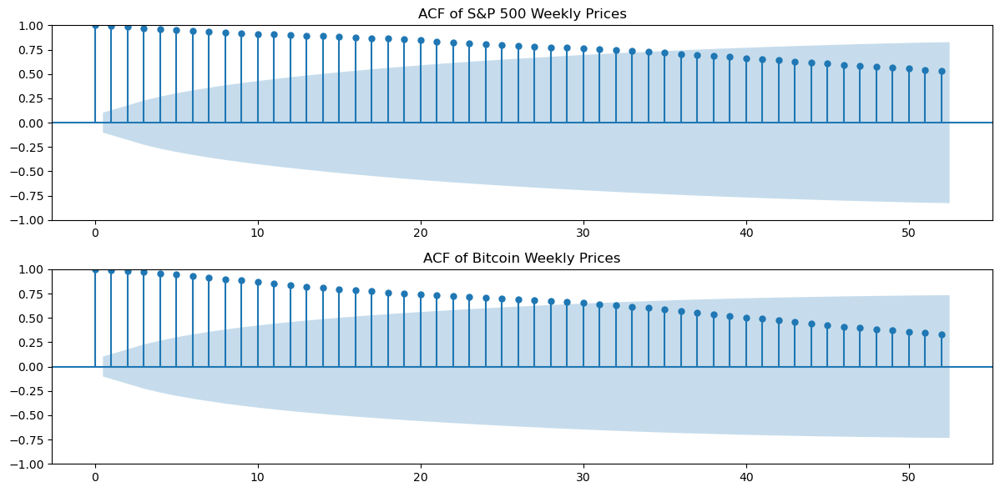

In [106]:

# Download weekly data
sp500 = yf.download('^GSPC', start='2016-01-01', end='2023-01-01', interval='1wk')
bitcoin = yf.download('BTC-USD', start='2016-01-01', end='2023-01-01', interval='1wk')

# Extract the closing prices
sp500_close = sp500['Close']
bitcoin_close = bitcoin['Close']

# Calculate weekly returns
sp500_wkly_returns = sp500_close.pct_change().dropna()
bitcoin_wkly_returns = bitcoin_close.pct_change().dropna()

# Plotting ACF for S&P 500 price
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plot_acf(sp500_close.dropna(), lags=52, ax=plt.gca())

plt.title('ACF of S&P 500 Weekly Prices')

# Plotting ACF for Bitcoin price
plt.subplot(2, 1, 2)
plot_acf(bitcoin_close.dropna(), lags=52, ax=plt.gca())
plt.title('ACF of Bitcoin Weekly Prices')

plt.tight_layout()
plt.show()


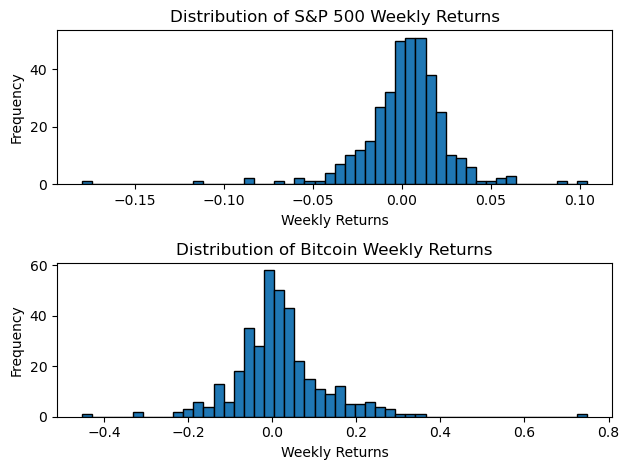

In [107]:
## Weekly Return Distribution

# Histogram for S&P 500 Returns
plt.subplot(2, 1, 1)
plt.hist(sp500_wkly_returns.dropna(), bins=50, edgecolor='black')
plt.title('Distribution of S&P 500 Weekly Returns')
plt.xlabel('Weekly Returns')
plt.ylabel('Frequency')

# Histogram for Bitcoin Returns
plt.subplot(2, 1, 2)
plt.hist(bitcoin_wkly_returns, bins=50, edgecolor='black')
plt.title('Distribution of Bitcoin Weekly Returns')
plt.xlabel('Weekly Returns')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

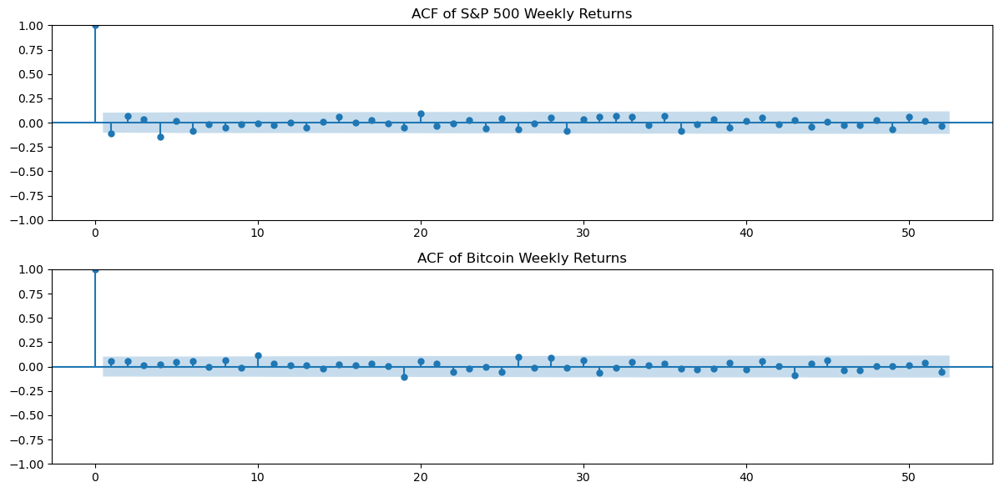

In [108]:
## ACF plots for weekly returns

# Plotting ACF for S&P 500 ret
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plot_acf(sp500_wkly_returns.dropna(), lags=52, ax=plt.gca())
plt.title('ACF of S&P 500 Weekly Returns')

# Plotting ACF for Bitcoin ret
plt.subplot(2, 1, 2)
plot_acf(bitcoin_wkly_returns.dropna(), lags=52, ax=plt.gca())
plt.title('ACF of Bitcoin Weekly Returns')

plt.tight_layout()
plt.show()


In [109]:
# Calculate Statistics
from scipy.stats import skew, kurtosis
import pandas as pd

sp500wkly_mean = sp500_wkly_returns.mean()
sp500wkly_sdv = sp500_wkly_returns.std()
sp500wkly_skew = skew(sp500_wkly_returns)
sp500wkly_kurt = kurtosis(sp500_wkly_returns)

btcwkly_mean = bitcoin_wkly_returns.mean()
btcwkly_sdv = bitcoin_wkly_returns.std()
btcwkly_skew = skew(bitcoin_wkly_returns)
btcwkly_kurt = kurtosis(bitcoin_wkly_returns)

sp500wkly_stats = {
    "Mean": sp500wkly_mean,
    "Standard Deviation": sp500wkly_sdv,
    "Skewness": sp500wkly_skew,
    "Excess Kurtosis": sp500wkly_kurt
}

btcwkly_stats = {
    "Mean": btcwkly_mean,
    "Standard Deviation": btcwkly_sdv,
    "Skewness": btcwkly_skew,
    "Excess Kurtosis": btcwkly_kurt
}

# Combine the statistics into a single DataFrame
stats_df = pd.DataFrame({
    "S&P 500 Weekly": sp500wkly_stats,
    "Bitcoin Weekly": btcwkly_stats
})

# Print the results in a nice table format
print("Descriptive Statistics for Weekly Returns:")
print(stats_df.T)  # Transpose for better readability


Descriptive Statistics for Weekly Returns:
                    Mean  Standard Deviation  Skewness  Excess Kurtosis
S&P 500 Weekly  0.002165            0.024107 -1.475325        11.610563
Bitcoin Weekly  0.015560            0.108439  0.861025         6.633082


In [110]:
# Verify skew and kurtosis doesn't change when we use standardized returns

sp500wkly_stdreturns = (sp500_wkly_returns - sp500wkly_mean) / sp500wkly_sdv

sp500wklystd_mean = sp500wkly_stdreturns.mean()
sp500wklystd_sdv = sp500wkly_stdreturns.std()
sp500wklystd_skew = skew(sp500wkly_stdreturns)
sp500wklystd_kurt = kurtosis(sp500wkly_stdreturns)

sp500wklystd_stats = {
    "Mean": sp500wklystd_mean,
    "Standard Deviation": sp500wklystd_sdv,
    "Skewness": sp500wklystd_skew,
    "Excess Kurtosis": sp500wklystd_kurt
}

print(sp500wklystd_stats)

{'Mean': 2.4333655334250007e-18, 'Standard Deviation': 1.0, 'Skewness': -1.4753247765439328, 'Excess Kurtosis': 11.610562780642331}


Interesting feature of the cryptocurrency market is that while most of us are aware that the cryptomarket is much volatile than the equity market, it is surprising to see that weekly returns of cryptomarket have lower skew and kurtosis in absolute value.

## 2-3. Filter 2: Market Capitalization
A good way to avoid coins subject to manipulation is to filter based on market cap (descending). For instance, we could choose to include in our backtest the top 100 cryptocurrencies at the time of data collection (start date of backtest). This way, we avoid survivorship bias and thus the risk of choosing an overly optimistic train/test set. 

To obtain historical market cap data of cryptocurrencies, we rely on the API wrapper `crypto2` from R. After collecting relevant data, we will pick a random date and take a look at the top $p$ coins sorted by market cap. How we choose p is subject to discussion. We can choose 100. We can choose 125 (used to calculate BTC dominance), or we can choose $p$ such that the top p cryptocurrency market cap accounts for 80% of total market cap -- similar to S&P 500's contribution relative to total US public equity market cap.

After choosing $p$ such coins, we will see if we can download historical trading data via the `ccxt` library from Python. We could simply use the OHLCV data provided by the `crypto2` package, but it is better to rely on price data from an exchange you are willing to make trades on for maximum similarity. Moreover, we can set granularity of the data as we wish, since `crypto2` as of August 2024 only supports 1-hour and 1-day intervals.


### 2-3-1. Exponentially Weighted Moving Average of Market Caps
One way to possibly apply the market cap filter is to choose our trading date and then look for the top X coins in terms of market cap. Arbitrarily, choose $X=50$. However, we need to update this information everyday, in order to ensure our trading model reflects the most relevant information (especially if we are relying on empirical covariance matrix to extract our factors). Notice that each day there will be changes in the constituents of the top 50 coins, and thus our sample covariance matrix will be quite volatile. We do not want this, since frequent trading leads to higher trading costs. 

To cope with this issue, we will adopt an approach relying on EWMA (exponential weighted moving average) combined with cumulative scoring. First, we construct a EWMA market cap series for all coins in our tradable universe. Second, for each time period, sum all the cross-sectional EWMA of market cap and score each coin based on whether it is included in the top X coins contributing to 90% of total market cap of our coin universe. Give a score of 1 each time period if the coin passes criteria. Otherwise, give a score of 0.

Now suppose our trading date is 2022-07-01. Then, we look at our EWMA score dataframe and we construct our *tradable list* by including coins whose value is 1 on that day.

This list, will contain $p_1$ coins, and in general, for day i (given first day is 2022-07-01), we will have $p_i$ coins as our tradable list.

This will be the set of coins we will conduct PCA analysis and attempt to generate mean-reverting residual series.

## 2-4. Filter 3: Median Daily Volume
There are some coins that have high market cap but have relatively low traded volume -- like the Bitfinex native coin *UNUS SED LEO* token. 

Therefore we have to think of capacity of our strategy as well. That is, we must take into consideration of factors such as slippage and market impact. Thus, we also set a threshold of median non-zero daily volume to be over 1 million USD for the entire data period (20220101 ~ 20240805).

## 2-5. Filter 4: Contamination of Data
We could set filters to exclude coins that have too many irregularities in their observation sequence, like jumps in time indices, streak of missing values, duplicated closing price values, and etc. However, most of these data irregularities occur for small capped coins, and naturally, an application of the market cap filter for mid-to-large sized coins filter out most, if not all, of these "faulty" coins.

In [111]:
import sys
import pprint

In [112]:
sys.path.append(r"C:\Users\idkup\OneDrive\Jay coding\Python\General_Scripts")

In [113]:
import feather_import_from_r as fifr

In [114]:
# Print target list
target_dict = fifr.target_dict
print(target_dict["2022-07-01"])


['algorand', 'avalanche', 'bitcoin', 'bitcoin-cash', 'bnb', 'cardano', 'chainlink', 'cosmos', 'cronos', 'dogecoin', 'ethereum', 'ftx-token', 'hex', 'litecoin', 'monero', 'near-protocol', 'polkadot-new', 'polygon', 'shiba-inu', 'solana', 'stellar', 'tron', 'uniswap', 'unus-sed-leo', 'xrp']


In [115]:
# Add path to sys.path
script_path = fifr.script_path

if script_path not in sys.path:
  sys.path.append(script_path)

else:
  print("Already added")


In [116]:
# Define the desired date
data_dir = fifr.data_dir
desired_date = '2022-07-01'

# Load the desired dataframe
df_desired = fifr.get_desired_dataframe(data_dir, desired_date)
print(df_desired)  # This will print the dataframe if run as a script

      timestamp  algorand   avalanche       bitcoin  bitcoin-cash         bnb  \
0    2022-01-01  1.740108  114.158010  47686.811509    444.456189  527.352722   
1    2022-01-02  1.674041  113.186336  47345.220564    447.832642  531.396645   
2    2022-01-03  1.788210  108.145212  46458.116959    434.943840  512.135964   
3    2022-01-04  1.674683  103.239241  45897.575827    427.524334  507.506111   
4    2022-01-05  1.559897   97.852579  43569.003348    401.572519  475.056933   
..          ...       ...         ...           ...           ...         ...   
943  2024-08-01  0.134730   25.723108  65357.501563    413.147226  575.146705   
944  2024-08-02  0.124071   23.594503  61415.064573    381.553088  542.915190   
945  2024-08-03  0.120628   22.683568  60680.094699    364.384602  529.481326   
946  2024-08-04  0.114632   21.227669  58116.976961    331.857666  497.039094   
947  2024-08-05  0.110250   19.549341  53991.457797    309.955755  464.626909   

      cardano  chainlink   

In [117]:
# Set timestamp column as index
target_price = df_desired.copy()
target_price.set_index('timestamp', inplace=True)
target_price.index = pd.to_datetime(target_price.index)


In [118]:
print(target_price)

            algorand   avalanche       bitcoin  bitcoin-cash         bnb  \
timestamp                                                                  
2022-01-01  1.740108  114.158010  47686.811509    444.456189  527.352722   
2022-01-02  1.674041  113.186336  47345.220564    447.832642  531.396645   
2022-01-03  1.788210  108.145212  46458.116959    434.943840  512.135964   
2022-01-04  1.674683  103.239241  45897.575827    427.524334  507.506111   
2022-01-05  1.559897   97.852579  43569.003348    401.572519  475.056933   
...              ...         ...           ...           ...         ...   
2024-08-01  0.134730   25.723108  65357.501563    413.147226  575.146705   
2024-08-02  0.124071   23.594503  61415.064573    381.553088  542.915190   
2024-08-03  0.120628   22.683568  60680.094699    364.384602  529.481326   
2024-08-04  0.114632   21.227669  58116.976961    331.857666  497.039094   
2024-08-05  0.110250   19.549341  53991.457797    309.955755  464.626909   

           

# 3. PCA and Eigenportfolios

## 3-1. Static PCA Analysis

In [119]:
# Import necessary libraries for PCA analysis
import pandas as pd
import numpy as np
from datetime import datetime, timedelta
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from tqdm import tqdm

In [120]:
# sim_ret
sim_ret = (target_price / target_price.shift(1) - 1).dropna()

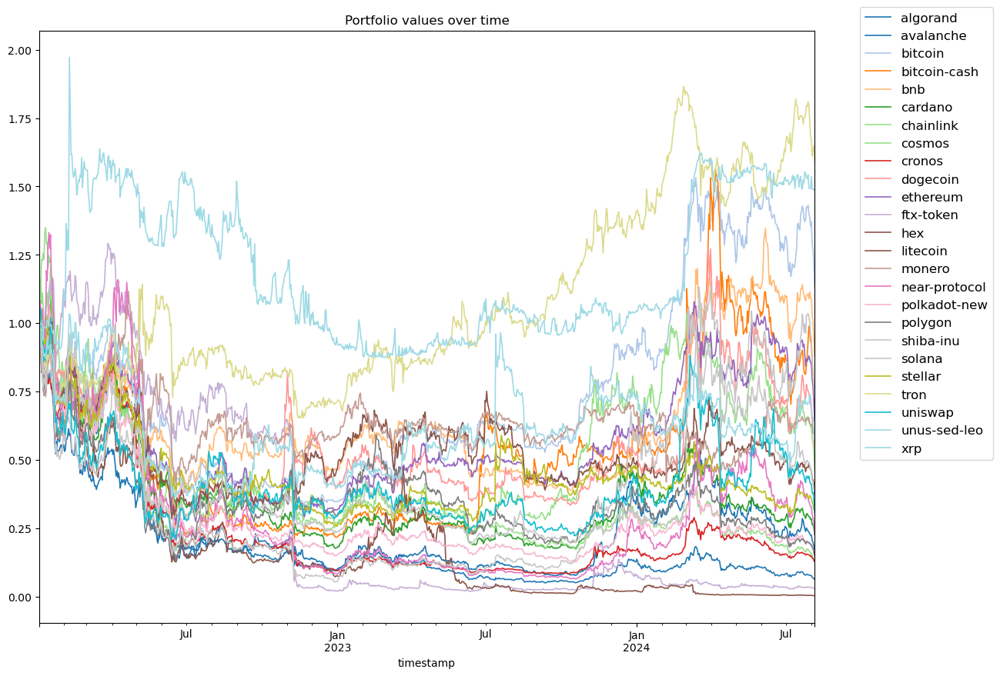

In [121]:
# Visualization
np.cumprod(1+ sim_ret).plot(figsize=(13, 10), linewidth=1.2, colormap='tab20')
plt.title("Portfolio values over time")
plt.legend(loc = "upper left", bbox_to_anchor = (1.05, 1.05), fontsize = 12, ncol = 1)

##### Remarks
- From 2022 January 1st to 2024 August 5th, overall market for cryptocurrencies wasn't that bright. Bitcoin only was able to reclaim its initial high after January 2024.
- We see many coins going obsolete, indicating the need to dynamically update our target list at least every few months.


#### Deviation - sci-kit learn PCA vs numpy eigh

PCA can be understood as doing an eigenvector decomposition on the covariance matrix and at the same time finding the right singular vector of the data matrix (given your matrix is nxp, n observations and p features).

Extracting the principal components via SVD is actually more numerically stable and the class itself offers more attributes that we can comfortably use.

So for the rolling window analysis, we will be relying on sci-kit learn's PCA().

However, it is always important to check that we know what we are doing. Hence, we will compare numpy's eigh with sci-kit learn's PCA to understand the various methods and attributes that trail sci-kit learn's method.

We will use the first 180 days worth of data to conduct PCA.

A note to make while doing standardization. One can use StandardScaler() from sklearn and this will result in a different dataframe compared to the manual standardization. This is because scikit learn uses np.std() which is the population standard deviation, while the pd attribute df.std is the sample standard deviation (Bessel's correction). If we use `df.std(ddof=0)` then there will be no difference between the two methods.

We will be using the sample standard deviation.

**np.linalg.eigh**
- This is a method used for Hermitian matrices (symmetric). It is faster than eig() which is used for general matrices.
- The eigenvalues are sorted in increasing order.
- The eigenvectors is an multidimensional array where each column is the noramlized eigenvector of the correlation matrix. Thus, it returns matrix $V$.

**sklean's PCA**
- Assumes nxp matrix, n for number of observations, p for number of features
- Input should be the data matrix not the covariance matrix
- One of the attributes, singular_values_, is unscaled version of the square root of the eigenvalue (of covariance matrix)

In [122]:
# PCA via eigenvalue decomposition in numpy
end_date = datetime.strptime("2022-07-01", "%Y-%m-%d")
end_index = sim_ret.index.get_loc(end_date)

# Slice data
test_data = sim_ret.iloc[0: end_index]

# standardize data manually
test_data_std = (test_data - test_data.mean()) / test_data.std()

corr_mat = test_data_std.cov() # Set rowvar to False to deem column as feature

eig_values, eig_vectors = np.linalg.eigh(corr_mat)

sorted_idx = np.argsort(eig_values)[::-1] # By default, eigenvalues are ordered in increasing order
eig_values = eig_values[sorted_idx]
eig_vectors = eig_vectors[:, sorted_idx]

In [123]:
n_samples = test_data_std.shape[0]
singular_val = np.sqrt(eig_values * (n_samples - 1)) # scaled eig-value, representing "strength" of that principal axis
explained_var_ratio = eig_values / np.sum(eig_values) 

explained_var_ratio


array([0.7084042 , 0.04073398, 0.03351253, 0.02364397, 0.0229558 ,
       0.02147834, 0.01756204, 0.01529623, 0.01303467, 0.01227156,
       0.01065147, 0.00951057, 0.00913519, 0.00877724, 0.0079766 ,
       0.00740992, 0.00681218, 0.00569281, 0.00530029, 0.00456847,
       0.00422057, 0.00349104, 0.00274407, 0.0025724 , 0.00224386])

In [124]:
# PCA via sklearn
pca_test = PCA()
pca_test.fit(test_data_std)

pca_test.components_.T # Note that the transpose is equal to eig_vectors from eigendecomposition
pca_test.explained_variance_ # Same as eigenvalues of correlation matrix
pca_test.singular_values_ # Same as square root of eig_values scaled by (number of samples - 1)
pca_test.explained_variance_ratio_ # eig_value divided by sum of eig_value
cumulative_explained_var_ratio = np.cumsum((pca_test.explained_variance_ratio_))

In [125]:
# Numpy: Project standardized data to first five principal components
npeigh_df = pd.DataFrame(test_data_std @ eig_vectors[:, 0:5])
npeigh_df.columns

npeigh_df.columns = [f"PC {i+1}" for i in range(5)]

print(npeigh_df)

                PC 1      PC 2      PC 3      PC 4      PC 5
timestamp                                                   
2022-01-02  0.789931  0.190301  0.809751 -1.723658  0.484782
2022-01-03  0.184916  0.212610 -2.616917  0.939485  0.381406
2022-01-04 -0.786072  0.021072 -0.614913  0.506320 -0.114148
2022-01-05 -5.088089 -0.130314 -0.321325 -1.320617  1.679747
2022-01-06  0.606787  0.359413 -0.696599 -0.069888 -0.306068
...              ...       ...       ...       ...       ...
2022-06-26 -3.017398  0.111923  1.985606 -0.513690  0.023239
2022-06-27 -0.901088  0.504714  0.730638 -0.379510 -0.182096
2022-06-28 -4.334160 -0.199868  0.745873 -0.043831  0.726458
2022-06-29 -0.797621 -0.225008  0.159656  0.024244 -0.305050
2022-06-30 -0.324131  0.520038 -0.507997 -1.004952 -0.117095

[180 rows x 5 columns]


In [126]:
# Sklearn: Project standardized data to first five principal components
sklearn_df = pd.DataFrame(pca_test.transform(test_data_std), columns = [f"PC {i+1}" for i in range(0, pca_test.n_components_)], index = test_data_std.index).iloc[:,:5]

print(sklearn_df)

                PC 1      PC 2      PC 3      PC 4      PC 5
timestamp                                                   
2022-01-02  0.789931 -0.190301 -0.809751 -1.723658 -0.484782
2022-01-03  0.184916 -0.212610  2.616917  0.939485 -0.381406
2022-01-04 -0.786072 -0.021072  0.614913  0.506320  0.114148
2022-01-05 -5.088089  0.130314  0.321325 -1.320617 -1.679747
2022-01-06  0.606787 -0.359413  0.696599 -0.069888  0.306068
...              ...       ...       ...       ...       ...
2022-06-26 -3.017398 -0.111923 -1.985606 -0.513690 -0.023239
2022-06-27 -0.901088 -0.504714 -0.730638 -0.379510  0.182096
2022-06-28 -4.334160  0.199868 -0.745873 -0.043831 -0.726458
2022-06-29 -0.797621  0.225008 -0.159656  0.024244  0.305050
2022-06-30 -0.324131 -0.520038  0.507997 -1.004952  0.117095

[180 rows x 5 columns]


Okay both methods are same, so we know that for sklearn, `pca.transform()` is right-multiplying the transpose of the `components_` attribute to the data matrix.

Actually, one caveat is that for some principal components (columns), the signs are different. This is completely expected, since eigenvectors are not unique and the direction of the sign is dependent on the internal algorithm.

However, for consistency, we can force one of the dataframe to have same signs as the other dataframe.

Hence, we add one more step to match signs.

In [127]:
# Enforce sign consistency across PCs
for i in range(5):
  if np.sign(npeigh_df.iloc[0,i]) != np.sign(sklearn_df.iloc[0,i]):
    sklearn_df.iloc[:,i] *= -1


In [128]:
print(sklearn_df.iloc[0,:5])
print(npeigh_df.iloc[0,:5])

PC 1    0.789931
PC 2    0.190301
PC 3    0.809751
PC 4   -1.723658
PC 5    0.484782
Name: 2022-01-02 00:00:00, dtype: float64
PC 1    0.789931
PC 2    0.190301
PC 3    0.809751
PC 4   -1.723658
PC 5    0.484782
Name: 2022-01-02 00:00:00, dtype: float64


Great. now, let's take a look at `inverse_transform()` method offered by Sklearn.

In [129]:
test_data_std

,algorand,avalanche,bitcoin,bitcoin-cash,bnb,cardano,chainlink,cosmos,cronos,dogecoin,...,near-protocol,polkadot-new,polygon,shiba-inu,solana,stellar,tron,uniswap,unus-sed-leo,xrp
timestamp,,,,,,,,,,,,,,,,,,,,,
2022-01-02,-0.552938,-0.002866,-0.080449,0.321060,0.277721,0.087385,1.072104,-0.141590,0.231191,0.220650,...,-0.586926,0.829229,-0.041315,0.027370,-0.075341,1.343371,0.329320,0.986958,-0.182172,0.330956
2022-01-03,1.401661,-0.552922,-0.393280,-0.476485,-0.770340,-0.639703,1.479363,1.730683,-0.531192,-0.390335,...,1.917560,0.335587,-0.620080,-0.356521,-0.435603,-0.027124,-0.198307,0.153803,0.015515,-0.564820
2022-01-04,-1.022758,-0.565539,-0.212956,-0.219491,-0.121053,-0.054177,0.050886,1.175212,-0.385454,-0.068755,...,-0.261176,-0.679020,-0.315434,-0.208264,-0.105569,-0.726010,-0.250711,-0.077921,-0.123531,-0.122699
2022-01-05,-1.115847,-0.669543,-1.258145,-1.176355,-1.431272,-0.941975,1.512573,-1.087717,-1.539013,-0.967557,...,-0.449516,-1.122461,-1.054430,-0.878416,-1.106156,-0.907505,-1.375561,-0.893104,0.021833,-1.216551
2022-01-06,0.226574,-0.287023,-0.139994,0.103552,0.005214,0.706876,0.038038,0.660190,0.135627,0.165807,...,0.585672,0.086803,0.527098,0.217326,-0.365272,0.158108,-0.084638,-0.019766,-0.229323,0.281120
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-06-26,-0.841269,-1.069068,-0.483983,-0.262398,-0.485986,-0.250291,-1.176391,-1.002221,-0.565230,1.349763,...,-1.168976,-0.545937,-0.951516,-0.966374,-0.988474,-1.096291,0.014153,-0.019180,-0.014842,-0.417561
2022-06-27,-0.002166,-0.163554,-0.261947,-0.165974,0.073813,-0.060149,-0.398065,-0.319094,0.151125,-0.167040,...,-0.099328,-0.098575,-0.688130,0.165427,-0.272262,-0.140092,0.701879,-0.697469,-0.533768,-0.247291
2022-06-28,-0.818106,-0.818654,-0.479735,-1.469653,-0.592385,-0.508107,-0.541189,-0.885598,-0.536910,-1.555014,...,-1.053734,-0.893134,-0.537175,-1.420688,-1.183124,-0.770501,-0.337555,-1.281747,-0.104397,-0.874743


In [130]:
pd.DataFrame(pca_test.inverse_transform(pca_test.fit_transform(test_data_std)))

,0,1,2,3,4,5,6,7,8,9,...,15,16,17,18,19,20,21,22,23,24
0,-0.552938,-0.002866,-0.080449,0.321060,0.277721,0.087385,1.072104,-0.141590,0.231191,0.220650,...,-0.586926,0.829229,-0.041315,0.027370,-0.075341,1.343371,0.329320,0.986958,-0.182172,0.330956
1,1.401661,-0.552922,-0.393280,-0.476485,-0.770340,-0.639703,1.479363,1.730683,-0.531192,-0.390335,...,1.917560,0.335587,-0.620080,-0.356521,-0.435603,-0.027124,-0.198307,0.153803,0.015515,-0.564820
2,-1.022758,-0.565539,-0.212956,-0.219491,-0.121053,-0.054177,0.050886,1.175212,-0.385454,-0.068755,...,-0.261176,-0.679020,-0.315434,-0.208264,-0.105569,-0.726010,-0.250711,-0.077921,-0.123531,-0.122699
3,-1.115847,-0.669543,-1.258145,-1.176355,-1.431272,-0.941975,1.512573,-1.087717,-1.539013,-0.967557,...,-0.449516,-1.122461,-1.054430,-0.878416,-1.106156,-0.907505,-1.375561,-0.893104,0.021833,-1.216551
4,0.226574,-0.287023,-0.139994,0.103552,0.005214,0.706876,0.038038,0.660190,0.135627,0.165807,...,0.585672,0.086803,0.527098,0.217326,-0.365272,0.158108,-0.084638,-0.019766,-0.229323,0.281120
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175,-0.841269,-1.069068,-0.483983,-0.262398,-0.485986,-0.250291,-1.176391,-1.002221,-0.565230,1.349763,...,-1.168976,-0.545937,-0.951516,-0.966374,-0.988474,-1.096291,0.014153,-0.019180,-0.014842,-0.417561
176,-0.002166,-0.163554,-0.261947,-0.165974,0.073813,-0.060149,-0.398065,-0.319094,0.151125,-0.167040,...,-0.099328,-0.098575,-0.688130,0.165427,-0.272262,-0.140092,0.701879,-0.697469,-0.533768,-0.247291
177,-0.818106,-0.818654,-0.479735,-1.469653,-0.592385,-0.508107,-0.541189,-0.885598,-0.536910,-1.555014,...,-1.053734,-0.893134,-0.537175,-1.420688,-1.183124,-0.770501,-0.337555,-1.281747,-0.104397,-0.874743
178,-0.645405,-0.313540,-0.122216,0.416431,-0.709108,-0.077384,-0.223144,0.179018,-0.345801,1.069077,...,0.066209,-0.626672,-0.382978,0.384386,-0.541387,-0.821184,-0.399853,0.721226,0.463668,-0.441287


We see that `inverse_transform()` is simply just right multiplying the transpose of the eigenvector matrix again.

Since we are now comfortable what each attribute and method signifies, we can go back to our main analysis.


***

First, we look at some visualizations that would enhance our understanding regarding the PCs.

Text(0, 0.5, 'Eigenvalue')

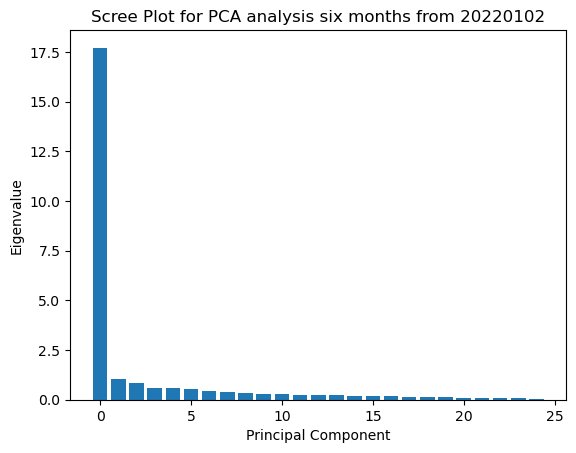

In [131]:
# Scree plot
plt.bar(range(len(eig_values)), eig_values)
plt.title("Scree Plot for PCA analysis six months from 20220102")
plt.xlabel("Principal Component")
plt.ylabel("Eigenvalue")

Text(0, 0.5, 'Cumulative variance (ratio) explained')

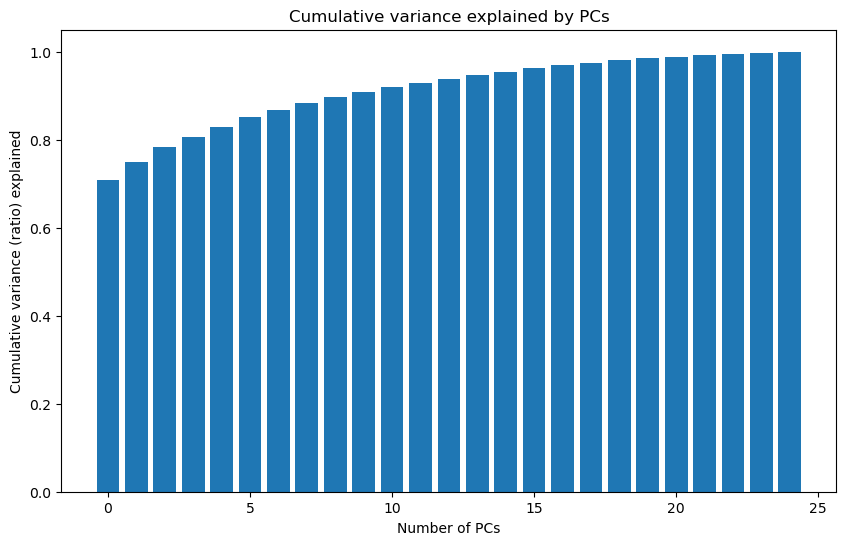

In [132]:
# Cumulative Variance Explained
plt.figure(figsize = (10,6))
plt.bar(range(len(cumulative_explained_var_ratio)), cumulative_explained_var_ratio)
plt.title("Cumulative variance explained by PCs")
plt.xlabel("Number of PCs")
plt.ylabel("Cumulative variance (ratio) explained")

We see that the first five components explain already 80% of our standardized return variance.

Thus, this provides a hint that we might not need more than 5 principal components to construct our eigenportfolios. 

Next, we take a look at our eigenportfolios.

In [133]:
# Construct Eigenportfolios from first five eigenvectors
print(test_data.std().values.shape)
print(eig_vectors.shape)

(25,)
(25, 25)


In [134]:
test_data.std().values

array([0.05431625, 0.06549629, 0.03699673, 0.04561153, 0.04190002,
       0.05646314, 0.05728486, 0.063828  , 0.05091184, 0.05342923,
       0.04552959, 0.04379694, 0.08045976, 0.04818448, 0.05836623,
       0.0759286 , 0.05585253, 0.06180911, 0.06601402, 0.06256341,
       0.04438268, 0.04605787, 0.05897316, 0.05425056, 0.04676404])

In [135]:
# Volatility Weighting
Q = eig_vectors / test_data.std().values[:, np.newaxis]

# Normalize by 1 (axis = 0 to collapse the rows so we sum column-wise)
Q /= abs(Q).sum(axis = 0, keepdims = True)

# Naive weighting
norm_eigvec = eig_vectors.copy()
norm_eigvec /= abs(eig_vectors).sum(axis = 0 , keepdims = True)



##### Remark
- Becareful when we do division for different sized arrays. `test_data.std().values`, a 1D array, is treated as a row vector, so performing the division divides each column by the same number, meaning that we are normalizing the weights by the same volatility for each eigenportfolio. Hence, to do it properly, we convert `test_data.std().values` to a column vector first and then perform the division.

In [136]:
norm_eigvec[0:2]

array([[ 0.04279343,  0.03071379, -0.02032353, -0.01845863,  0.01446782,
        -0.06866806,  0.02387268, -0.01358045,  0.00050946,  0.05155412,
         0.01536576,  0.02354711,  0.03280633, -0.01034976,  0.06876825,
         0.21578859,  0.09733073, -0.01110413,  0.00819708,  0.0345278 ,
         0.01853154,  0.023925  ,  0.01614259,  0.02759302,  0.02853357],
       [ 0.0440014 , -0.02128058, -0.04758853, -0.01085446,  0.03870529,
        -0.01071342, -0.00683584,  0.01809059, -0.0005828 ,  0.08104055,
         0.05424164,  0.04511705, -0.06118639,  0.02139218,  0.03565721,
        -0.05657868,  0.02154609, -0.04858983,  0.01682666, -0.11483544,
         0.05911387, -0.14560867,  0.0489979 ,  0.04094935, -0.05182554]])

In [137]:
Q[0:2]

array([[ 0.04154726,  0.02991415, -0.02165838, -0.01835493,  0.01570344,
        -0.06456043,  0.02381604, -0.01333733,  0.00051671,  0.05283548,
         0.01543921,  0.02295101,  0.03436137, -0.00996905,  0.0708307 ,
         0.20711029,  0.0931722 , -0.01075495,  0.00753746,  0.03259619,
         0.01753663,  0.02421582,  0.01493317,  0.02406693,  0.02584513],
       [ 0.03542786, -0.01718857, -0.04205738, -0.00895106,  0.03483976,
        -0.0083532 , -0.00565553,  0.01473399, -0.00049019,  0.06887755,
         0.04519774,  0.03646851, -0.05314724,  0.017088  ,  0.03045748,
        -0.04503385,  0.0171048 , -0.03902854,  0.01283149, -0.08990562,
         0.04639135, -0.12222151,  0.03758973,  0.02961976, -0.03892956]])

##### Remarks
- Q denotes our eigenportfolio weights (each column corresponds to principal eigenfactor).
- The 1st eigenportfolio has only positive weights. This is consistent with theory that the first eigenportfolio closely tracks the "market" portfolio.
- This is **not a dollar neutral portfolio**. That is, the net weight of each eigenportfolio can be either positive or negative. In practice, after the overall exposure can be neutralized by taking an opposite position in the market index (bitcoin or ethereum).



In [138]:
# daily sample standard deviation over 180-day period
test_data.std()

algorand         0.054316
avalanche        0.065496
bitcoin          0.036997
bitcoin-cash     0.045612
bnb              0.041900
cardano          0.056463
chainlink        0.057285
cosmos           0.063828
cronos           0.050912
dogecoin         0.053429
ethereum         0.045530
ftx-token        0.043797
hex              0.080460
litecoin         0.048184
monero           0.058366
near-protocol    0.075929
polkadot-new     0.055853
polygon          0.061809
shiba-inu        0.066014
solana           0.062563
stellar          0.044383
tron             0.046058
uniswap          0.058973
unus-sed-leo     0.054251
xrp              0.046764
dtype: float64

In [139]:
# Compute eigenportfolio returns using volatility weighting
vw_eigenport_df = pd.DataFrame(test_data @ Q).iloc[:, 0 : 5]
vw_eigenport_df.columns = [f"PC {i+1}" for i in range(5)]

np.cumprod(1 + vw_eigenport_df)


,PC 1,PC 2,PC 3,PC 4,PC 5
timestamp,,,,,
2022-01-02,1.003431,1.002716,1.015697,0.976436,1.008127
2022-01-03,1.000365,1.005981,0.969816,0.989074,1.014494
2022-01-04,0.986892,1.004587,0.960496,0.996002,1.012085
2022-01-05,0.928075,0.999508,0.956275,0.978035,1.041517
2022-01-06,0.929437,1.006320,0.945698,0.977160,1.035539
...,...,...,...,...,...
2022-06-26,0.365084,0.664190,1.206170,1.020849,0.919875
2022-06-27,0.359717,0.671055,1.223408,1.015604,0.916595
2022-06-28,0.341187,0.666531,1.241225,1.015059,0.927928


In [140]:
# Compute eigenportfolio returns using naive weighting
nw_eigenport_df = pd.DataFrame(test_data @ norm_eigvec).iloc[:, 0:5]
nw_eigenport_df.columns = [f"PC {i+1}" for i in range(5)]

np.cumprod(1+ nw_eigenport_df)

,PC 1,PC 2,PC 3,PC 4,PC 5
timestamp,,,,,
2022-01-02,1.000860,1.003507,1.022287,0.971709,1.013213
2022-01-03,1.001854,1.007173,0.968580,0.991294,1.017084
2022-01-04,0.988064,1.005453,0.959769,0.997731,1.013125
2022-01-05,0.928499,0.998728,0.970252,0.975786,1.047556
2022-01-06,0.931122,1.005661,0.956656,0.977632,1.040325
...,...,...,...,...,...
2022-06-26,0.352506,0.635065,1.338595,0.996311,0.941001
2022-06-27,0.346707,0.641583,1.362709,0.988000,0.941722
2022-06-28,0.327897,0.636006,1.396936,0.984353,0.956094


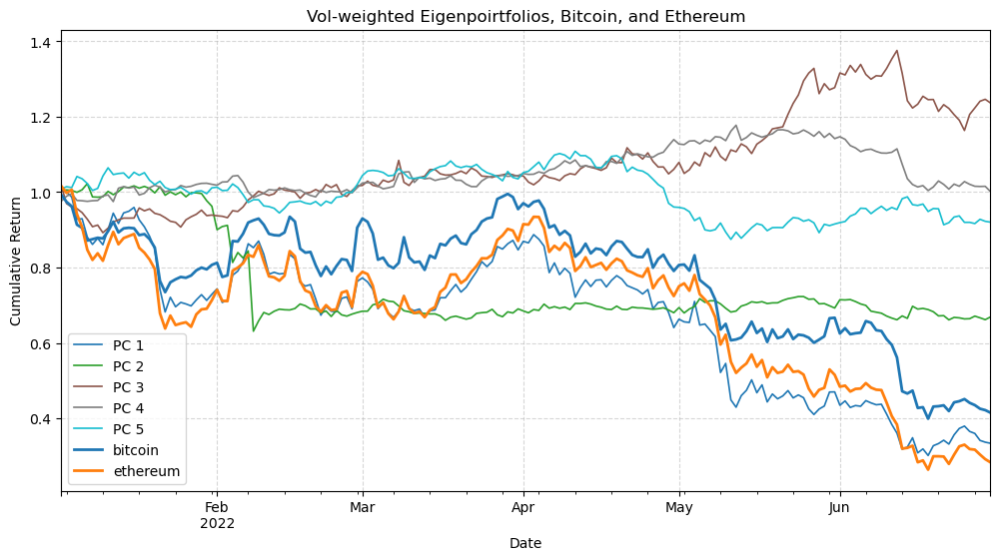

In [141]:
# Plot 5 vol-weighted eigenportfolios, Bitcoin and Ethereum
base_coins = ["bitcoin", "ethereum"]
ax = np.cumprod(1+vw_eigenport_df).plot(figsize = (12,6), legend = True, colormap = "tab10", linewidth = 1.2)

for coin in base_coins:
  np.cumprod(1+ sim_ret.loc[:, coin].iloc[0:len(vw_eigenport_df)]).plot(
      ax=ax, linewidth=2, label = coin)
  
  
plt.title("Vol-weighted Eigenpoirtfolios, Bitcoin, and Ethereum")
plt.legend()
plt.xlabel("Date")
plt.ylabel("Cumulative Return")
plt.grid(True, linestyle='--', alpha=0.5)


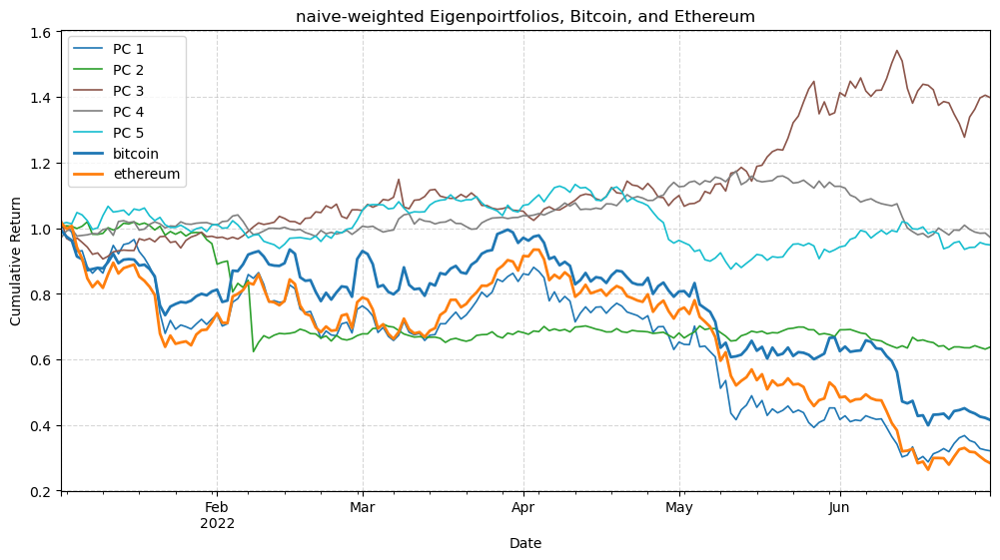

In [142]:
# Compute eigenportfolio returns using naive weightings and plot 5 vol-weighted eigenportfolios, Bitcoin and Ethereum
base_coins = ["bitcoin", "ethereum"]
ax = np.cumprod(1  + nw_eigenport_df).plot(figsize = (12,6), legend = True, colormap = "tab10", linewidth = 1.2)

for coin in base_coins:
  np.cumprod(1  + sim_ret.loc[:, coin].iloc[0:len(nw_eigenport_df)]).plot(
      ax=ax, linewidth=2, label = coin)
  
  
plt.title("naive-weighted Eigenpoirtfolios, Bitcoin, and Ethereum")
plt.legend()
plt.xlabel("Date")
plt.ylabel("Cumulative Return")
plt.grid(True, linestyle='--', alpha=0.5)


#### Remark
- Interestingly, our first principal eigenportfolio, or the "market portfolio," seems to track Ethereum more closely than it tracks bitcoin. This could make sense because there are many altcoins that are more correlated to Ethereum than they are to Bitcoin. Checking the correlation over the six months verifies that our PC1 portfolio tracks ethereum more closely than it tracks bitcoin.


In [143]:
print(np.corrcoef(vw_eigenport_df.iloc[:, 0], np.squeeze(test_data[["bitcoin"]])))
print(np.corrcoef(vw_eigenport_df.iloc[:, 0], np.squeeze(test_data[["ethereum"]])))


[[1.        0.8945898]
 [0.8945898 1.       ]]
[[1.         0.93412671]
 [0.93412671 1.        ]]


#### How frequent should we update our target coin list
As we have seen above, coins that we have selected based on an earlier date can go obsolete when we don't update our target list periodically. A question we ask in this section is: *how serious can the problem grow if we don't update at all*?

That is, we project the original returns onto the principal component space using the target coin list updated on 2022-07-01. 

Text(0, 0.5, 'Cumulative Returns')

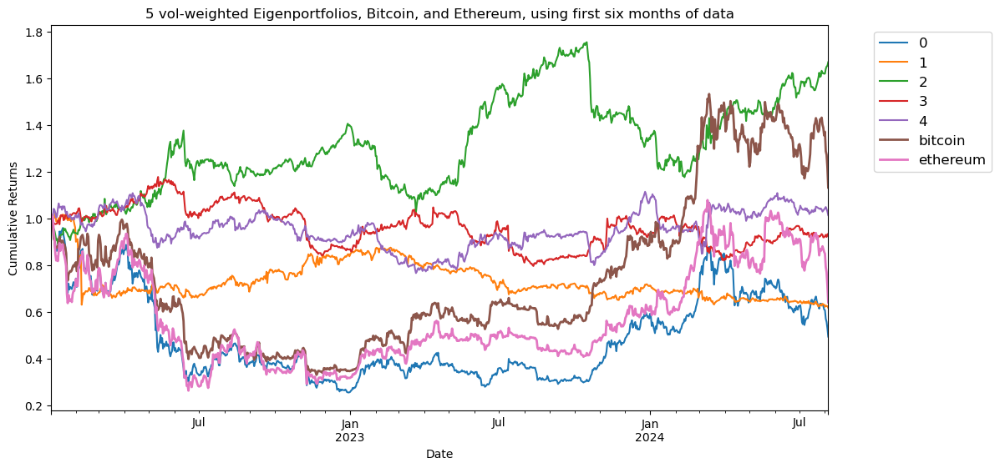

In [144]:
base_coins = ["bitcoin", "ethereum"]
ax = np.cumprod(1 + pd.DataFrame(sim_ret @ Q).iloc[:, 0 : 5]).plot(figsize=(12,6))

for coin in base_coins:
  np.cumprod(1 + sim_ret.loc[:, coin].iloc[:]).plot(ax = ax, label = coin, linewidth = 2) # Change iloc to subset data by smaller observations

plt.legend(loc = "upper left", bbox_to_anchor = (1.05,1), fontsize = "12")
plt.title("5 vol-weighted Eigenportfolios, Bitcoin, and Ethereum, using first six months of data")
plt.xlabel("Date")
plt.ylabel("Cumulative Returns")


The black series is the price series for bitcoin, while the blue series is the 1st eigenportfolio. As you can see, although we are using the weights extracted using the data from 2022-01-01 to 2022-06-30, the first eigenportfolio 1, which is supposed to resemble the "market portfolio" tracks bitcoin and ethereum quite closely for around 4 ~ 6 months after the training period ends. We see a non-trivial divergence starting from the end of 2022, and the gap persists through the rest of the period, and in 2024 we see our "market portfolio" is far from resembling bitcoin and ethereum.

This reflects the fact that the crypto market has been concentrated in a few names, so the past coins still explain the majority of the market dynamics in the present.

This is to some extent reassuring since we don't have to care too much about the issue of updating our target list too frequently. 

##### Remark
- Our third eigenportfolio, surprisingly shows a robust performance across these periods. Of course the result could be largely due to selection bias; however, if the results persist even after incorporating the dynamic update process, then further study on the components of the third eigenportfolio should be conducted.

## 3.2 Dynamic PCA Analysis

From section  `3.1 Static PCA Analysis`, we have looked at how PCA can be conducted using both `numpy` and `scikit learn`, and how the features extracted compare for both methods.

In this section, we will basically be iterating what we have done for the previous section, but by rolling our estimation window forward for six months, maintaining the window length of 180 days.

At each iteration, we will be going over the below steps.

0. Extract the price data of target list. Convert to log return
1. Truncate log return matrix and standardize it
2. Intialize PCA class using sci-kit learn and fit PCA on covariance matrix of the standardized returns (correlation matrix)
3. Save eigenvectors, eigenvalues, factor loadings (scaled eigenvectors), explained variance ratio of each eigenvector, cumulative explained variation ratio, and the number of principal components needed to explain 90% of variance

After going through the iteration for each day for 180 days, we make two visualizations:
- Plot the number of eigenvectors needed to explain 90% of variance over time
- Plot the explained variance of top 5 principal components over time

In [145]:
# Import libraries
import pandas as pd
import numpy as np
import os
import json
import pyarrow.feather as feather
from datetime import datetime, timedelta
from sklearn.decomposition import PCA
from tqdm import tqdm

In [146]:
raw_df = fifr.load_feather_files(data_dir)

In [147]:
# Define analysis period
start_date = datetime.strptime('2022-07-01', '%Y-%m-%d')
analysis_end_date = datetime.strptime(list(raw_df.keys())[-1],'%Y-%m-%d')   # End date

# Extract available dates from the intersection of target list and dataframes
available_dates = sorted(list(set(target_dict.keys()).intersection(set(raw_df.keys()))))
available_dates = [datetime.strptime(date_str, '%Y-%m-%d') for date_str in available_dates]

# Filter dates within the analysis period
analysis_dates = [date for date in available_dates if start_date <= date <= analysis_end_date]
analysis_dates.sort()


In [148]:
raw_df["2022-07-01"]

,timestamp,algorand,avalanche,bitcoin,bitcoin-cash,bnb,cardano,chainlink,cosmos,cronos,...,near-protocol,polkadot-new,polygon,shiba-inu,solana,stellar,tron,uniswap,unus-sed-leo,xrp
0,2022-01-01,1.740108,114.158010,47686.811509,444.456189,527.352722,1.376975,20.665088,36.170463,0.585303,...,15.169566,28.583581,2.574791,0.000034,178.517941,0.276335,0.076610,17.444497,3.803560,0.849472
1,2022-01-02,1.674041,113.186336,47345.220564,447.832642,531.396645,1.377584,21.831890,35.603454,0.587698,...,14.410521,29.731166,2.549190,0.000034,176.382841,0.291703,0.077782,18.369281,3.779418,0.859118
2,2022-01-03,1.788210,108.145212,46458.116959,434.943840,512.135964,1.321637,23.573905,39.300069,0.567292,...,16.429793,30.105100,2.432652,0.000033,170.297747,0.290181,0.077081,18.440538,3.795962,0.832885
3,2022-01-04,1.674683,103.239241,45897.575827,427.524334,507.506111,1.311658,23.525865,41.987126,0.551803,...,16.014060,28.777731,2.367248,0.000032,167.938906,0.279667,0.076200,18.260072,3.783945,0.824673
4,2022-01-05,1.559897,97.852579,43569.003348,401.572519,475.056933,1.236002,25.447802,38.793359,0.504330,...,15.379840,26.796141,2.195475,0.000030,155.099733,0.267280,0.071382,17.203540,3.801806,0.774358
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
943,2024-08-01,0.134730,25.723108,65357.501563,413.147226,575.146705,0.392706,12.899767,5.782392,0.087353,...,4.987798,5.342949,0.491843,0.000016,167.672121,0.099342,0.128167,7.192256,5.843492,0.596464
944,2024-08-02,0.124071,23.594503,61415.064573,381.553088,542.915190,0.363822,11.917962,5.356243,0.083088,...,4.597735,5.122200,0.467864,0.000015,152.638227,0.095510,0.123375,6.606783,5.670413,0.560771
945,2024-08-03,0.120628,22.683568,60680.094699,364.384602,529.481326,0.364095,11.701331,5.129635,0.082140,...,4.365372,5.043666,0.454763,0.000014,142.922002,0.093412,0.125306,6.629199,5.666651,0.556391
946,2024-08-04,0.114632,21.227669,58116.976961,331.857666,497.039094,0.343938,10.871527,5.039577,0.077804,...,4.132936,4.683842,0.420976,0.000013,138.055084,0.088190,0.126275,6.147510,5.653328,0.523396


In [149]:
# Load Dynamic PCA results
import pickle

try:
    # Attempt to load precomputed results
    with open("pca_results.pkl", "rb") as f:
        results = pickle.load(f)
    
    # Unpack results into variables
    eigenvectors_list = results["eigenvectors_list"]
    eigenvalues_list = results["eigenvalues_list"]
    explained_variance_ratio_list = results["explained_variance_ratio_list"]
    cumulative_explained_variance_ratio_list = results["cumulative_explained_variance_ratio_list"]
    n_components_90_list = results["n_components_90_list"]
    dates_list = results["dates_list"]
    top5_explained_variance_ratio_list = results["top5_explained_variance_ratio_list"]
    
    print("Loaded precomputed PCA results!")
    
except FileNotFoundError:
    print("No precomputed results found. Run the PCA cell to generate data.")

Loaded precomputed PCA results!


In [150]:
if not eigenvectors_list:

    # Initialize lists to store outputs
    eigenvectors_list = []
    eigenvalues_list = []
    explained_variance_ratio_list = []
    cumulative_explained_variance_ratio_list = []
    n_components_90_list = []
    dates_list = []
    top5_explained_variance_ratio_list = []
    
    # Set window size for rolling estimation
    window_size = 180  # Days
    
    # Loop over each date in the analysis period
    for current_date in tqdm(analysis_dates, desc='Performing Dynamic PCA'):
        date_str = current_date.strftime('%Y-%m-%d')
        start_date_str = (current_date - timedelta(days = window_size)).strftime('%Y-%m-%d')
    
        # Get the target list for the current date
        target_coins = target_dict[date_str]
    
        # Get the price data up to the current date
        df_current = fifr.get_desired_dataframe(data_dir, date_str)
        if df_current is None:
            print(f"No data for date {date_str}, skipping.")
            continue
        
        # Set 'timestamp' as index and convert to datetime
        target_price = df_current.copy()
        target_price.set_index('timestamp', inplace=True)
        target_price.index = pd.to_datetime(target_price.index)
    
        # Select only the target coins
        target_price = target_price[target_coins]
    
        # Check if we have enough data (window_size + 1 due to differencing)
        if len(target_price) < window_size + 1:
            print(f"Not enough data for date {date_str}, skipping.")
            continue
        
        # Calculate daily log returns
        ret_dy = (target_price / target_price.shift(1) - 1).dropna()
    
        # Truncate log returns to the last 'window_size' days
        ret_window = ret_dy.loc[start_date_str:current_date]
    
        # Standardize the log returns
        mean_ret = ret_window.mean()
        std_ret = ret_window.std()
        standardized_ret_dy = (ret_window - mean_ret) / std_ret
    
        # Drop any columns with NaNs (in case of missing data)
        standardized_ret_dy.dropna(axis=1, inplace=True)
    
        # Adjust std_log_ret to include only the assets in standardized_log_ret
        std_ret = std_ret[standardized_ret_dy.columns]
    
        # Check if we have at least two assets
        if standardized_ret_dy.shape[1] < 2:
            print(f"Not enough assets for date {date_str}, skipping.")
            continue
        
        # Initialize and fit PCA on standardized data
        pca = PCA()
        pca.fit(standardized_ret_dy)
    
        # Extract PCA outputs
        eigenvectors = pca.components_.T  # Each column is an eigenvector
        eigenvalues = pca.explained_variance_  # Eigenvalues of correlation matrix
        explained_variance_ratio = pca.explained_variance_ratio_
        cumulative_explained_variance_ratio = np.cumsum(explained_variance_ratio)
    
        # Determine the number of components needed to explain 80% of variance
        n_components_90 = np.argmax(cumulative_explained_variance_ratio >= 0.90) + 1 # argmax of boolean returns index of first true value
    
    
        # Save outputs to lists
        eigenvectors_list.append(eigenvectors)
        eigenvalues_list.append(eigenvalues)
        explained_variance_ratio_list.append(explained_variance_ratio)
        cumulative_explained_variance_ratio_list.append(cumulative_explained_variance_ratio)
        n_components_90_list.append(n_components_90)
        dates_list.append(current_date)
        top5_explained_variance_ratio_list.append(explained_variance_ratio[:5])
        ## Save dynamic PCA results
    
    import pickle
    import numpy as np
    
    # After your PCA loop, add this code to save the results
    results = {
        "eigenvectors_list": eigenvectors_list,
        "eigenvalues_list": eigenvalues_list,
        "explained_variance_ratio_list": explained_variance_ratio_list,
        "cumulative_explained_variance_ratio_list": cumulative_explained_variance_ratio_list,
        "n_components_90_list": n_components_90_list,
        "dates_list": dates_list,
        "top5_explained_variance_ratio_list": top5_explained_variance_ratio_list
    }
    
    # Save to a file
    with open("pca_results.pkl", "wb") as f:
        pickle.dump(results, f)
else:
    print("Skip Dynamic PCA Analysis: Already loaded results")

Skip Dynamic PCA Analysis: Already loaded results


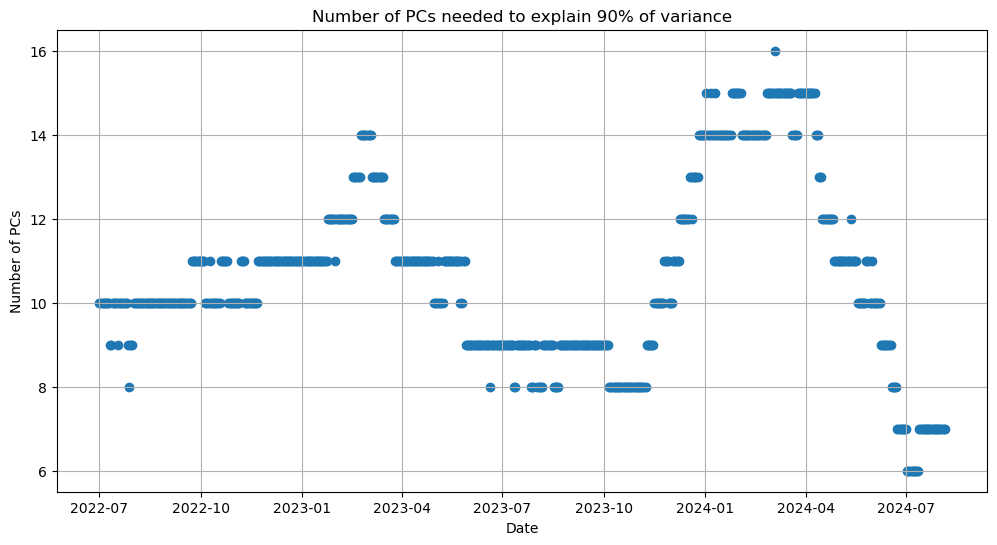

In [151]:
# Convert dates_list to pandas datetime index
dates_index = pd.to_datetime(dates_list)

# Plot the number of principal components needed over time
plt.figure(figsize=(12, 6))
plt.scatter(dates_index, n_components_90_list)
plt.title("Number of PCs needed to explain 90% of variance")
plt.xlabel("Date")
plt.ylabel("Number of PCs")
plt.legend
plt.grid(True)



##### Remarks
- On average, 10 components are needed to explain 90% of variance over the study period. 
- The number of components needed sharply drop from April of 2024. 

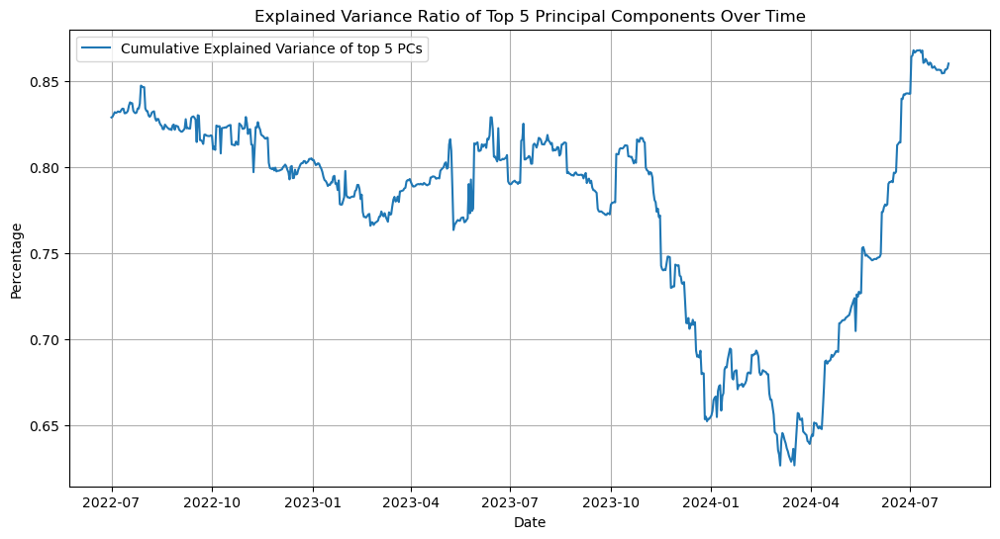

In [152]:
# Create DataFrame for top 5 explained variance ratios
top5_cumulexp_variance_ratio_list = [cumulative_explained_variance_ratio_list[i][4] for i in range(len(cumulative_explained_variance_ratio_list))]

# Plot explained variance ratios over time
plt.figure(figsize=(12, 6))
plt.plot(dates_index, top5_cumulexp_variance_ratio_list, label = "Cumulative Explained Variance of top 5 PCs")
plt.title('Explained Variance Ratio of Top 5 Principal Components Over Time')
plt.xlabel("Date")
plt.ylabel("Percentage")
plt.legend()
plt.grid(True)
plt.show()


##### Remarks
- We see that the top 5 principal components explained amlomst 85% of the variance at the start of the period and at the end of the period. In another words, the market was concentrated in both of these periods, but we know that the former period was bearish while the latter period was bullish.
- Using a fixed number of 5 principal components is equivalent to stating that we used principal components explaining on average 75% of the variance.
- Because of the concentrated nature of the crypto market, we see that the top few eigenvectors explain much more variance than the top few eigenvectors of the public equity market. This could be an indicator that conducting pairs trading strategy in crypto is easier than it is in the equity space.
- Because the cumulative explained variance ratio changes non-trivially across time, it might be prudent to dynamically update the number of principal components used to explain a fixed percentage of variance. By eye-balling, six months could be a rationale choice, given the trade off of higher trading costs versus loss of representativeness.

# 4. Constructing Mean Reverting Series
In this section, we will construct synthetic portfolios using our eigenportfolios to create a mean reverting series.

While one could adopt one of various approaches from here, we will follow Avellaneda's convention.

1. Conduct linear regression of individual asset return series on the top five eigenportfolio returns. Use 90 days rolling estimation window to find hedge ratios and residual series.
2. Take the cumulative sum of the residual series to find the "auxilliary process" defined by Avellaneda. While the previous residual series was more of a "return" series, the auxilliary process can be regarded as "price" series.
3. While from here there are many approaches, we again follow convention by estimating the mean-reverting series as the Ornstein-Uhlenbeck process. We use the AR(1) to estimate parameters.
4. Use estimation to compute important statistics, such as equilibrium moments, mean-reversion period, and s-scores.
5. Repeat steps 1. ~ 4. for all our coins included in the target coin list.


#### Difference from the paper
Now, unlike Avellaneda, we use different rolling window lengths for the factor regression and AR(1) regression. The reason is more of a fundamental one than a statistical one; we want to test the hypothesis that crypto market has a much faster changing market dynamic compared to the public equity space, so using a shorter window length of 60 days (at the cost of loss of informaiton and lower efficiency) reflects reality to a closer degree than using a window length of 90 days.

For comparison, we also conduct the study as stipulated in the paper.

#### Brief Exposition on Ornstein-Uhlenbeck(OU) Process

## 4-1. Static Analysis
First, we will use data from 2022-01-01 to 2022-06-30 to construct our eigenportfolios and regress each coin from our test coin list (selected on 2022-07-01) on the returns of our top 5 eigenportfolios. We will use 90 days worth of data to estimate the beta coefficients. Then, using the estimated beta coefficients, we construct the residual series and take the cumulative sum to engineer the auxiliary series. The resulting series will be then estimated via the OU process (for estimation method, we conduct AR(1) regression). 

### Factor Regression
The first code block is the preparation step. The next code block will be the factor regression step.

In [153]:
# Extract target coin based on date
test_date_str = "2022-07-01"
window_size = 180
test_start_date = (datetime.strptime(test_date_str, '%Y-%m-%d') - timedelta(days = window_size)).strftime("%Y-%m-%d")
test_coins = target_dict.get(test_date_str)

# Extract price data frame based on date
test_df = fifr.get_desired_dataframe(data_dir, test_date_str) # data_dir is path where parquet price files are located in

# Construct log ret dataframe
if test_df is None:
  print(f"No data for date {test_date_str}")

test_price = test_df.copy()
test_price.set_index("timestamp", inplace = True)
test_price.index = pd.to_datetime(test_price.index)

test_ret = (test_price/test_price.shift(1) - 1).dropna()

# Calculate volatility after truncating
test_ret_mean = test_ret.loc[test_start_date:test_date_str].mean()
test_ret_sdv = test_ret.loc[test_start_date:test_date_str].std()

# Construct eigenvectors dictionary indexed by date
eigenvectors_dic = {}
i = 0
for date in available_dates:
  eigenvectors_dic[date.strftime('%Y-%m-%d')] = eigenvectors_list[i] # eigenvectors_list is constructed from the loop above
  i += 1

# Extract eigenvector matrix using date filter
test_eigenvec = eigenvectors_dic[test_date_str]

# Construct vol-weighted portfolio
test_Q = test_eigenvec / test_ret_sdv.values[:, np.newaxis]

# Normalize by 1
test_Q /= abs(test_Q).sum(axis = 0, keepdims = True)

# Compute eigenportfolio returns using vol-weighting
test_eigportret_df = pd.DataFrame(test_ret @ test_Q).iloc[:, 0:5]
test_eigportret_df.columns = [f"PC {i+1}" for i in range(5)] 


In [154]:
test_eigportret_df

,PC 1,PC 2,PC 3,PC 4,PC 5
timestamp,,,,,
2022-01-02,0.003458,-0.002527,-0.016306,-0.024197,-0.004941
2022-01-03,-0.003109,-0.003498,0.045733,0.013662,-0.007030
2022-01-04,-0.013497,0.001298,0.009954,0.007505,0.001539
2022-01-05,-0.059572,0.005187,0.003964,-0.020024,-0.025684
2022-01-06,0.001447,-0.006888,0.011126,0.000010,0.005845
...,...,...,...,...,...
2024-08-01,-0.005355,0.013560,-0.000293,0.004792,-0.005623
2024-08-02,-0.060203,-0.008100,-0.012402,0.005935,-0.006113
2024-08-03,-0.023774,0.003067,-0.006314,-0.009029,0.009741


##### Remarks
- Note that if we use data from 2022-01-01 to 2022-07-01, this implies that we should generate trading signal for 2022-07-02, or else we would including look-forward bias. Since we are trading cryptocurrencies, we can trade within the next hour after aggregating data, engineering features, computing forecasts, and generating trading signals. If we were trading equity, it is safer to use data up until T-2, where T is the time we intend to execute our trade.
- It is wrong to standardize the data before truncating, since when we do this we standardize using the first two moments of the *entire period*, which is an instance of look-forward bias. In the case above, we don't truncate but instead find the mean and sdv of the truncated df and use the entire df to find the eigenportfolio of the entire period.
- When we perform `logret matrix` @ `Q_matrix (vol-weighted eigenvector matrix)` and take the first five column vectors, we are left with top 5 eigenportfolio return matrix, starting from 2022-01-02 and ending at 2024-08-05. In essence, the eigenportfolio returns from 2022-01-02 to 2022-07-01 are *in-sample* returns, since we are reconstructing the return matrix using the principal components computed from data in the same range. Thus, the return matrix ranging from 2022-07-02 to 2024-08-05 are so called *forecasted* or *out-of-sample* returns.
- We use the last 90 observations from the *in-sample* eigenportfolio returns to construct our mean-reverting auxiliary series and model them with the OU process. Then, after computing the parameters of the OU process, we select mean-reverting pairs and set rules for generating trading signals (s-score defined in Avellaneda paper is used, but we can also use Bollinger Bands). Then, **based on T-1 value of the auxiliary series, we generate trading signal for start of time T**. After the end of time T, we again calculate the logret matrix, use the *same Q_weights* to get the updated eigenportfolio returns, and then use the *same hedge ratios* to calculate the updated auxiliary series. Then, we take the *new last 90 observations of the auxiliary series* to estimate the OU parameters, generate trading signals for day T + 1, and then decide:
  1. close out already open positions (hitting target mean level, hitting stop loss level (if one exists), or becoming labeled as *non-reverting auxiliary series*)
  2. open new positions from trading signals
- We update our hedging ratios at least on a *weekly basis* to generate new auxiliary series, and thus estimate OU parameters and generate trading signals for the next trading time.
- At least every month, we update our eigenportfolio returns, meaning that we use a new trading universe. In this case, we can close all existing positions or instead essentially "run a separate account" where we use new eigenportfolio returns, new hedging ratios, and new OU parameters to generate trading signals for time T using data range T-90 : T-1. Then, we manage the "new account" while maintaining the "old account", perhaps adding a *time-based stop* to prevent from maintaining positions that no longer possess mean-reverting properties.
- Recall that we estimate OU process for all cryptocurrencies in our trading universe, and the final position is *a combination of the cryptocurrencies in our target list*. 

In [155]:
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression

In [156]:
# Convert datetime list object to list of string date values
dates_str_list = [i.strftime("%Y-%m-%d") for i in dates_list]
dates_str_list[0:5]

['2022-07-01', '2022-07-02', '2022-07-03', '2022-07-04', '2022-07-05']

In [157]:
test_eigportret_df.columns.to_list()

['PC 1', 'PC 2', 'PC 3', 'PC 4', 'PC 5']

In [158]:
def rolling_factor_regression(coin_returns, eigport_returns, dates, window = 90, include_intercept = 1):
  """
  Conduct rolling regression where we regress individual asset return on returns of top 5 eigenportfolio returns. 
  
  Parameters:
    coin_returns (pd.DataFrame): full log return data of target coins (extracted based on date parameter)
    eigport_returns (pd.DataFrame): eigenportfolio log return data matrix (starting from left, we have PC 1 portfolio)
    dates (list) : list of date string values in the format of %Y-%m-%d, used as end date index for factor regression
    window (int) : default value of 90. date - window = start date index for factor regression
    include_intercept: default value of 1 (True). If 1, we conduct regression with intercept included; if 0, conduct regression with intercept excluded.
      Generally, conduct regression with intercepts to check whether intercept values can be ignored. If we judge that intercepts are trivial, then run rolling regression again with include_intercept = 0


  Required dependencies:
    numpy, pandas, sklearn.linear_model (LinearRegression), datetime (timedelta, strptime, strftime)

  Returns:
    Two dfs

    coef_df : df storing values of regression coefficients (six including constant coefficient). 
      columns = ["constant", "PC 1"  : "PC 5"], indexed by dates
    R_sq_df : df storing R-squared values, indexed by dates
  """
  # Initialization
  coins = list(coin_returns.columns)
  beta_coeff = {coin: [] for coin in coins}
  R_sq = {coin: [] for coin in coins}
  date_idx = []

  if include_intercept == 1:
    col_name = eigport_returns.columns.to_list()
    col_name.insert(0, "constant")

    for date in dates:
      # Preparation
      end_date = pd.to_datetime(date)
      start_date = end_date - timedelta(days = window - 1)

      # truncate return df to prepare for regression
      coin_returns_window = coin_returns.loc[start_date:end_date]
      eigport_returns_window = eigport_returns.loc[start_date:end_date]

      date_idx.append(end_date)

      for coin in coins:
        linreg = LinearRegression(fit_intercept = True).fit(eigport_returns_window, coin_returns_window[coin])
        coeff_array = np.insert(linreg.coef_, 0, linreg.intercept_, axis = None)
        beta_coeff[coin].append(coeff_array)
        R_sq[coin].append(linreg.score(eigport_returns_window, coin_returns_window[coin]))
    
  elif include_intercept == 0:
    col_name = eigport_returns.columns.to_list()

    for date in dates:
      # Preparation
      end_date = pd.to_datetime(date)
      start_date = end_date - timedelta(days = window)

      # truncate return df to prepare for regression
      coin_returns_window = coin_returns.loc[start_date:end_date]
      eigport_returns_window = eigport_returns.loc[start_date:end_date]

      date_idx.append(end_date)

      for coin in coins:
        linreg = LinearRegression(fit_intercept = False).fit(eigport_returns_window, coin_returns_window[coin])
        beta_coeff[coin].append(linreg.coef_)
        R_sq[coin].append(linreg.score(eigport_returns_window, coin_returns_window[coin]))
        
      
  coef_df = {key: pd.DataFrame(vals, index = date_idx, columns = col_name) for key, vals in beta_coeff.items()}
  R_sq_df = pd.DataFrame(R_sq, index = date_idx)

  return coef_df, R_sq_df
   



In [159]:
import numpy as np
import pandas as pd
import statsmodels.api as sm
from datetime import timedelta

def rolling_factor_regression_statsmodels(
    coin_returns, 
    eigport_returns, 
    dates, 
    window=90, 
    include_intercept=1, 
    return_tstats=False
):
    """
    Conduct rolling regression where we regress individual asset (coin) log returns 
    on returns of top eigenportfolio (log) returns using statsmodels.

    Parameters:
    -----------
    coin_returns : pd.DataFrame
        Full log return data of target coins (indexed by date).
        Columns = coin names, index = daily dates.
    eigport_returns : pd.DataFrame
        Eigenportfolio log returns. Columns = PC1, PC2, ...,
        index = daily dates.
    dates : list
        List of date strings (format '%Y-%m-%d'), used as the end-date indices for 
        factor regression. For each date in 'dates', we define the regression window 
        as [date - window + 1, date].
    window : int, default=90
        Rolling window size in days.
    include_intercept : int, default=1
        If 1, we include an intercept in the regression. If 0, no intercept.
    return_tstats : bool, default=False
        If True, also return a dictionary of DataFrames that contain t-stats for 
        each coin and each predictor, keyed by the date.

    Returns:
    --------
    coef_df : dict of pd.DataFrame
        Dictionary whose keys are coin names, and values are DataFrames 
        (indexed by 'dates') of regression coefficients.
        Columns = ["constant", "PC1", "PC2", ...] if include_intercept=1,
                  or just ["PC1", "PC2", ...] if include_intercept=0.
        The row index is the date (end_date).
    R_sq_df : pd.DataFrame
        DataFrame of R-squared values. Columns = coin names, 
        row index = date (end_date).
    (Optional) tstats_dict : dict of pd.DataFrame
        Only returned if return_tstats=True.
        Keys = date (end_date).
        Values = DataFrame of shape (n_coins, n_predictors),
        rows = coins, columns = predictor names.
        The entries are the t-statistics of the corresponding regression coefficients.
    """
    # --- Initialize structures ---
    coins = list(coin_returns.columns)

    # We will store coefficient arrays and R^2 in a dict of lists, keyed by coin
    beta_coeff = {coin: [] for coin in coins}
    R_sq = {coin: [] for coin in coins}
    date_idx = []

    # If returning t-stats, we will store them keyed by date
    # Each date => a DataFrame (index = coin, columns = predictor names)
    if return_tstats:
        tstats_dict = {}

    # --- Choose column names for coefficients ---
    if include_intercept == 1:
        # If we add a constant, we'll do so after the window slicing
        col_name = eigport_returns.columns.to_list()
        col_name.insert(0, "const")
    else:
        col_name = eigport_returns.columns.to_list()

    # --- Rolling loop over the specified 'dates' ---
    for date_str in dates:
        end_date = pd.to_datetime(date_str)
        start_date = end_date - timedelta(days=window - 1)

        # Check if data length is long enough
        if start_date < coin_returns.index[0]:
            date_idx.append(end_date)

            for coin in coins:
                coef_array = np.array([np.nan for i in range(len(col_name))])
                beta_coeff[coin].append(coef_array)
                R_sq[coin].append(np.nan)  

                if return_tstats:
                    tstats_df_date = pd.DataFrame(index=coins, columns=col_name, dtype=float)
                    tstats_df_date.loc[coin, col_name] = np.array([np.nan for _ in range(len(col_name))])
                
        
        else:

            # Slice data for the window
            coin_returns_window = coin_returns.loc[start_date:end_date]
            eigport_returns_window = eigport_returns.loc[start_date:end_date]

            # We'll store t-stats for each coin in this date if requested
            if return_tstats:
                # prepare an empty DataFrame for t-stats at this date
                # index = coins, columns = col_name
                tstats_df_date = pd.DataFrame(index=coins, columns=col_name, dtype=float)

            # Record the date in date_idx
            date_idx.append(end_date)

            # --- Regress each coin on the factors ---
            for coin in coins:
                y = coin_returns_window[coin].values
                X = eigport_returns_window.values

                if include_intercept == 1:
                    X = sm.add_constant(X)  # adds column of ones as first col

                # Fit statsmodels OLS
                model = sm.OLS(y, X, missing='drop')
                results = model.fit()

                # Coefficients
                coeff_array = results.params  # np array (including constant if added)
                # R^2
                rsq_value = results.rsquared

                beta_coeff[coin].append(coeff_array)
                R_sq[coin].append(rsq_value)

                if return_tstats:
                    # t-values for each coefficient
                    tvals = results.tvalues
                    # Place them in the DataFrame row for this coin
                    tstats_df_date.loc[coin, col_name] = tvals
            
        # After looping all coins, store the t-stats DataFrame in tstats_dict
        if return_tstats:
            tstats_dict[end_date] = tstats_df_date


    # --- Build final DataFrames for coefficients and R^2 ---
    coef_df = {}
    for coin in coins:
        # each coin => DataFrame of shape (len(dates), n_predictors)
        df_coin = pd.DataFrame(
            beta_coeff[coin], 
            index=date_idx, 
            columns=col_name
        )
        coef_df[coin] = df_coin

    # R^2 => single DataFrame
    R_sq_df = pd.DataFrame(R_sq, index=date_idx)

    # If returning t-stats, we do so
    if return_tstats:
        return coef_df, R_sq_df, tstats_dict
    else:
        return coef_df, R_sq_df


In [160]:
# Test rolling factor regression using eigenportfolios extracted on 2022-07-01
coef_df, R_sq_df = rolling_factor_regression(test_ret, test_eigportret_df, dates_str_list, window = 90, include_intercept = 0)


KeyboardInterrupt: 

In [112]:
coef_df2, _ , t_stats_df = rolling_factor_regression_statsmodels(test_ret, test_eigportret_df, dates_str_list, window = 90, include_intercept=1, return_tstats=True)

<Axes: xlabel='timestamp'>

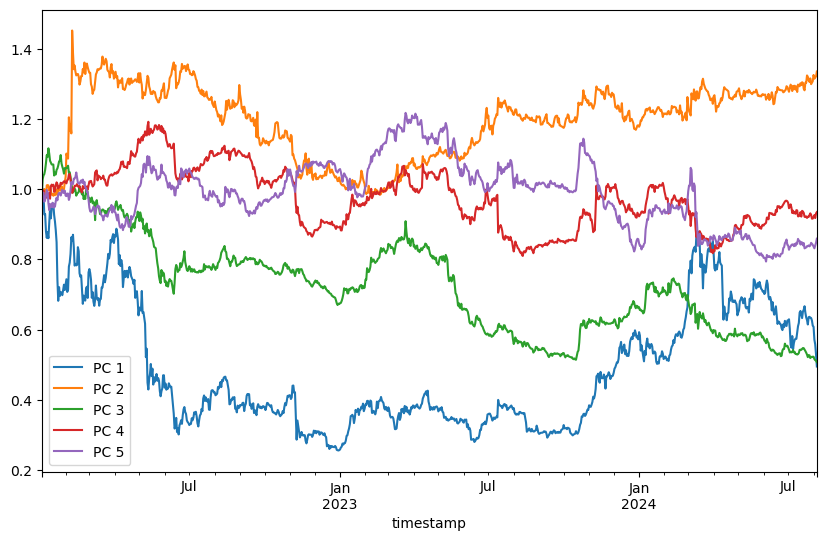

In [113]:
np.cumprod(1 + test_eigportret_df).plot(figsize = (10,6))

<Axes: >

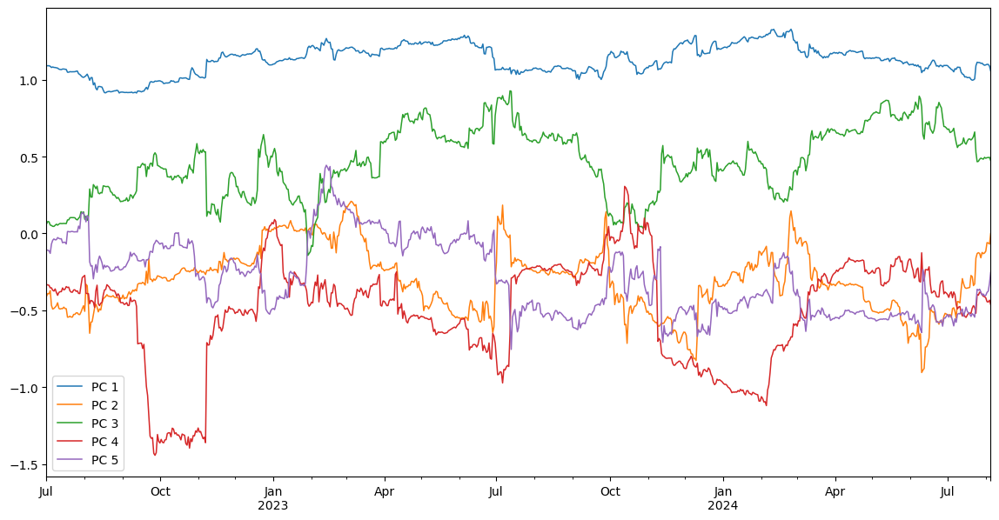

In [114]:
coef_df["algorand"].plot(figsize = (14,7), linewidth = 1.1)

C:\Users\idkup\anaconda3\Lib\site-packages\pandas\plotting\_matplotlib\core.py:580: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = self.plt.figure(figsize=self.figsize)


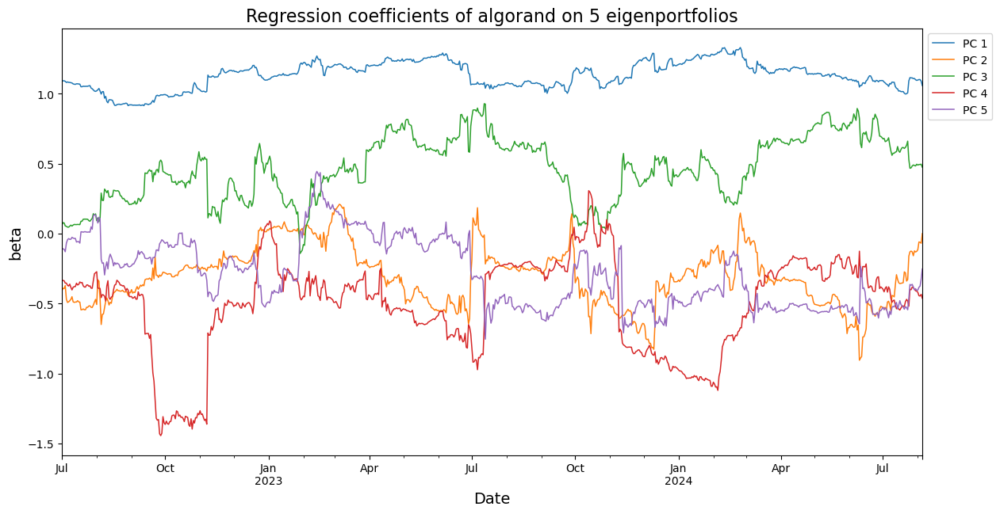

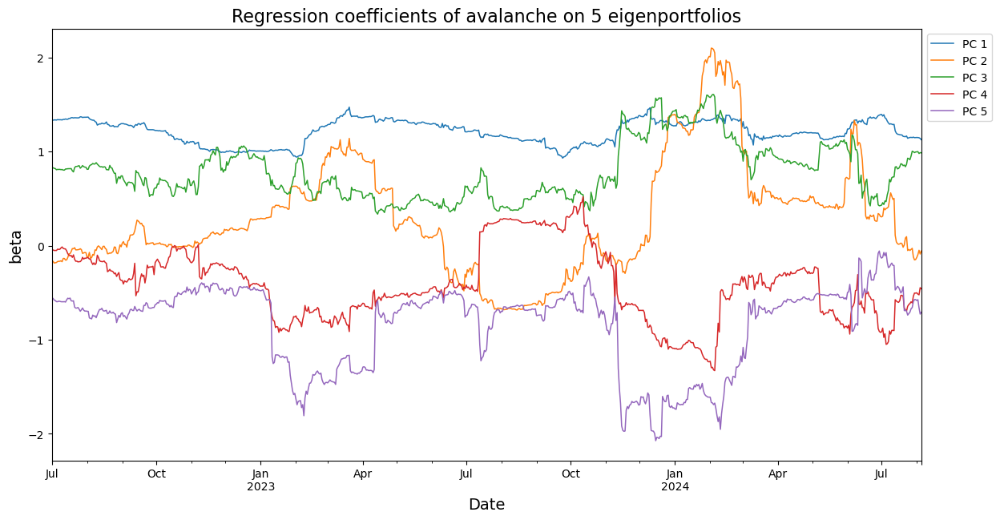

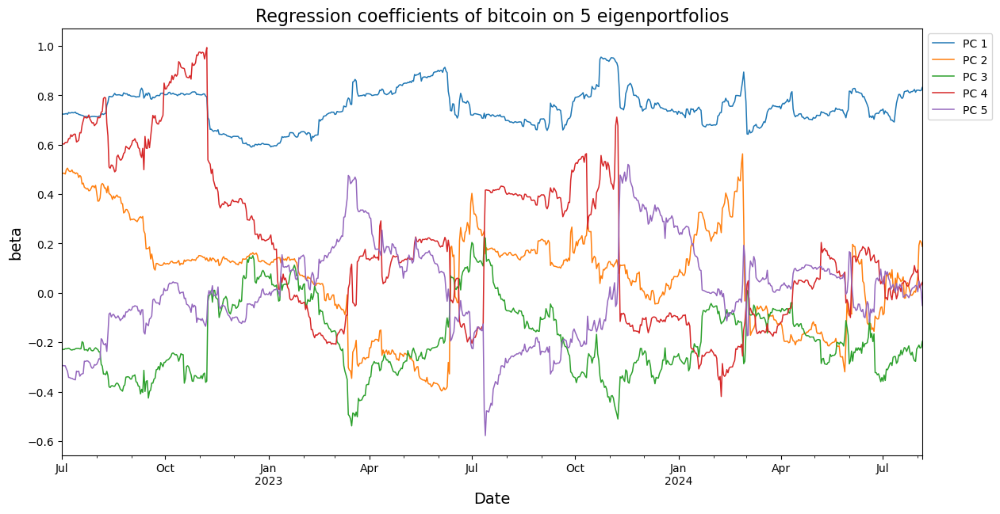

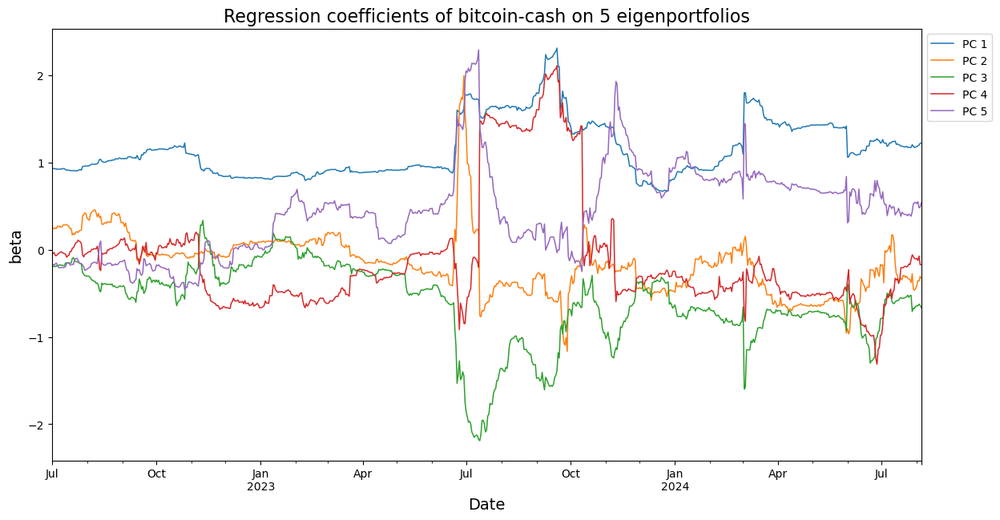

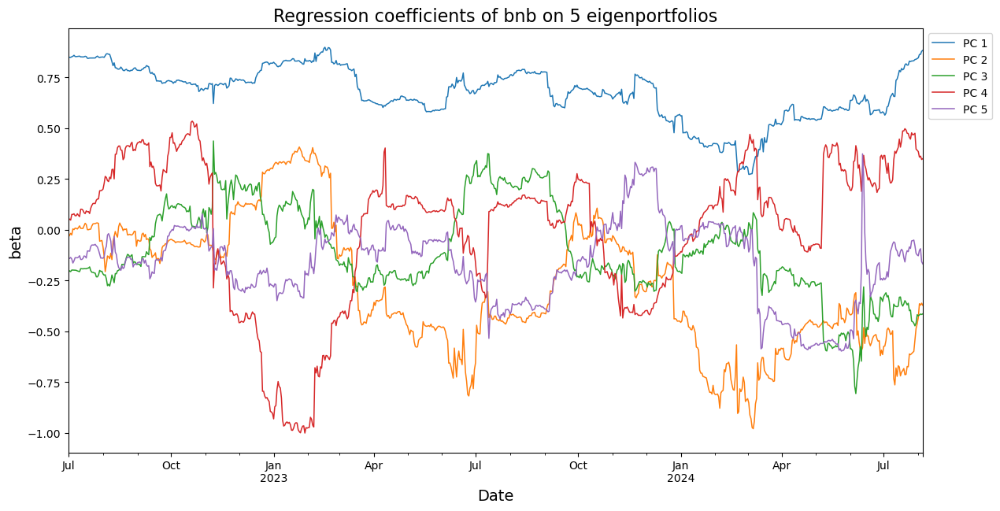

...

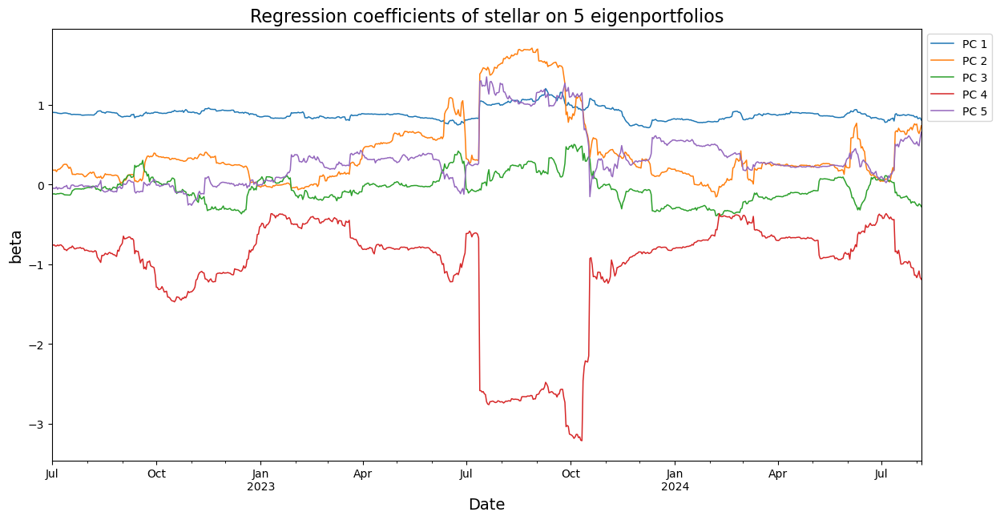

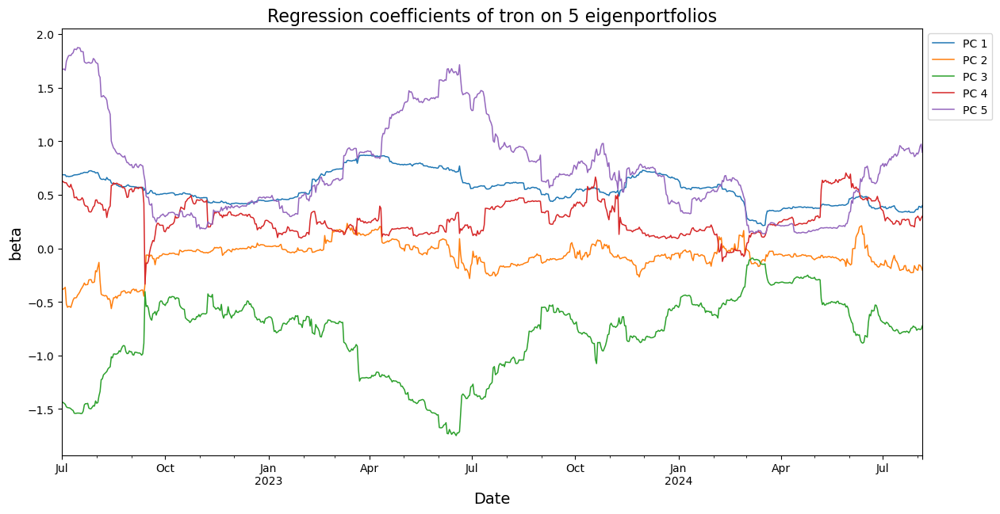

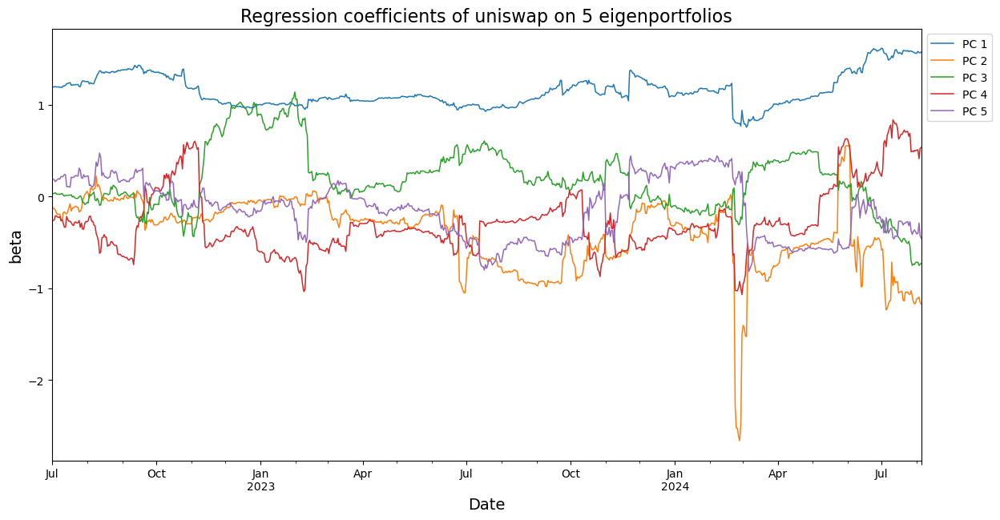

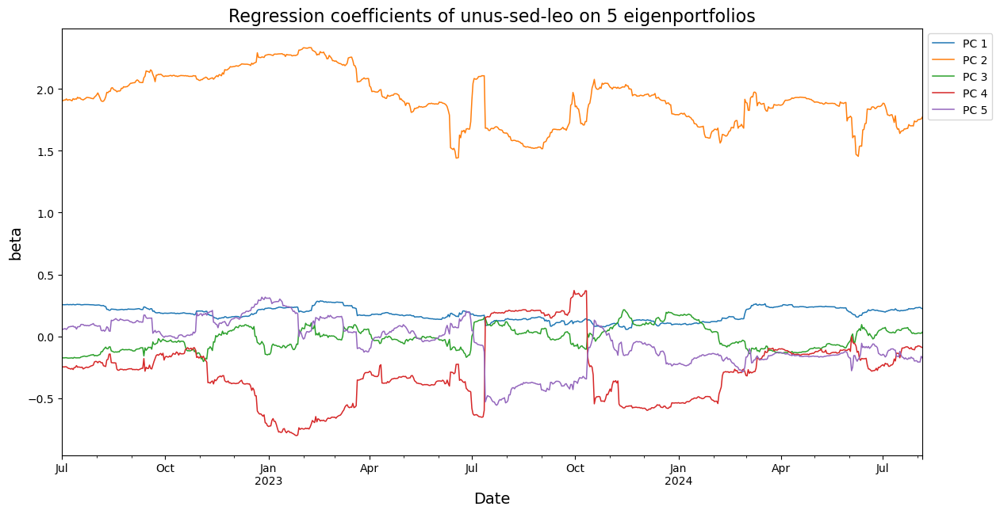

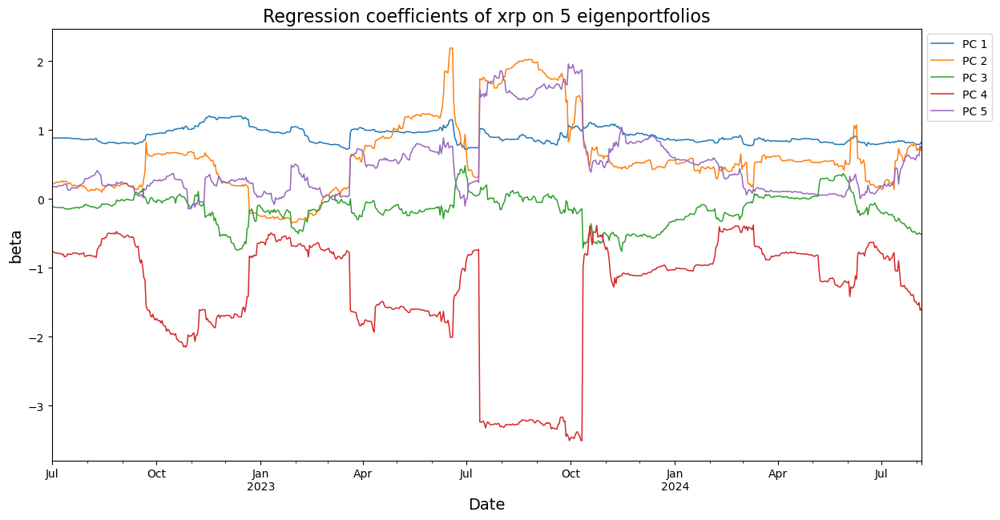

In [115]:
# Plot rolling beta coefficients
for key in coef_df.keys():
  coef_df[key].plot(figsize = (14,7), linewidth = 1.1)
  plt.title(f'Regression coefficients of {key} on 5 eigenportfolios', fontsize=16)
  plt.xlabel('Date', fontsize=14)
  plt.ylabel('beta', fontsize=14)
  plt.legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize=10)  # Adjust legend position

#### Remarks
- Note that we use the *same trading universe*, and hence, the same eigenportfolio returns to conduct factor regression over the entire testing period. In reality, we would update our trading universe to get new principal components and update hedging ratios more often (e.g., weekly basis) and reconstruct the auxiliary series to get new trading signals for next trading time.
- The constant is small enough to be ignored for all coins, indicating drift is trivial.
- In general, the beta coefficient of principal eigenportfolio (PC1) is most stable and close to 1.
- (PC 2, PC 4) and (PC 3, PC  5) seem to be "pairs", in the sense that the regression coefficients covary (sign could be positive or negative)
- As time passes, stability of regression coefficients deteriorates, indicating the need for rebalancing every 1 ~ 2 months. From the plot, 1 month seems to be a good candidate for the rebalancing frequency.

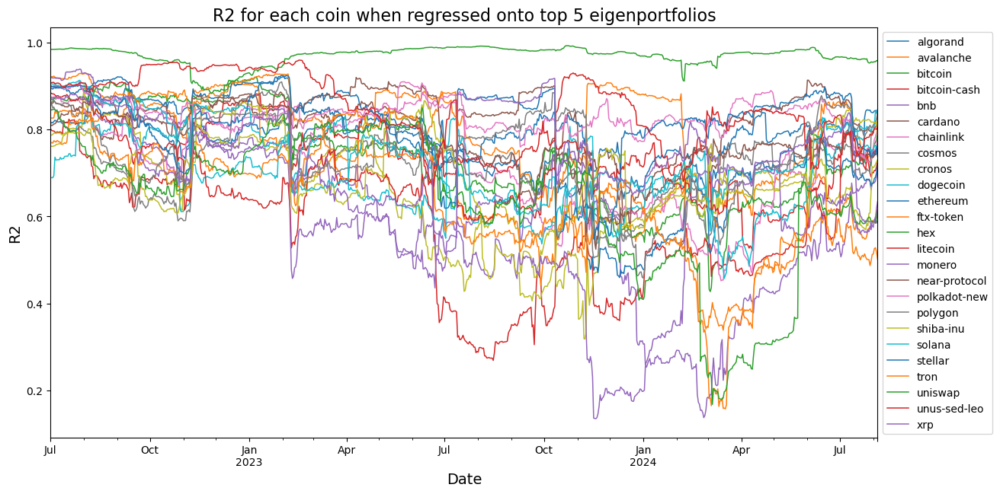

In [116]:
# Plot rolling R2 values 
R_sq_df.plot(figsize = (14,7), linewidth = 1.1)

plt.title('R2 for each coin when regressed onto top 5 eigenportfolios', fontsize=16)
plt.xlabel('Date', fontsize=14)
plt.ylabel('R2', fontsize=14)
plt.legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize=10)  # Adjust legend position



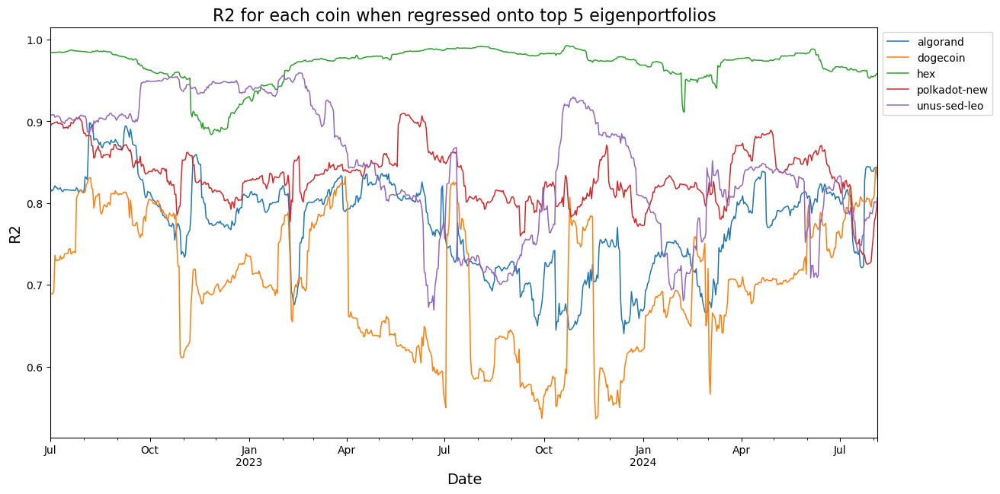

In [117]:
# Plot R2 values that meet threshold
tolerance = 0.3 # Set tolerance as 30%
starting_val = R_sq_df.iloc[0]
upper_band = starting_val * (1 + tolerance)
lower_band = starting_val * (1 - tolerance)

filtered_col = [col for col in R_sq_df.columns
                if ((R_sq_df[col] >= lower_band[col]) & (R_sq_df[col] <= upper_band[col])).all()]

filtered_Rsq_df = R_sq_df[filtered_col]

filtered_Rsq_df.plot(figsize = (14,7), linewidth = 1.1)

plt.title('R2 for each coin when regressed onto top 5 eigenportfolios', fontsize=16)
plt.xlabel('Date', fontsize=14)
plt.ylabel('R2', fontsize=14)
plt.legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize=10)  # Adjust legend position


#### Remarks

- Notice $R^2$ generally decayed from start of period until end of 2023. Starting from early 2024, we saw $R^2$ rose again, indicating that our eigenportfolios become better at explaining the coin returns. Intuitively, the increase in cross-asset correlation due to the bitcoin-led rally is also reflected as an increase in regression fit $R^2$.
- $R^2$ starts around 0.9, indicating that at the start, our eigenportfolios explains the asset returns quite well.

### Constructing Auxiliary Series
Verifying that constant is small enough to be ignored, we conduct the rolling regression again, but with `include_intercept` set to zero. This will give us hedging ratios of each coin with respect to the top five eigenportfolios in dollar terms. For example, in our regression model where bitcoin is the dependent variable, if the beta coefficient of `PC 2` is equal to 1.1, for every 1 usd of long position in bitcoin, we also need to take a long position in 1.1 usd worth of eigenportfolio 2.

We generate predicted values using the regression model and subtract from the asset returns to get asset "residual return series". Then, we take the cumulative sum series to generate the "auxiliary series" as defined by Avellaneda(2008). If this auxiliary series is mean-reverting enough, then we can consider a potential opportunity for pairs trading.

##### Remarks
- Some comment is warranted for the methodology used in the paper. Notice how the auxiliary series is defined as a cumulative sum series of residual returns instead of taking the cumulative product series of (1+residual returns). While the paper does not explicitly mention the reason for this methodology of feature construction, I speculate that the author wanted to be mathematically consistent. If we assume returns are normally distributed, the linear combination of independent returns are also independent, implying residuals form our factor regression are normally distributed. Then, the sum of normally distributed iid random variables are also normally distributed, forcing our auxliary series to be more of a "mean-reverting" series. However, it is unclear what distribution the cumulative product of (1+residual return) will follow. 
- When conducting factor regression including intercepts, the constant coefficient turns out to be an order 0.1 bps, which indicates drift is negligible. Hence, we follow conventions of the original paper and ignore drift.


In [118]:
# Conduct rolling factor regression usign eigenportfolios extracted on 2022-07-01 with no intercept
coef_df, R_sq_df = rolling_factor_regression(test_ret, test_eigportret_df, dates_str_list, window = 90, include_intercept = 1)


In [119]:
coef_df["bitcoin"]

,constant,PC 1,PC 2,PC 3,PC 4,PC 5
2022-07-01,-0.002316,0.715476,0.478961,-0.241315,0.595086,-0.274940
2022-07-02,-0.002363,0.715081,0.481538,-0.241600,0.595038,-0.272669
2022-07-03,-0.002385,0.715154,0.481012,-0.241869,0.589761,-0.268621
2022-07-04,-0.002334,0.718805,0.498524,-0.236023,0.604152,-0.285737
2022-07-05,-0.002168,0.717188,0.507395,-0.236394,0.608665,-0.299256
...,...,...,...,...,...,...
2024-08-01,0.001111,0.804136,0.142153,-0.199521,0.043824,0.034458
2024-08-02,0.000825,0.820111,0.201035,-0.206878,0.025884,0.029539
2024-08-03,0.000937,0.818685,0.192817,-0.206907,0.035655,0.011495
2024-08-04,0.001025,0.818702,0.206810,-0.196078,0.026461,-0.007241


In [120]:

hedge_ratio = {coin: coef_df[coin].loc[test_date_str].values for coin in coef_df.keys()}

hedge_ratio_df = pd.DataFrame(hedge_ratio, index = coef_df["bitcoin"].loc[test_date_str].index).T

print(hedge_ratio_df)



               constant      PC 1      PC 2      PC 3      PC 4      PC 5
algorand       0.000691  1.093889 -0.391092  0.080260 -0.335066 -0.117201
avalanche     -0.001795  1.326875 -0.168126  0.820245 -0.048586 -0.542192
bitcoin       -0.002316  0.715476  0.478961 -0.241315  0.595086 -0.274940
bitcoin-cash  -0.004808  0.910676  0.258443 -0.205051 -0.033634 -0.110809
bnb            0.001081  0.853289 -0.025341 -0.196859  0.054784 -0.151354
cardano        0.002827  1.167856  0.265955 -0.003071 -0.646353 -0.179304
chainlink      0.002921  1.154826  0.515396  0.511067 -0.751365 -0.342099
cosmos        -0.000698  1.172311 -0.408194  0.375625  0.502075 -0.172214
cronos        -0.005738  0.969488  0.319693 -0.238535  0.323520 -0.110432
dogecoin       0.001534  0.991831 -0.651396 -0.412657 -0.423929  0.656351
ethereum      -0.002607  0.921918  0.261915  0.014931  0.659988 -0.388996
ftx-token      0.000247  0.757959  0.402394 -0.046320  0.702394 -0.112968
hex            0.001785  1.111618  0.2

In [122]:
# Construct predicted values based on coefficients extracted on 2022-07-01
include_intercept = False # Change this to consider drift or not
drift_for_all_period = False # Whether to add drift to all period returns or just a select period (only for regression estimation period)

first_date_available = test_ret.index[0]
test_date_str = "2022-07-01"
window = 90
test_start_date = pd.to_datetime(datetime.strptime(test_date_str, "%Y-%m-%d") - timedelta(days = window -1))

if include_intercept == False:
  test_pred = {coin: (test_eigportret_df.dot(hedge_ratio_df.loc[coin][test_eigportret_df.columns])) for coin in hedge_ratio_df.index}
  test_pred_df = pd.DataFrame(test_pred)

if include_intercept == True:
  test_pred = {coin: [] for coin in hedge_ratio_df.index}
  for coin in hedge_ratio_df.index:
    if drift_for_all_period == False:
      drift_vec = [0 for _ in range(len(pd.date_range(first_date_available, test_start_date - timedelta(days =1))))] + [hedge_ratio_df.loc[coin]["constant"] for _ in range(len(pd.date_range(test_start_date, test_date_str)))] + [0 for _ in range(len(pd.date_range(datetime.strftime(datetime.strptime(test_date_str, "%Y-%m-%d")+ timedelta(days =1), "%Y-%m-%d"), test_ret.index[-1])))]
      drift_vec = np.array(drift_vec)

    elif drift_for_all_period == True:
      drift_vec = [hedge_ratio_df.loc[coin]["constant"] for _ in test_eigportret_df.index]
      drift_vec = np.array(drift_vec)

    test_pred[coin] =  (test_eigportret_df.dot(hedge_ratio_df.loc[coin][test_eigportret_df.columns]) + drift_vec)
  test_pred_df = pd.DataFrame(test_pred)
# Construct full residual series
test_res_df = (test_ret - test_pred_df)


test_res_df2 = test_res_df.loc[test_start_date:test_date_str]

print(test_res_df2)

            algorand  avalanche   bitcoin  bitcoin-cash       bnb   cardano  \
timestamp                                                                     
2022-04-03 -0.003121  -0.025644 -0.000545     -0.004907  0.008416 -0.002468   
2022-04-04 -0.036565  -0.005338  0.003297      0.000570  0.001431  0.038842   
2022-04-05 -0.038954  -0.000943  0.006337     -0.001958  0.011922 -0.001882   
2022-04-06  0.014046   0.006049 -0.008236     -0.025330  0.011997 -0.008637   
2022-04-07  0.004991   0.005033 -0.018847     -0.012156  0.009587 -0.000574   
...              ...        ...       ...           ...       ...       ...   
2022-06-27  0.004113   0.012592  0.001925     -0.001241  0.009434  0.009748   
2022-06-28  0.005954   0.013056  0.005672     -0.033317  0.010724  0.022058   
2022-06-29 -0.023756  -0.003215 -0.002826      0.022289 -0.021909  0.007042   
2022-06-30  0.053535  -0.032826  0.006144     -0.003927  0.009900 -0.009238   
2022-07-01 -0.009046  -0.032426 -0.023759      0.006

In [123]:
test_res_df

,algorand,avalanche,bitcoin,bitcoin-cash,bnb,cardano,chainlink,cosmos,cronos,dogecoin,...,near-protocol,polkadot-new,polygon,shiba-inu,solana,stellar,tron,uniswap,unus-sed-leo,xrp
timestamp,,,,,,,,,,,,,,,,,,,,,
2022-01-02,-0.050116,-0.004005,0.000679,0.000396,0.002021,-0.019501,0.042233,-0.003339,0.004940,-0.010916,...,-0.034700,0.015394,-0.020338,-0.042454,-0.015702,0.032079,0.011908,0.044050,-0.010801,-0.010840
2022-01-03,0.070315,-0.081661,-0.013864,-0.015987,-0.026491,-0.028340,0.069673,0.080795,-0.024878,0.005342,...,0.089921,0.019433,-0.040862,0.017132,-0.059043,0.013669,0.060459,0.009489,0.023063,-0.009653
2022-01-04,-0.046318,-0.034203,-0.004671,-0.002638,0.004291,0.013024,0.013958,0.077484,-0.014516,0.012952,...,-0.017271,-0.023073,-0.007230,0.009435,-0.000833,-0.017151,0.005428,0.007803,0.001301,0.008402
2022-01-05,-0.011386,0.009591,-0.004785,-0.010499,-0.014985,-0.007022,0.121959,0.000031,-0.025348,0.016888,...,0.018628,-0.015503,-0.014146,0.011083,-0.010539,-0.007657,0.040814,0.013418,0.007299,-0.019934
2022-01-06,-0.000108,-0.036157,-0.002816,0.001068,-0.002084,0.036651,-0.004574,0.027815,0.003322,-0.000189,...,0.029723,-0.009519,0.029524,0.000766,-0.044210,0.004618,-0.001166,-0.010359,0.005462,0.009455
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-08-01,0.004935,0.006965,0.004292,-0.003178,0.001622,0.014852,0.006549,0.003933,0.011468,-0.003023,...,0.009917,0.010702,-0.007702,0.017143,-0.007128,-0.007160,0.009861,0.007373,0.006988,-0.037487
2024-08-02,-0.014161,0.002915,-0.021573,-0.022574,-0.008567,0.001614,0.006294,-0.005802,0.006583,-0.008963,...,-0.017018,0.031521,0.027452,0.006397,-0.009922,0.020233,-0.010158,-0.006616,0.001239,-0.001063
2024-08-03,-0.001926,0.003474,0.010101,-0.024658,-0.003654,0.023589,0.007472,-0.004603,0.013141,-0.017192,...,0.006519,0.004307,0.007267,-0.029135,-0.033077,-0.007919,0.013727,0.028958,-0.003932,0.002795


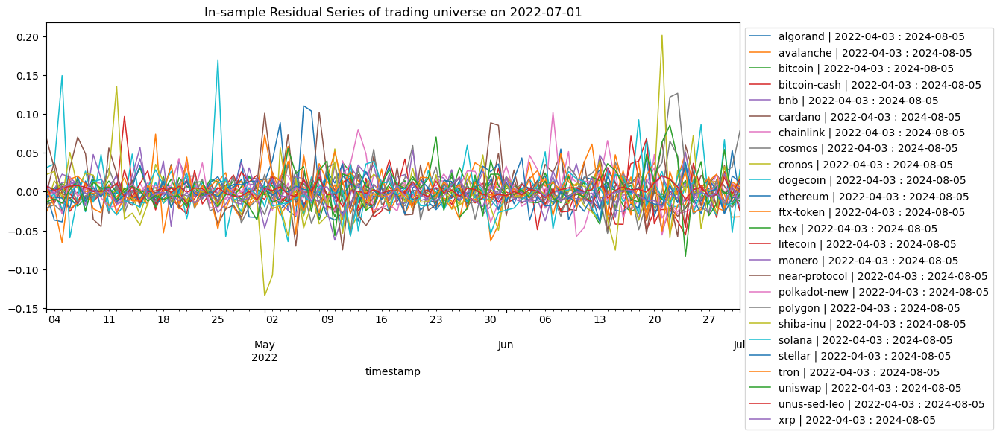

In [124]:
# Plot residual series
plt.figure(figsize = (14,8))
for column in test_res_df2.columns:
  test_res_df2[column].loc[:test_date_str].plot(figsize = (12,5), linewidth = 1.1, label = f"{column} | {test_start_date.date()} : 2024-08-05")

plt.title("In-sample Residual Series of trading universe on 2022-07-01")
plt.legend(loc = "upper left", bbox_to_anchor = (1,1))

In [125]:
# Sanity check: verify mean of residual during in-sample period is approximately zero
for column in test_res_df2.columns:
  print(f"{column} mean: {np.mean(test_res_df2[column].loc[test_start_date:])}")

algorand mean: 0.0006907171529867769
avalanche mean: -0.0017947562363482383
bitcoin mean: -0.0023156186105743634
bitcoin-cash mean: -0.004807725375397067
bnb mean: 0.0010814758731542949
cardano mean: 0.0028268127836953206
chainlink mean: 0.0029213941524534968
cosmos mean: -0.0006978013422955837
cronos mean: -0.005738113112185431
dogecoin mean: 0.0015343378771643078
ethereum mean: -0.0026065021314230917
ftx-token mean: 0.0002466766717169075
hex mean: 0.0017851717892083177
litecoin mean: 0.001041654126953869
monero mean: 0.0032846475013648194
near-protocol mean: 0.0018545523324105851
polkadot-new mean: -0.00031154945261604517
polygon mean: 0.0014614945980657872
shiba-inu mean: 0.00026776667852934183
solana mean: -5.877308050347989e-05
stellar mean: 0.0012633033578021587
tron mean: 0.0012658133834863117
uniswap mean: 0.0038007513933050255
unus-sed-leo mean: 0.0016273289189688749
xrp mean: -0.0018062707984791147


In [126]:
# Now verify cumulative sum at 2022-07-01 is "trivial"
for column in test_res_df2.columns:
  print(f"{column} cumulative sum: {np.cumsum(test_res_df2[column].loc[test_start_date:])[-1]}")

algorand cumulative sum: 0.06216454376880992
avalanche cumulative sum: -0.16152806127134142
bitcoin cumulative sum: -0.2084056749516927
bitcoin-cash cumulative sum: -0.4326952837857359
bnb cumulative sum: 0.09733282858388653
cardano cumulative sum: 0.25441315053257885
chainlink cumulative sum: 0.26292547372081465
cosmos cumulative sum: -0.06280212080660236
cronos cumulative sum: -0.516430180096689
dogecoin cumulative sum: 0.13809040894478763
ethereum cumulative sum: -0.23458519182807822
ftx-token cumulative sum: 0.022200900454521715
hex cumulative sum: 0.16066546102874862
litecoin cumulative sum: 0.09374887142584815
monero cumulative sum: 0.29561827512283356
near-protocol cumulative sum: 0.16690970991695264
polkadot-new cumulative sum: -0.02803945073544407
polygon cumulative sum: 0.13153451382592085
shiba-inu cumulative sum: 0.024099001067640815
solana cumulative sum: -0.005289577245313225
stellar cumulative sum: 0.11369730220219432
tron cumulative sum: 0.11392320451376808
uniswap cumu

C:\Users\idkup\AppData\Local\Temp\ipykernel_55740\310184080.py:3: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(f"{column} cumulative sum: {np.cumsum(test_res_df2[column].loc[test_start_date:])[-1]}")


Text(0.5, 1.0, 'Residual series over entire period')

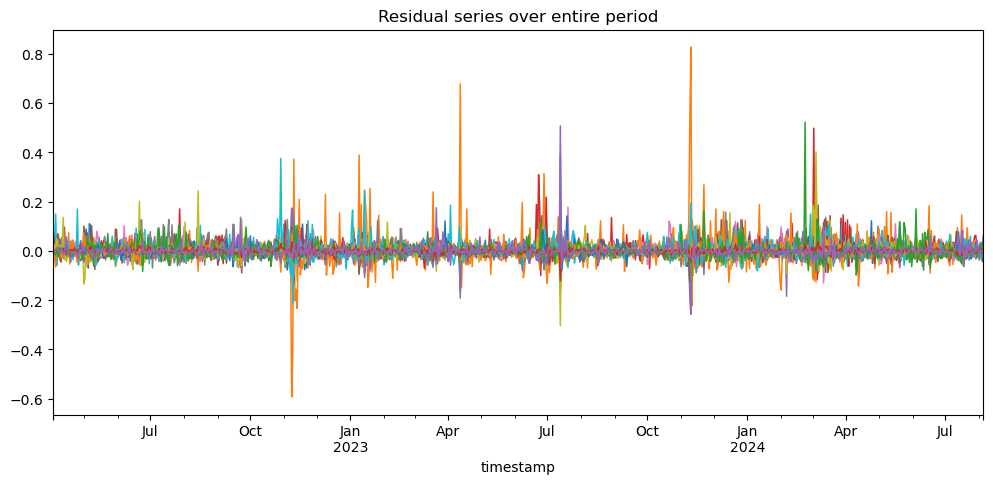

In [127]:
# Plot residual series for entire period
for column in test_res_df.columns:
  test_res_df[column].loc[test_start_date:].plot(figsize = (12,5), linewidth = 1.1)

plt.title("Residual series over entire period")

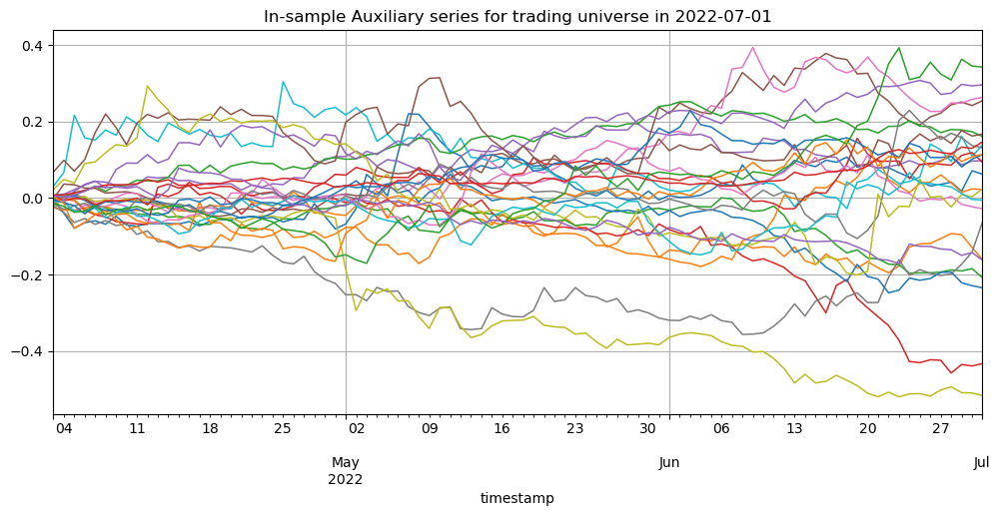

In [128]:
# Plot auxiliary series
for column in test_res_df.columns:
  np.cumsum(test_res_df2[column].loc[test_start_date:]).plot(figsize = (12,5), linewidth = 1.1)

plt.title("In-sample Auxiliary series for trading universe in 2022-07-01")
plt.grid(True)

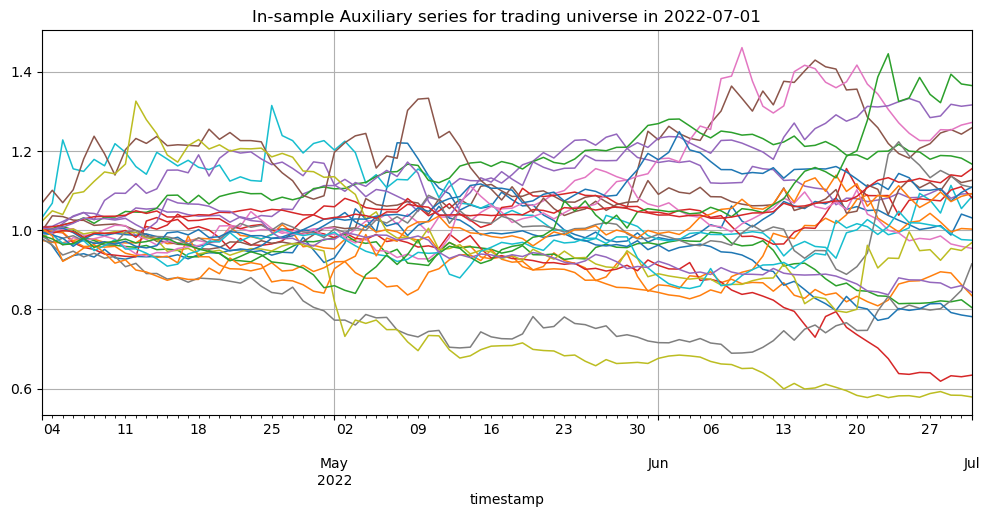

In [129]:
# Plot auxiliary series (cumprod)
for column in test_res_df2.columns:
  np.cumprod(1+test_res_df2[column].loc[test_start_date:]).plot(figsize = (12,5), linewidth = 1.1)

plt.title("In-sample Auxiliary series for trading universe in 2022-07-01")
plt.grid(True)

Text(0.5, 1.0, 'Auxiliary series over entire period')

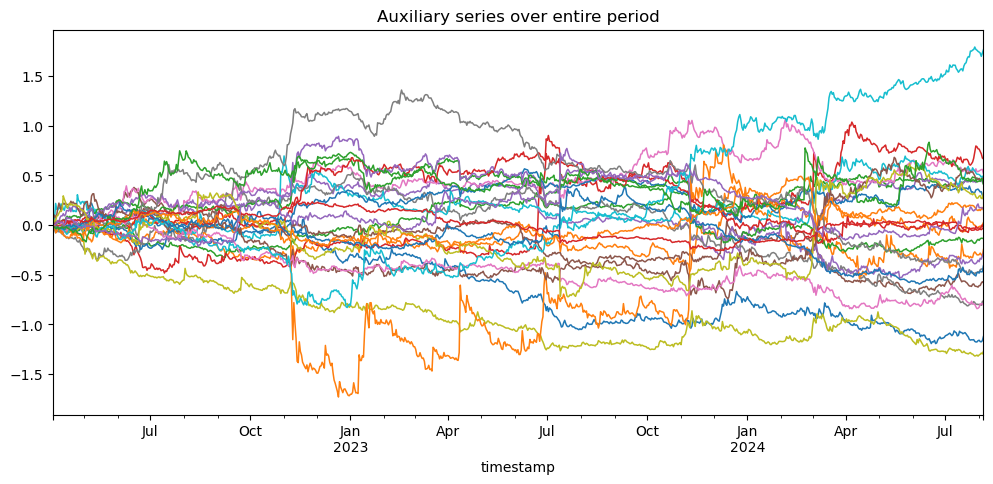

In [130]:
# Plot auxiliary series for entire period
for column in test_res_df.columns:
  np.cumsum(test_res_df[column].loc[test_start_date:]).plot(figsize = (12,5), linewidth = 1.1)
plt.title("Auxiliary series over entire period")

Text(0.5, 1.0, 'Auxiliary series over entire period')

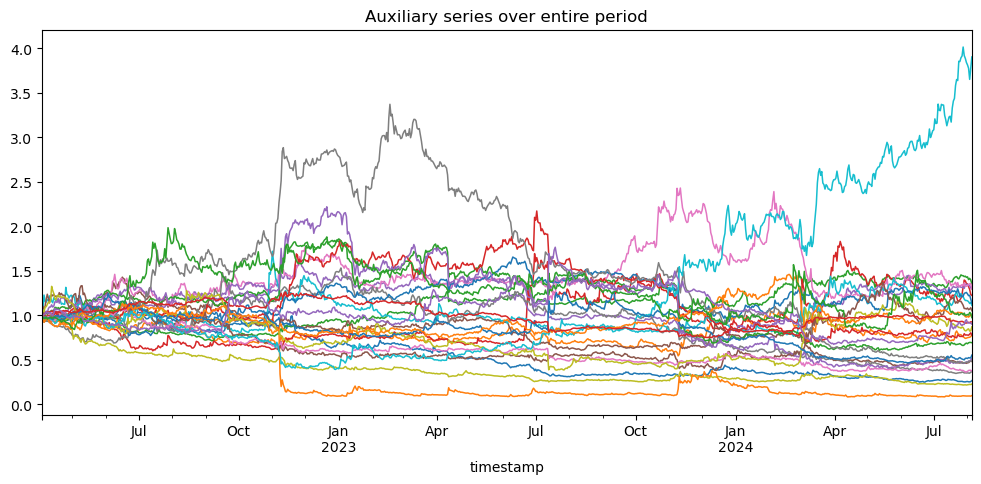

In [131]:
# Plot auxiliary series for entire period
for column in test_res_df.columns:
  np.cumprod(1+test_res_df[column].loc[test_start_date:]).plot(figsize = (12,5), linewidth = 1.1)
plt.title("Auxiliary series over entire period")

##### Remarks
- As we can see from the auxiliary series plot, the results don't seem too promising, as we can see variance of plots explanding as series is rolled into the future.
- This indicates that assuming static properties over a long period of time is *very unrealistic*; it is imperative that we should use modify our approach such that we incorporate for dynamic properties.


We will now distinguish in-sample and out-of-sample auxiliary series below.

In [132]:
# Color code for clear comparison based on threshold date
threshold_date_str = "2022-07-01"
threshold_date = pd.to_datetime(threshold_date_str)

start_date

datetime.datetime(2022, 7, 1, 0, 0)

C:\Users\idkup\AppData\Local\Temp\ipykernel_55740\858860923.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize = (12,6))


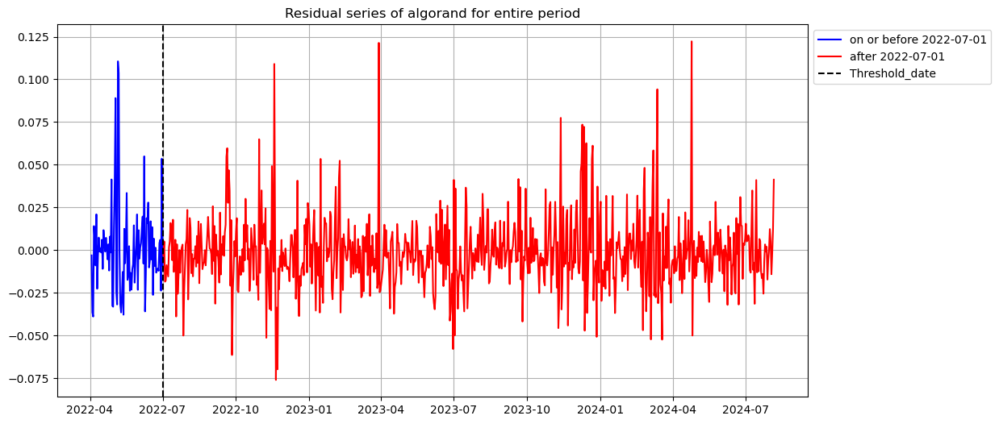

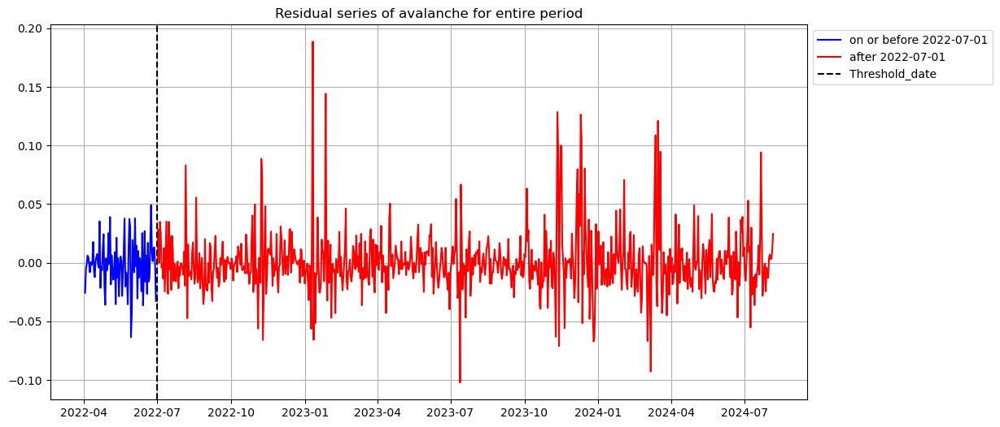

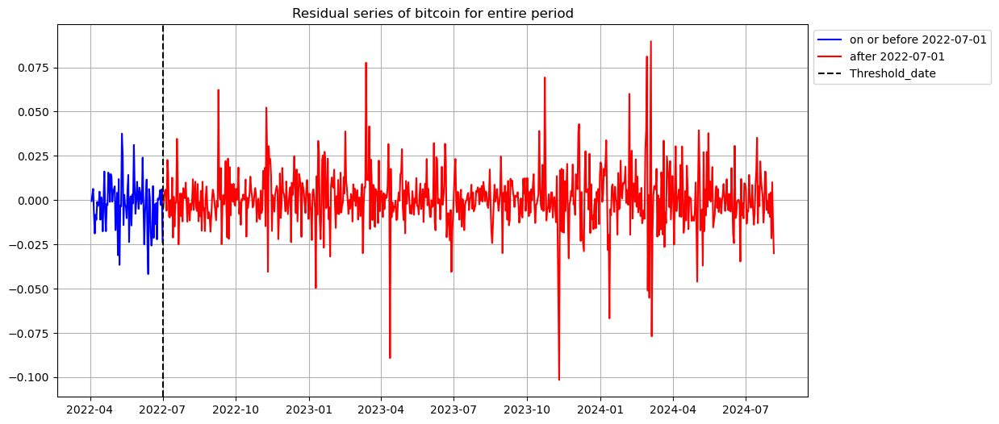

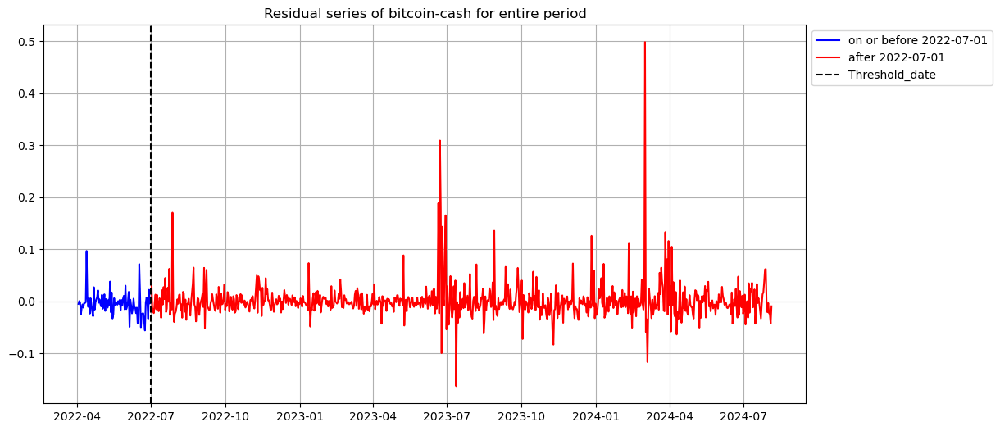

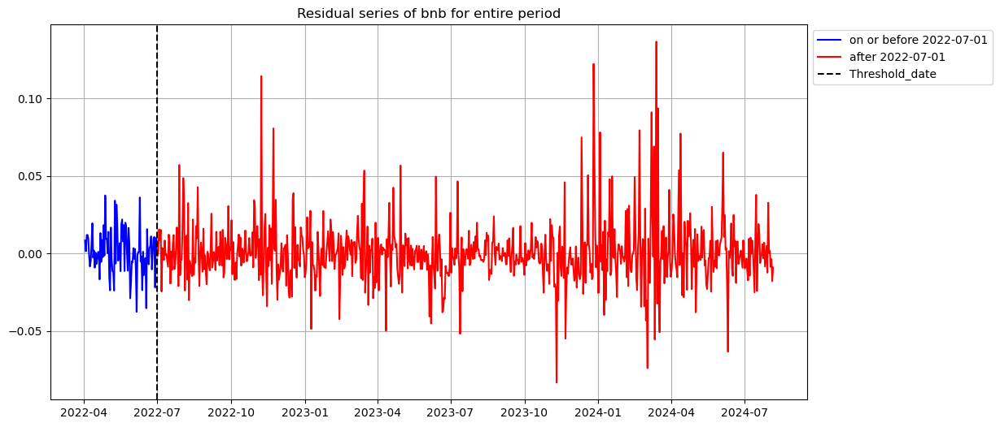

...

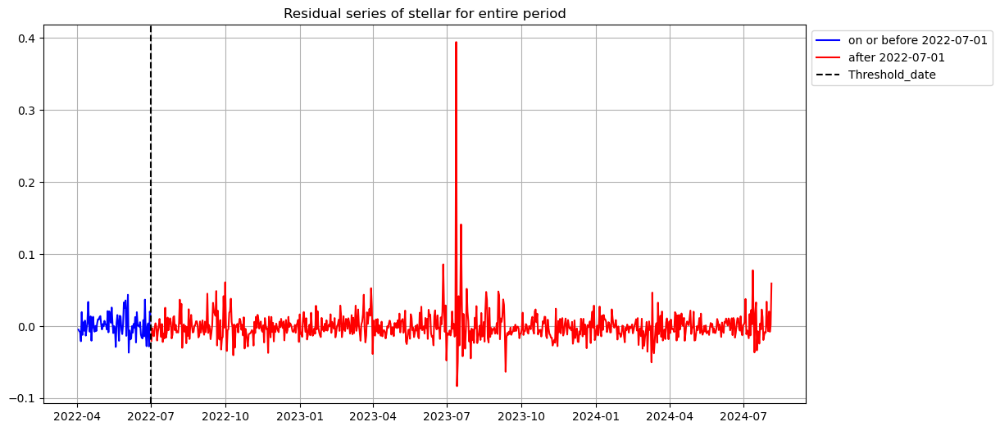

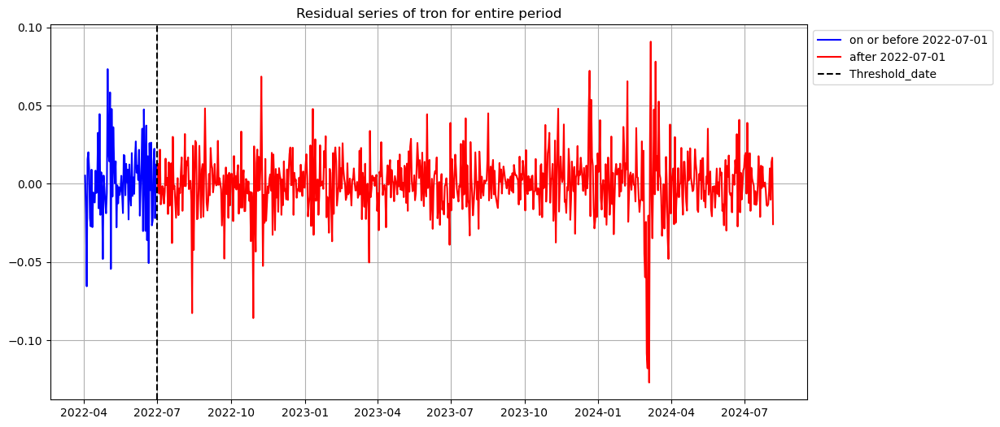

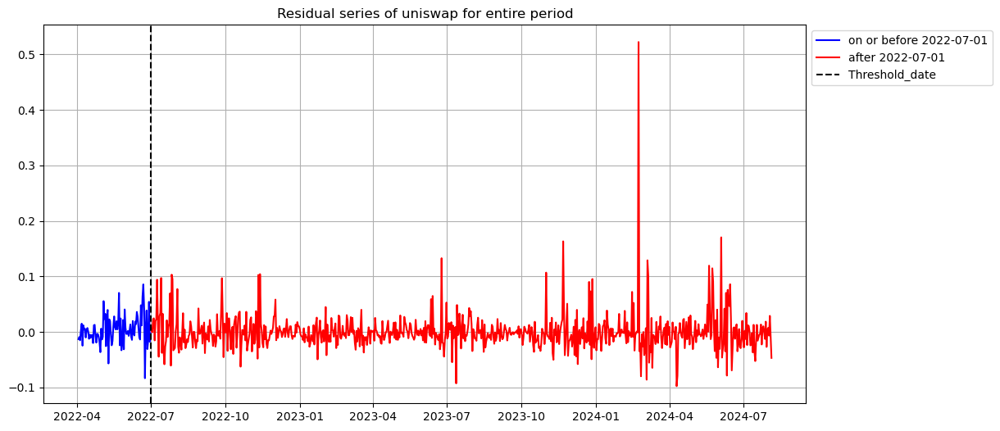

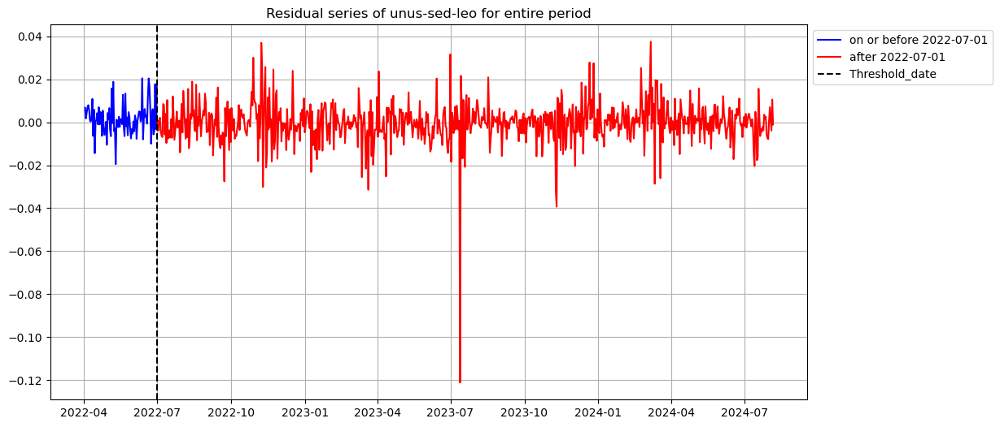

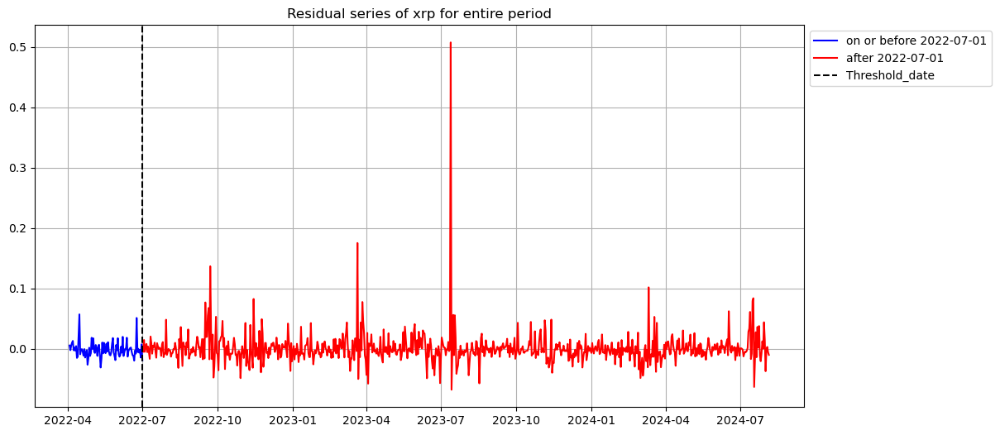

In [133]:
for column in test_res_df.columns:
  plt.figure(figsize = (12,6))
  plt.plot(test_res_df[column].loc[test_start_date: threshold_date].index,
           test_res_df[column].loc[test_start_date: threshold_date],
           color = "blue",
           label = f"on or before {threshold_date_str}"
  )
  plt.plot(test_res_df[column].loc[threshold_date + timedelta(days = 1):].index,
           test_res_df[column].loc[threshold_date + timedelta(days = 1):],
           color = "red",
           label = f"after {threshold_date_str}"
           )
  plt.axvline(threshold_date, color = "black", linestyle = "--", label = "Threshold_date")
  plt.title(f"Residual series of {column} for entire period")
  plt.legend(loc = "upper left", bbox_to_anchor = (1,1), fontsize = 10)
  plt.grid()



In [134]:
test_res_df.loc["2022-06-28": "2022-07-10", "ethereum"]

timestamp
2022-06-28    0.001083
2022-06-29   -0.028029
2022-06-30   -0.007869
2022-07-01   -0.005233
2022-07-02    0.001305
2022-07-03    0.009240
2022-07-04    0.013719
2022-07-05   -0.000906
2022-07-06    0.017160
2022-07-07    0.001840
2022-07-08    0.001995
2022-07-09   -0.011616
2022-07-10   -0.008901
Name: ethereum, dtype: float64

In [135]:
test_res_df[column].loc[test_start_date: threshold_date]

timestamp
2022-04-03    0.005148
2022-04-04   -0.002566
2022-04-05    0.004992
2022-04-06    0.009796
2022-04-07    0.012758
                ...   
2022-06-27   -0.006677
2022-06-28   -0.001902
2022-06-29   -0.014767
2022-06-30    0.007147
2022-07-01   -0.019741
Name: xrp, Length: 90, dtype: float64

C:\Users\idkup\AppData\Local\Temp\ipykernel_55740\2418064123.py:12: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  continuing_value = np.cumsum(test_res_df[column].loc[test_start_date: threshold_date])[-1]
C:\Users\idkup\AppData\Local\Temp\ipykernel_55740\2418064123.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize = (12,6))


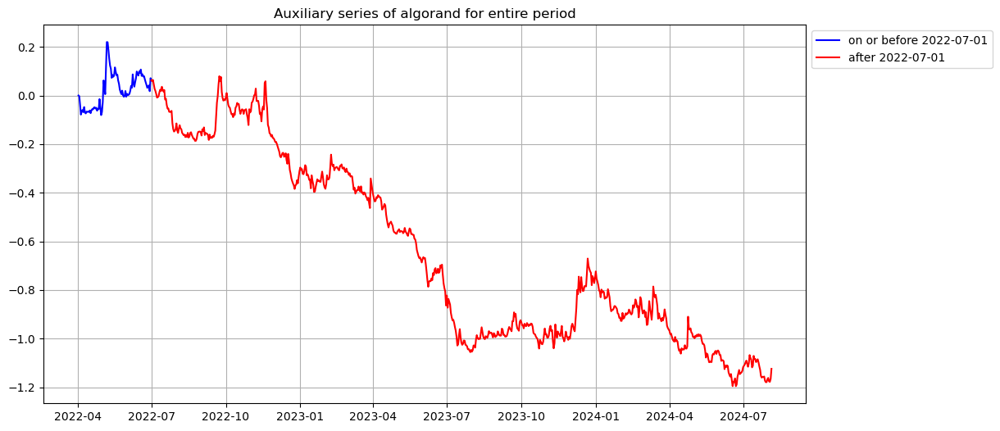

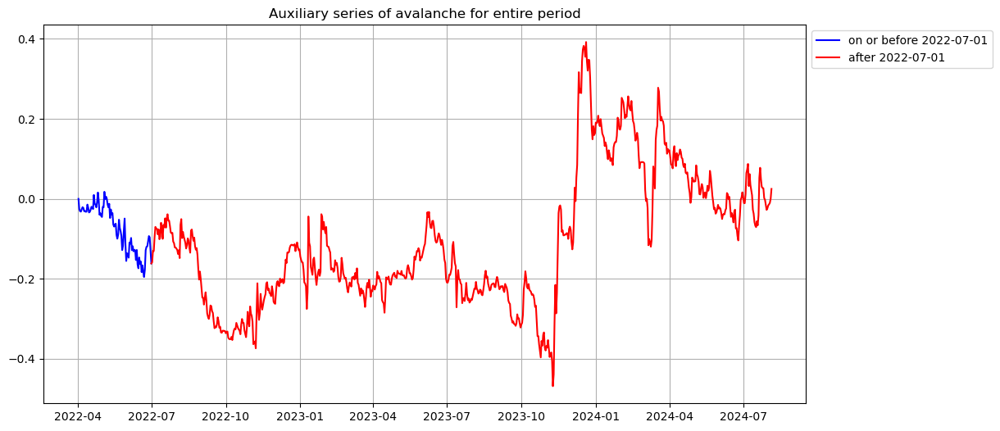

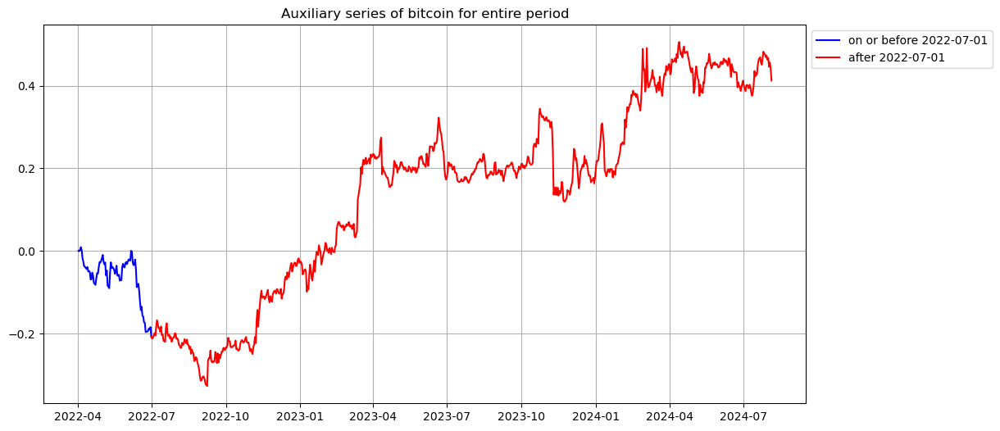

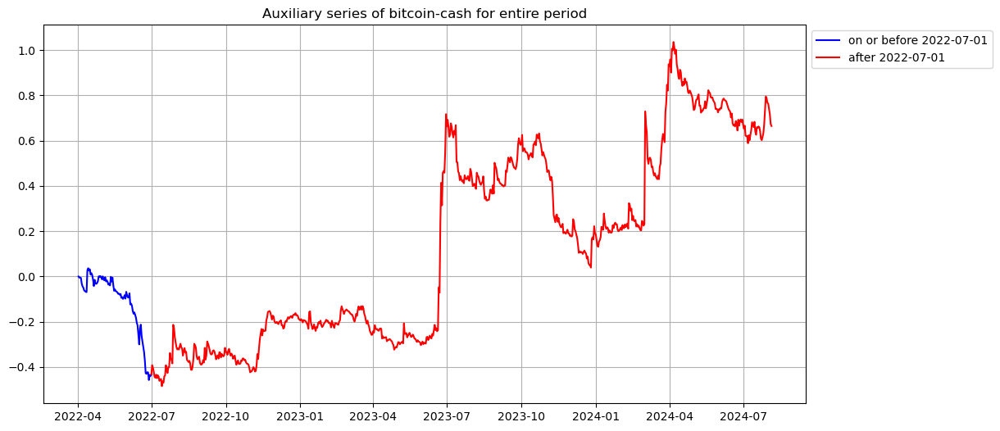

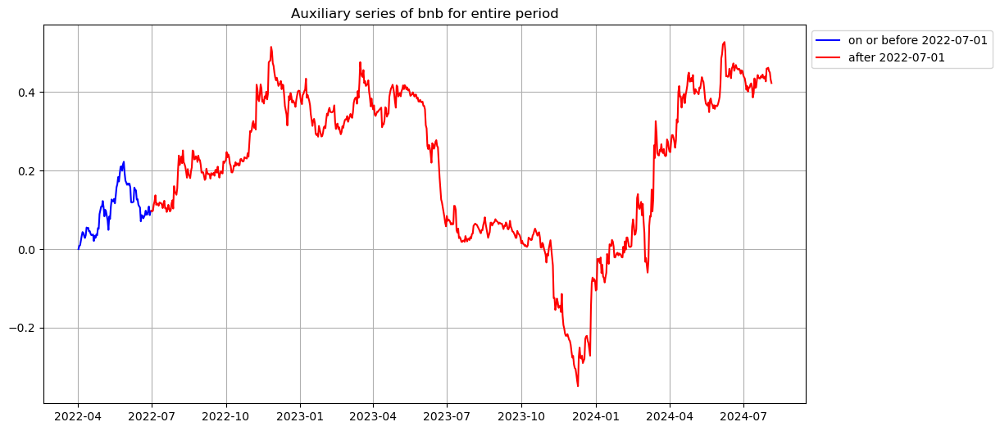

...

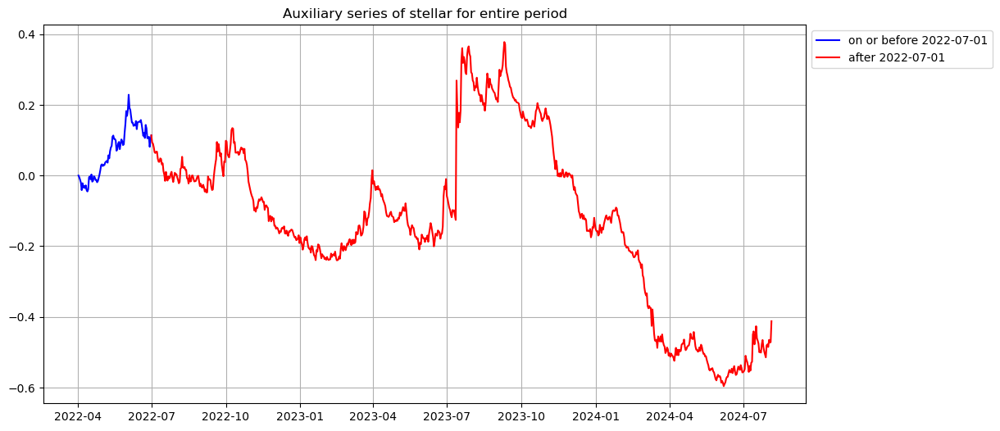

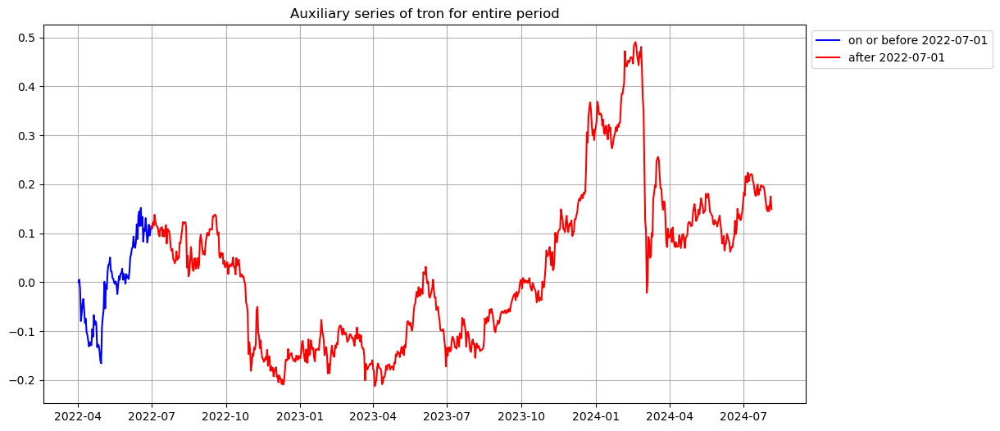

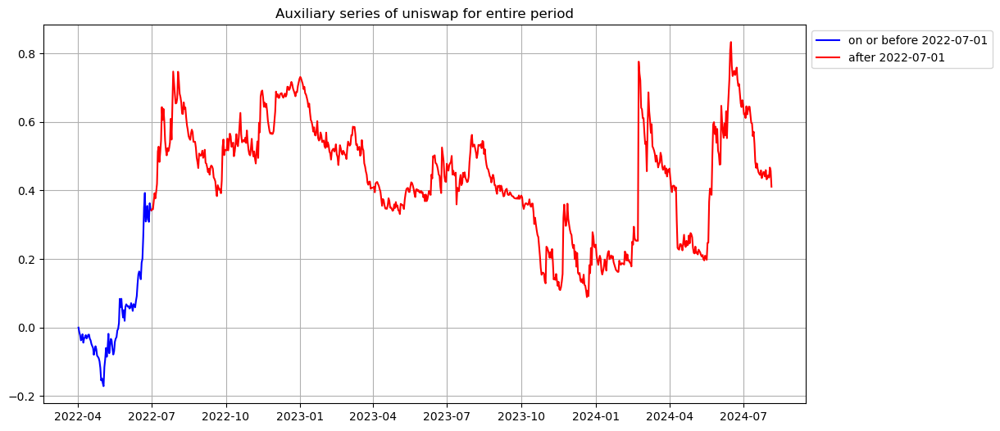

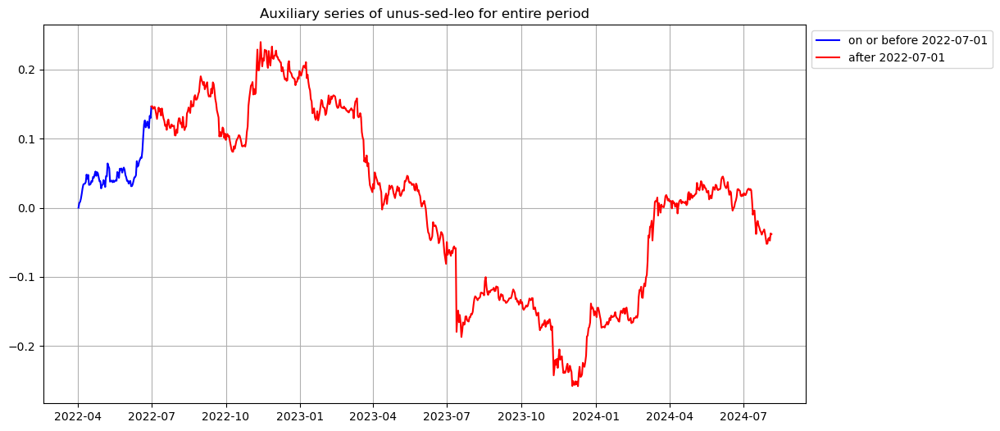

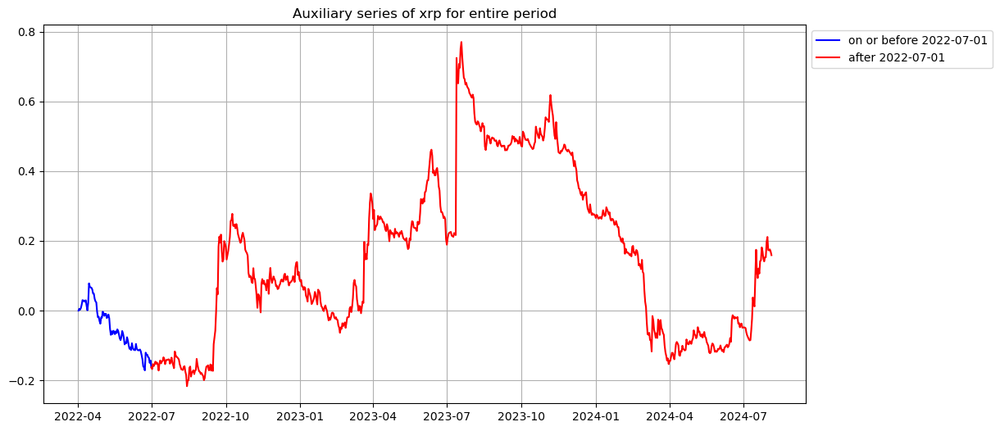

In [136]:
# plot auxiliary series over entire period (20220402 ~ 20240805)
aux_test_start_date = test_start_date - timedelta(days = 1) # We want to standardize all series to start from value 0

for column in test_res_df.columns:
  plt.figure(figsize = (12,6))
  plt.plot(test_res_df[column].loc[aux_test_start_date: threshold_date].index,
           np.insert(np.cumsum(test_res_df[column].loc[test_start_date: threshold_date]), 0, 0), # Insert 0 in front of value array
           color = "blue",
           label = f"on or before {threshold_date_str}"
  )

  continuing_value = np.cumsum(test_res_df[column].loc[test_start_date: threshold_date])[-1]
  

  plt.plot(test_res_df[column].loc[threshold_date:].index,
           # Insert last value from previous series and add it to new cumulative sum series to prevent discontinuity
           np.insert(continuing_value + np.cumsum(test_res_df[column].loc[threshold_date + timedelta(days = 1):]), 0 , continuing_value), 
           color = "red",
           label = f"after {threshold_date_str}"
           )
  
  plt.title(f"Auxiliary series of {column} for entire period")
  plt.legend(loc = "upper left", bbox_to_anchor = (1,1), fontsize = 10)
  plt.grid()


### Modelling auxiliary series via Ornstein Uhlenbeck Process
The standard Ornstein-Uhlenbeck process is a continuous stochastic process that can be used to model a *mean-reverting series*. It looks something like this:

$$
dX_i(t) = \kappa_i (m_i - X_i(t))dt + \sigma_i dW_i(t) , \quad \kappa_i \gt 0 
$$

where the parameters are given below.

$$\begin{align}
X_i(t) &= \text{mean reverting series with respect to asset i as a function of time t} \\
\kappa_i &= \text{mean reversion parameter or rate of mean reversion} \\
m_i &= \text{long run mean of mean-reverting series} \\
\sigma_i &= \text{volatility of stochastic component} \\
\end{align}$$

$W_i(t)$ is the Weiner process with respect to series $i$ as at time t.

Introducing integration constant $f(X_i(t), t) = X_i(t)e^{\kappa_i t}$ we can derive the analytical solution of $X_i(t)$ given below.

$$
X_i(t_0 + \Delta t) = e^{-\kappa_i \Delta t} X_i(t_0) + \left( 1 - e^{-\kappa_i \Delta t} \right) m_i + \sigma_i \int_{t_0}^{t_0 + \Delta t} e^{-\kappa_i (t_0 + \Delta t - s)} dW_i(s)
$$

Running the regression
$$
X_{n+1} = \hat{a} + \hat{b}\,X_n + \hat{\zeta}_{n+1},
\quad
n = 1,\dots,N-1.
$$

where $X_n = X(t_0 + n \Delta t)$ and samples are sampled at interval $\Delta t$ (note in our case $\Delta t = 1/365$)

Then, the OU parameters can be retrieved from equations below.

$$
a = m \bigl(1 - e^{-\kappa\Delta t}\bigr), 
\quad
b = e^{-\kappa \Delta t},
\quad
\mathrm{Var}(\zeta) = \sigma^2 \;\frac{1 - e^{-2\kappa\Delta t}}{2\kappa}.
$$

$$
\kappa = -\frac{1}{\Delta t}\ln(b), 
\quad
m = \frac{a}{1-b}, 
\quad
\sigma = \sqrt{
  \frac{\mathrm{Var}(\zeta)\,\bigl(2\,\kappa\bigr)}
       {1 - e^{-2\,\kappa\,\Delta t}}
},
\quad
\sigma_{\mathrm{eq}} = \sqrt{\frac{\mathrm{Var}(\zeta)}{1 - b^2}}.
$$

Then, defining $\tau_i = \frac{1}{\kappa_i}$, we choose auxiliary series of crypto $i$ such that $\tau_i \lt T_1$, where $T_1 = \frac{60}{365}$ (since we are considering estimation period of 60 days) for tradable pair.

For pairs that we deem as "mean-reverting enough", there are various ways to generate trading signals. An intuitive and straightforward way is to compute dimensionless variable $$s_i = \frac{X_i(t) - m_i}{\sigma_{eq,i}}$$, which is called the $s-score$ by the original authors. Then, we come up with upper and lower thresholds based on empirical analysis. These boundaries will be used to generate signals on time T, based on data from $T - n \Delta t \quad to \quad T - \Delta t$ , $n = 1 \dots 60$

In [137]:
# set window size to 60 for OU estimation, insert row of 0s to normalize first value of auxiliary series to zero
aux_window_size = 60
test_date_str = "2022-07-01"
test_aux_start_date = datetime.strptime("2022-07-01", "%Y-%m-%d") - timedelta(days = aux_window_size - 1)
test_aux_new_row = pd.DataFrame({coin: 0 for coin in test_res_df.columns}, [test_aux_start_date - timedelta(days = 1)])

test_aux_df = np.cumsum(pd.concat([test_aux_new_row, test_res_df.loc[test_aux_start_date : test_date_str]]), axis = 0)
print(test_aux_df)

            algorand  avalanche   bitcoin  bitcoin-cash       bnb   cardano  \
2022-05-02  0.000000   0.000000  0.000000      0.000000  0.000000  0.000000   
2022-05-03  0.089019  -0.001155 -0.016973     -0.014095 -0.015369  0.001580   
2022-05-04  0.064640   0.037819 -0.022558     -0.017437 -0.039081  0.075122   
2022-05-05  0.032750   0.019338 -0.018366     -0.003806 -0.022337  0.061234   
2022-05-06  0.143339   0.025711 -0.049490     -0.022105 -0.026305  0.057399   
...              ...        ...       ...           ...       ...       ...   
2022-06-27  0.062869  -0.085986 -0.183893     -0.424435 -0.024690  0.215700   
2022-06-28  0.068823  -0.072930 -0.178221     -0.457752 -0.013965  0.237758   
2022-06-29  0.045068  -0.076144 -0.181046     -0.435463 -0.035874  0.244800   
2022-06-30  0.098602  -0.108970 -0.174903     -0.439390 -0.025974  0.235562   
2022-07-01  0.089557  -0.141396 -0.198661     -0.433037 -0.025121  0.248499   

            chainlink    cosmos    cronos  dogecoin

C:\Users\idkup\AppData\Local\Temp\ipykernel_55740\2588608011.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize = (10,4))


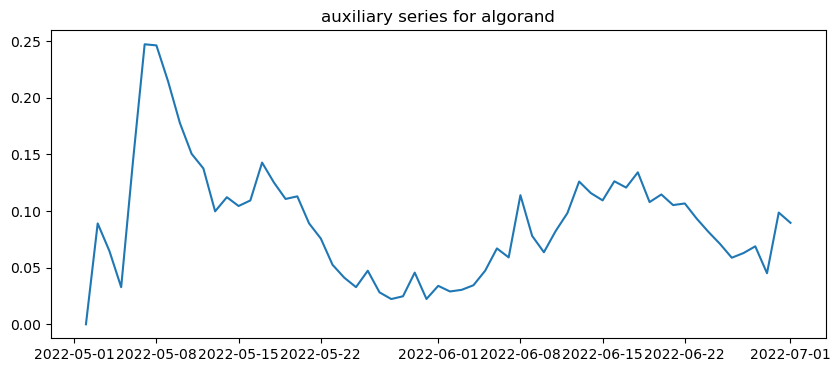

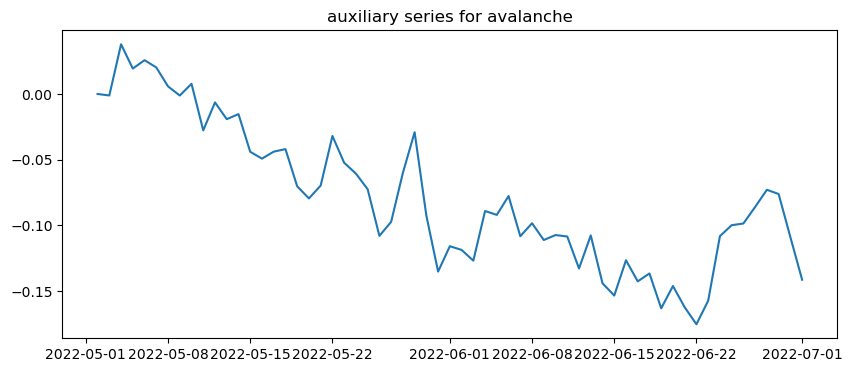

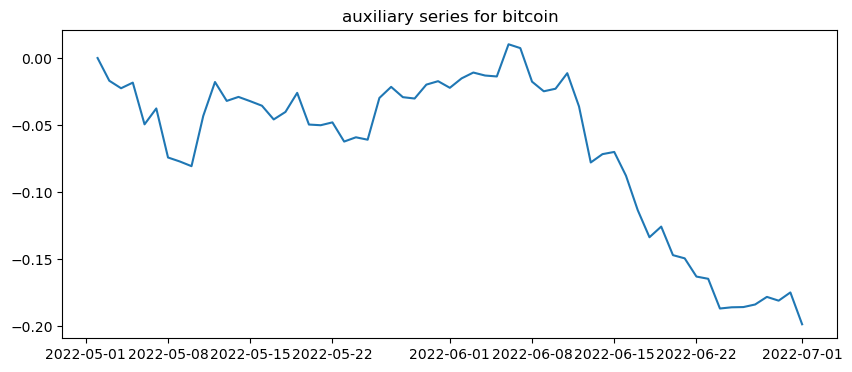

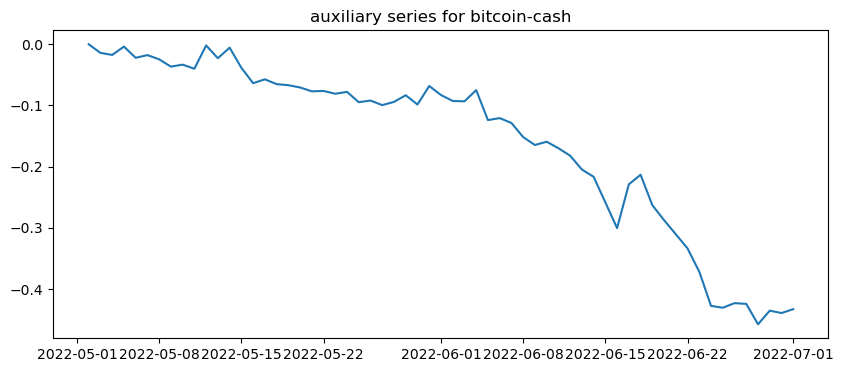

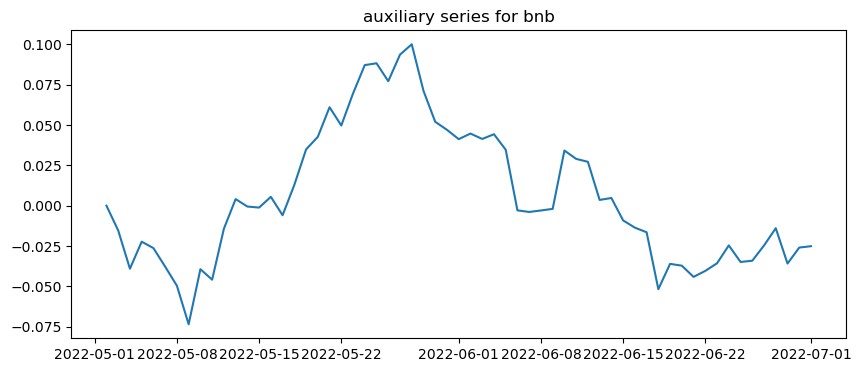

...

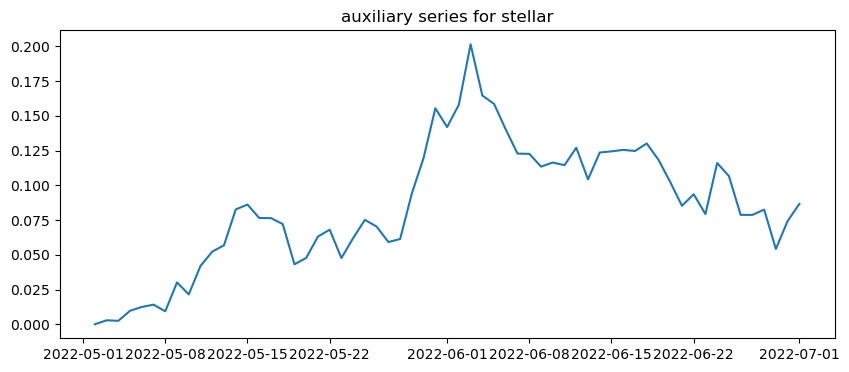

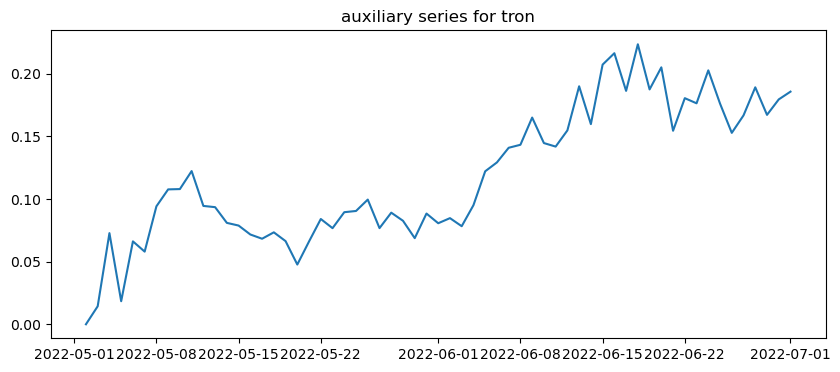

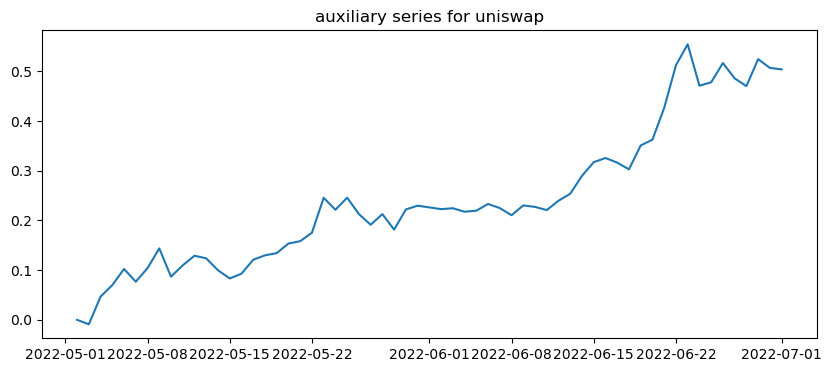

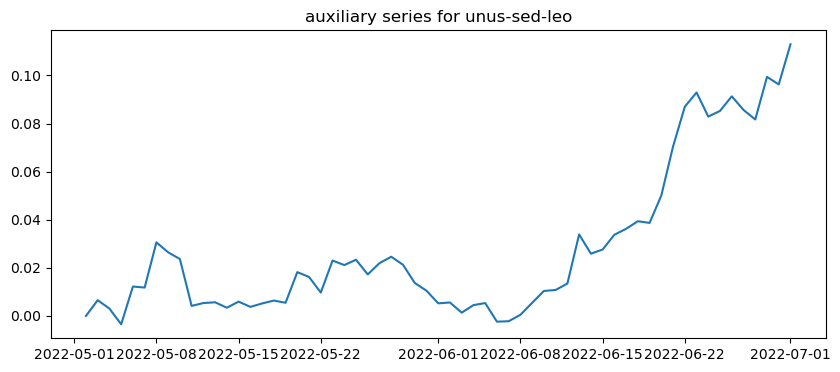

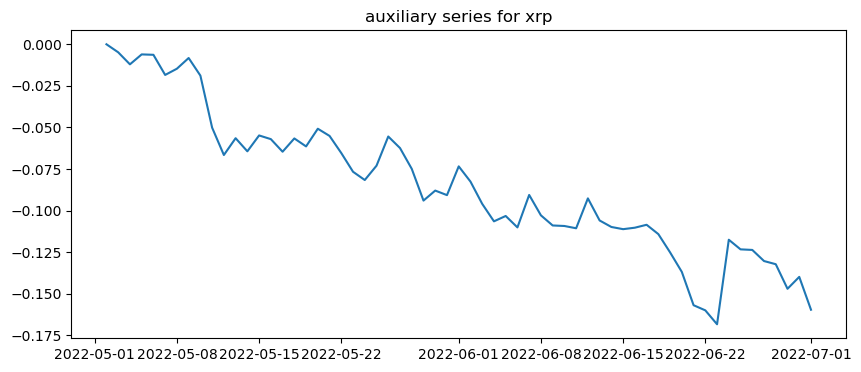

In [138]:
for column in test_aux_df.columns:
  plt.figure(figsize = (10,4))
  plt.plot(test_aux_df.index, test_aux_df[column], label = f"auxiliary series for {column}")
  plt.title(f"auxiliary series for {column}")

In [139]:
import numpy as np
import pandas as pd
import math
import statsmodels.api as sm  # for OLS

def estimate_ou_params(aux_df, 
                                   dt=1/365, 
                                   T1=60/365):
    """
    Estimate OU parameters for each column (coin) in aux_df via an AR(1) regression:
        X_{n+1} = a + b * X_n + error_{n+1},
    using statsmodels OLS for coefficient estimation.
    
    Then invert to get OU parameters:
        kappa, m, sigma, sigma_eq, tau.

    Parameters
    ----------
    aux_df : pd.DataFrame
        DataFrame of auxiliary series, indexed by date (or time),
        with columns = coins, rows = time steps.
    dt : float
        Time step in years (e.g., 1/365 for daily data).
    T1 : float
        Threshold for tau (in years). If tau_i < T1 => coin is "tradable".

    Returns
    -------
    ou_params_df : pd.DataFrame
        OU parameters for each coin. Columns = [kappa, m, sigma, sigma_eq, tau].
    ranked_coins : list of str
        Coins sorted by ascending tau (most mean-reverting first).
    tradable_coins : list of str
        Coins whose tau < T1 (the "tradable" set).
    """

    results = []

    for coin in aux_df.columns:
        # Pull out the series and drop any NaNs
        X = aux_df[coin].dropna().values
        
        if len(X) < 2:
            # Not enough data; store NaNs or skip
            results.append({
                "coin": coin,
                "kappa": np.nan,
                "m": np.nan,
                "sigma": np.nan,
                "sigma_eq": np.nan,
                "tau": np.nan
            })
            continue
        
        # Build AR(1) model:
        # Y = X[1:], X_lag = X[0:-1]
        Y = X[1:]
        X_lag = X[:-1]
        
        # Use statsmodels OLS
        X_lag_mat = sm.add_constant(X_lag)  # shape: (n_samples, 2) => [1, X_lag]
        
        # Fit OLS: Y ~ a + b*X_lag
        model = sm.OLS(Y, X_lag_mat).fit()
        
        a = model.params[0]          # Intercept
        b = model.params[1]          # Slope
        var_eps = model.mse_resid    # Variance of residuals

        # Now invert AR(1) => OU params
        if b != 1.0:
            # kappa = -(1/dt)*log(b)
            # m = a / (1 - b)
            if b > 0:
                kappa = -1.0 / dt * math.log(b)
            else:
                kappa = np.nan  # b <= 0 => invalid for standard OU assumption

            if (1 - b) != 0:
                m_val = a / (1 - b)
            else:
                m_val = np.nan
        else:
            # b=1 => no mean reversion
            kappa = 0.0
            m_val = 0.0
        
        # var_eps = sigma^2 * [(1 - exp(-2*kappa dt)) / (2*kappa)]
        if (kappa > 0) and (1 - math.exp(-2*kappa*dt) > 0):
            sigma_val = math.sqrt(
                var_eps * 2 * kappa / (1 - math.exp(-2*kappa*dt))
            )
        else:
            sigma_val = math.sqrt(var_eps) if var_eps > 0 else 0
        
        if kappa > 0:
            sigma_eq_val = sigma_val / math.sqrt(2*kappa)
            tau_val = 1.0 / kappa
        else:
            sigma_eq_val = np.nan
            tau_val = np.inf
        
        results.append({
            "coin": coin,
            "kappa": kappa,
            "m": m_val,
            "sigma": sigma_val,
            "sigma_eq": sigma_eq_val,
            "tau": tau_val
        })

    # Create DataFrame
    ou_params_df = pd.DataFrame(results).set_index("coin")

    # Rank coins by ascending tau
    ranked_coins = list(
        ou_params_df.sort_values("tau", ascending=True).index
    )

    # Filter: tau < T1 => "tradable"
    mask = ou_params_df["tau"] < T1
    tradable_coins = list(ou_params_df.loc[mask].index)

    return ou_params_df, ranked_coins, tradable_coins


In [140]:
test_ou_params_df, test_coins, test_tradable_coins = estimate_ou_params(test_aux_df, dt = 1/365, T1 = 7/365)

print(test_ou_params_df)

                   kappa         m     sigma  sigma_eq       tau
coin                                                            
algorand       80.232659  0.097325  0.612224  0.048330  0.012464
avalanche      35.884828 -0.102596  0.451549  0.053301  0.027867
bitcoin         0.859928 -1.472190  0.296019  0.225722  1.162888
bitcoin-cash   -4.137636  0.481117  0.021792       NaN       inf
bnb            24.390448 -0.000825  0.309202  0.044271  0.041000
cardano        19.152362  0.255114  0.540351  0.087307  0.052213
chainlink      14.807803  0.309649  0.505689  0.092923  0.067532
cosmos         -1.604494 -0.741098  0.027194       NaN       inf
cronos          7.563343 -0.276164  0.378605  0.097345  0.132217
dogecoin       67.158679 -0.172591  0.557828  0.048132  0.014890
ethereum        2.164564 -0.903274  0.341140  0.163958  0.461987
ftx-token       9.559706  0.072715  0.416015  0.095142  0.104606
hex            35.019772  0.089578  0.229862  0.027466  0.028555
litecoin       56.939190 

In [141]:
print(f"mean_reverting_list on 2022-07-01: {test_tradable_coins}")

mean_reverting_list on 2022-07-01: ['algorand', 'dogecoin', 'litecoin', 'near-protocol', 'shiba-inu']


##### Remarks
- When eyeballing charts, it seemed impossible to find a pair displaying mean-reverting behaviour over the sample period. However, when modelling via OU process, we see that quite a few pairs pass the threshold suggested in the original paper by Avellaneda ($\tau_i \lt T_1$ where $T_1 = 60 / 365$). We instead use $T_1 = 7 / 365$, which can be interpreted as we want to look for pairs whose *average time the series will revert back to their long run mean is 7 days*. 
- From period 2022-05-02 ~ 2022-07-01, **algorand, dogecoin, liteocin, near-protocol, and shibainu** seemed to display mean-reverting behvaviour when traded against the top five eigenportfolios. Note that there is high chance that in-sample performance *do not mirror the reality* because we are using eigenportfolios extracted from data *up until 2022-07-01*, while the OU process is estimated *based on data before 2022-07-01*. Naively concluding that we will be able to extrapolate in-sample performance into the future is same as committing the sin of overlooking *look-forward bias.* This highlights the importance of analyzing out-of-sample performance, for which we will be adopting the walk-forward backtesting method.


#### Dynamic Analysis of mean-reversion-list (mrl) over time

When trading live, we will have to re-run the OU estimation process. Consequently, this will result in changing mean-reversion lists (denote as $mrl_t$ where t is the time index that has 1 to 1 mapping with actual date) each day.

We define mean-reversion list at time t as $mrl_t$. 

First, note that our final coin selection (for trading) depends on two filters:
1. trading universe filter
2. mean-reversion filter

The former is relevant once every month since that will be our rebalance frequency. Dealing with latter case is a bit more involved. This is because we have to answer the question: *how should we deal with an already open position if on the next day the coin in question is suddenly filtered out?* In general, I believe you shouldn't give your models too much credit; just because a coin doesn't meet some arbitrary (or non-arbitrary) threshold you set does not make it disqualified for mean-reversion. It is well known that we can trade series that fail the ADF test quite profitably, if we are careful enough with our signal generation/execution methodology. Therefore, after a bit of thinking, I became comfortable with the following set of rules.

- If we have a mean-reversion trade open for a specific coin, and the following day we find out that the coin in question is filtered out during the process of estimating the Ornstein-Uhlenbeck process, we start a count that increments by 1. Each day the count increments by 1 if on that day we still find the coin is excluded from the final mean-reversion list. When the count reaches $q$, then we close the trade, regardless of making or losing money.
- Denoting the count as $coin_m$, if $1 \lt coin_m \lt q$ and the coin appears within the mean-reversion list, the count is reset to zero and the position is maintained until it hits target profit level.

##### Minimizing false positive vs false negative
In our case, the null hypothesis is: coin is not mean reverting. The alternative, the condition which we wish is present is: coin is mean-reverting. 

The question then becomes: *do we want to minimize false positive cases (incorrectly predicting the coin is mean-reverting when in fact it is not mean-reverting) or minimize false negative cases (incorrectly predicting the coin is not mean-reverting when in fact it is mean-reverting)?*

In the naive case, the answer to previous question becomes clear when we consider the magnitude of cost of committing each error. Obviously, trading a coin that we believe is mean-reverting when in fact it isn't is more costly than the alternative case (in which we don't put on a trade). Hence, under normal circumstances (when we don't have open positions), minimizing false positive cases seem to be the more wise decision. But things are a bit more nuanced when we add in the condition *we currently have open positions with respect to the coin in question*. This is because we not only have to consider the cost of trading a false positive case, but we also have to consider the cost of closing out positions with respect to our currently open position.

This all means that while choosing $q$ that minimizes false positives rather than false negatives is the correct approach, **we don't want to just set q = 1, which may lead us to close out open positions too frequently, costing us unnecessarily.**

Okay, We used too many words to show that answering the following question should be our objective: **what should be the appropriate level of $q$ that doesn't incur too much trading costs while at the same time limiting the probability of maintaining a mean-reversion trade that lost its mean-reversion property?** 

To answer this question, we want to know the answers to the following set of questions:
- If a coin gets excluded from the list, what is the probability that it stays excluded in the future?
- What is the appropriate amount of waiting time for which the excluded coin stays excluded in the future?

To answer these sub-questions of our big question (what is optimal level of q), we will analyze the dynamic behaviour of appearances of coins in the mean-reversion-list over the entire period.

In [142]:
# Check how mean-reverting list changes through time
test_mrl_date = "2022-06-24"
OOS_end_date = "2024-08-05"
aux_window_size = 60

start_date = datetime.strptime(test_mrl_date, "%Y-%m-%d")
end_date = datetime.strptime(OOS_end_date, "%Y-%m-%d")
date_range_str = []

current_date = start_date
while current_date <= end_date:
  date_range_str.append(current_date.strftime("%Y-%m-%d"))  
  current_date += timedelta(days = 1)

mrl_result = {date: [] for date in date_range_str}


# Start loop for each auxliary series df
for date in pd.date_range(test_mrl_date, end = test_res_df.index[-1], freq = "D"):
  test_mrl_start_date = date - timedelta(days = aux_window_size - 1)
  test_aux_new_row = pd.DataFrame({coin: 0 for coin in test_res_df.columns}, [test_mrl_start_date - timedelta(days = 1)])
  test_aux_df = np.cumsum(pd.concat([test_aux_new_row, test_res_df.loc[test_mrl_start_date : date]]), axis = 0)
  
  # For each auxiliary series, estimate OU process, but only get mean-reverting list
  _ , _, mrl_coins = estimate_ou_params(test_aux_df, dt = 1/365, T1 = 7/365)

  date_str = date.strftime("%Y-%m-%d")
  mrl_result[date_str] = mrl_coins

mrl_result["2022-06-25"]

['algorand', 'cosmos', 'litecoin', 'near-protocol']

In [143]:
# Convert to df for analysis
unique_coins = list(set(coin for coins in mrl_result.values() for coin in coins))

mrl_df = pd.DataFrame(index = mrl_result.keys(), columns = unique_coins).fillna(0)

for date, coin in mrl_result.items():
  mrl_df.loc[date, coin] = 1

mrl_df = mrl_df.astype(int)
mrl_df

C:\Users\idkup\AppData\Local\Temp\ipykernel_55740\2989051139.py:4: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  mrl_df = pd.DataFrame(index = mrl_result.keys(), columns = unique_coins).fillna(0)


,litecoin,cosmos,bitcoin-cash,ethereum,chainlink,polkadot-new,ftx-token,unus-sed-leo,hex,algorand,...,cardano,xrp,monero,cronos,bnb,bitcoin,stellar,polygon,shiba-inu,dogecoin
2022-06-24,1,1,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
2022-06-25,1,1,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
2022-06-26,1,1,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,1,0
2022-06-27,1,1,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,1,0
2022-06-28,1,1,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-08-01,1,0,0,1,0,0,1,0,1,0,...,0,0,1,0,1,0,0,0,0,0
2024-08-02,1,0,0,1,0,0,1,0,1,0,...,0,0,1,0,1,0,0,0,0,0
2024-08-03,1,0,0,1,0,0,1,0,1,0,...,0,0,1,0,1,0,0,0,0,0
2024-08-04,1,0,0,1,0,0,1,0,1,0,...,0,0,1,0,1,0,0,0,0,0


In [144]:
# Total Occurences of each coin
mrl_freq = mrl_df.sum(axis = 0).sort_values(ascending = False)

print(mrl_freq)

polkadot-new     305
near-protocol    303
litecoin         286
avalanche        275
ftx-token        273
cronos           262
cardano          242
bitcoin-cash     237
chainlink        229
tron             226
xrp              199
algorand         193
bitcoin          191
uniswap          189
unus-sed-leo     186
dogecoin         176
monero           174
hex              164
bnb              154
solana           125
shiba-inu         97
polygon           96
cosmos            95
ethereum          87
stellar           86
dtype: int64


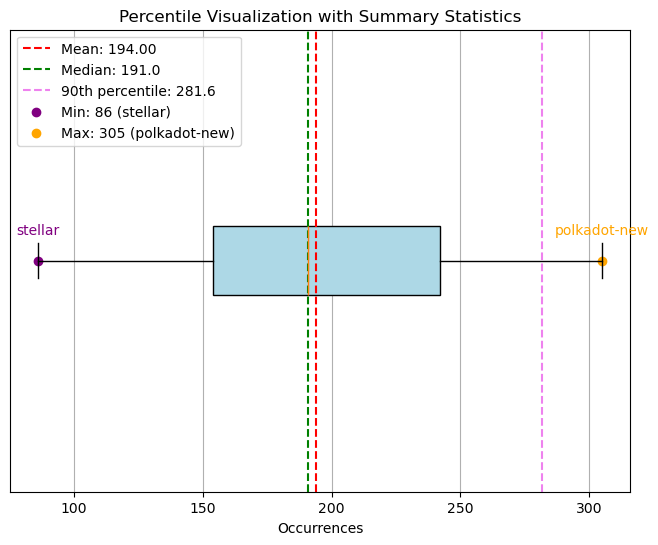

In [145]:
# Plot box plot
plt.figure(figsize=(8, 6))
plt.boxplot(mrl_freq, vert=False, patch_artist=True, boxprops=dict(facecolor="lightblue"))

# Define quantile variables
p10 = mrl_freq.quantile(0.1)
p90 = mrl_freq.quantile(0.9)
p25 = mrl_freq.quantile(0.25)
p75 = mrl_freq.quantile(0.75)

# Add mean, median, quartiles, min, and max
# Add mean, median, min, max annotations
plt.axvline(mrl_freq.mean(), color="red", linestyle="--", label=f"Mean: {mrl_freq.mean():.2f}")
plt.axvline(mrl_freq.median(), color="green", linestyle="--", label=f"Median: {mrl_freq.median()}")
plt.axvline(p90, color = "violet", linestyle = "--", label = f"90th percentile: {p90}" )
plt.scatter(x = mrl_freq.min(),y=  1, color="purple", label=f"Min: {mrl_freq.min()} ({mrl_freq.idxmin()})")
plt.scatter(mrl_freq.max(), 1, color="orange", label=f"Max: {mrl_freq.max()} ({mrl_freq.idxmax()})")

# Add annotations for min and max
plt.text(x = mrl_freq.min(), y = 1.05, s = f"{mrl_freq.idxmin()}", fontsize = 10, color = "purple", ha = "center", va = "bottom")
plt.text(x = mrl_freq.max(), y = 1.05, s = f"{mrl_freq.idxmax()}", fontsize = 10, color = "orange", ha = "center", va = "bottom")
# Add title and labels
plt.title("Percentile Visualization with Summary Statistics")
plt.xlabel("Occurrences")
plt.yticks([])  # Hide y-axis as it's not needed for a single boxplot
plt.legend()
plt.grid(axis="x")

plt.show()

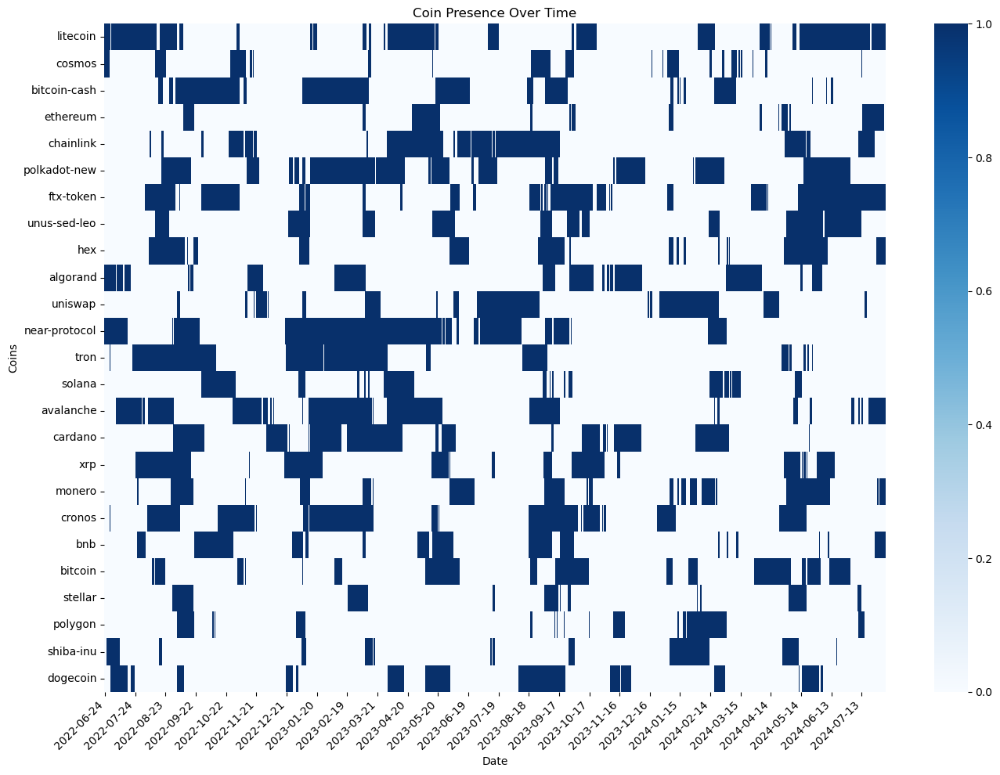

In [146]:
# Visualize occurrence over time for each coin
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(14, 10))
sns.heatmap(mrl_df.T, cmap="Blues", cbar=True, xticklabels=30, yticklabels=True)

# Rotate the x-axis labels to make them readable
plt.xticks(rotation=45, ha="right")

# Add labels and title
plt.title("Coin Presence Over Time")
plt.xlabel("Date")
plt.ylabel("Coins")

# Display the plot
plt.tight_layout()
plt.show()


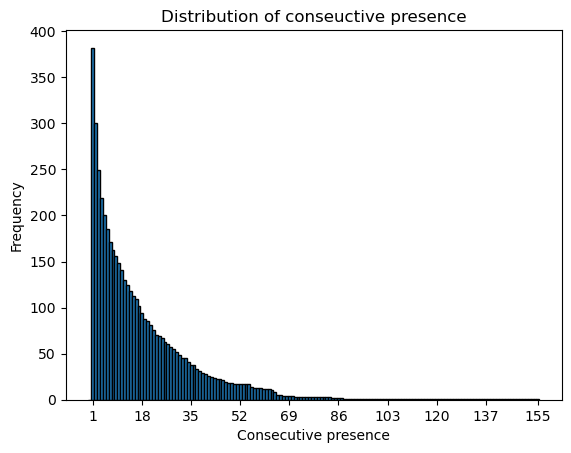

,counts,percentage_chage
0,14500,0.973655
1,382,0.214660
2,300,0.170000
3,249,0.120482
4,219,0.086758
5,200,0.075000
6,185,0.075676
7,171,0.052632
8,162,0.037037
9,156,0.051282


In [147]:
# Construct cumulative sum for consecutive non-zero values only
cumsum_reset_dic = {}
for coin in mrl_df.columns:
  cumulative_sum = 0
  cumsum_reset = []
  for i in mrl_df[coin]:
    if i == 1:
      cumulative_sum += 1
    else:
      cumulative_sum = 0
    cumsum_reset.append(cumulative_sum)
  cumsum_reset_dic[coin] = np.array(cumsum_reset)
cumsum_reset_df = pd.DataFrame(cumsum_reset_dic, index = mrl_df.index)

# Visualize
all_values = cumsum_reset_df.values.flatten()
non_zero_values = all_values[all_values > 0]
plt.hist(non_zero_values, bins=range(0, max(all_values)+2), edgecolor='black', align='left')
plt.title('Distribution of conseuctive presence')
plt.xlabel('Consecutive presence')
plt.ylabel('Frequency')
plt.xticks(np.linspace(min(non_zero_values), max(non_zero_values), 10, dtype=int))
plt.show()

unique_values, counts = np.unique(all_values, return_counts= True)
abs_diff = np.abs(counts[:-1] - counts[1:])
change_percentage = abs_diff / counts[:-1] 
pd.DataFrame({"counts": counts[:-1], "percentage_chage":change_percentage}, index = unique_values[:-1]).iloc[0:15]

##### Remarks
- We see that there is stark difference from setting $q=1$ and $q \gt 1$. For instance, 20% of the time we see a coin being included in $mrl_t$ for the first time, it has been excluded the next day. However, this percentage change decreases rapidly for larger $q$, indicating the rate of false positive decreases as we choose to trade coins that pass the mean-reversion filter for longer days.
  - This test does ignore the case in which a coin fluctuates between the value 0 and 1 consecutively, which may indicate the coin is mean-reverting but not long enough to pass the filter consecutive number of times.

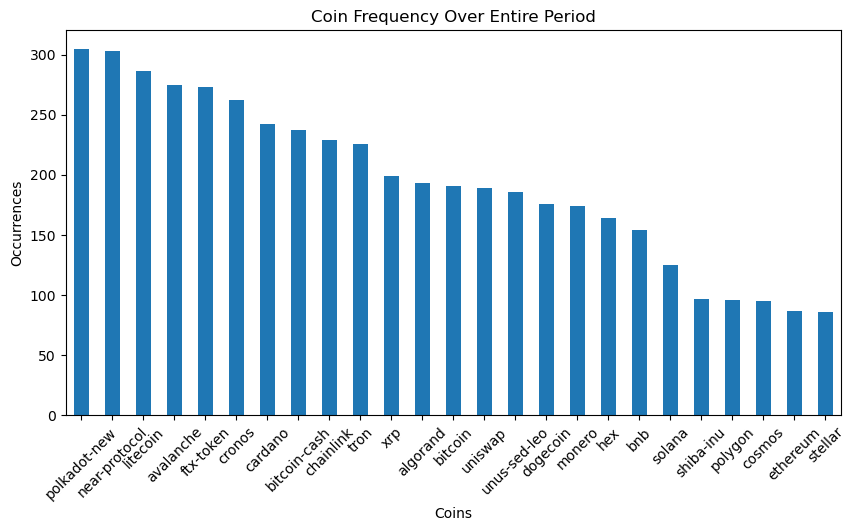

In [148]:
# Visualize number of occurrences over entire period for each coin
mrl_freq.plot(kind="bar", figsize=(10, 5))
plt.title("Coin Frequency Over Entire Period")
plt.xlabel("Coins")
plt.ylabel("Occurrences")
plt.xticks(rotation=45)
plt.show()


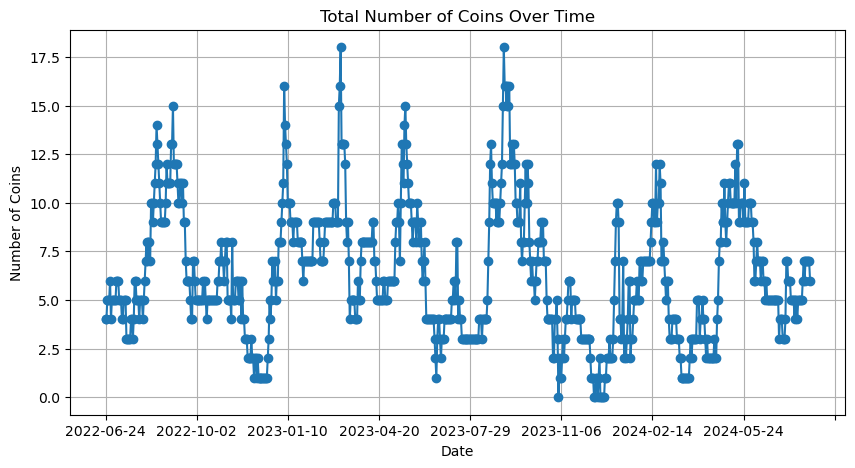

In [149]:
# Total number of mrl constituents over time
total_coins_per_day = mrl_df.sum(axis=1)
total_coins_per_day.plot(kind="line", figsize=(10, 5), marker='o')
plt.title("Total Number of Coins Over Time")
plt.xlabel("Date")
plt.ylabel("Number of Coins")
plt.grid()
plt.show()


##### Remarks

- Near-Protocol seemed to display most mean-reverting behaviour, consistently being mean-reverting between late 2022 and late 2023.
- All coins appear at least 100 times in the $mrl$ over the entire period. 
- Bitcoin and Ethereum, the leading two coins, don't seem to display much mean-reverting behaviour. This is somewhat surprising, since one would expect Bitcoin and Ethereum to be *the* market for cryptocurrencies, so hedging them with eigenportfolios should leave us with minimal idio risk...? An immediate thought was that maybe the eigenportfolios themselves don't have much exposure to bitcoin and ethereum, at least not as much as we would have thought they would. This question derserves more thinking.
- On average, $E[mrl_t] \approx 6.47$.
- A key observation is that **occurences seem to be sticky**. In other words, a coin that is included in a sequence of $mrl_t$ is more likely to be included in the next future sequence of $mrl_t$ compared to a coin that is excluded or a coin that has been included for one or two days. Not only are occurrences sticky, also **non-occurrences seem to be sticky as well.**

We will work with the last observation a bit more.



In [150]:
import pandas as pd
import numpy as np

def mrl_cond_prob(df, 
                                         past_lag=2, 
                                         future_lag=2,
                                         past_value=1,
                                         future_value=1):
    """
    Compute:
      1) The empirical probability (conditional_probability) that the next `future_lag` days 
         are all == `future_value`, GIVEN that the past `past_lag` days are all == `past_value`.
      2) The unconditional probability (unconditional_probability) that ANY `future_lag` days 
         in the series are all == `future_value` (with no condition on the past window).

    In notation:
        P( O_{t+1}=fv, ..., O_{t+future_lag}=fv 
          | O_{t}=pv, O_{t-1}=pv, ..., O_{t-(past_lag-1)}=pv )

    for each column (coin) in df, which has 0/1 entries.

    Parameters
    ----------
    df : pd.DataFrame
        Rows = dates (or time steps), columns = coins, values in {0,1}.
    past_lag : int
        Number of consecutive days in the past that must be == `past_value`.
    future_lag : int
        Number of consecutive days in the future that must be == `future_value`.
    past_value : int
        Either 0 or 1; the value for the past condition.
    future_value : int
        Either 0 or 1; the value for the future condition.

    Returns
    -------
    result_df : pd.DataFrame
        Index = coin names
        Columns:
          "conditional_probability": 
              (count_both_satisfied / count_past_satisfied) 
               if count_past_satisfied > 0, else NaN
          "count_past_satisfied": 
              How many time points t had the past-lag condition satisfied
          "count_both_satisfied": 
              Among those t, how many also satisfy the future-lag condition
          "unconditional_probability":
              Probability that any consecutive `future_lag` window in the entire 
              series is all == future_value (no conditioning on the past)
          "predictive_gain":
              = conditional_probability - unconditional_probability 
              (NaN if conditional_probability is NaN)

    """

    results = []

    for coin in df.columns:
        series = df[coin].values  # array of 0/1
        n = len(series)

        # -------------------------
        # 1) Compute conditional probability
        # -------------------------
        count_past_satisfied = 0
        count_both_satisfied = 0

        # We'll iterate t from (past_lag-1) up to (n - future_lag - 1)
        start_t = past_lag - 1
        end_t   = n - future_lag - 1

        if start_t <= end_t:
            for t in range(start_t, end_t + 1):
                # Past condition: series[t-(past_lag-1) ... t] all = past_value
                past_vals = series[t - (past_lag - 1) : t+1]  # length = past_lag
                if np.all(past_vals == past_value):
                    count_past_satisfied += 1

                    # Future condition: series[t+1 ... t+future_lag] all = future_value
                    future_vals = series[t+1 : t+1+future_lag]  # length = future_lag
                    if np.all(future_vals == future_value):
                        count_both_satisfied += 1

        if count_past_satisfied > 0:
            cond_prob = count_both_satisfied / count_past_satisfied
        else:
            cond_prob = np.nan

        # -------------------------
        # 2) Compute unconditional probability
        #    of having ANY 'future_lag' consecutive days == future_value
        # -------------------------
        if n >= future_lag:
            uncond_count = 0
            # We can have a start index i from [0 .. n-future_lag]
            # Check if series[i : i+future_lag] are all 'future_value'
            for i in range(n - future_lag + 1):
                window_vals = series[i : i + future_lag]
                if np.all(window_vals == future_value):
                    uncond_count += 1
            
            uncond_possible_starts = (n - future_lag + 1)
            if uncond_possible_starts > 0:
                uncond_prob = uncond_count / uncond_possible_starts
            else:
                uncond_prob = np.nan
        else:
            # not enough data for 'future_lag'
            uncond_prob = np.nan

        # "Predictive gain" or difference: how much bigger (or smaller)
        # the conditional probability is compared to the unconditional?
        if pd.isna(cond_prob):
            pred_gain = np.nan
        else:
            pred_gain = cond_prob - uncond_prob if not pd.isna(uncond_prob) else np.nan

        results.append({
            "coin": coin,
            "conditional_probability": cond_prob,
            "count_past_satisfied": count_past_satisfied,
            "count_both_satisfied": count_both_satisfied,
            "unconditional_probability": uncond_prob,
            "predictive_gain": pred_gain
        })

    result_df = pd.DataFrame(results).set_index("coin")
    return result_df


# ------------------------------------------------
# Example usage:
# ------------------------------------------------
if __name__ == "__main__":
    # Suppose you have a DataFrame df with 0/1 entries
    # E.g. P( next 2 days=1 | past 3 days=0 ), plus unconditional prob of 2-day=1
    #
    # result_df = conditional_probability_general_lags(df, 
    #                                                 past_lag=3, 
    #                                                 future_lag=2, 
    #                                                 past_value=0, 
    #                                                 future_value=1)
    # print(result_df)
    #
    pass


In [151]:
mrl_cond_prob(mrl_df, past_lag = 1, future_lag = 1, past_value = 1, future_value = 1)

,conditional_probability,count_past_satisfied,count_both_satisfied,unconditional_probability,predictive_gain
coin,,,,,
litecoin,0.929825,285,265,0.369509,0.560316
cosmos,0.789474,95,75,0.122739,0.666735
bitcoin-cash,0.932489,237,221,0.306202,0.626288
ethereum,0.862069,87,75,0.112403,0.749666
chainlink,0.930131,229,213,0.295866,0.634265
polkadot-new,0.940984,305,287,0.394057,0.546927
ftx-token,0.926471,272,252,0.352713,0.573757
unus-sed-leo,0.946237,186,176,0.240310,0.705926
hex,0.914110,163,149,0.211886,0.702224


In [152]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # needed for 3D plotting

def _compute_conditional_probability(series, past_lag, future_lag, value=1):
    """
    Compute P( next `future_lag` days = `value` | last `past_lag` days = `value` )
    for a single array 'series' of 0/1.
    Returns np.nan if we cannot compute (e.g., no valid times).
    """
    arr = series.values if isinstance(series, pd.Series) else series
    n = len(arr)
    if n < past_lag + future_lag:
        return np.nan  # not enough data

    count_past = 0
    count_both = 0

    # valid t from [past_lag-1 .. n-future_lag-1]
    start_t = past_lag - 1
    end_t   = n - future_lag - 1

    if start_t > end_t:
        return np.nan

    for t in range(start_t, end_t + 1):
        past_window = arr[t - (past_lag - 1) : t + 1]  # length = past_lag
        if np.all(past_window == value):
            count_past += 1
            future_window = arr[t+1 : t+1+future_lag]  # length = future_lag
            if np.all(future_window == value):
                count_both += 1
    
    if count_past == 0:
        return np.nan
    else:
        return count_both / count_past

def _compute_unconditional_probability(series, future_lag, value=1):
    """
    Compute the unconditional probability that any h-day block is all == `value`.
    i.e., number of h-day blocks fully `value` / total possible h-day blocks.
    """
    arr = series.values if isinstance(series, pd.Series) else series
    n = len(arr)
    if n < future_lag:
        return np.nan
    
    count_val = 0
    total_blocks = n - future_lag + 1

    for i in range(total_blocks):
        window = arr[i : i + future_lag]
        if np.all(window == value):
            count_val += 1

    return count_val / total_blocks

def probability_surface_for_coin(
    df, 
    coin,
    value=1, 
    conditional=True,
    k_grid=range(1,6), 
    h_grid=range(1,6),
    plot=True,
    plot_view="2d"
):
    """
    Generate a 2D matrix of probabilities for a single coin's 0/1 series, 
    across a grid of (past_lag = k, future_lag = h).

    Parameters
    ----------
    df : pd.DataFrame
        A DataFrame of 0/1 time series. Rows = time, columns = coin names.
    coin : str
        Column name in df for which we compute the surface.
    value : int (0 or 1)
        The value of interest (e.g., 0 => 'conditional on 0 => future=0').
    conditional : bool
        If True, compute P(future_lag days= value | past_lag days= value).
        If False, compute unconditional probability:
          P(any h-day block = value).
        In unconditional mode, 'k_grid' is effectively ignored (the same
        value is repeated across all k in that row).
    k_grid : iterable
        Range or list of k (past_lag) values for the 'rows' of the surface.
    h_grid : iterable
        Range or list of h (future_lag) values for the 'columns' of the surface.
    plot : bool
        Whether to display a matplotlib figure of the resulting surface.
    plot_view : {'2d', '3d'}
        - "2d": Show a 2D heatmap of the probability surface
        - "3d": Show a 3D surface plot

    Returns
    -------
    (K, H, surface) :
        K, H = sorted lists from k_grid, h_grid
        surface = 2D numpy array of shape [len(K), len(H)] containing
                  the probabilities for each (k,h).
    """
    if coin not in df.columns:
        raise ValueError(f"Coin '{coin}' not found in DataFrame columns.")

    series = df[coin]
    K = sorted(k_grid)
    H = sorted(h_grid)

    # Prepare result matrix
    surface = np.zeros((len(K), len(H))) * np.nan

    for i, k in enumerate(K):
        for j, h in enumerate(H):
            if conditional:
                p_val = _compute_conditional_probability(
                    series, 
                    past_lag=k, 
                    future_lag=h, 
                    value=value
                )
            else:
                p_val = _compute_unconditional_probability(
                    series, 
                    future_lag=h, 
                    value=value
                )
            surface[i, j] = p_val

    if plot:
        title_str = (f"{'Conditional' if conditional else 'Unconditional'} Probability of "
                     f"{'Occurrence' if value == 1 else 'Non-occurrence'} for {coin}")
        
        if plot_view == "2d":
            # 2D heatmap
            fig, ax = plt.subplots(figsize=(7,5))
            c = ax.imshow(
                surface,
                origin="lower",
                aspect="auto",
                extent=[min(H)-0.5, max(H)+0.5, min(K)-0.5, max(K)+0.5],
                cmap="viridis",
                vmin=0, vmax=1
            )
            ax.set_title(title_str)
            ax.set_xlabel("future_lag (h)")
            ax.set_ylabel("past_lag (k)")
            fig.colorbar(c, ax=ax, label="Probability")
            plt.show()
        
        elif plot_view == "3d":
            # 3D surface
            # Create coordinate matrices from H, K
            X, Y = np.meshgrid(H, K)  # shape = (len(K), len(H)) for both X, Y
            fig = plt.figure(figsize=(8,6))
            ax = fig.add_subplot(111, projection='3d')
            
            # surface is same shape => (len(K), len(H))
            surf = ax.plot_surface(
                X, Y, surface, 
                cmap="viridis", 
                edgecolor="none",
                rcount=50, ccount=50  # resolution
            )
            ax.set_title(title_str)
            ax.set_xlabel("future_lag (h)")
            ax.set_ylabel("past_lag (k)")
            ax.set_zlabel("Probability")
            fig.colorbar(surf, ax=ax, shrink=0.5, aspect=5)
            plt.show()

        else:
            raise ValueError("plot_view must be either '2d' or '3d'.")

    return K, H, surface


    # Example:
    # Suppose 'df' is a DataFrame with columns=['BTC','ETH','XRP'] etc., each a 0/1 series.
    # We'll see how the conditional probability surface looks for BTC, 
    # k_grid=[1..5], h_grid=[1..5], focusing on value=1:
    #
    # K, H, surf = probability_surface_for_coin(
    #     df,
    #     coin='BTC',
    #     value=1,
    #     conditional=True,
    #     k_grid=range(1,6),
    #     h_grid=range(1,6),
    #     plot=True,
    #     plot_view="3d"   # try "2d" or "3d"
    # )


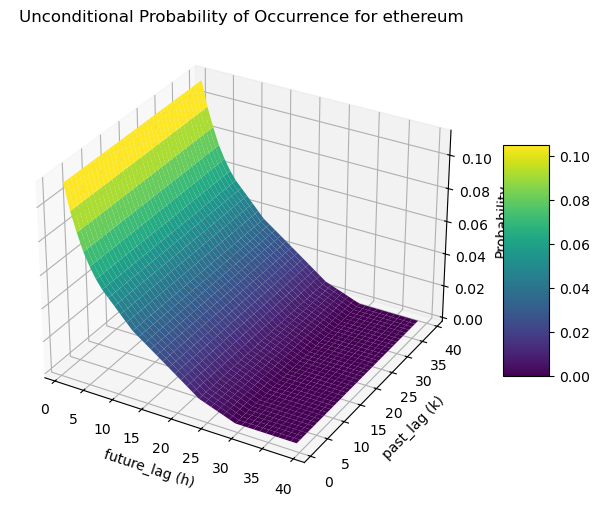

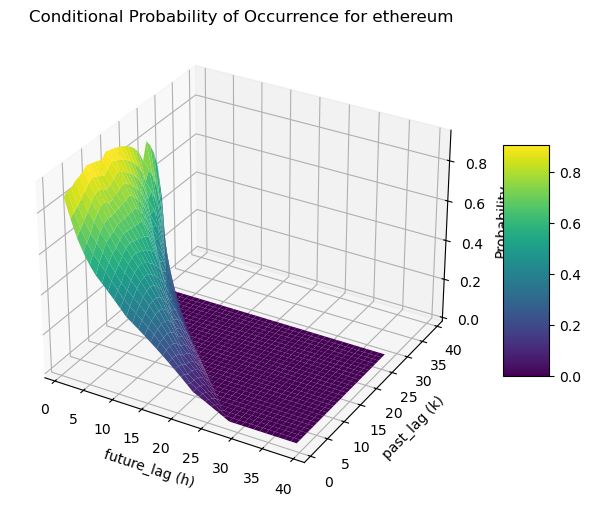

In [153]:

K, H, surf = probability_surface_for_coin(
  mrl_df,
  coin='ethereum',
  value=1,
  conditional=False,
  k_grid=range(1,40),
  h_grid=range(1,40),
  plot=True,
  plot_view="3d"   # try "2d" or "3d"
  )

_, _, _ = probability_surface_for_coin(
  mrl_df,
  coin='ethereum',
  value=1,
  conditional=True,
  k_grid=range(1,40),
  h_grid=range(1,40),
  plot=True,
  plot_view="3d"   # try "2d" or "3d"
  )



##### Remarks
- Notice how the the surface is smooth and downward sloping with respect to future lag. Moreover, it seems that we can use a small number of past lag parameter to conclude on the behaviour of future occurrence of coins within $mrl_t$. 
- Conditional probabilities, as we have postulated, seem to be much larger than their unconditional counterparts; this is more true in the case of positive occurrences, as we can see for the case of Ethereum. Unconditional probability of occurrence maxes out at 0.12 while conditioning on past lags result in maximum value of around 0.9.
- Using past_lag value of 7 seems reasonable; we can even set it to a smaller parameter according to the surface.
- We can perform some sort of resampling test like the permutation test to see how our estimate of conditional probabilities lie on the empirical distribution generated by resampling method. When taking this path, we should think more about the resampling methodology since we don't want to change any major temporal structure our intial sample has.

Now back to answering the main question we posed in the beginning of this section.

  "what should be the appropriate level of $q$ that doesn't incur too much trading costs while at the same time limiting the probability of maintaining a mean-reversion trade that lost its mean-reversion property?"

$q$ is basically the *optimal past lag parameter resulting in highest conditional probability of future exclusion given past exclusion (from mrl) while minimizing rebalancing costs*.

From our rough analysis, we see that stickyness was a feature prevalent regardless of the length of past_lag parameter. Therefore, our initial hypothesis of setting 7 days as our waiting time is reasonable according to the results.

### Generating trading signals
Assume we will be trading the coins that passed the threshold set above (mean reversion time is around 1 week). 

The next important question we ask ourselves is, *how do we generate trading signals*? 

We can actually take several appraoches from here, and a detailed comparison analysis is required to decide the most appropriate one. In this paper, we will be adopting the methodology proposed by Avellaneda (2008); generate dimensionless s-scores, look for upper and lower thresholds, generate trading signal for the first out of sample date, and then roll forward to repeat the previous steps, thus generating a sequence of OOS trading signals.

First, we generate s-scores and visualize them to see how they differ from the auxiliary series.

In [154]:
test_ou_params_df

,kappa,m,sigma,sigma_eq,tau
coin,,,,,
algorand,80.232659,0.097325,0.612224,0.048330,0.012464
avalanche,35.884828,-0.102596,0.451549,0.053301,0.027867
bitcoin,0.859928,-1.472190,0.296019,0.225722,1.162888
bitcoin-cash,-4.137636,0.481117,0.021792,NaN,inf
bnb,24.390448,-0.000825,0.309202,0.044271,0.041000
cardano,19.152362,0.255114,0.540351,0.087307,0.052213
chainlink,14.807803,0.309649,0.505689,0.092923,0.067532
cosmos,-1.604494,-0.741098,0.027194,NaN,inf
cronos,7.563343,-0.276164,0.378605,0.097345,0.132217


In [155]:
# Construct function to compute s-score df

def compute_s_scores(aux_df, ou_params_df, coef_df, date, mean_reverting_coins, modified = False):
    """
    Compute s-scores of auxiliary series for each coin i using:
      s_i(t) = [X_i(t) - m_i] / sigma_eq_i

    If modified = True, we compute modified s-score using:
      s_mod,i = s_i(t) - [alpha_i /kappa_i*sigma_eq,i]

    Dependencies
    ------------
    numpy, pandas
    
    Parameters
    ----------
    aux_df : pd.DataFrame
        Auxiliary series (rows=dates, columns=coins).
    ou_params_df : pd.DataFrame
        OU parameter DataFrame indexed by coin, with columns=["kappa", "m", "sigma", "sigma_eq", "tau"].

    coef_df : dictionary of pd.DataFrame
        key is coin. values are dataframes, where columns are predictor variables (includign cosntant), indexed by date
        The dataframe stores regression coefficient estimates
    
    date : date in string format
        date for which we extract the factor regression coefficients from the rolling regression dictionary
        
    mean_reverting_coins : List
        List containing the coin names that pass the threshold tau < T1 
        
    Returns
    -------
    sscore_df : pd.DataFrame
        s-score series with same shape as aux_df.
    """
    if modified:
        # Construct Extract regression coefficients for specific date
        hedge_ratio = {coin: coef_df[coin].loc[date].values for coin in coef_df.keys()}
        hedge_ratio_df = pd.DataFrame(hedge_ratio, index = coef_df["bitcoin"].loc[date].index).T

        # Extract drift values
        drift_vec = hedge_ratio_df["constant"]
        modified_sscore_dict = {}

    sscore_dict = {}
    for coin in mean_reverting_coins:
        
        m_i = ou_params_df.loc[coin, "m"]
        sigma_eq_i = ou_params_df.loc[coin, "sigma_eq"]
        
        # s(t) = [X_i(t) - m_i] / sigma_eq_i
        # handle if sigma_eq_i is zero or NaN
        if (not pd.isna(sigma_eq_i)) and (sigma_eq_i != 0):
            sscore_dict[coin] = np.insert(((aux_df[coin].iloc[1:] - m_i) / sigma_eq_i) , 0, 0) # Set s-score to zero initially, since 0 in auxiliary series was set arbitrarily
        else:
            # degenerate => s-score is NaN
            sscore_dict[coin] = np.nan
        
        if modified:
            alpha_i = hedge_ratio_df.loc[coin]["constant"]
            modified_sscore_dict[coin] = np.insert(sscore_dict[coin][1:] - alpha_i / (ou_params_df.loc[coin]["kappa"] - ou_params_df.loc[coin]["sigma_eq"]),0,0)   
    
    mod_sscore_df = pd.DataFrame(modified_sscore_dict, index = aux_df.index)
    sscore_df = pd.DataFrame(sscore_dict, index=aux_df.index)
    if modified:
        return sscore_df, mod_sscore_df
    else:
        return sscore_df

            algorand  dogecoin  litecoin  near-protocol  shiba-inu
2024-06-06  0.000000  0.000000  0.000000       0.000000   0.000000
2024-06-07 -2.100908  3.085065  0.433541       1.695821   2.847678
2024-06-08 -2.765291  2.764253  0.907588       0.959422   2.997967
2024-06-09 -2.473167  2.689046  0.828467       0.819747   3.060734
2024-06-10 -2.598429  2.643366  0.891841       0.781193   2.844671
...              ...       ...       ...            ...        ...
2024-08-01 -3.516764  1.323278  0.482327       2.089965  -1.678111
2024-08-02 -3.809762  1.137062  0.415209       1.787409  -1.570456
2024-08-03 -3.849603  0.779871  0.797294       1.903317  -2.060760
2024-08-04 -3.592928  0.982605  1.306482       2.150901  -2.020015
2024-08-05 -2.739358  0.397760  0.450489       1.601112  -1.081514

[61 rows x 5 columns]
            algorand  dogecoin  litecoin  near-protocol  shiba-inu
2024-06-06  0.000000  0.000000  0.000000       0.000000   0.000000
2024-06-07 -2.100917  3.085042  0.43352

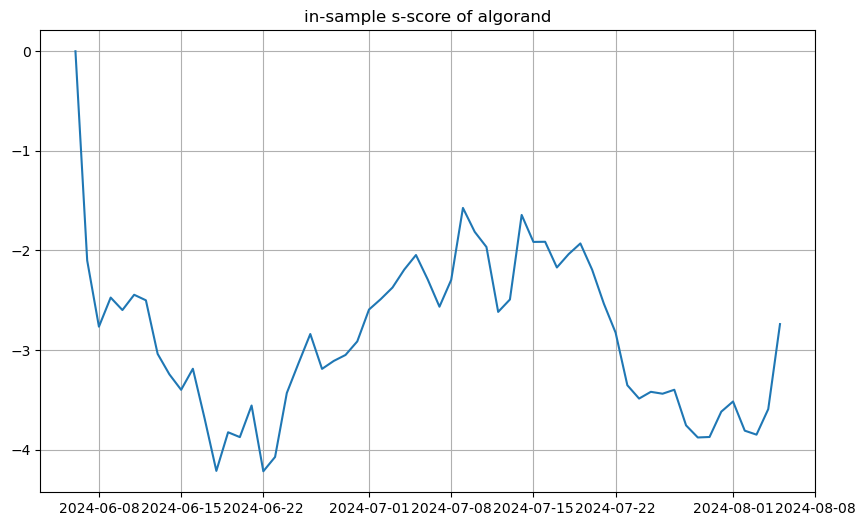

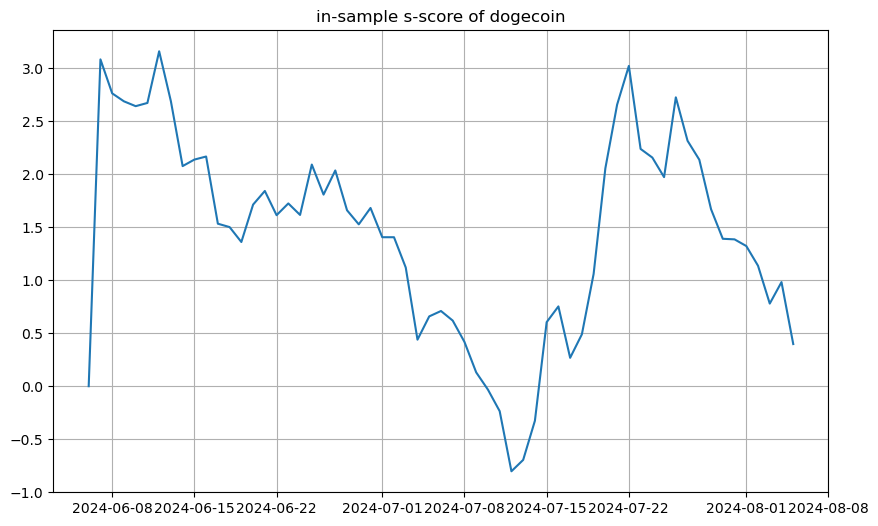

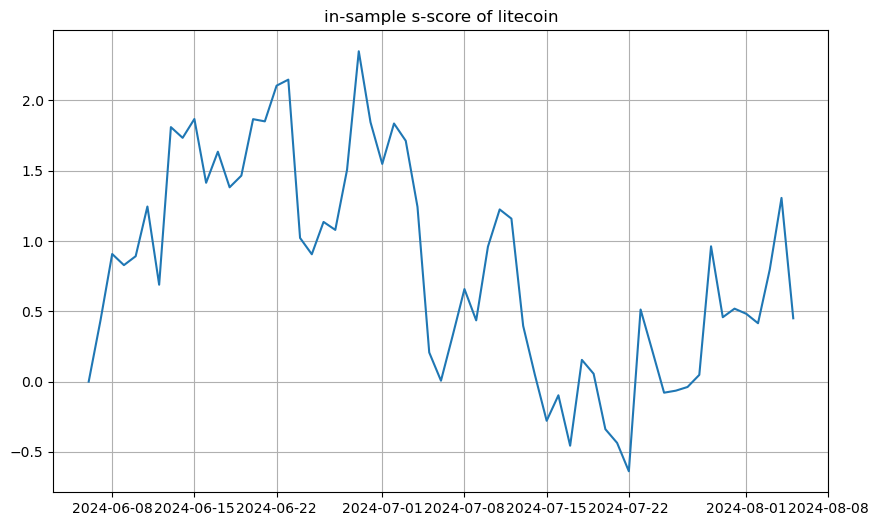

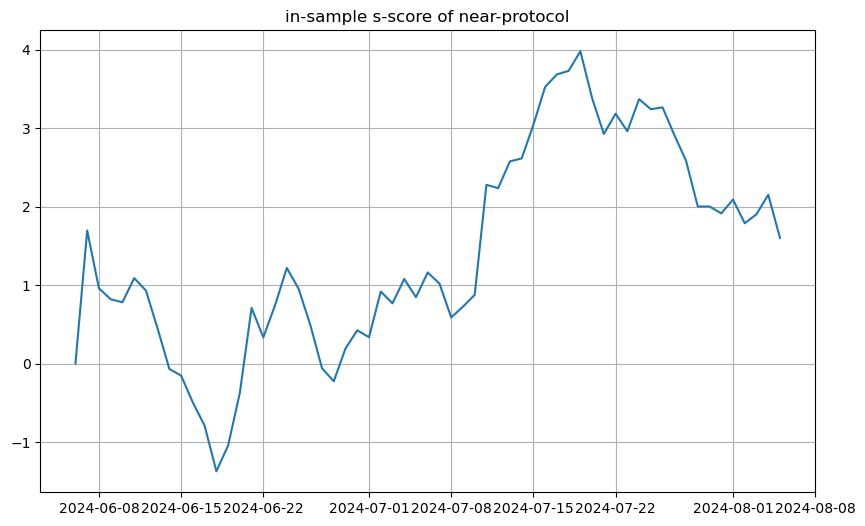

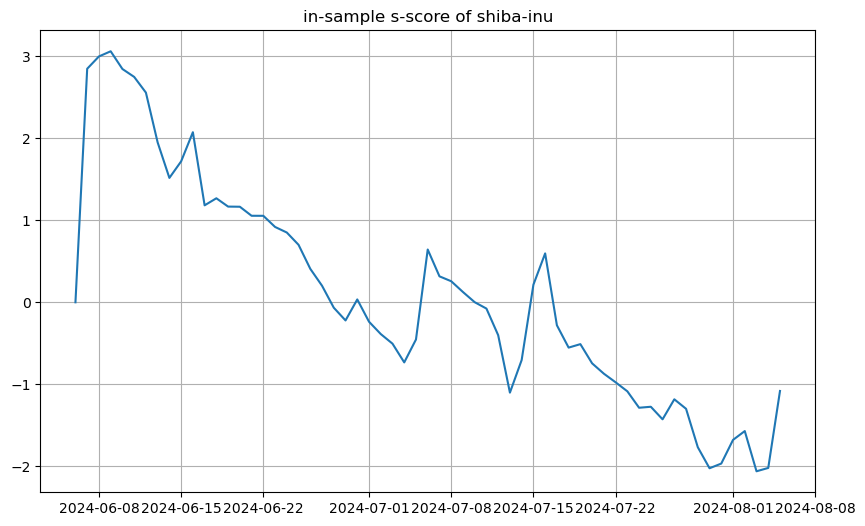

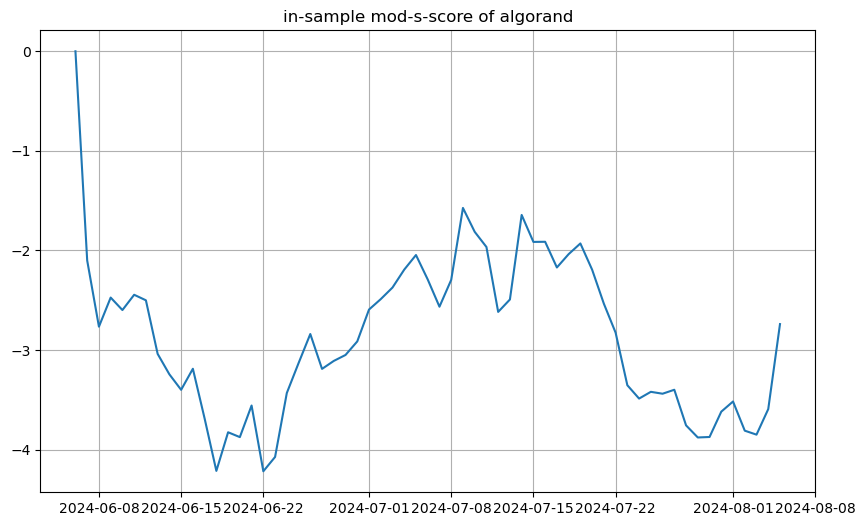

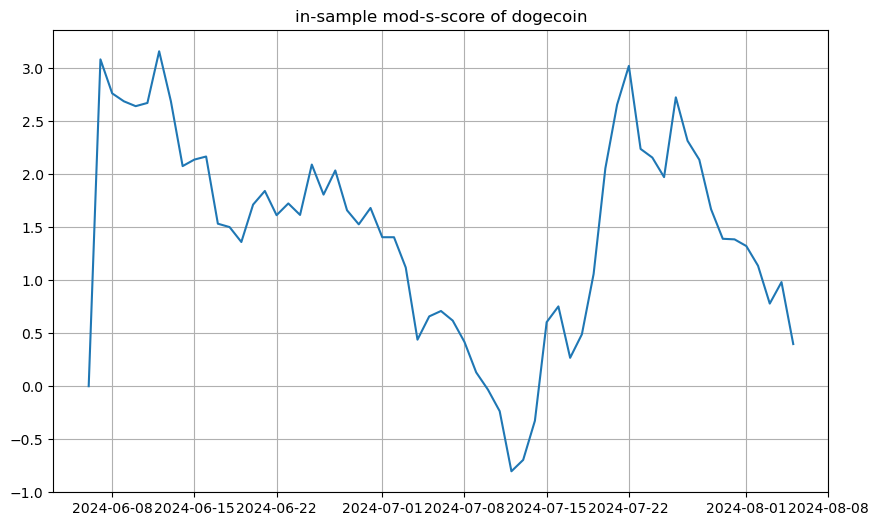

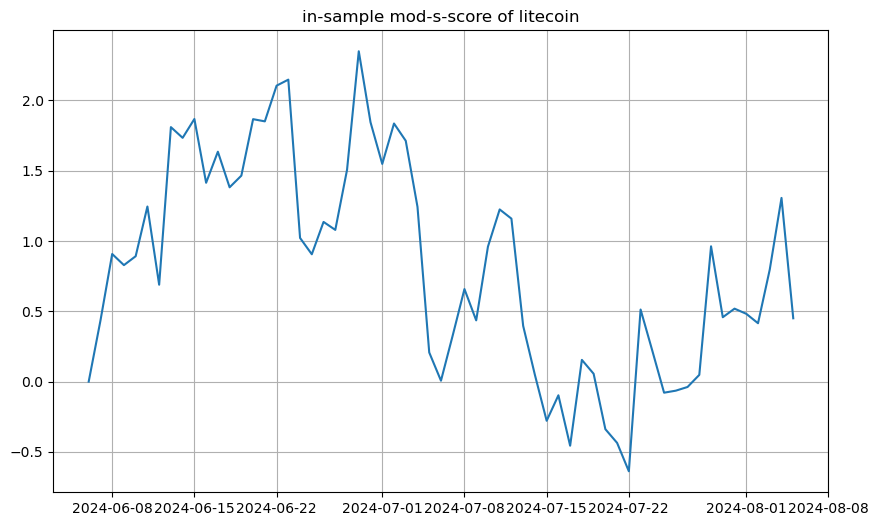

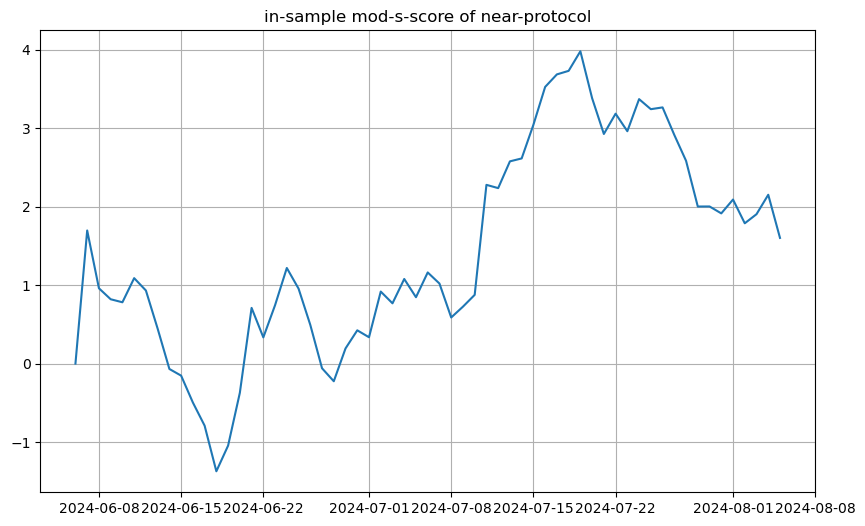

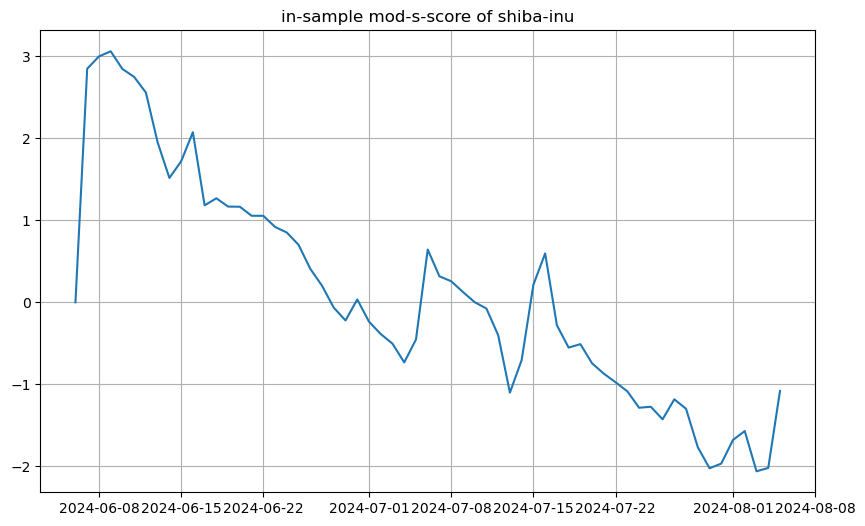

In [156]:
# Test function
test_sscore_df, test_mod_sscore_df = compute_s_scores(test_aux_df, test_ou_params_df, coef_df=coef_df, date = "2022-07-01", mean_reverting_coins = test_tradable_coins, modified = True)

print(test_sscore_df)
print(test_mod_sscore_df)

# Plot s-scores
for column in test_sscore_df:
  plt.figure(figsize = (10,6))
  plt.plot(test_sscore_df.index, test_sscore_df[column], label = f"{column}")
  plt.title(f"in-sample s-score of {column}")
  plt.grid()
for column in test_mod_sscore_df:
  plt.figure(figsize = (10,6))
  plt.plot(test_mod_sscore_df.index, test_mod_sscore_df[column], label = f"{column}")
  plt.title(f"in-sample mod-s-score of {column}")
  plt.grid()

## Backtesting
In this section, we will aggregate what we have done so far. We will adopt a *dynamic rebalancing* method during our backtesting period. First, we define some important periods.

1. PCA estimation period: 180 days. First estimation period is from 2022-01-01 to 2022-07-01. Trading universe is extracted based on date 2022-07-01 (T-1, where T is trading date).
2. Auxliary Series estimation period: 60 days. First estimation period is from 2022-07-01 - 60 days to 2022-07-01. We also generate our hedging ratios.
3. OU Process esimtation period: 60 days. Same as above.
4. Validation Period: Period in which we optimize our s-score thresholds. From 2022-07-02 to 2023-01-01. six months.
5. Test Period: This will be our final backtesting date where we measure performance of our strategy. From 2023-01-02 to 2024-08-05. More than one and a half year.

##### Backtesting high-level procedure
1. On our first PCA rebal date, extract trading universe based on that date (2022-07-01 will be first rebal date), retrieve price data, convert to returns, conduct PCA, vol-weight top five eigenvectors (Q matrix), and matrix multiply to get top five eigenportfolio return matrix.
2. Conduct regression of each coin return on five eigenportfolios (set window size as 90 days). Save hedge ratios (and drift if necessary), residual return series, and auxiliary series (cumulative sum series of residuals)
3. Estimate OU process for all coins. Extract coins whose mean reversion time is less than 7/365. Compute (modified) s-score series of length 60. Note that for estimating OU process, we extract most recent 60 observations of our auxiliary series
4. Determine whether to long-short the next day based on last value of auxiliary series. There are several methods to capture the signal.
    - Long or short the stat-arb portfolio $k$, where $k$ denotes the mean-reverting coin we obtained from 3. If total capital is 100,000 usd, allocate $\omega_k \times 100,000$ to stat-arb portfolio $k$. $\Sigma_{i=1}^{n(p_t)} \omega_i = 1$, where $n(p_t)$ is the *number of coins in trading universe generated at time t*. For capital allocated to stat-arb portfolio $k$, we employ leverage of amount $1 + \Sigma_{j=1}^5| \beta_{k,j}|$ Hold until next signal is generated. 
    - Similar to above method, but this time we aim to exactly replicate payoff implied by residual returns. Thus, we rebalance each day to maintain same dollar ratio.
5. Again more than one method.
    - If we choose to not rebalance our position each day: After close of next day, we use *same eigenportfolio return matrix* and *same hedge ratio* to compute residual return. Compute updated auxiliary series value, corresponding (modified) s-score, and then decide whether to long or short.
        - After close of next day, we conduct a rolling regression with fixed window, but one day moved forward. We obtain new hedge ratios (betas), new residual series and thus new auxiliary series, and then new estimates for the OU parameters. This will sometimes lead to $\tau_i < \tau_{threshold}$. In this case, we reject the model and either 1) don't open new trades or 2) close all open trades. This follows convention of the original paper.
    - If choose to rebalance every day: After close of next day, we use *same eigenportfolio return matrix* to extract *new hedge ratios* and thus new auxiliary series. We also estimate OU process again, obtaining new parameter estimates. If $\tau_{i,new}$ indicates there is new coin displaying mean reversion behavior, we compute its (mod) s-score series and generate trading signal for next day (if there is one). If mean-reversion parameter estimate implies one of the coins in $mrl_{old}$ should be excluded, we can either 1) close position regarding that coin immediately, regardless of pnl, or 2) use a counting system that essentially acts as time-stop. We also obtain new $m_i$ and $\sigma_{eq,i}$, and then compute (mod) s-score series. Then, extract last value of s-score series and append to our original s-score series. See if it crosses any threshold.
      - If we choose system 2), then we close the position on the day count == 7, which means that the coin was excluded from $mrl_{new}$ for 7 consecutive days, and so we can conclude that probability of committing type II error is small. Moreover, to open positions, we require not only the 
      - System 1) is a more straightforward method. Basically, if coin is in $mrl_{new}$ and last value of (mod) s-score series crosses threshold($s_{bo}, s_{so}$), then we open a position. If either coin is not in $mrl_{new}$ or it is in $mrl_{new}$, position $\ne$ 1, and crosses a threhold to close position($s_{bc}, s_{sc}$), then we close the position regarding that coin. 
6. At start of every month, we extract new trading list, compute new eiegenportfolio returns, and thus new hedge ratios, auxiliary series, and OU process parameters. We close all positions at end of every month and open new positions.

  - **Alternative method 1:** we can initiate the new cycle at the 22nd day of using the same eigenportfolio returns. However, we only keep track of $mrl_t$ and s-score series but do not open trades. Also, while we don't close already open positions at the start of 22nd day, we also don't open any new trades according to the model. We initiate a time stop of 7 days and after 7 days all positions regarding the old eigenportfolio will be closed. On the 29th day, we open positions according to signal generated on 28th day based on our *new* eigenportfolios, and a new cycle of 21 days start.
    - There is risk of foregoing profitable trades since 1/4 of the trading period is considered to be "a dormant period". 
  - **Alternative method 2:** On last day of each month, we generate new eigenportfolio returns based on new trading universe, and open trades the next day (start of each month). Moreover, while we don't close already open positions, we also stop using signals from the previous model. Inititae a time stop of 7 days. Hence, there is an overlap of max 7 days at the start of each month. The trades generated by the new eigenportfolio will be called the *new parent portfolio* and the trades maintained from the old eigenportfolios *old parent portfolio*. 
    - This method trades continuously based on signals, so we don't "miss" any trade. However, due to the potential overlap of max 7 days at start of each month, keeping track of the system is much more difficult, and we need to consider how we should log our trade performance.

  **For sake of simplicity we will go with the first method, which is to exit all open trades end of each month.**

We will run the above backtest throughout the validation period using different sets of s-thresholds to optimize for performance. Then, using our fianl set of threshold hyperparameter, we will run our final backtest in the testing period, and then evaluate final trading performance.


#### Calculating equity curve
Recall 
Long or short the stat-arb portfolio $k$, where $k$ denotes the mean-reverting coin we obtained from 3. If total capital is 100,000 usd, allocate $\omega_k \times 100,000$ to stat-arb portfolio $k$. 

# Putting it all together

### Preparation 
Import necessary data, modules, libraries.

In [43]:
import pandas as pd
import os
import numpy as np
import sys
import pprint
import math
from tqdm import tqdm
from datetime import datetime, timedelta
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
from sklearn.decomposition import PCA
from sklearn.linear_model import LinearRegression
import itertools
import pickle

sys.path.append(r"C:\Users\idkup\OneDrive\Jay coding\Python\General_Scripts")

import feather_import_from_r as fifr

In [3]:
class PrepareData:
  def __init__(self, data_dir, current_date, rebal_date = None, window_size = 180, parent_df =fifr.parent_df, cheat = False):
    """
    dates are in str
    start_date in PrepareData class refers to the start date of PCA estimation. We specify it because we want to truncate the returns data before standardizing it.

    Parameters
    ----------
    data_dir : insert directory containing parquet files (fifr.data_dir)
    current_date : str
      Date at which you want data to end
    rebal_date : date at which target universe is extracted ==> Dataframe fetched is based on tu extracted on rebal_date
    window_size : int
      Subtract from current_date to get start_date
    parent_df : pd.DataFrame
      df that contains price info of all coins for the entire data collection period
    cheat : boolean
      Default is false. If True, we collect price df from subsetting the parent_df. Used to reduce backtest time length.

      
    """
    self.data_dir = data_dir
    self.target_dict = fifr.target_dict
    self.price_df = None
    self.parent_df = fifr.parent_df # dataframe of price for all coins used in the entire trading period
    self.return_df = None
    self.mean_ret = None
    self.sdv_ret = None
    self.standardized_return_df = None

    self.tu = None

    self.rebal_date_str = current_date if rebal_date is None else rebal_date
    self.rebal_date = pd.to_datetime(current_date) if rebal_date is None else pd.to_datetime(self.rebal_date_str)

      
    self.start_date = pd.to_datetime(current_date) - timedelta(days = window_size + 1) # Add 1 to account for loss in data from calculating return
    self.end_date = pd.to_datetime(current_date)
    self.end_date_str = current_date
    self.start_date_str = datetime.strftime(self.start_date, "%Y-%m-%d")

    self.get_trading_universe()

    # Cheat
    if cheat == True:
     self.price_df = parent_df.loc[self.start_date : self.end_date, self.tu]
        
      
    elif cheat == False:
      self.get_price()

    self.calculate_returns()
    self.calculate_std_returns()

  def get_price(self):
    """Fetch price df using fifr module. Automatically fetches data for trading universe of that date
    
    Date Range: 20220101 ~ 20240805 ---> Truncate to start_date ~ end_date
    desired_date: str

    Returns
    nxp pd.DataFrame of prices for various coins. 
    """
    if self.end_date == self.rebal_date:
        end_date = self.end_date_str
        self.price_df = fifr.get_desired_dataframe(self.data_dir, end_date)
        self.price_df.set_index('timestamp', inplace = True)
        self.price_df.index = pd.to_datetime(self.price_df.index)
        self.price_df = self.price_df.loc[self.start_date : self.end_date]
        
    elif self.end_date != self.rebal_date:
        end_date = self.rebal_date_str # Get price from most recent rebal date
        self.price_df = fifr.get_desired_dataframe(self.data_dir, end_date)
        self.price_df.set_index('timestamp', inplace = True)
        self.price_df.index = pd.to_datetime(self.price_df.index)
        self.price_df = self.price_df.loc[self.start_date : self.end_date]
      
    return self.price_df 
  
  def get_trading_universe(self):
    """
    Get list of coins defined as trading universe of that date
    """
    
    date = self.end_date_str
    self.tu = self.target_dict[date] if self.rebal_date == self.end_date else self.target_dict[self.rebal_date_str]

    
    return self.tu 
  
  def calculate_returns(self):
    """
    Since we lose 1 data point from calculating returns, note 180 days from 20220102 is 20220701
    """
    if self.price_df is None:
          raise ValueError("Price data is not available. Fetch price data first.")
    self.return_df = self.price_df.pct_change().dropna()
    return self.return_df
  
  def calculate_std_returns(self):
    if self.return_df is None:
      raise ValueError("Return data is not available. Fetch price data first.")
    self.mean_ret = self.return_df.mean()
    self.sdv_ret = self.return_df.std()
    self.standardized_return_df = (self.return_df - self.mean_ret) / self.sdv_ret
    return self.standardized_return_df



In [4]:
class PerformPCA:
  def __init__(self, prepare_data_instance):
    self.prepare_date_instance = prepare_data_instance
    self.standardized_ret_df = prepare_data_instance.standardized_return_df
    self.ret_df = prepare_data_instance.return_df
    self.sdv_ret = prepare_data_instance.sdv_ret
    self.eigenvalues = None
    self.explained_variance_ratio = None
    self.cumulative_explained_variance_ratio = None
    self.n_components_80 = None
    self.Q = None # vol-weighted eigenportfolio weights
    self.eigportret_df = None
    self.get_eigenportfolio()

  
  def get_eigenportfolio(self):
    pca = PCA()
    pca.fit(self.standardized_ret_df)

    # Extract PCA outputs
    self.eigenvectors = pca.components_.T  # Each column is an eigenvector
    self.eigenvalues = pca.explained_variance_  # Eigenvalues of correlation matrix
    self.explained_variance_ratio = pca.explained_variance_ratio_
    self.cumulative_explained_variance_ratio = np.cumsum(self.explained_variance_ratio)

    # Determine the number of components needed to explain 80% of variance
    self.n_components_80 = np.argmax(self.cumulative_explained_variance_ratio >= 0.80) + 1 # argmax of boolean returns index of first true value

    Q = self.eigenvectors / self.sdv_ret.values[:, np.newaxis] # Broadcast appropriately

    # Normalize by 1
    Q /= abs(Q).sum(axis = 0, keepdims = True)
    Q = pd.DataFrame(Q).iloc[:, 0:5]
    Q.columns = [f"PC{i+1}" for i in range(5)] # five eigenportfolios
    self.Q = Q

    # Compute eigenportfolio returns using vol-weighting and take top 5 eigenportfolios
    eigportret_df = pd.DataFrame(self.ret_df @ self.Q.values)
    eigportret_df.columns = [f"PC{i+1}" for i in range(len(eigportret_df.columns))]
    self.eigportret_df = eigportret_df

    

    

In [5]:
# Class for conducting factor regressions
class FactorRegressionAndResidual:
    def __init__(self, prepare_data_instance, eigportret):
        """
        Initialize with instances of PrepareData and PerformPCA.
        Parameters:
        - prepare_data_instance: instance of PrepareData class.
        - pca_instance: instance of PerformPCA class.
        """
        # Use instances to access attributes
        self.coin_returns = prepare_data_instance.return_df
        self.eigport_returns = eigportret
        self.prepare_data_instance = prepare_data_instance

        # Initialize placeholders
        self.hedge_ratios = None
        self.drift = None
        self.residuals = None
        self.auxiliary_series = None

        # Initialize methods
        self.perform_regression()
        self.calculate_residuals()
        self.calculate_auxiliary_series()


    def perform_regression(self, window_size=60, include_intercept=True):
        # same slicing code as before
        end_date = self.prepare_data_instance.end_date
        start_date = end_date - timedelta(days=window_size)
        
        coin_returns_window = self.coin_returns.loc[start_date:end_date]
        eigport_returns_window = self.eigport_returns.loc[start_date:end_date]

        hedge_ratios = {}
        drift = {}
        
        # True if we want to include intercept
        fit_intercept_flag = include_intercept
        
        # Convert to NumPy arrays
        X_all = eigport_returns_window.values  # shape: (n_samples, n_factors)
        
        for coin in coin_returns_window.columns:
            y = coin_returns_window[coin].values  # shape: (n_samples,)

            # 1) Instantiate the model
            lr = LinearRegression(fit_intercept=fit_intercept_flag)
            
            # 2) Fit
            lr.fit(X_all, y)
            
            # 3) Extract coefficients
            #    If fit_intercept=True, lr.intercept_ is the intercept
            #    lr.coef_ is the array of slope coefficients
            if include_intercept:
                drift[coin] = lr.intercept_  # same as results.params[0] in Statsmodels
                hedge_ratios[coin] = lr.coef_  # same shape as results.params[1:]
            else:
                # No intercept
                hedge_ratios[coin] = lr.coef_

        col_names = eigport_returns_window.columns.tolist()
        
        if include_intercept:
            self.drift = pd.Series(drift)
        
        self.hedge_ratios = pd.DataFrame(hedge_ratios).T
        self.hedge_ratios.columns = col_names
        
        return self.hedge_ratios



    def calculate_residuals(self, window_size = 60):
        """
        Calculate residual series for a specified test period.
        Uses default dates if not provided.
        
        Parameters:
        ----------
        window_size = int
            default value is 60 days
        """
        # Use default dates if not specified
        end_date = self.prepare_data_instance.end_date
        start_date = end_date - timedelta(days = window_size)

        # Slice data for the test period
        coin_returns_window = self.coin_returns.loc[start_date : end_date]
        eigport_returns_window = self.eigport_returns.loc[start_date : end_date]

        # Initialize predicted returns dictionary
        predicted_returns = {}

        for coin in self.hedge_ratios.index:
         
            betas = self.hedge_ratios.loc[coin]

            # Compute predicted returns
            predicted = eigport_returns_window @ betas

            predicted_returns[coin] = predicted

        # Convert predicted returns into a DataFrame
        predicted_returns_df = pd.DataFrame(predicted_returns, index=eigport_returns_window.index)

        # Calculate residuals
        self.residuals = coin_returns_window - predicted_returns_df
        return self.residuals

    def calculate_auxiliary_series(self):
        """
        Calculate auxiliary series as the cumulative sum of residuals.
        Returns:
        - auxiliary_series: pd.DataFrame of cumulative residuals.
        """
        if self.residuals is None:
            raise ValueError("Residuals not calculated. Run `calculate_residuals` first.")
        
        self.auxiliary_series = self.residuals.cumsum()
        return self.auxiliary_series


In [6]:
class OUestimationAndSscore:
    def __init__(self, FactorRegressionAndResidual_instance, aux = None, tau=None, dt = 1/365):
        
        self.FRR_instance = FactorRegressionAndResidual_instance if aux is None else None
        self.aux = self.FRR_instance.auxiliary_series if aux is None else aux
        self.ou_params = None
        self.sscores = None
        self.mod_sscores = None
        self.mrl = None
        self.ranked_coins = None
        self.dt = dt # Time step in years
        self.tau_threshold = 14/365 if tau is None else tau # Threshold for mean reversion time
        self.estimate_ou_params()
        self.compute_sscores(modified = False)

    def estimate_ou_params(self):
        """
    Estimate OU parameters for each column (coin) in aux_df via an AR(1) regression:
        X_{n+1} = a + b * X_n + error_{n+1},
    using statsmodels OLS for coefficient estimation.
    
    Then invert to get OU parameters:
        kappa, m, sigma, sigma_eq, tau.
        """
        aux_df = self.aux
        dt = self.dt
        tau_threshold = self.tau_threshold
        results = []

        for coin in aux_df.columns:
        # Pull out the series and drop any NaNs
            X = aux_df[coin].dropna().values
            
            if len(X) < 2:
                # Not enough data; store NaNs or skip
                results.append({
                    "coin": coin,
                    "kappa": np.nan,
                    "m": np.nan,
                    "sigma": np.nan,
                    "sigma_eq": np.nan,
                    "tau": np.nan
                })
                continue
            
            # Build AR(1) model:
            # Y = X[1:], X_lag = X[0:-1]
            Y = X[1:]
            X_lag = X[:-1]
            
            # We'll use scikit-learn with intercept
            lr = LinearRegression(fit_intercept=True)

            # Scikit expects 2D array for X. So we reshape:
            X_lag_reshaped = X_lag.reshape(-1, 1)  # shape: (n_samples, 1)

            # Fit
            lr.fit(X_lag_reshaped, Y)

            a = lr.intercept_         # intercept
            b = lr.coef_[0]           # slope
            # We compute the residual variance manually:
            preds = lr.predict(X_lag_reshaped)
            resid = Y - preds
            var_eps = np.mean(resid**2)
    
            # Now invert AR(1) => OU params
            if b != 1.0:
                # kappa = -(1/dt)*log(b)
                # m = a / (1 - b)
                if b > 0:
                    kappa = -1.0 / dt * math.log(b)
                else:
                    kappa = np.nan  # b <= 0 => invalid for standard OU assumption
    
                if (1 - b) != 0:
                    m_val = a / (1 - b)
                else:
                    m_val = np.nan
            else:
                # b=1 => no mean reversion
                kappa = 0.0
                m_val = 0.0
            
            # var_eps = sigma^2 * [(1 - exp(-2*kappa dt)) / (2*kappa)]
            if (kappa > 0) and (1 - math.exp(-2*kappa*dt) > 0):
                sigma_val = math.sqrt(
                    var_eps * 2 * kappa / (1 - math.exp(-2*kappa*dt))
                )
            else:
                sigma_val = math.sqrt(var_eps) if var_eps > 0 else 0
            
            if kappa > 0:
                sigma_eq_val = sigma_val / math.sqrt(2*kappa)
                tau_val = 1.0 / kappa
            else:
                sigma_eq_val = np.nan
                tau_val = np.inf
            
            results.append({
                "coin": coin,
                "kappa": kappa,
                "m": m_val,
                "sigma": sigma_val,
                "sigma_eq": sigma_eq_val,
                "tau": tau_val
            })

        # Create DataFrame
        ou_params = pd.DataFrame(results).set_index("coin")
        self.ou_params = pd.DataFrame(results).set_index("coin")
    
        # Rank coins by ascending tau
        self.ranked_coins = list(
            self.ou_params.sort_values("tau", ascending=True).index
        )
    
        # Filter: tau < T1 => "tradable"
        mask = self.ou_params["tau"] < tau_threshold
        self.mrl = list(self.ou_params.loc[mask].index)
        return ou_params

    def compute_sscores(self, aux = None, modified = False, drift = None, all = False):
        """
        Compute s-scores of auxiliary series for each coin i using:
          s_i(t) = [X_i(t) - m_i] / sigma_eq_i
    
        If modified = True, we compute modified s-score using:
          s_mod,i = s_i(t) - [alpha_i /kappa_i*sigma_eq,i]

        Parameters
        ----------
        all : Boolean
            Default is false. If true, we calculate sscores for coins in current trading universe, except for those having 
            unstable kappa / sigma_eq estimates.
    
        Returns
        -------
        sscores : pd.DataFrame
            s-score series with same shape as aux_df
        """
        ou_params_df = self.ou_params
        aux_df = self.aux if aux is None else aux
        sscore_dict = {}
        mean_reverting_coins = self.mrl
     
        if modified:
            # Extract drift values
            drift_vec = self.FRR_instance.drift if drift is None else drift
            modified_sscore_dict = {}
        
        if all == False:
            list_to_iterate = mean_reverting_coins
        if all == True:
            list_to_iterate = list(aux_df.columns)
    
        for coin in list_to_iterate:
            
            m_i = ou_params_df.loc[coin, "m"]
            sigma_eq_i = ou_params_df.loc[coin, "sigma_eq"] 
            
            # s(t) = [X_i(t) - m_i] / sigma_eq_i
            # handle if sigma_eq_i is zero or NaN
            if (not pd.isna(sigma_eq_i)) and (sigma_eq_i != 0):
                sscore_dict[coin] = (aux_df[coin] - m_i) / sigma_eq_i
            else:
                # degenerate => s-score is NaN
                sscore_dict[coin] = np.nan
            
            if modified:
                alpha_i = drift_vec[coin]
                modified_sscore_dict[coin] = sscore_dict[coin] - alpha_i / (ou_params_df.loc[coin]["kappa"] - ou_params_df.loc[coin]["sigma_eq"])  
                self.mod_sscores = pd.DataFrame(modified_sscore_dict, index = aux_df.index)
                
        self.sscores = pd.DataFrame(sscore_dict, index=aux_df.index)
        if modified:
            return self.mod_sscores
        else:
            return self.sscores
            
        

In [7]:
# Class for important periods
class StrategyPeriods:
    def __init__(self):
        self.periods = {
           "PCA_estimation": {
                "start_date": None,
                "end_date": None,
                "duration_days": 180
           },

           "Factor_regression": {
                "start_date": None,
                "end_date": None,
                "duration_days": 60
           },

           "OU_estimation": {
                "start_date": None,
                "end_date": None,
                "duration_days": 60
           },

            "Validation": {
                "start_date": "2022-07-01",
                "end_date": "2022-12-31",
                "duration_days": 182
            },
            "Test": {
                "start_date": "2023-01-01",
                "end_date": "2024-08-05",
                "duration_days": 582
            }
        }

    def add_period(self, name, start_date, end_date=None, duration_days=None):
        """Add or update a static period."""
        self.periods[name] = {
            "start_date": start_date,
            "end_date": end_date,
            "duration_days": duration_days
        }

    def calculate_date_range(self, start_date, duration_days):
        """Calculate a date range from a start date and duration."""
        start_date = datetime.strptime(start_date, "%Y-%m-%d")
        end_date = start_date + timedelta(days=duration_days)
        return [start_date + timedelta(days=i) for i in range((end_date - start_date).days)]

    def generate_rolling_windows(self, full_range_start, full_range_end, window_size, step_size):
        """
        Generate rolling windows.
        :param full_range_start: Start date for rolling windows (str, "YYYY-MM-DD").
        :param full_range_end: End date for rolling windows (str, "YYYY-MM-DD").
        :param window_size: Size of the rolling window in days.
        :param step_size: Step size for moving the window in days.
        :return: List of (start_date, end_date) tuples for each window.
        """
        start_date = datetime.strptime(full_range_start, "%Y-%m-%d")
        end_date = datetime.strptime(full_range_end, "%Y-%m-%d")
        
        windows = []
        while start_date + timedelta(days=window_size) <= end_date:
            window_end = start_date + timedelta(days=window_size)
            windows.append((start_date.strftime("%Y-%m-%d"), window_end.strftime("%Y-%m-%d")))
            start_date += timedelta(days=step_size)
        
        return windows

    def summary(self):
        """Print a summary of all periods."""
        for name, details in self.periods.items():
            print(f"Period: {name}")
            print(f"  Start Date: {details['start_date']}")
            print(f"  End Date: {details.get('end_date', 'N/A')}")
            print(f"  Duration (days): {details.get('duration_days', 'N/A')}")
            print("-" * 40)

In [8]:
# Return start of validation period
strat_periods = StrategyPeriods()
strat_periods.periods["Validation"]["start_date"]

'2022-07-01'

In [9]:
class PCAstratBacktest:
    def __init__(self, 
                 initial_equity, 
                 target_leverage, 
                 start_date, 
                 end_date, 
                 s_thresholds = None,
                 tc_bps = 10,
                 data_dir = fifr.data_dir):
        """
        Description
        -----------
        Class contains three main features
        1. get rebal dates 
            Depending on frequency (daily, monthly, yearly, ...) we can get a list of rebal dates (assumed to be the first day of each period)
        2. Calculate performance
            Sharpe, vol, mdd, mdd period, CAGR, equity curve
        
        3. Backtest versions
            1) Most simple version of in-sample testing backtest : 
                See how we would have done assuming that in-sample s-score series approximates reality well.
            2) Dynamic PCA Rebalancing + Static hedge ratios, s-score series: 
                Instead of re-estimating regression betas, we use same hedge ratios to construct auxiliary series, same OU parameter estimates
                to update s-scores, until signal to close position is generated. We add optionality to re-estimate betas after a fixed period (weekly, monthly).
            
            3) Dynamic PCA Rebalancing + Daily re-estimation of betas: 
                Not only we re-estimate betas, we extract trading universe and get new eigenportfolios every period (month). 
                This ensures that our statistical factors remain relevant.
                
            4) Dynamic PCA Rebalancing + Daily re-estimation of betas and s-scores + minimize trading costs by incorporating mrl analysis
                This is a tentative feature, yet to be added.
            
        Parameters
        ----------
        data_dir : str
            date at which we store directory.
        start_date (current_date) : str
            date at which we start our backtest. The first date will be use to generate signal and take trades at the close of the day
            Note that the start_date in Backtest class and start_date in PrepareData class is different. The former refers to start date of backtest, the latter refers to start date of estimation.
        end_date : str
            End of backtest date. Depends on validation set and test set.
        s_thresholds : str
            multi dimensional array containing 
        """
        self.data_dir = data_dir        
        self.initial_equity = initial_equity
        self.target_leverage = target_leverage
        self.start_date = start_date # Start date of OOS backtest, not estimation
        self.end_date = end_date
        self.tc_bps = tc_bps # per trade: round trip costs 2 x tc_bps
        self.rebal_dates = None
        self.optimized_s_thresholds = None
        self.s_thresholds = self.optimized_s_thresholds if s_thresholds == None else s_thresholds
        

        # Output from backtest
        self.equity_curve = None
        self.signal_dict = None
        self.mrl_dict = None
        self.final_weight_dict = None
        self.n_trades = None
        self.dynamic_aux_dict = None
        self.dynamic_sscore_dict = None

        # Output from optimization
        self.opt_performance_df = None
    
        self.get_rebalance_dates()


    def get_rebalance_dates(self, frequency="monthly"):
        """
        Generate a list of rebalance dates from start_date to end_date 
        based on the specified frequency: 
        options: ["weekly", "bi-weekly", "monthly", "quarterly", "semi-yearly", "yearly"].
        We'll define:
          - weekly => every 7 days
          - bi-weekly => every 14 days
          - monthly => 1st of every month
          - quarterly => 1st of every 3rd month
          - semi-yearly => 1st of every 6th month
          - yearly => 1st of every year
        """
        start_date = pd.to_datetime(self.start_date)
        end_date = pd.to_datetime(self.end_date)
        rebal_dates = []
    
        if frequency == "weekly":
            delta = timedelta(days=7)
            d = start_date
            while d <= end_date:
                rebal_dates.append(d)
                d += delta
    
        elif frequency == "bi-weekly":
            delta = timedelta(days=14)
            d = start_date
            while d <= end_date:
                rebal_dates.append(d)
                d += delta
    
        elif frequency == "monthly":
            d = start_date.replace(day=1)
            while d <= end_date:
                rebal_dates.append(d)
                # next month
                year, month = d.year, d.month
                if month == 12:
                    d = d.replace(year=year+1, month=1, day=1)
                else:
                    d = d.replace(month=month+1, day=1)
    
        elif frequency == "quarterly":
            # every 3 months
            d = start_date.replace(day=1)
            while d <= end_date:
                rebal_dates.append(d)
                # next quarter
                year, month = d.year, d.month
                new_month = month + 3
                new_year = year
                while new_month > 12:
                    new_month -= 12
                    new_year += 1
                d = d.replace(year=new_year, month=new_month, day=1)
    
        elif frequency == "semi-yearly":
            # every 6 months
            d = start_date.replace(day=1)
            while d <= end_date:
                rebal_dates.append(d)
                # next 6 months
                year, month = d.year, d.month
                new_month = month + 6
                new_year = year
                while new_month > 12:
                    new_month -= 12
                    new_year += 1
                d = d.replace(year=new_year, month=new_month, day=1)
    
        elif frequency == "yearly":
            d = start_date.replace(month=1, day=1)
            while d <= end_date:
                rebal_dates.append(d)
                d = d.replace(year=d.year + 1, month=1, day=1)
    
        # Filter out those less than start_date, if they exist
        rebal_dates = [d for d in rebal_dates if d >= start_date and d <= end_date]
        self.rebal_dates = [d for d in rebal_dates if d >= start_date and d <= end_date]
        return rebal_dates

    def compute_performance(self, equity_curve = None, return_freq = "daily"):
        """
        Compute performance metrics: total return, CAGR, annualized vol, Sharpe, MDD, etc.
        
        Parameters
        ----------
        return_freq = str
            can be daily, monthly, annual
        """
        equity = self.equity_curve if equity_curve is None else equity_curve
        ret = equity.pct_change().dropna()
        
        total_return = equity.iloc[-1] / equity.iloc[0] - 1.0
        n_periods = len(ret)
        
        # Annualize return
        if return_freq == "daily":
            cagr = (1 + total_return)**(252 / n_periods) - 1
            
            daily_vol = np.std(ret)
            ann_vol = daily_vol * np.sqrt(252)
        
        if return_freq == "monthly":
            cagr = (1 + total_return)**(12 / n_periods) - 1
            monthly_vol = np.std(ret)
            ann_vol = monthly_vol * np.sqrt(12)

        if return_freq == "yearly":
            cagr = (1 + total_return)**(1 / n_periods) - 1
            ann_vol = np.std(ret)
            
        sharpe = 0 if ann_vol == 0 else (cagr / ann_vol)
        
        mdd_value, mdd_period = self.compute_mdd(equity)
        
        stats = {
            'Cumulative Return': total_return,
            'CAGR': cagr,
            'Annualized Volatility': ann_vol,
            'Sharpe Ratio': sharpe,
            'MDD': mdd_value,
            'MDD period': mdd_period
        }
        return stats
        
    def compute_mdd(self, equity_curve = None):
        """
        Given a series of portfolio values (or prices), compute the maximum drawdown.
        Returns (mdd_value, dd_start_date, dd_end_date).
        """
        series = self.equity_curve if equity_curve is None else equity_curve
        rolling_max = series.cummax()
        drawdown = (series - rolling_max) / rolling_max
        mdd = drawdown.min()
        mdd_end_date = drawdown.idxmin()
        mdd_start_date = (rolling_max.loc[:self.end_date]).idxmax()
        mdd_period = mdd_end_date - mdd_start_date
        return mdd, mdd_period


    def optimize_s_thresholds(self, validation_start_date, validation_end_date, bt_version = "v3", modified = False):
        """
        Optimize s-score thresholds using grid search on the validation dataset.
        
        Dependencies
        ------------
        tdqm (tqdm)

        Parameters
        ----------
        bt_version : str
            v2, v3, v4. Version of backtest to choose when optimizing
        
        modified : Boolean
            If True, we compute modified sscores 
        """

        # Define grid for s-scores
        s_range = list(np.linspace(-2.5,2.5, num = 27))
        s_combinations = itertools.product(s_range, repeat=4)
        leverage_range = [1, 1.5, 2, 2.5, 3]
        grid_combinations = itertools.product(s_combinations, leverage_range) 
        
        # Filter combinations to satisfy constraints
        valid_combinations = [
            (s_bo, s_sc, s_so, s_bc, leverage)
            for (s_bo, s_sc, s_so, s_bc) , leverage in grid_combinations
            if s_bo < s_sc and s_so > s_bc and s_bo < s_bc and s_so > s_sc and s_bo <-1 and s_so > 1
            and np.abs(s_bo) == np.abs(s_so) and np.abs(s_bc) == np.abs(s_sc)
        ]
       
        
        # Store results
        performance_results = []

        # Iterate through all valid combinations
        for thresholds in tqdm(valid_combinations, desc = "optimization progress"):
            s_bo, s_sc, s_so, s_bc, leverage = thresholds
            # Run backtest on validation set
            self.start_date = validation_start_date
            self.end_date = validation_end_date
            if bt_version == "v3":
                equity_curve, aux_dict = self.backtest_v3(s_bo, s_sc, s_so, s_bc, l_target = leverage, modified=modified)
            elif bt_version == "v2":
                equity_curve, aux_dict = self.backtest_v2(s_bo, s_sc, s_so, s_bc, l_target = leverage, window_size=60, modified=modified)
            elif bt_version == "v4":
                equity_curve, aux_dict = self.backtest_v4(s_bo, s_sc, s_so, s_bc, l_target = leverage, modified=modified)
            elif bt_version == "v5":
                equity_curve, aux_dict = self.backtest_v5(s_bo, s_sc, s_so, s_bc, l_target = leverage, modified=modified)

# Debugging print("number of trades", self.n_trades)            

            # Compute performance metrics
            stats = self.compute_performance(equity_curve)
            final_equity = equity_curve.iloc[-1]

            # Store the metrics
            performance_results.append({
                "s_bo": s_bo, "s_sc": s_sc, "s_so": s_so, "s_bc": s_bc,
                "Cumulative Return": stats["Cumulative Return"],
                "CAGR": stats['CAGR'],
                "Sharpe Ratio": stats["Sharpe Ratio"],
                "Max Drawdown": stats["MDD"],
                "Max Drawdown Period": stats["MDD period"],
                "Final Equity": final_equity,
                "Leverage" : leverage,
                "n_trades" : self.n_trades
            })
        
        # Sort results by Sharpe Ratio (or another metric)
        performance_results = sorted(performance_results, key=lambda x: x["Sharpe Ratio"], reverse=True)
        performance_df = pd.DataFrame(performance_results)
        performance_df = performance_df.sort_values(by="Sharpe Ratio", ascending=False).reset_index(drop=True)
        self.opt_performance_df = performance_df
        self.optimized_s_thresholds = performance_df.iloc[0 , 0:4]
        
        return performance_df   
    
    def backtest_v1(
        self,
        s_bo = -2.0,
        s_sc = -1.0,
        s_so =  2.0,
        s_bc =  1.0,
        pca_window = 180,    # window for PCA
        reg_window = 60,      # window for factor regression & OU
        leverage = None
    ):
        """
        In-sample backtest that does the hedged logic (long coin + short factor).
        Steps:
          1) We do one 'big' data slice from (end_date_in_sample - pca_window) to end_date_in_sample 
             => run PCA => get Q
          2) Then from (end_date_in_sample - reg_window) to end_date_in_sample => factor regression => get betas
             => build single set of residuals & OU => entire daily s-score (the entire in-sample range).
          3) We do a daily iteration from the earliest day in that s-score up to end_date_in_sample,
             generating signals from s-score, building a stat_arb_vec of (+1 coin, -Q@betas or -1 coin, +Q@betas).
          4) PnL each day from old weights, plus transaction cost from turnover.
    
        We do no monthly rebal; everything is static (PCA, betas, OU) for the entire period.

        Regression estimation period is 90 instead of 60, arbitrarily chosen to evaluate performance over a longer period.

        Returns
        -------
        equity curve : pd.Series
        auxiliary series : pd.DataFrame
        mrl: list of str
        """
    
        data_dir = self.data_dir
        initial_equity = self.initial_equity
        L_target = self.target_leverage if leverage is None else leverage
        tc_bps = self.tc_bps
    

        end_date   = self.end_date    # end date of backtest. start date will be start of residual series
        start_date = (pd.to_datetime(self.end_date) - timedelta(days = reg_window)).strftime("%Y-%m-%d")

        # 1) single preparation of data
        prepare_data_inst = PrepareData(
            data_dir=data_dir,
            current_date = end_date,    # e.g. "2023-07-01"
            rebal_date = start_date if pd.to_datetime(start_date) >= pd.to_datetime("2022-07-01") else end_date,      # We could set rebal_date to be earlier to extract trading universe from the past, which would reduce look-forward bias. But earliest tu starts on 20220701
            window_size=pca_window
        )
    
        # The coin universe 
        all_coins = prepare_data_inst.tu
        price_df  = prepare_data_inst.price_df   # entire price data from (end_date - pca_window) to end_date
        ret_df    = prepare_data_inst.return_df
    
        if (ret_df is None) or (ret_df.empty):
            print("No return data for in-sample. Exiting.")
            return None
    
        # 2) Single PCA => get Q
        pca_inst = PerformPCA(prepare_data_inst)
        Q = pca_inst.Q  # Q is dataframe of eigportfolio weights (p x 5)
    
        # The factor returns
        eigportret_df = ret_df @ Q.values
        
        fr_obj = FactorRegressionAndResidual(prepare_data_inst, eigportret_df)

        # Re-run factor regression with window=reg_window:
        fr_obj.perform_regression(window_size=reg_window, include_intercept=True)
        fr_obj.calculate_residuals(window_size=reg_window)
        fr_obj.calculate_auxiliary_series()
        aux_series = fr_obj.auxiliary_series
    
        # OU
        ou_obj = OUestimationAndSscore(fr_obj)
        mrl = ou_obj.mrl

        if ou_obj.sscores is None or ou_obj.sscores.empty:
            print("No s-score data. Exiting.")
            return None
    
        sscore_df = ou_obj.sscores  # Automatically, s-scores of coins in mrl are returned

 
#        for i in sscore_df.columns:
#            plt.figure(figsize = (8,5))
#            plt.plot(sscore_df[i])
#            plt.title(f"{i}")      
        # signal range is equal to s-score range
        all_days = pd.date_range(sscore_df.index[0], sscore_df.index[-1], freq="D")
    
        # Initialize data structures
        signal_dict = {d: {c:0 for c in all_coins} for d in all_days}
        equity_curve = pd.Series(dtype=float, index=all_days)
        prev_wv = None
        current_equity = initial_equity
        n_trades = 0 # number of trades
    
        hedge_df = fr_obj.hedge_ratios  # static hedge ratios
        
        coin_idx_map = {c:i for i,c in enumerate(all_coins)}
        n_coins = len(all_coins)
        Q_mat = Q.values
    
        # use yesterday signals
        yday_signals = {c:0 for c in all_coins}
    
        for i, day in enumerate(all_days):
            if day not in sscore_df.index:
                # no new s-score => keep same signals as yday
                if i>0:
                    yday = all_days[i-1]
                    signal_dict[day] = signal_dict[yday].copy()
                else:
                    pass
                equity_curve.loc[day] = current_equity
                continue
    
            # We have sscore for day
            s_row = sscore_df.loc[day]  
      
            for c in all_coins:
                prev_sig = yday_signals[c]

                if c not in s_row.index:
                    new_sig=0
                else:
                    val = s_row[c]
                    if prev_sig==0:
                        if val < s_bo:
                            new_sig=1
                        elif val> s_so:
                            new_sig=-1
                        else:
                            new_sig=0
                    elif prev_sig==1:
       
                        if val> s_sc:
                            new_sig=0
                        else:
                            new_sig=1
                    elif prev_sig==-1:
                        if val< s_bc:
                            new_sig=0
                        else:
                            new_sig=-1
                signal_dict[day][c] = new_sig
    
            # update yday_signals
            yday_signals = signal_dict[day].copy()
    
            # build stat_arb_vec => for each c with sig=+1 => +1 on c, - Q@ betas, 
            # for sig=-1 => -1 on c, + Q@ betas
            stat_arb_vec = np.zeros(n_coins)
            for c in all_coins:
                sig_c = signal_dict[day][c]
                if (c in hedge_df.index) and (abs(sig_c)==1):
                    betas = hedge_df.loc[c].values
                    c_idx = coin_idx_map[c]
                    if sig_c==1:
                        w_c = np.zeros(n_coins)
                        w_c[c_idx]=1.0
                        w_factor = -(Q_mat @ betas) # shape (n_coins,)
                        w_c += w_factor
                        stat_arb_vec+= w_c
                    elif sig_c==-1:
                        w_c = np.zeros(n_coins)
                        w_c[c_idx] = -1.0
                        w_factor = (Q_mat @ betas)
                        w_c+= w_factor
                        stat_arb_vec+= w_c
    
            # normalize => leverage
            if np.sum(np.abs(stat_arb_vec))>0:
                stat_arb_vec /= np.sum(np.abs(stat_arb_vec))
            stat_arb_vec *= L_target
            w_rf = 1.0 - np.sum(stat_arb_vec)
            final_wv = np.insert(stat_arb_vec, 0, w_rf) # length= 1 + n_coins
    
            # daily PnL from old weights
            if i>0 and (prev_wv is not None):
                yday = all_days[i-1]
                # compute daily ret from yday->day
                # We'll do price_df from prepare_data_inst
                if (yday in price_df.index) and (day in price_df.index):
                    p_prev = price_df.loc[yday, all_coins]
                    p_now  = price_df.loc[day,   all_coins]
                    daily_ret = (p_now - p_prev) / p_prev
                    # old stat_arb portion => prev_wv[1:]
                    old_stat_arb = prev_wv[1:]
                    strat_ret=0.0
                    for idx_coin,c_nm in enumerate(all_coins):
                        r_i = daily_ret.get(c_nm,0.0)
                        w_i = old_stat_arb[idx_coin]
                        strat_ret += w_i*r_i
                    daily_equity_change = current_equity*strat_ret
                    current_equity += daily_equity_change
                # transaction cost => turnover
                turnover = np.sum(np.abs(final_wv[1:] - prev_wv[1:])) # Risk free asset doesn't incur turnover. It is a placeholder
                cost= turnover*current_equity*(tc_bps/10000.0)
                current_equity-= cost
                if turnover > 0:
                    n_trades += 1
    
            equity_curve.loc[day] = current_equity
            prev_wv = final_wv.copy()
        
        # Final Day : Close all positions
        if prev_wv is not None:
            turnover_fc = np.sum(np.abs(prev_wv[1:]))
            cost_fc = turnover_fc * current_equity * (tc_bps/10000.0)
            current_equity -= cost_fc
            equity_curve.iloc[-1] = current_equity  # final eq
            # Also set signals to 0 on final day
            final_day = all_days[-1]
            for c in signal_dict[final_day].keys():
                signal_dict[final_day][c] = 0
            n_trades += 1
    
        # store results
        self.equity_curve = equity_curve
        self.signal_dict= {d:signal_dict[d] for d in all_days}
        self.n_trades = n_trades
        self.s_thresholds = [s_bo, s_sc, s_so, s_bc]

        return equity_curve, aux_series, mrl


    def backtest_v2(self,
        s_bo=-2.0,
        s_sc= 0, 
        s_so=2.0,
        s_bc= 0, 
        l_target = None,
        window_size = 60,
        modified = False
    ):
        """
        A daily backtest for a PCA stat-arb strategy, integrating your updated classes:
          - PrepareData(current_date=..., rebal_date=..., window_size=...)
          - PerformPCA(prepare_data_instance)
          - FactorRegressionAndResidual(...)
          - OUestimationAndSscore(...)
        
        v2 is similar to v3 except re-estimation of beta is not done on a daily basis. We choose a separate rebalance frequency
        for beta estimation. If not rebal date, we use the same hedge ratios (betas) to obtain auxiliary series, OU parameter estimates, and subsequent
        s-scores.
    
        We'll track:
          - daily signals (signal_dict[day][coin])
          - daily MRL
          - final_weight_vector (including risk-free at index 0)
          - equity_curve (daily total equity).

        Parameters
        ----------
        window_size = window size used to get residual and auxiliary series
    
        Returns
        -------
        signal_dict : { date -> { coin -> +1/-1/0 } }
        mrl_dict    : { date -> list_of_coins_in_MR }
        final_weight_dict : { date -> np.array of length (1 + n_coins) with risk-free as the 0th element }
        equity_curve : pd.Series( daily total equity )
        """     
        data_dir = self.data_dir
        initial_equity = self.initial_equity 
        L_target = self.target_leverage if l_target is None else l_target
        start_date = self.start_date
        end_date = self.end_date
        rebal_dates = self.get_rebalance_dates(frequency = "monthly")
        beta_rebal_dates = self.get_rebalance_dates(frequency = "weekly")
        tc_bps = self.tc_bps
        
        # 1) Convert date strings to Timestamps
        start_dt = pd.to_datetime(start_date)
        end_dt   = pd.to_datetime(end_date)
        all_days = pd.date_range(start_dt, end_dt, freq="D")

        # Ensure rebal_dates are Timestamps, sorted
        rebal_dates = sorted(pd.to_datetime(rebal_dates))
        beta_rebal_dates = sorted(pd.to_datetime(beta_rebal_dates))
    
        # 2) Initialize data structures
        signal_dict = {day: {} for day in all_days}   # date-> coin-> +/-1/0
        mrl_dict = {day: [] for day in all_days}      # date-> list_of_coins
        final_weight_dict = {day: None for day in all_days}
        equity_curve = pd.Series(dtype=float, index=all_days)
    
        # We'll store "current Q" from last rebal, plus "current universe" if needed
        current_Q = None
        current_universe_coins = []
    
        # Keep track of next rebal index
        rebal_idx = 0
        n_rebal = len(rebal_dates)
        last_rebal_date = None

        # Keep track of number of trades (defined as change in positions over a period)
        n_trades = 0
    
        # This is our running total capital
        current_equity = initial_equity
    
        # We'll store the previous day's final weight vector to compute turnover
        prev_final_wv = None

        # Keep track of dynamic auxiliary series
        dynamic_aux_dict = {}
    
        # On rebal day, we'll forcibly close old positions => define a forced_close_wv = [1,0,0,...]
        # then we pay cost from prev_final_wv -> forced_close_wv => new prev_final_wv = forced_close_wv
    
        for i, day in enumerate(tqdm(all_days, desc="Processing dates")):
            if day > end_dt:
                break
    
            # 3) Check if day is a rebal date
            do_rebal = False
            if rebal_idx < n_rebal and day == rebal_dates[rebal_idx]:
                do_rebal = True
                last_rebal_date = day
                rebal_idx += 1
    
                # (A) Forcibly close old positions at the start of rebal day => 
                #     forced close results in turnover equal to previous weight
                if (i>0) and (prev_final_wv is not None):
                    turnover_fc = np.sum(np.abs(prev_final_wv[1:]))
                    cost_fc = turnover_fc * current_equity * (tc_bps / 10000.0)
                    current_equity -= cost_fc
                    # update prev_final_wv
                    prev_final_wv = np.zeros(len(prev_final_wv))

                    if turnover_fc > 0:
                        n_trades += 1
    
            # 4) If we have not hit any rebal yet, we can't do a pipeline => skip
            if last_rebal_date is None:
                # Means day is before the first rebal date
                equity_curve.loc[day] = current_equity
                print(f"Error: first day must be rebal_date. Check {day}")
                break
            else:
                # define rebal_date_str
                if do_rebal:
                    rebal_date_str = day.strftime("%Y-%m-%d")
                else:
                    rebal_date_str = last_rebal_date.strftime("%Y-%m-%d")
    
            # 5) PrepareData with the updated logic
            prepare_data_inst = PrepareData(
                data_dir=data_dir,
                current_date=day.strftime("%Y-%m-%d"),
                rebal_date=rebal_date_str,
                window_size=180,
                cheat = True
            )
            current_universe_coins = prepare_data_inst.tu
            if (prepare_data_inst.return_df is None) or (prepare_data_inst.return_df.empty):
                # No data => error
                print(f"error: there is no return data for {day}")
                break
    
            # 6) If do_rebal => run PCA => new current_Q
            if do_rebal:
                pca_inst = PerformPCA(prepare_data_inst)
                current_Q = pca_inst.Q
    
            if current_Q is None:
                print(f"error: cannot find Q on {day}")
                break
                
    
            # factor returns => ret_df @ current_Q
            ret_df = prepare_data_inst.return_df
            eigportret_df = ret_df @ current_Q.values
    
            # 7) Factor Regression + OU
            if (day in beta_rebal_dates) or do_rebal:
                fr_obj = FactorRegressionAndResidual(prepare_data_inst, eigportret_df)

                dynamic_aux_dict[day] = fr_obj.auxiliary_series.copy() if (fr_obj.auxiliary_series is not None) else None

                ou_obj = OUestimationAndSscore(fr_obj)

                mrl_today = ou_obj.mrl
                mrl_dict[day] = mrl_today
        
                # (C) define daily signals
                if modified == False:
                    if (ou_obj.sscores is not None) and not ou_obj.sscores.empty:
                        s_val = ou_obj.sscores.iloc[-1]
                    else:
                        s_val = pd.Series(dtype=float)
                if modified == True:
                    mod_sscores = ou_obj.compute_sscores(modified = True)
                    s_val = mod_sscores.iloc[-1] if mod_sscores is not None else pd.Series(dtype = float)
        
                # We check what happened "yesterday" if i>0
                if i>0:
                    yday = all_days[i-1]
                else:
                    yday = None
            else: # If day not one of beta_rebal_dates nor do_rebal is True, calculate aux manually
                manual_start_date = day - timedelta(days = window_size)
                coin_returns_window = prepare_data_inst.return_df.loc[manual_start_date : day]
                eigport_returns_window = eigportret_df[manual_start_date : day]
                predicted_returns = {}
                for coin in fr_obj.hedge_ratios.index:
                    betas = fr_obj.hedge_ratios.loc[coin]
                    predicted = eigport_returns_window @ betas
                    predicted_returns[coin] = predicted
                predicted_returns_df = pd.DataFrame(predicted_returns, index = eigport_returns_window.index)
                manual_residuals = coin_returns_window - predicted_returns_df
                if manual_residuals is None:
                    raise ValueError(f"Residuals is not calculated correctly for {day}. Check again")
                manual_aux = manual_residuals.cumsum() 
                dynamic_aux_dict[day] = manual_aux.copy()

                # Use mrl_day from previous day if not not rebal_date nor beta_rebal_dates
                mrl_dict[day] = mrl_today

                # Calculate sscores manually
                if modified == False:
                    ou_obj.compute_sscores(aux = manual_aux, modified = False)
                if modified == True:
                    ou_obj.compute_sscores(aux = manual_aux, modified = True) # Note drift used will be from factors regression on last rebal date
                # define daily signals
                if (ou_obj.sscores is not None) and not ou_obj.sscores.empty:
                    s_val = ou_obj.sscores.iloc[-1]
                else:
                    s_val = pd.Series(dtype=float)
        
                # We check what happened "yesterday" if i>0
                if i>0:
                    yday = all_days[i-1]
                else:
                    yday = None
                
    
            for c in current_universe_coins:
                # read last day's signal
                if yday is not None:
                    prev_sig = signal_dict[yday].get(c, 0)
                else:
                    prev_sig = 0
    
                if c in mrl_today and c in s_val.index:
                    sv = s_val[c]
                    # If prev_sig=0 => open if sv< s_bo => +1, or sv> s_so => -1
                    if prev_sig == 0:
                        if sv < s_bo:
                            signal_dict[day][c] = 1
                        elif sv > s_so:
                            signal_dict[day][c] = -1
                        else:
                            signal_dict[day][c] = 0
                    elif prev_sig == 1:
                        # maintain or close
                        if sv > s_sc:
                            signal_dict[day][c] = 0
                        else:
                            signal_dict[day][c] = 1
                    elif prev_sig == -1:
                        if sv < s_bc:
                            signal_dict[day][c] = 0
                        else:
                            signal_dict[day][c] = -1
                else:
                    # forced 0 => either not in mrl or no sscore => 0
                    signal_dict[day][c] = 0
    
    
            # 9) Build final weight vector
            hedge_df = fr_obj.hedge_ratios
            c_list = list(current_universe_coins)
            n_coins = len(c_list)
            stat_arb_vec = np.zeros(n_coins)
            if (hedge_df is not None) and (not hedge_df.empty):
                Q_matrix = current_Q.values if hasattr(current_Q, 'values') else current_Q
                coin_idx_map = {cn: ix for ix, cn in enumerate(c_list)}
                for c in c_list:
                    sig_c = signal_dict[day].get(c, 0)
                    if (c in hedge_df.index) and abs(sig_c)==1:
                        betas = hedge_df.loc[c].values  # shape (#PC?)
                        idx_c = coin_idx_map[c]
                        if sig_c==1:
                            w_c = np.zeros(n_coins)
                            w_c[idx_c]=1.0
                            w_factor = - (Q_matrix @ betas)
                            w_c += w_factor
                            stat_arb_vec += w_c
                        else: # -1 => short coin, long factor
                            w_c = np.zeros(n_coins)
                            w_c[idx_c] = -1.0
                            w_factor = (Q_matrix @ betas)
                            w_c += w_factor
                            stat_arb_vec += w_c
    
            # Normalize
            if np.sum(np.abs(stat_arb_vec))>0:
                stat_arb_vec /= np.sum(np.abs(stat_arb_vec))
            stat_arb_vec *= L_target
            w_rf = 1.0 - np.sum(stat_arb_vec)
            final_wv = np.insert(stat_arb_vec, 0, w_rf)  # length = 1 + n_coins
            final_weight_dict[day] = final_wv
    
            # 10) daily PnL from old holdings
            if i>0 and (prev_final_wv is not None):
                
                prev_date = all_days[i-1]
                old_universe = list(signal_dict[prev_date].keys())
                
                # compute strategy return from day-1->day, we should use the old price df but with updated dates
                if do_rebal:
                    prepare_data_inst_calcreturns = PrepareData(
                    data_dir=data_dir,
                    current_date=day.strftime("%Y-%m-%d"),
                    rebal_date= rebal_dates[rebal_idx -2].strftime("%Y-%m-%d"), # on rebal_date, rebal_idx gets incremented by 1, so we subtract 2 to get previous rebal_date
                    window_size=180,
                    cheat = True
                )
                    price_df = prepare_data_inst_calcreturns.price_df
                else: # If not a rebal day, we use same price df as above, since there is no change in trading universe
                    price_df = prepare_data_inst.price_df
                    
                if (price_df is not None) and (not price_df.empty):
                    if (prev_date in price_df.index) and (day in price_df.index):
                    
                        p_prev = price_df.loc[prev_date, old_universe]
                        p_now  = price_df.loc[day, old_universe]
                        daily_ret = (p_now - p_prev) / p_prev
                        old_portfolio_weight = prev_final_wv[1:]  # ignoring risk-free
                        strat_ret=0.0
                        for idx_coin, c_nm in enumerate(old_universe):
                            r_i = daily_ret.get(c_nm, 0.0)
                            w_i = old_portfolio_weight[idx_coin]
                            strat_ret += w_i * r_i
                        daily_equity_change = current_equity * strat_ret
                        current_equity += daily_equity_change
    
            # 11) transaction cost => turnover from prev_final_wv => final_wv
            if do_rebal: # On rebal date, we sell all our positions and buy new positions, so final_wv and prev_final_wv may have diff sizes
                turnover = np.sum(np.abs(final_wv[1:]))
                cost = turnover * current_equity * (tc_bps/10000.0)
                current_equity -=cost

                if turnover > 0:
                    n_trades += 1

            elif i>0 and (prev_final_wv is not None): 
                turnover = np.sum(np.abs(final_wv[1:] - prev_final_wv[1:])) # Risk free asset is a placeholder. There is no turnover for change in weights of a riskfree asset
                cost = turnover * current_equity * (tc_bps/10000.0)
                current_equity -= cost

                if turnover > 0:
                    n_trades += 1

            # 12) store daily eq
            equity_curve.loc[day] = current_equity
    
            # 13) update prev_final_wv
            prev_final_wv = final_wv.copy()

        # >>>> FORCED CLOSE AT THE END
        last_day = all_days[-1]
        if prev_final_wv is not None:
            turnover_fc = np.sum(np.abs(prev_final_wv[1:]))
            cost_fc = turnover_fc * current_equity * (tc_bps/10000.0)
            current_equity -= cost_fc
            equity_curve.iloc[-1] = current_equity
            for ckey in signal_dict[last_day].keys():
                signal_dict[last_day][ckey] = 0  # set final signals to 0
            n_trades += 1

        self.s_thresholds = [s_bo, s_sc, s_so, s_bc]
        self.n_trades = n_trades
        self.equity_curve = equity_curve
        self.signal_dict = signal_dict
        self.mrl_dict = mrl_dict
        self.final_weight_dict = final_weight_dict
        self.target_leverage = L_target
        self.dynamic_aux_dict = dynamic_aux_dict

        return equity_curve, dynamic_aux_dict




    def backtest_v3(self,
        s_bo=-2.0,
        s_sc= 1, 
        s_so=2.0,
        s_bc= 1, 
        l_target = None,
        modified = False
    ):
        """
        A daily backtest for a PCA stat-arb strategy, integrating your updated classes:
          - PrepareData(current_date=..., rebal_date=..., window_size=...)
          - PerformPCA(prepare_data_instance)
          - FactorRegressionAndResidual(...)
          - OUestimationAndSscore(...)
    
        We only re-run PCA (and thus get a new Q) on 'rebal_dates'. On other days, 
        we reuse the last Q from the most recent rebal date. We forcibly close 
        all old positions at the start of a rebal day, incurring transaction cost.
    
        We'll track:
          - daily signals (signal_dict[day][coin])
          - daily MRL
          - final_weight_vector (including risk-free at index 0)
          - equity_curve (daily total equity).
    
        Two key improvements from prior:
          1) On rebal date, forcibly close all old positions => signal=0 => pay cost
          2) Then reconstruct new positions for that rebal day with new universe + signals => pay cost for opening.
    
        Returns
        -------
        signal_dict : { date -> { coin -> +1/-1/0 } }
        mrl_dict    : { date -> list_of_coins_in_MR }
        final_weight_dict : { date -> np.array of length (1 + n_coins) with risk-free as the 0th element }
        equity_curve : pd.Series( daily total equity )
        """     
        data_dir = self.data_dir
        initial_equity = self.initial_equity 
        L_target = self.target_leverage if l_target is None else l_target
        start_date = self.start_date
        end_date = self.end_date
        rebal_dates = self.rebal_dates
        tc_bps = self.tc_bps
        
        # 1) Convert date strings to Timestamps
        start_dt = pd.to_datetime(start_date)
        end_dt   = pd.to_datetime(end_date)
        all_days = pd.date_range(start_dt, end_dt, freq="D")

        # Ensure rebal_dates are Timestamps, sorted
        rebal_dates = sorted(pd.to_datetime(rebal_dates))
    
        # 2) Initialize data structures
        signal_dict = {day: {} for day in all_days}   # date-> coin-> +/-1/0
        mrl_dict = {day: [] for day in all_days}      # date-> list_of_coins
        final_weight_dict = {day: None for day in all_days}
        equity_curve = pd.Series(dtype=float, index=all_days)
    
        # We'll store "current Q" from last rebal, plus "current universe" if needed
        current_Q = None
        current_universe_coins = []
    
        # Keep track of next rebal index
        rebal_idx = 0
        n_rebal = len(rebal_dates)
        last_rebal_date = None

        # Keep track of number of trades (defined as change in positions over a period)
        n_trades = 0
    
        # This is our running total capital
        current_equity = initial_equity
    
        # We'll store the previous day's final weight vector to compute turnover
        prev_final_wv = None

        # Keep track of dynamic auxiliary series
        dynamic_aux_dict = {}
        dynamic_sscore_dict = {}
    
        # On rebal day, we'll forcibly close old positions => define a forced_close_wv = [1,0,0,...]
        # then we pay cost from prev_final_wv -> forced_close_wv => new prev_final_wv = forced_close_wv
    
        for i, day in enumerate(tqdm(all_days, desc="Processing dates")):
            if day > end_dt:
                break
    
            # 3) Check if day is a rebal date
            do_rebal = False
            if rebal_idx < n_rebal and day == rebal_dates[rebal_idx]:
                do_rebal = True
                last_rebal_date = day
                rebal_idx += 1
    
                # (A) Forcibly close old positions at the start of rebal day => 
                #     forced close results in turnover equal to previous weight
                if (i>0) and (prev_final_wv is not None):
                    turnover_fc = np.sum(np.abs(prev_final_wv[1:]))
                    cost_fc = turnover_fc * current_equity * (tc_bps / 10000.0)
                    current_equity -= cost_fc
                    # update prev_final_wv
                    prev_final_wv = np.zeros(len(prev_final_wv))

                    if turnover_fc > 0:
                        n_trades += 1
    
            # 4) If we have not hit any rebal yet, we can't do a pipeline => skip
            if last_rebal_date is None:
                # Means day is before the first rebal date
                equity_curve.loc[day] = current_equity
                print(f"Error: first day must be rebal_date. Check {day}")
                break
            else:
                # define rebal_date_str
                if do_rebal:
                    rebal_date_str = day.strftime("%Y-%m-%d")
                else:
                    rebal_date_str = last_rebal_date.strftime("%Y-%m-%d")
    
            # 5) PrepareData with the updated logic
            prepare_data_inst = PrepareData(
                data_dir=data_dir,
                current_date=day.strftime("%Y-%m-%d"),
                rebal_date=rebal_date_str,
                window_size=180,
                cheat = True
            )
            current_universe_coins = prepare_data_inst.tu
            if (prepare_data_inst.return_df is None) or (prepare_data_inst.return_df.empty):
                # No data => error
                print(f"error: there is no return data for {day}")
                break
    
            # 6) If do_rebal => run PCA => new current_Q
            if do_rebal:
                pca_inst = PerformPCA(prepare_data_inst)
                current_Q = pca_inst.Q
    
            if current_Q is None:
                print(f"error: cannot find Q on {day}")
                break
                
    
            # factor returns => ret_df @ current_Q
            ret_df = prepare_data_inst.return_df
            eigportret_df = ret_df @ current_Q.values
    
            # 7) Factor Regression + OU
            fr_obj = FactorRegressionAndResidual(prepare_data_inst, eigportret_df)

            dynamic_aux_dict[day] = fr_obj.auxiliary_series.copy() if (fr_obj.auxiliary_series is not None) else None

            ou_obj = OUestimationAndSscore(fr_obj)

            mrl_today = ou_obj.mrl
            mrl_dict[day] = mrl_today
    
            # (C) define daily signals
            if modified == False:
                if (ou_obj.sscores is not None) and not ou_obj.sscores.empty:
                    s_val = ou_obj.sscores.iloc[-1]
                else:
                    s_val = pd.Series(dtype=float)
            if modified == True:
                mod_sscores = ou_obj.compute_sscores(modified = True)
                s_val = mod_sscores.iloc[-1] if mod_sscores is not None else pd.Series(dtype = float)
    
            dynamic_sscore_dict[day] = s_val
            # We check what happened "yesterday" if i>0
            if i>0:
                yday = all_days[i-1]
            else:
                yday = None
    
            for c in current_universe_coins:
                # read last day's signal
                if yday is not None:
                    prev_sig = signal_dict[yday].get(c, 0)
                else:
                    prev_sig = 0
    
                if c in mrl_today and c in s_val.index:
                    sv = s_val[c]
                    # If prev_sig=0 => open if sv< s_bo => +1, or sv> s_so => -1
                    if prev_sig == 0:
                        if sv < s_bo:
                            signal_dict[day][c] = 1
                        elif sv > s_so:
                            signal_dict[day][c] = -1
                        else:
                            signal_dict[day][c] = 0
                    elif prev_sig == 1:
                        # maintain or close
                        if sv > s_sc:
                            signal_dict[day][c] = 0
                        else:
                            signal_dict[day][c] = 1
                    elif prev_sig == -1:
                        if sv < s_bc:
                            signal_dict[day][c] = 0
                        else:
                            signal_dict[day][c] = -1
                else:
                    # forced 0 => either not in mrl or no sscore => 0
                    signal_dict[day][c] = 0
    
    
            # 9) Build final weight vector
            hedge_df = fr_obj.hedge_ratios
            c_list = list(current_universe_coins)
            n_coins = len(c_list)
            stat_arb_vec = np.zeros(n_coins)
            if (hedge_df is not None) and (not hedge_df.empty):
                Q_matrix = current_Q.values if hasattr(current_Q, 'values') else current_Q
                coin_idx_map = {cn: ix for ix, cn in enumerate(c_list)}
                for c in c_list:
                    sig_c = signal_dict[day].get(c, 0)
                    if (c in hedge_df.index) and abs(sig_c)==1:
                        betas = hedge_df.loc[c].values  # shape (#PC?)
                        idx_c = coin_idx_map[c]
                        if sig_c==1:
                            w_c = np.zeros(n_coins)
                            w_c[idx_c]=1.0
                            w_factor = - (Q_matrix @ betas)
                            w_c += w_factor
                            stat_arb_vec += w_c
                        else: # -1 => short coin, long factor
                            w_c = np.zeros(n_coins)
                            w_c[idx_c] = -1.0
                            w_factor = (Q_matrix @ betas)
                            w_c += w_factor
                            stat_arb_vec += w_c
    
            # Normalize
            if np.sum(np.abs(stat_arb_vec))>0:
                stat_arb_vec /= np.sum(np.abs(stat_arb_vec))
            stat_arb_vec *= L_target
            w_rf = 1.0 - np.sum(stat_arb_vec)
            final_wv = np.insert(stat_arb_vec, 0, w_rf)  # length = 1 + n_coins
            final_weight_dict[day] = final_wv
    
            # 10) daily PnL from old holdings
            if i>0 and (prev_final_wv is not None):
                
                prev_date = all_days[i-1]
                old_universe = list(signal_dict[prev_date].keys())
                
                # compute strategy return from day-1->day, we should use the old price df but with updated dates
                if do_rebal:
                    prepare_data_inst_calcreturns = PrepareData(
                    data_dir=data_dir,
                    current_date=day.strftime("%Y-%m-%d"),
                    rebal_date= rebal_dates[rebal_idx -2].strftime("%Y-%m-%d"), # on rebal_date, rebal_idx gets incremented by 1, so we subtract 2 to get previous rebal_date
                    window_size=180,
                    cheat = True
                )
                    price_df = prepare_data_inst_calcreturns.price_df
                else: # If not a rebal day, we use same price df as above, since there is no change in trading universe
                    price_df = prepare_data_inst.price_df
                    
                if (price_df is not None) and (not price_df.empty):
                    if (prev_date in price_df.index) and (day in price_df.index):
                    
                        p_prev = price_df.loc[prev_date, old_universe]
                        p_now  = price_df.loc[day, old_universe]
                        daily_ret = (p_now - p_prev) / p_prev
                        old_portfolio_weight = prev_final_wv[1:]  # ignoring risk-free
                        strat_ret=0.0
                        for idx_coin, c_nm in enumerate(old_universe):
                            r_i = daily_ret.get(c_nm, 0.0)
                            w_i = old_portfolio_weight[idx_coin]
                            strat_ret += w_i * r_i
                        daily_equity_change = current_equity * strat_ret
                        current_equity += daily_equity_change
    
            # 11) transaction cost => turnover from prev_final_wv => final_wv
            if do_rebal: # On rebal date, we sell all our positions and buy new positions, so final_wv and prev_final_wv may have diff sizes
                turnover = np.sum(np.abs(final_wv[1:]))
                cost = turnover * current_equity * (tc_bps/10000.0)
                current_equity -=cost

                if turnover > 0:
                    n_trades += 1

            elif i>0 and (prev_final_wv is not None): 
                turnover = np.sum(np.abs(final_wv[1:] - prev_final_wv[1:])) # Risk free asset is a placeholder. There is no turnover for change in weights of a riskfree asset
                cost = turnover * current_equity * (tc_bps/10000.0)
                current_equity -= cost

                if turnover > 0:
                    n_trades += 1

            # 12) store daily eq
            equity_curve.loc[day] = current_equity
    
            # 13) update prev_final_wv
            prev_final_wv = final_wv.copy()

        # >>>> FORCED CLOSE AT THE END
        last_day = all_days[-1]
        if prev_final_wv is not None:
            turnover_fc = np.sum(np.abs(prev_final_wv[1:]))
            cost_fc = turnover_fc * current_equity * (tc_bps/10000.0)
            current_equity -= cost_fc
            equity_curve.iloc[-1] = current_equity
            for ckey in signal_dict[last_day].keys():
                signal_dict[last_day][ckey] = 0  # set final signals to 0
            n_trades += 1

        self.s_thresholds = [s_bo, s_sc, s_so, s_bc]
        self.n_trades = n_trades
        self.equity_curve = equity_curve
        self.signal_dict = signal_dict
        self.mrl_dict = mrl_dict
        self.final_weight_dict = final_weight_dict
        self.target_leverage = L_target
        self.dynamic_aux_dict = dynamic_aux_dict
        self.dynamic_sscore_dict = dynamic_sscore_dict
        return equity_curve, dynamic_aux_dict


    def backtest_v4(self,
        s_bo=-2.0,
        s_sc= 0, 
        s_so=2.0,
        s_bc= 0, 
        l_target = None,
        modified = False
    ):
        """
        A daily backtest for a PCA stat-arb strategy, integrating classes:
          - PrepareData(current_date=..., rebal_date=..., window_size=...)
          - PerformPCA(prepare_data_instance)
          - FactorRegressionAndResidual(...)
          - OUestimationAndSscore(...)
    
        Re-run PCA (and thus get a new Q) on 'rebal_dates'. On other days, 
        reuse the last Q from the most recent rebal date. We forcibly close 
        all old positions at the start of a rebal day, incurring transaction cost.
    
        We'll track:
          - daily signals (signal_dict[day][coin])
          - daily MRL
          - final_weight_vector (including risk-free at index 0)
          - equity_curve (daily total equity).
          - inclusion exclusion
    
        Version 4 is different from version 3 as it tries to incorporate the persistence of mean reversion property.
        It accomplishes this by tracking the coin's presence in mrl_t each day and determine whether to close or open positions
        based on accumulative presence.
         
        For instance, in v3, suppose a coin was in mrl_t and a signal to open position was generated.
        On next period, suppose the same coin is excluded mrl_{t+1}. We would have closed our position
        regarding that coin no matter what. However, in v4, we track the accumulative exclusion indicator which
        gets incremented by one each period if a coin is excluded from subsequent period's mrl in a consecutive manner.
        We would not close a position just because it is not included in the subsequent period's mrl, but only do so if
        the exclusion indicator reaches a certain threshold, say 7. Then, we deem the coin to be completely "not mean reverting" and
        closing the position is justified.
    
        Returns
        -------
        signal_dict : { date -> { coin -> +1/-1/0 } }
        mrl_dict    : { date -> list_of_coins_in_MR     }
        final_weight_dict : { date -> np.array of length (1 + n_coins) with risk-free as the 0th element }
        exclusion_dict : {coin --> int >= 0} 
        inclusion_dict : {coin --> int >= 0} 
        equity_curve : pd.Series( daily total equity )
        """     
        data_dir = self.data_dir
        initial_equity = self.initial_equity 
        L_target = self.target_leverage if l_target is None else l_target
        start_date = self.start_date
        end_date = self.end_date
        rebal_dates = self.rebal_dates
        tc_bps = self.tc_bps
        
        # 1) Convert date strings to Timestamps
        start_dt = pd.to_datetime(start_date)
        end_dt   = pd.to_datetime(end_date)
        all_days = pd.date_range(start_dt, end_dt, freq="D")

        # Ensure rebal_dates are Timestamps, sorted
        rebal_dates = sorted(pd.to_datetime(rebal_dates))
    
        # 2) Initialize data structures
        signal_dict = {day: {} for day in all_days}   # date-> coin-> +/-1/0
        mrl_dict = {day: [] for day in all_days}      # date-> list_of_coins
        final_weight_dict = {day: None for day in all_days}
        inclusion_dict = {} # dict of dict containing inclusion info of coins on each date
        exclusion_dict = {} # dict of dict containing exclusion info of coins on each date
        
        equity_curve = pd.Series(dtype=float, index=all_days)
    
        # We'll store "current Q" from last rebal, plus "current universe" if needed
        current_Q = None
        current_universe_coins = []
    
        # Keep track of next rebal index
        rebal_idx = 0
        n_rebal = len(rebal_dates)
        last_rebal_date = None

        # Keep track of number of trades (defined as change in positions over a period)
        n_trades = 0
    
        # This is our running total capital
        current_equity = initial_equity
    
        # We'll store the previous day's final weight vector to compute turnover
        prev_final_wv = None

        # Keep track of dynamic auxiliary series
        dynamic_aux_dict = {}
        
    
        # On rebal day, we'll forcibly close old positions => define a forced_close_wv = [1,0,0,...]
        # then we pay cost from prev_final_wv -> forced_close_wv => new prev_final_wv = forced_close_wv
    
        for i, day in enumerate(tqdm(all_days, desc="Processing dates")):
            if day > end_dt:
                break
    
            # 3) Check if day is a rebal date
            do_rebal = False
            if rebal_idx < n_rebal and day == rebal_dates[rebal_idx]:
                do_rebal = True
                last_rebal_date = day
                rebal_idx += 1
    
                # (A) Forcibly close old positions at the start of rebal day => 
                #     forced close results in turnover equal to previous weight
                if (i>0) and (prev_final_wv is not None):
                    turnover_fc = np.sum(np.abs(prev_final_wv[1:]))
                    cost_fc = turnover_fc * current_equity * (tc_bps / 10000.0)
                    current_equity -= cost_fc
                    # update prev_final_wv
                    prev_final_wv = np.zeros(len(prev_final_wv))

                    if turnover_fc > 0:
                        n_trades += 1
    
            # 4) If we have not hit any rebal yet, we can't do a pipeline => skip
            if last_rebal_date is None:
                # Means day is before the first rebal date
                equity_curve.loc[day] = current_equity
                print(f"Error: first day must be rebal_date. Check {day}")
                break
            else:
                # define rebal_date_str
                if do_rebal:
                    rebal_date_str = day.strftime("%Y-%m-%d")
                else:
                    rebal_date_str = last_rebal_date.strftime("%Y-%m-%d")
    
            # 5) PrepareData with the updated logic
            prepare_data_inst = PrepareData(
                data_dir=data_dir,
                current_date=day.strftime("%Y-%m-%d"),
                rebal_date=rebal_date_str,
                window_size=180,
                cheat = True
            )
            current_universe_coins = prepare_data_inst.tu
            if (prepare_data_inst.return_df is None) or (prepare_data_inst.return_df.empty):
                # No data => error
                print(f"error: there is no return data for {day}")
                break
    
            # 6) If do_rebal => run PCA => new current_Q
            if do_rebal:
                pca_inst = PerformPCA(prepare_data_inst)
                current_Q = pca_inst.Q
    
            if current_Q is None:
                print(f"error: cannot find Q on {day}")
                break
                
    
            # factor returns => ret_df @ current_Q
            ret_df = prepare_data_inst.return_df
            eigportret_df = ret_df @ current_Q.values
    
            # 7) Factor Regression + OU
            fr_obj = FactorRegressionAndResidual(prepare_data_inst, eigportret_df)

            dynamic_aux_dict[day] = fr_obj.auxiliary_series.copy() if (fr_obj.auxiliary_series is not None) else None

            ou_obj = OUestimationAndSscore(fr_obj)

            mrl_today = ou_obj.mrl
            mrl_dict[day] = mrl_today

            # Reflect exclusion inclusion info
            for c in current_universe_coins:
                if c not in inclusion_dict:
                    inclusion_dict[c] = 0 # On day 0, we initialize to zero before going on.
                if c not in exclusion_dict:
                    exclusion_dict[c] = 0
                if (i>0) and (c in mrl_today):
                    inclusion_dict[c] += 1
                    exclusion_dict[c] = 0

                elif (i==0) and (c in mrl_today):
                    inclusion_dict[c] = 1
                    exclusion_dict[c] = 0
                
                elif (i>0) and (c not in mrl_today):
                    exclusion_dict[c] += 1
                    inclusion_dict[c] = 0

                elif (i==0) and (c not in mrl_today):
                    exclusion_dict[c] = 1
                    inclusion_dict[c] = 0
    
            # (C) define daily signals
            if modified == True:
                sscores = ou_obj.compute_sscores(modified = True, all = True)
            if modified == False:
                sscores = ou_obj.compute_sscores(modified = False, all = True)
            if (sscores is not None) and not sscores.empty:
                s_val = sscores.iloc[-1] # s_val contains NaN values now
            else:
                s_val = pd.Series(dtype=float)

    
            # We check what happened "yesterday" if i>0
            if i>0:
                yday = all_days[i-1]
            else:
                yday = None
    
            for c in current_universe_coins:
                # read last day's signal
                if yday is not None:
                    prev_sig = signal_dict[yday].get(c, 0)
                else:
                    prev_sig = 0
    
                # set np.nan (sigma_eq = inf) as 0
                sv = s_val[c] if not np.isnan(s_val[c])  else 0

                # If prev_sig=0 AND inclusion score >= 3, we open position if signal is triggered.
                if (prev_sig == 0) and (inclusion_dict[c] >= 3):
                    if sv < s_bo:
                        signal_dict[day][c] = 1
                    elif sv > s_so:
                        signal_dict[day][c] = -1
                    else:
                        signal_dict[day][c] = 0
                elif (prev_sig == 1):
                    # maintain or close
                    if (sv > s_sc) or (exclusion_dict[c] >=7):
                        signal_dict[day][c] = 0
                    else:
                        signal_dict[day][c] = 1
                elif (prev_sig == -1):
                    if (sv < s_bc)  or (exclusion_dict[c] >=7):
                        signal_dict[day][c] = 0
                    else:
                        signal_dict[day][c] = -1
                else:
                    # coins that do not meet the threshold inclusion score >=3
                    signal_dict[day][c] = 0
    
    
            # 9) Build final weight vector
            hedge_df = fr_obj.hedge_ratios
            c_list = list(current_universe_coins)
            n_coins = len(c_list)
            stat_arb_vec = np.zeros(n_coins)
            if (hedge_df is not None) and (not hedge_df.empty):
                Q_matrix = current_Q.values if hasattr(current_Q, 'values') else current_Q
                coin_idx_map = {cn: ix for ix, cn in enumerate(c_list)}
                for c in c_list:
                    sig_c = signal_dict[day].get(c, 0)
                    if (c in hedge_df.index) and abs(sig_c)==1:
                        betas = hedge_df.loc[c].values  # shape (#PC?)
                        idx_c = coin_idx_map[c]
                        if sig_c==1:
                            w_c = np.zeros(n_coins)
                            w_c[idx_c]=1.0
                            w_factor = - (Q_matrix @ betas)
                            w_c += w_factor
                            stat_arb_vec += w_c
                        else: # -1 => short coin, long factor
                            w_c = np.zeros(n_coins)
                            w_c[idx_c] = -1.0
                            w_factor = (Q_matrix @ betas)
                            w_c += w_factor
                            stat_arb_vec += w_c
    
            # Normalize
            if np.sum(np.abs(stat_arb_vec))>0:
                stat_arb_vec /= np.sum(np.abs(stat_arb_vec))
            stat_arb_vec *= L_target
            w_rf = 1.0 - np.sum(stat_arb_vec)
            final_wv = np.insert(stat_arb_vec, 0, w_rf)  # length = 1 + n_coins
            final_weight_dict[day] = final_wv
    
            # 10) daily PnL from old holdings
            if i>0 and (prev_final_wv is not None):
                
                prev_date = all_days[i-1]
                old_universe = list(signal_dict[prev_date].keys())
                
                # compute strategy return from day-1->day, we should use the old price df but with updated dates
                if do_rebal:
                    prepare_data_inst_calcreturns = PrepareData(
                    data_dir=data_dir,
                    current_date=day.strftime("%Y-%m-%d"),
                    rebal_date= rebal_dates[rebal_idx -2].strftime("%Y-%m-%d"), # on rebal_date, rebal_idx gets incremented by 1, so we subtract 2 to get previous rebal_date
                    window_size=180,
                    cheat = True
                )
                    price_df = prepare_data_inst_calcreturns.price_df
                else: # If not a rebal day, we use same price df as above, since there is no change in trading universe
                    price_df = prepare_data_inst.price_df
                    
                if (price_df is not None) and (not price_df.empty):
                    if (prev_date in price_df.index) and (day in price_df.index):
                    
                        p_prev = price_df.loc[prev_date, old_universe]
                        p_now  = price_df.loc[day, old_universe]
                        daily_ret = (p_now - p_prev) / p_prev
                        old_portfolio_weight = prev_final_wv[1:]  # ignoring risk-free
                        strat_ret=0.0
                        for idx_coin, c_nm in enumerate(old_universe):
                            r_i = daily_ret.get(c_nm, 0.0)
                            w_i = old_portfolio_weight[idx_coin]
                            strat_ret += w_i * r_i
                        daily_equity_change = current_equity * strat_ret
                        current_equity += daily_equity_change
    
            # 11) transaction cost => turnover from prev_final_wv => final_wv
            if do_rebal: # On rebal date, we sell all our positions and buy new positions, so final_wv and prev_final_wv may have diff sizes
                turnover = np.sum(np.abs(final_wv[1:]))
                cost = turnover * current_equity * (tc_bps/10000.0)
                current_equity -=cost

                if turnover > 0:
                    n_trades += 1

            elif i>0 and (prev_final_wv is not None): 
                turnover = np.sum(np.abs(final_wv[1:] - prev_final_wv[1:])) # Risk free asset is a placeholder. There is no turnover for change in weights of a riskfree asset
                cost = turnover * current_equity * (tc_bps/10000.0)
                current_equity -= cost

                if turnover > 0:
                    n_trades += 1

            # 12) store daily eq
            equity_curve.loc[day] = current_equity
    
            # 13) update prev_final_wv
            prev_final_wv = final_wv.copy()

        # >>>> FORCED CLOSE AT THE END
        last_day = all_days[-1]
        if prev_final_wv is not None:
            turnover_fc = np.sum(np.abs(prev_final_wv[1:]))
            cost_fc = turnover_fc * current_equity * (tc_bps/10000.0)
            current_equity -= cost_fc
            equity_curve.iloc[-1] = current_equity
            for ckey in signal_dict[last_day].keys():
                signal_dict[last_day][ckey] = 0  # set final signals to 0
            n_trades += 1

        self.s_thresholds = [s_bo, s_sc, s_so, s_bc]
        self.n_trades = n_trades
        self.equity_curve = equity_curve
        self.signal_dict = signal_dict
        self.mrl_dict = mrl_dict
        self.final_weight_dict = final_weight_dict
        self.target_leverage = L_target
        self.dynamic_aux_dict = dynamic_aux_dict
        return equity_curve, dynamic_aux_dict
    
    def backtest_v5(
    self,
    s_bo: float = -2.0,
    s_sc: float = 1.0,
    s_so: float = 2.0,
    s_bc: float = 1.0,
    l_target: float = None,
    modified: bool = False
    ):
        """
        BACKTEST_V5: PCA-based stat-arb with monthly (or chosen frequency) rebal, residual-return logic.
        
        Key Points:
        1) PCA is ONLY re-run on rebal dates. On non-rebal dates, we re-use the same Q from the last rebal.
        2) The Trading Universe is updated ONLY on rebal dates. If a coin is not in the *current* monthly universe,
            we cannot open or maintain a position in it. We forcibly close it if we had an open position.
        3) Each day, we do a fresh FactorRegressionAndResidual using the last 60 days of returns *and the same Q*.
            That yields updated betas, updated aux series, updated OU parameters => updated MRL & s-scores.
        4) If a coin that was in MRL on day t-1 is no longer in MRL on day t, we close it. Similarly,
            if it has a signal to open and is in MRL, we can open it. 
        5) On rebal day (start-of-day), forcibly close *all* positions, pay TX cost,
            then re-run PCA with the new (most recent 180 days) data => new Q => proceed.
        6) We compute daily PnL from residual returns:
            r_res(i,t) = coinRet(i,t) - sum_j [beta_{i,j,t} * factorRet_j(t)]
            multiplied by side * notional. Then we sum over all positions.
        7) If coin is not in the trading universe, we do not open or keep a position in it => forced to 0.
        
        Returns
        -------
        equity_curve: pd.Series (index=all_days)
        dynamic_aux_dict: { day -> DataFrame of coin-level cumulative residuals }
        Other fields (signal_dict, mrl_dict, etc.) stored in self.

        Make sure to have your class attributes:
            self.start_date, self.end_date,
            self.rebal_dates (list of timestamps),
            self.data_dir, self.tc_bps,
            self.initial_equity, self.target_leverage
        properly set before calling.

        """
        import math
        data_dir = self.data_dir
        initial_equity = self.initial_equity
        L_target = self.target_leverage if l_target is None else l_target
        start_date = pd.to_datetime(self.start_date)
        end_date = pd.to_datetime(self.end_date)
        rebal_dates = sorted(pd.to_datetime(self.rebal_dates))
        tc_bps = self.tc_bps

        # Full daily calendar
        all_days = pd.date_range(start_date, end_date, freq="D")
        if len(all_days) < 2:
            print("No days in the date range.")
            return None, None

        # main tracking containers
        equity_curve = pd.Series(dtype=float, index=all_days)
        current_equity = initial_equity

        # For storing day->(coin->signal)
        signal_dict = {day: {} for day in all_days}
        # For storing day-> mean-reverting list
        mrl_dict = {day: [] for day in all_days}
        # For storing day-> auxiliary DataFrame
        dynamic_aux_dict = {}
        # For storing day-> s-scores
        dynamic_sscore_dict = {}

        # Current positions: coin-> side (+1/-1)
        # These are positions opened at the *close* of day(t-1) and realized on day t
        current_positions = {}

        # We'll keep track of the "current" PCA Q, valid from the last rebal date
        current_Q = None

        # We'll also keep a record of the "current" trading universe (the monthly set of coins)
        current_universe = []

        # We'll store a (coin->factors) hedge ratio from the daily FactorRegressionAndResidual
        current_hedge_ratios = None

        # rebal index
        rebal_idx = 0
        last_rebal_date = None

        n_trades = 0  # count trades

        # Utility function to compute factor returns for the day
        def get_factor_returns(coin_ret_t: pd.Series, Q_matrix: np.ndarray) -> np.ndarray:
            # dot product => shape (#factors,)
            return np.dot(coin_ret_t.values, Q_matrix)

        for i, day in enumerate(tqdm(all_days, desc = "Processing")):
            # 1) Rebal check: if day is a rebal date, forcibly close positions
            do_rebal = False
            if rebal_idx < len(rebal_dates) and (day == rebal_dates[rebal_idx]):
                do_rebal = True
                last_rebal_date = day
                rebal_idx += 1

                # Force close existing positions => pay cost
                if len(current_positions) > 0:
                    turnover_close = sum(abs(pos) for pos in current_positions.values())
                    cost_close = turnover_close * current_equity * (tc_bps/10000.0)
                    current_equity -= cost_close
                    n_trades += 1
                # now positions= empty
                current_positions = {}

                # Now, because we are on rebal day, we want a "new" trading universe
                # We'll do a PrepareData with rebal_date=day. That fetches the new TU
                # But we won't run factor regressions *yet* for day t. We'll do that below.
                # Just store the updated TU for the month.
                pd_rebal = PrepareData(
                    data_dir=data_dir,
                    current_date=day.strftime("%Y-%m-%d"),  # We're effectively on day t
                    rebal_date=day.strftime("%Y-%m-%d"),    # This triggers a new TU
                    window_size=180,
                    cheat=True
                )
                new_tu = pd_rebal.tu
                if (new_tu is None) or (len(new_tu) == 0):
                    # empty universe => no trades
                    new_tu = []
                current_universe = list(new_tu)

                # Next, run PCA on the last 180 days
            
                # Perform PCA
                if (pd_rebal.return_df is not None) and not pd_rebal.return_df.empty:
                    pca_inst = PerformPCA(pd_rebal)
                    current_Q = pca_inst.Q  # shape (#coins, 5)
                else:
                    current_Q = None

            # 2) Realize PnL from positions opened at day-1 close
            if i > 0:
                prev_day = all_days[i-1]
                # We'll get today's coin returns from a small PrepareData
                # that references day as "current_date" but the same rebal_date as *last_rebal_date*
                if last_rebal_date is None:
                    # no rebal has happened => we can't have positions
                    equity_curve.loc[day] = current_equity
                    continue

                pd_for_today = PrepareData(
                    data_dir=data_dir,
                    current_date=day.strftime("%Y-%m-%d"),
                    rebal_date=last_rebal_date.strftime("%Y-%m-%d"),
                    cheat=True
                )
                if (pd_for_today.return_df is not None) and (day in pd_for_today.return_df.index):
                    coin_ret_today = pd_for_today.return_df.loc[day]  # coin-> ret
                else:
                    # no data => no PnL
                    equity_curve.loc[day] = current_equity
                    continue

                # If we have a valid current_Q, compute factor returns
                if (current_Q is not None) and (not coin_ret_today.empty):
                    factor_ret_today = get_factor_returns(coin_ret_today, current_Q.values)
                else:
                    factor_ret_today = np.zeros(5)

                # PnL from day-1 close to day
                day_pnl = 0.0
                # Count open
                n_open = sum(1 for s in current_positions.values() if s != 0)
                for coin, side in current_positions.items():
                    if side == 0:
                        continue
                    c_ret = coin_ret_today.get(coin, 0.0)
                    if current_hedge_ratios is not None and coin in current_hedge_ratios.index:
                        betas = current_hedge_ratios.loc[coin].values
                    else:
                        # no betas => 0
                        betas = np.zeros(5)
                    # residual ret
                    coin_resid = c_ret - np.dot(betas, factor_ret_today)
                    # simple equal notional among open coins
                    if n_open > 0:
                        notional_per_coin = (current_equity * L_target) / n_open
                    else:
                        notional_per_coin = 0.0
                    day_pnl += side * notional_per_coin * coin_resid

                current_equity += day_pnl

            # 3) Next, we do daily factor regression & OU using last 60 days (through day)
            #    but with the same Q if we're not on rebal day. That means we gather up to day,
            #    though typically we want no lookahead => strictly up to day-1 for regression.
            #    We'll do up to day-1 to avoid lookahead.

            if last_rebal_date is None:
                # no rebal => no positions
                equity_curve.loc[day] = current_equity
                continue

            day_minus1 = day - pd.Timedelta(days=1)
            if day_minus1 < start_date:
                equity_curve.loc[day] = current_equity
                continue

            # We'll create a PrepareData instance for the factor regression window (60 days),
            # but keep rebal_date as the last rebal_date so we keep the same TU *for factor regression*.
            pd_for_regression = PrepareData(
                data_dir=data_dir,
                current_date=day.strftime("%Y-%m-%d"),
                rebal_date=last_rebal_date.strftime("%Y-%m-%d"),
                window_size=60,
                cheat=True
            )
            # from that, we get coin_return_df => then we multiply by the same Q => factor returns
            ret_60df = pd_for_regression.return_df  # shape( up to 60 days, #coins )

            # If we have a valid Q and non-empty ret_60df, we can do FactorRegressionAndResidual
            if (current_Q is not None) and (ret_60df is not None) and (not ret_60df.empty):
                # factor ret df
                eigportret_df = ret_60df @ current_Q.values
                # now do the regression
                fr_obj = FactorRegressionAndResidual(pd_for_regression, eigportret_df)
                current_hedge_ratios = fr_obj.hedge_ratios
                dynamic_aux_dict[day] = fr_obj.auxiliary_series.copy() if fr_obj.auxiliary_series is not None else None

                # OU
                ou_obj = OUestimationAndSscore(fr_obj)
                # store sscore
                if modified:
                    mod_sscore = ou_obj.compute_sscores(modified=True)
                    if (mod_sscore is not None) and (not mod_sscore.empty):
                        s_val = mod_sscore.iloc[-1]
                    else:
                        s_val = pd.Series(dtype=float)
                else:
                    if (ou_obj.sscores is not None) and (not ou_obj.sscores.empty):
                        s_val = ou_obj.sscores.iloc[-1]
                    else:
                        s_val = pd.Series(dtype=float)

                dynamic_sscore_dict[day] = s_val
                # MRL => mean-reverting list
                mrl_today = ou_obj.mrl if ou_obj.mrl is not None else []
                mrl_dict[day] = mrl_today
            else:
                # no valid Q => no MRL
                fr_obj = None
                current_hedge_ratios = None
                s_val = pd.Series(dtype=float)
                dynamic_aux_dict[day] = None
                mrl_today = []
                mrl_dict[day] = []
                dynamic_sscore_dict[day] = s_val

            # 4) Build signals => If coin is in the current monthly universe AND in MRL, we do standard s-score logic
            #    Otherwise => forced 0. Then we pay transaction cost for changes.

            new_positions = {}
            # We only consider coins that are in current_universe. (We do not open for outside coins.)
            # Then we do the s-score threshold logic:
            for coin in current_universe:
                old_side = current_positions.get(coin, 0)
                new_side = old_side

                if coin in mrl_today and (coin in s_val.index):
                    sv = s_val[coin]
                    if old_side == 0:
                        if sv < s_bo:
                            new_side = 1
                        elif sv > s_so:
                            new_side = -1
                    elif old_side == 1:
                        # check if we close
                        if sv > s_sc:
                            new_side = 0
                        else:
                            new_side = 1
                    elif old_side == -1:
                        if sv < s_bc:
                            new_side = 0
                        else:
                            new_side = -1
                else:
                    # not in MRL or no s-score => forced 0
                    new_side = 0

                new_positions[coin] = new_side

            # Also, any coin in current_positions that is not in the current universe => forced 0
            for c_old in list(current_positions.keys()):
                if c_old not in current_universe:
                    new_positions[c_old] = 0

            # measure turnover
            turnover = 0.0
            all_coins_set = set(list(current_positions.keys()) + list(new_positions.keys()))
            for c_nm in all_coins_set:
                old_side = current_positions.get(c_nm, 0)
                new_side = new_positions.get(c_nm, 0)
                if old_side != new_side:
                    turnover += abs(old_side - new_side)

            if turnover > 0:
                cost_open = turnover * current_equity * (tc_bps/10000.0)
                current_equity -= cost_open
                n_trades += 1

            # update positions
            current_positions = {c: s for c, s in new_positions.items() if s != 0}

            # store signals
            signal_dict[day] = dict(new_positions)

            # update equity
            equity_curve.loc[day] = current_equity

        # End of backtest => forcibly close positions
        if len(current_positions) > 0:
            turnover_close = sum(abs(pos) for pos in current_positions.values())
            cost_close = turnover_close * current_equity * (tc_bps/10000.0)
            current_equity -= cost_close
            n_trades += 1
            equity_curve.iloc[-1] = current_equity
            # final signals = 0
            last_day = all_days[-1]
            for ckey in signal_dict[last_day].keys():
                signal_dict[last_day][ckey] = 0

        # store
        self.s_thresholds = [s_bo, s_sc, s_so, s_bc]
        self.n_trades = n_trades
        self.equity_curve = equity_curve
        self.signal_dict = signal_dict
        self.mrl_dict = mrl_dict
        self.final_weight_dict = {day: None for day in all_days}  # not used in the residual-based approach
        self.target_leverage = L_target
        self.dynamic_aux_dict = dynamic_aux_dict
        self.dynamic_sscore_dict = dynamic_sscore_dict

        return equity_curve, dynamic_aux_dict



### Approaches in calculating day-to-day peformance
While the strategy itself aims to "isolate" the residual returns, whether it can realize these return in real trading environment is a more nuanced question. This is because the residual return each day can only be realized iff the we maintain the dollar hedged position constant each period. However, the weight of these positions change each day due to changing positions.

Hence, it is more accurate to track the weights of each coin and use the price change of these coins to obtain the "aggregate" performance. Moreover, this way we can control the leverage of our portfolio directly and thus manage volatility in a more precise way.

To prove that the approach of using eigenportfolio returns vs aggregating returns of each coin is similar, we show below the equity plots of `backtest_v5`(Residual return aggregated PnL) and `backtest_v3`(coin aggregated PnL).

Processing: 100%|██████████| 366/366 [00:21<00:00, 16.64it/s]


--------------------coin based----------------------
{'Cumulative Return': 0.031669861091653706, 'CAGR': 0.02175948418829865, 'Annualized Volatility': 0.14092477290031405, 'Sharpe Ratio': 0.1544049618848111, 'MDD': -0.1914062029924715, 'MDD period': Timedelta('176 days 00:00:00')}
--------------------eig based-----------------------------------------
{'Cumulative Return': 0.09073533852952442, 'CAGR': 0.061797934230545026, 'Annualized Volatility': 0.15768921227847965, 'Sharpe Ratio': 0.39189703174754703, 'MDD': -0.2067253480893866, 'MDD period': Timedelta('257 days 00:00:00')}


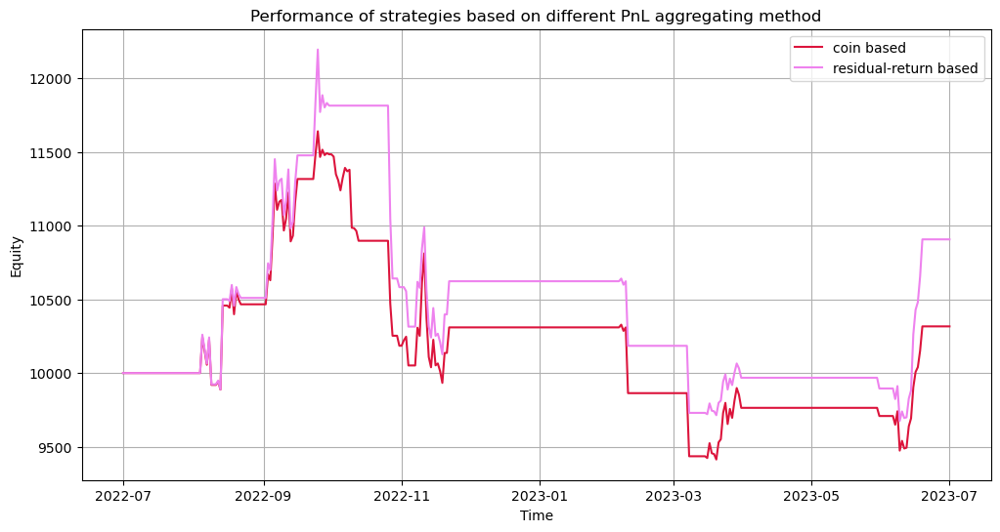

In [10]:
# Initialize naive backtest instance with leverage = 1 and transaction costs = 0) 
backtest_naive = PCAstratBacktest(10000, target_leverage = 1, tc_bps = 0, start_date = "2022-07-01", end_date = "2023-07-01")

# Use parameter set -2.5, -0.5, 2.5, 0.5
coin_aggregate_ec, _ = backtest_naive.backtest_v3(s_bo = -2.5, s_sc = 0.5, s_so = 2.5, s_bc = 0.5, l_target= 1.8)
eig_aggregate_ec, _ = backtest_naive.backtest_v5(s_bo = -2.5, s_sc = 0.5, s_so = 2.5, s_bc = 0.5, l_target = 1)

# Plot equity curves
plt.figure(figsize = (12,6))
plt.plot(coin_aggregate_ec, label = "coin based", color = "crimson")
plt.plot(eig_aggregate_ec, label = "residual-return based", color = "violet")
plt.xlabel("Time")
plt.ylabel("Equity")
plt.title("Performance of strategies based on different PnL aggregating method")
plt.legend()
plt.grid(True)

# Compare performance stats
print("--------------------coin based----------------------")
print(backtest_naive.compute_performance(coin_aggregate_ec))
print("--------------------eig based-----------------------------------------")
print(backtest_naive.compute_performance(eig_aggregate_ec))

##### Remarks
- The fact that the equity curves comove with each other show that both strategies are adopting the same approach. This ensures that althought the methodology of aggregating PnL each day is different, the philosophy behind each methodology is essentially the same.
- In general, the residual-return based approach has higher volatility because once equity is allocated to each stat-arb portfolio $k$, we hold leveraged positions adding up the 1 + sum of betas with regards to coin $k$. Also, total leverage employed by portfolio is less clear since each stat-arb portfolio has differing inherent volatilities.
- If we use vol targeting to match volatility of both equity curves, we see that the effect of period to period volatiality is dampened by using coin based returns

In [35]:
try:
  if not optv3.empty:
    print("opt dfs loaded")
except Exception:
  print("No optv3 df found. Loading Data.")
  opt_dict = {}
  for i in range(3,6):
    with open(f"optv{i}.pkl", "rb") as file:
      opt_dict[i] = pickle.load(file)
  print("Loaded opt dfs")

  optv3 = opt_dict[3]
  optv4 = opt_dict[4]
  optv5 = opt_dict[5]

opt dfs loaded


In [34]:
# opt_mod_v3 = backtest_naive.optimize_s_thresholds(validation_start_date="2022-07-01", validation_end_date="2023-07-01", bt_version="v3", modified = True)
# opt_mod_v3.to_pickle("opt-mod-v3.pkl")

In [33]:
# opt_mod_v2 = backtest_naive.optimize_s_thresholds(validation_start_date="2022-07-01", validation_end_date="2023-07-01", bt_version= "v2", modified = True)
# opt_mod_v2.to_pickle("opt-mod-v2.pkl")

In [32]:
# opt_v4 = backtest_naive.optimize_s_thresholds(validation_start_date="2022-07-01", validation_end_date="2023-07-01", bt_version= "v4", modified = False)
# opt_v4.to_pickle("optv4.pkl")

In [31]:
# opt_mod_v4 = backtest_naive.optimize_s_thresholds(validation_start_date="2022-07-01", validation_end_date="2023-07-01", bt_version= "v4", modified = True)
# opt_mod_v4.to_pickle("opt-mod-v4.pkl")

In [30]:
# opt_v5 = backtest_naive.optimize_s_thresholds(validation_start_date="2022-07-01", validation_end_date="2023-07-01", bt_version= "v5", modified = False)
# opt_v5.to_pickle("optv5.pkl")

## Discussions

### Performance

#### In-sample Performance
First, we conduct a naive backtest that runs the PCA stat-arb strategy starting from 90 days before 

s_thresholds = [-2.0, -1.0, 2.0, 1.0]
{'Cumulative Return': 1.330491037146658, 'CAGR': 33.936487211224055, 'Annualized Volatility': 0.3402459800952215, 'Sharpe Ratio': 99.74103794474387, 'MDD': -0.020575954823955245, 'MDD period': Timedelta('-51 days +00:00:00')}


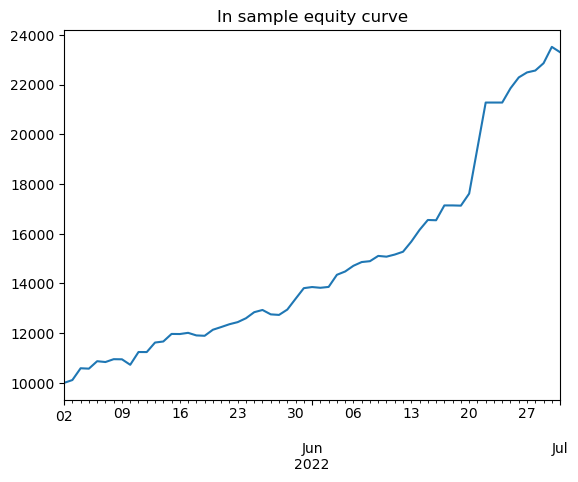

In [58]:
backtest =  PCAstratBacktest(10000, target_leverage = 2, tc_bps = 0, start_date = "2022-07-01", end_date = "2023207-01")
results = backtest.backtest_v1() # In-sample backtest

IS_signal_dict = backtest.signal_dict
IS_mrl = results[-1]
IS_equity_curve = backtest.equity_curve
IS_performance = backtest.compute_performance()

IS_equity_curve.plot(title = "In sample equity curve")
print(f"s_thresholds = {backtest.s_thresholds}")
print(IS_performance)

This is a laughable equity curve. Admittedly, I didn't expect to see literally my first naive backtest performance to be this good. Well, a Sharpe of 27.5 is something even the best of best can't achieve, so there is clearly something wrong here. To give you context, the S&P 500 is known to have a Sharpe around 0.4 ~ 0.6. A realized sharpe higher than one is considered to be very impressive in the industry.

This in-sample performance is clearly inaccurate because it encompasses a lot of forward looking bias. First, the trading universe this backtest relied on was generated on 2022-07-01; in reality, one really can't generate a trading universe for a *future date*. Moreover, the statistical factors we have used are estimated using data *ending on 2022-07-01*. Because by definition factors extracted from PCA are optimized to explain the past variance of (standardized) returns, it would make sense for our residual return series to be more well-behaved. Hence, unless we believe that the eigenportfolios will maintain relevancy throughout the future to a degree similar to the past, the in-sample performance doesn't really prove much except to provide amusement.

Though we can simply ignore above result, let us actually see if trades were opened correctly. This will allow us to decide whether our algorithm is constructed without error.

In [35]:
# Define function

def plot_coin_signal_and_price(
    coin,
    signal_dict,
    aux_df,
    price_df,
    figsize=(10,6)
):
    """
    Plot for one coin:
      - Top subplot: coin's auxiliary series (blue line)
                    plus markers for signal changes
      - Bottom subplot: coin's price series (black line)

    signal_dict : { date -> { coin -> ( -1, 0, or +1 ) } }
    aux_df : DataFrame of shape (dates x coins)
    price_df : DataFrame of shape (dates x coins)
    """
    # 1) Gather all the dates that appear in signal_dict, 
    #    but filter to those that also exist in aux_df.index and price_df.index
    all_dates_sorted = sorted(signal_dict.keys())
    valid_dates = []
    for d in all_dates_sorted:
        if (d in aux_df.index) and (d in pd.to_datetime(price_df.index)):
            valid_dates.append(d)

    if len(valid_dates) < 2:
        print(f"Not enough valid dates to plot for {coin}.")
        return

    # Build arrays for x-axis, signals, and values of aux
    x_dates = valid_dates
    signals = [signal_dict[d].get(coin, 0) for d in x_dates]
    aux_vals = aux_df.loc[x_dates, coin].values
    price_vals = price_df.loc[x_dates, coin].values

    # 2) Create subplots
    fig, (ax_top, ax_bottom) = plt.subplots(2,1, figsize=figsize, sharex=True)
    fig.suptitle(f"{coin}: Aux + Price with Signals")

    # 3) Plot the aux series on the top axis
    ax_top.plot(x_dates, aux_vals, color='blue', label="Aux Series")

    # We'll mark signal changes:
    # We look from i=1 to len(x_dates)-1, see if signals[i] != signals[i-1]
    # Then mark the day x_dates[i] on the aux with the appropriate color
    for i in range(1, len(x_dates)):
        old_sig = signals[i-1]
        new_sig = signals[i]
        date_i  = x_dates[i]
        aux_i   = aux_vals[i]

        if old_sig == 0 and new_sig == 1:
            # Open Long => green
            ax_top.scatter(date_i, aux_i, color='green', marker='^', s=80, 
                           edgecolors='black', linewidths=0.5,
                           label="Open Long" if i==1 else "")
        elif i-1 == 0 and signals[i-1] == 1: # Long very first day
            # Open Long => green
            ax_top.scatter(date_i, aux_i, color='green', marker='^', s=80, 
                           edgecolors='black', linewidths=0.5,
                           label="Open Long" if i==1 else "")            

        elif old_sig == 1 and new_sig == 0:
            # Close Long => light red
            ax_top.scatter(date_i, aux_i, color='lightcoral', marker='v', s=80,
                           edgecolors='black', linewidths=0.5,
                           label="Close Long" if i==1 else "")
        elif old_sig == 0 and new_sig == -1:
            # Open Short => red
            ax_top.scatter(date_i, aux_i, color='red', marker='v', s=80,
                           edgecolors='black', linewidths=0.5,
                           label="Open Short" if i==1 else "")
            
        elif i-1 == 0 and signals[i-1] == -1:
            ax_top.scatter(date_i, aux_i, color='red', marker='v', s=80,
                edgecolors='black', linewidths=0.5,
                label="Open Short" if i==1 else "")

        elif old_sig == -1 and new_sig == 0:
            # Close Short => light green
            ax_top.scatter(date_i, aux_i, color='lightgreen', marker='^', s=80,
                           edgecolors='black', linewidths=0.5,
                           label="Close Short" if i==1 else "")
            

    ax_top.legend(loc="best")
    ax_top.set_ylabel("Aux Value")
    ax_top.grid(True)

    # 4) Plot the coin's price on the bottom axis
    ax_bottom.plot(x_dates, price_vals, color='black', label="Price")
    ax_bottom.legend(loc="best")
    ax_bottom.set_ylabel("Price")
    ax_bottom.grid(True)

    plt.tight_layout()
    plt.show()


In [ ]:
IS_aux_df = results[1]
parent_df = fifr.parent_df

for coin in IS_aux_df.columns:
  
  plot_coin_signal_and_price(
    coin= coin, 
    signal_dict= IS_signal_dict, 
    aux_df= IS_aux_df, 
    price_df= parent_df
  )

##### Remarks
- When looking at how our signals are executed in sample, it seems as if the logic itself is sound. We are generally opening positions when the spread is undervalued or overvalued and closing them appropriately.
- For some coins, the auxiliary series match the price series, but for some the auxiliary series and price series do not match.


Above result motivates us to pursue for a more robust set of performance; this can be achieved through the adoption of walk-forward validation.

We will rely on a walk-forward validation of step size one to closely emulate live trading settings, updating our signal for the next day period-by-period.

We re-estimate betas, auxiliary series, OU parameters, and s-scores each day. We optimize for s-thresholds on the validation set (2022-07-01 ~ 2023-07-01) and leverage parameter using grid-search. To reduce compute time, we impose constraints to greatly reduce the number of combinations for s-thresholds and the leverage parameter.


### OOS Performance

In [97]:
import matplotlib.pyplot as plt
import pandas as pd

def plot_coin_signal_and_price2(
    coin,
    signal_dict,
    top_df,
    labels,
    bottom_df = fifr.parent_df,
    figsize=(10,6)
):
    """
    Plot for one coin:
      - Top subplot: coin's auxiliary series (blue line)
                    plus markers for signal changes
      - Bottom subplot: coin's price series (black line)

    signal_dict : { date -> { coin -> ( -1, 0, or +1 ) } }
    aux_df : DataFrame of shape (dates x coins)
    price_df : DataFrame of shape (dates x coins)
    labels : list of str
        labels to be used for legends of top and bottom graphs. If top series is aux series and bottom is a price series,
        labels = ["aux series", "price series"]
    """
    # 1) Gather all valid dates that appear in signal_dict and also exist in aux_df & price_df
    all_dates_sorted = sorted(signal_dict.keys())
    valid_dates = [d for d in all_dates_sorted if d in top_df.index and d in pd.to_datetime(top_df.index)]

    if len(valid_dates) < 2:
        print(f"Not enough valid dates to plot for {coin}.")
        return

    # Check that all nonzero signals have valid auxiliary values
    for d in valid_dates:
        if signal_dict[d].get(coin, 0) != 0 and pd.isna(top_df.loc[d, coin]):
            raise ValueError(f"Auxiliary series NaN for {coin} on {d} despite nonzero signal.")

    # Build arrays for x-axis, signals, and values of aux
    x_dates = valid_dates
    signals = [signal_dict[d].get(coin, 0) for d in x_dates]
    print(signals)
    top_vals = top_df.loc[x_dates, coin].values
    bottom_vals = bottom_df.loc[x_dates, coin].values

    # 2) Create subplots
    fig, (ax_top, ax_bottom) = plt.subplots(2,1, figsize=figsize, sharex=True)
    fig.suptitle(f"{coin}: Graphs with Signals")

    # 3) Plot the top and bottom series first
    ax_top.plot(x_dates, top_vals, color='blue', label=labels[0])
    ax_bottom.plot(x_dates, bottom_vals, color='black', label=labels[1])

    # Track labels to avoid duplicates in legend
    labels_used = {"Open Long": False, "Close Long": False, "Open Short": False, "Close Short": False}

    # 4) Mark signal changes on aux series
# Helper function to find the last non-NaN auxiliary value before the given index
    def find_last_non_nan(vals, index):
        for i in range(index - 1, -1, -1):
            if not pd.isna(vals[i]):
                return vals[i]
        return 0  # Default to 0 if no non-NaN value found

    # Loop through signals
    for i in range(1, len(x_dates)):
        old_sig = signals[i-1]
        new_sig = signals[i]
        date_i  = x_dates[i]
        top_i   = top_vals[i]
        bottom_i = bottom_vals[i]

        # If aux_i is NaN, find the last non-NaN value
        if pd.isna(top_i):
            top_i = find_last_non_nan(top_vals, i)
        if pd.isna(bottom_i):
            bottom_i = find_last_non_nan(bottom_vals, i)

        # Plot top graph
        if (old_sig == 0 and new_sig == 1) or (i == 1 and old_sig == 1): # Signal on first day
            ax_top.scatter(date_i, top_i, color='green', marker='^', s=80, 
                        edgecolors='black', linewidths=0.5,
                        label="Open Long" if not labels_used["Open Long"] else "")
            labels_used["Open Long"] = True

        elif old_sig == 1 and new_sig == 0:
            ax_top.scatter(date_i, top_i, color='lightcoral', marker='v', s=80,
                        edgecolors='black', linewidths=0.5,
                        label="Close Long" if not labels_used["Close Long"] else "")
            labels_used["Close Long"] = True

        elif (old_sig == 0 and new_sig == -1) or (i == 1 and old_sig == -1): # Signal on first day
            ax_top.scatter(date_i, top_i, color='red', marker='v', s=80,
                        edgecolors='black', linewidths=0.5,
                        label="Open Short" if not labels_used["Open Short"] else "")
            labels_used["Open Short"] = True

        elif old_sig == -1 and new_sig == 0:
            ax_top.scatter(date_i, top_i, color='lightgreen', marker='^', s=80,
                        edgecolors='black', linewidths=0.5,
                        label="Close Short" if not labels_used["Close Short"] else "")
            labels_used["Close Short"] = True
        
        # Mark on bottom graph
        if (old_sig == 0 and new_sig == 1) or (i == 1 and old_sig == 1): # Signal on first day
            ax_bottom.scatter(date_i, bottom_i, color='green', marker='^', s=80, 
                        edgecolors='black', linewidths=0.5,
                        label="Open Long" if not labels_used["Open Long"] else "")
            labels_used["Open Long"] = True

        elif old_sig == 1 and new_sig == 0:
            ax_bottom.scatter(date_i, bottom_i, color='lightcoral', marker='v', s=80,
                        edgecolors='black', linewidths=0.5,
                        label="Close Long" if not labels_used["Close Long"] else "")
            labels_used["Close Long"] = True

        elif (old_sig == 0 and new_sig == -1) or (i == 1 and old_sig == -1): # Signal on first day
            ax_bottom.scatter(date_i, bottom_i, color='red', marker='v', s=80,
                        edgecolors='black', linewidths=0.5,
                        label="Open Short" if not labels_used["Open Short"] else "")
            labels_used["Open Short"] = True

        elif old_sig == -1 and new_sig == 0:
            ax_bottom.scatter(date_i, bottom_i, color='lightgreen', marker='^', s=80,
                        edgecolors='black', linewidths=0.5,
                        label="Close Short" if not labels_used["Close Short"] else "")
            labels_used["Close Short"] = True


    ax_top.legend(loc='center left', bbox_to_anchor=(1, 0.5), fontsize=10)
    ax_top.set_ylabel("Series")
    ax_top.grid(True)

    # 4) Plot the coin's price on the bottom axis
    ax_bottom.legend(loc='center left', bbox_to_anchor=(1, 0.5), fontsize=10)
    ax_bottom.set_ylabel("Series")
    ax_bottom.grid(True)

    plt.tight_layout()
    plt.show()


In [95]:
backtest_inst =  PCAstratBacktest(10000, target_leverage = 1, tc_bps = 0, start_date = "2022-07-01", end_date = "2023-07-01")
resultsv4 = backtest_inst.backtest_v4(s_bo = -2.5, s_sc = -0.5, s_so = 2.5, s_bc = 0.5, modified = True)
resultsv3 = backtest_inst.backtest_v3(s_bo = -2.5, s_sc = -0.5, s_so = 2.5, s_bc = 0.5, modified = True)

Processing dates: 100%|██████████| 366/366 [00:22<00:00, 16.33it/s]


Text(0.5, 1.0, 'Validation Period Performance of v3 and v4')

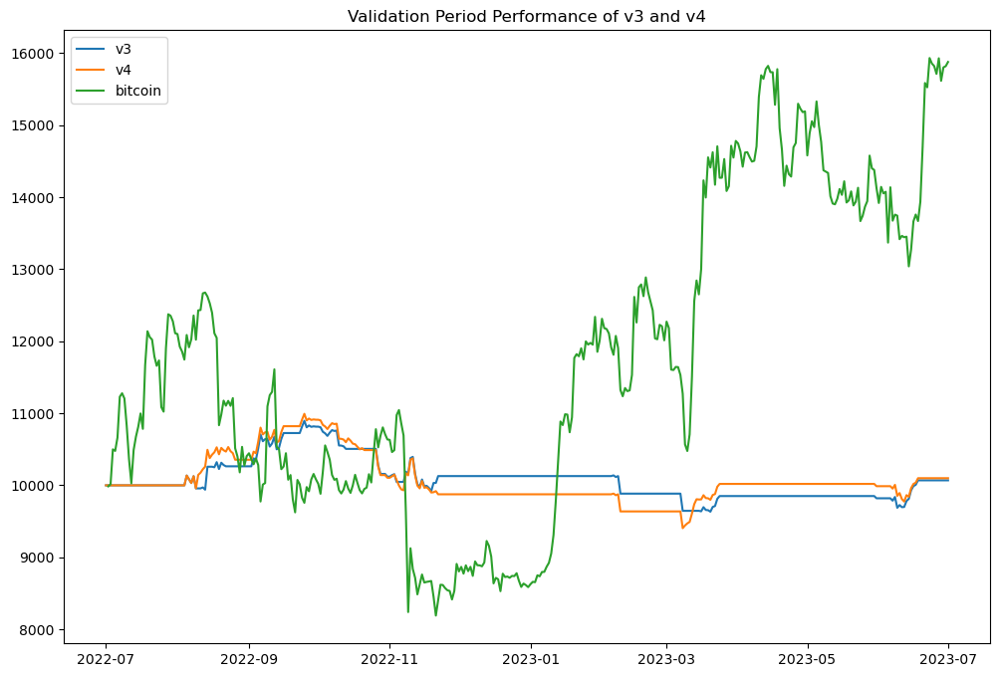

In [96]:
initial_equity = 10000
plt.figure(figsize = (12,8))
plt.plot(resultsv3[0], label = "v3")
plt.plot(resultsv4[0], label = "v4")
plt.plot(initial_equity * np.cumprod(1+fifr.parent_df.loc["2022-07-01": "2023-07-01"]["bitcoin"].pct_change().dropna()), label = "bitcoin")
plt.legend()
plt.title("Validation Period Performance of v3 and v4")

In [194]:
main_df = results[1][list(results[1].keys())[0]]
for _, df in list(results[1].items())[1:]:
  last_row =  df.iloc[[-1]] # .iloc[[]] returns a df, which is needed for concatenation
  main_df = pd.concat([main_df, last_row], ignore_index= True) # Sets new index

dates = pd.date_range("2022-05-02", "2023-07-01")


main_df.index = dates
main_df

,algorand,avalanche,bitcoin,bitcoin-cash,bnb,cardano,chainlink,cosmos,cronos,dogecoin,...,uniswap,unus-sed-leo,xrp,ethereum-classic,flow,toncoin,okb,filecoin,hedera,lido-dao
2022-05-02,0.039996,0.025021,0.007190,0.012056,0.014374,-0.004152,-0.025048,0.005609,-0.099651,0.011337,...,-0.013536,0.000528,0.017537,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-05-03,0.126320,0.024237,-0.008969,-0.001989,-0.000100,-0.001553,-0.001829,-0.017179,-0.046636,-0.006569,...,-0.026121,0.006415,0.013328,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-05-04,0.101083,0.064695,-0.012460,-0.003325,-0.025573,0.072855,0.021512,0.013920,-0.066960,-0.058348,...,0.026179,0.001906,0.005984,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-05-05,0.067117,0.043519,-0.006018,0.011823,-0.003748,0.058446,0.023509,-0.005054,-0.057369,-0.035887,...,0.050121,-0.004224,0.011525,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2022-05-06,0.173000,0.056005,-0.037557,-0.009275,-0.011243,0.058019,0.044467,-0.002912,-0.090728,-0.055671,...,0.075108,0.009314,0.012172,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-06-27,NaN,-0.056069,0.034371,NaN,-0.169764,-0.240278,0.089779,-0.035158,NaN,0.000217,...,0.314904,0.034647,-0.027971,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-06-28,NaN,-0.053158,0.040727,NaN,-0.157451,-0.238640,0.096434,-0.046082,NaN,-0.004896,...,0.310074,0.035615,-0.031792,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-06-29,NaN,-0.035017,0.050598,NaN,-0.139339,-0.227120,0.078639,-0.092660,NaN,-0.000962,...,0.278572,0.039119,-0.015861,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-06-30,NaN,-0.114816,-0.010372,NaN,-0.212284,-0.206532,0.093490,-0.107954,NaN,-0.021970,...,0.269636,0.071990,-0.054274,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [41]:
# Convert sscoredict to sscoredf
# Convert sscores dict to df
dynamic_sscore_df = pd.concat(backtest_inst.dynamic_sscore_dict, axis = 1).T

NameError: name 'backtest_inst' is not defined

##### Remarks
- Very different from in-sample period performance. Performance was quite bad for the entire period. We also see how the exclusion of mean reversion list acts as a "Stop loss". 

### Performance comparison of v3 and buy-and-hold strats

This section we will further investigate the performance of the following two strategies.
1. Reestimate beta and OU parameter estimates every seven days, while extracting new PCA factors from an updated trading universe every month. This corresponds to backtest v4.
2. Reestimate beta and OU parameter estiamtes every day, while conducting dynamic rebalancing every month. This method corresponds to backtest v3.
3. Compute performance via aggregating the residual returns every day.

#### Version 3

In [72]:
print("mean")
print(optv3.mean())

print("-----------------------------------------------------")
print("median")
print(optv3.median())
print("-----------------------------------------------------")
print("max")
print(optv3.max())

mean
s_bo                                     -2.028986
s_sc                                           0.0
s_so                                      2.028986
s_bc                                           0.0
Cumulative Return                        -0.168275
CAGR                                     -0.122698
Sharpe Ratio                             -0.533438
Max Drawdown                             -0.305641
Max Drawdown Period    223 days 20:06:15.652173912
Final Equity                           8317.247932
Leverage                                       2.0
n_trades                                298.724638
dtype: object
-----------------------------------------------------
median
s_bo                           -1.730769
s_sc                                 0.0
s_so                            1.730769
s_bc                                 0.0
Cumulative Return              -0.162111
CAGR                           -0.114952
Sharpe Ratio                   -0.579652
Max Drawdown         

In [79]:
# Version 3 with leverage 1

parameter_set = optv3.iloc[0, 0:4]
s_bo = parameter_set["s_bo"]
s_sc = parameter_set["s_sc"]
s_so = parameter_set["s_so"]
s_bc = parameter_set["s_bc"]

initial_equity = 10000

backtest_opt = PCAstratBacktest(initial_equity= initial_equity, target_leverage=1, start_date="2022-07-01", end_date = "2023-07-01", tc_bps = 0)
v3_equity_curve_opt, _ = backtest_opt.backtest_v3(s_bo = s_bo, s_sc = s_sc, s_so = s_so, s_bc = s_bc, l_target=1)

Processing dates: 100%|██████████| 366/366 [00:22<00:00, 16.57it/s]


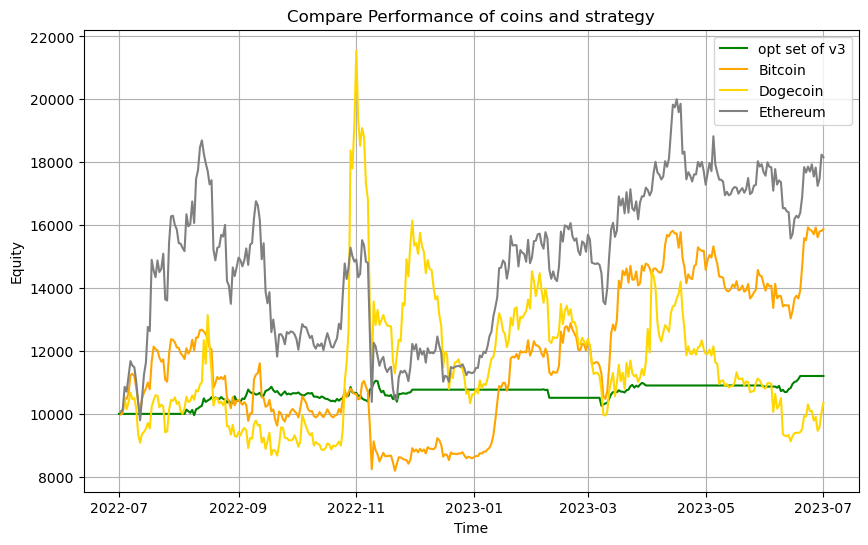

In [82]:
# Plot equity curves
plt.figure(figsize= (10,6))
plt.plot(v3_equity_curve_opt, label = "opt set of v3", linewidth = 1.5, color = "green")
plt.plot(initial_equity * np.cumprod(1+fifr.parent_df.loc["2022-07-01": "2023-07-01"]["bitcoin"].pct_change().dropna()), label = "Bitcoin", color = "orange")
plt.plot(initial_equity * np.cumprod(1+fifr.parent_df.loc["2022-07-01": "2023-07-01"]["dogecoin"].pct_change().dropna()), label = "Dogecoin", color = "gold")
plt.plot(initial_equity * np.cumprod(1+fifr.parent_df.loc["2022-07-01": "2023-07-01"]["ethereum"].pct_change().dropna()), label = "Ethereum", color = "grey")
plt.title("Compare Performance of coins and strategy")
plt.legend()
plt.xlabel("Time")
plt.ylabel("Equity")
plt.grid(True)

In [85]:

# Compare performance
print("--------------Bitcoin-----------------")
print(backtest_opt.compute_performance(fifr.parent_df.loc["2022-07-01": "2023-07-01"]["bitcoin"]))
print("--------------Ethereum----------------")
print(backtest_opt.compute_performance(fifr.parent_df.loc["2022-07-01": "2023-07-01"]["ethereum"]))
print("--------------Dogecoin----------------")
print(backtest_opt.compute_performance(fifr.parent_df.loc["2022-07-01": "2023-07-01"]["dogecoin"]))
print("--------------V3---------------------")
print(backtest_opt.compute_performance(v3_equity_curve_opt))

--------------Bitcoin-----------------
{'Cumulative Return': 0.5874978960189989, 'CAGR': 0.3758610119508028, 'Annualized Volatility': 0.4345645537883012, 'Sharpe Ratio': 0.8649141046462433, 'MDD': -0.35361774280750485, 'MDD period': Timedelta('-214 days +00:00:00')}
--------------Ethereum----------------
{'Cumulative Return': 0.8160267828076035, 'CAGR': 0.5097354074043929, 'Annualized Volatility': 0.586216594637347, 'Sharpe Ratio': 0.8695342507656785, 'MDD': -0.4447335290317028, 'MDD period': Timedelta('-158 days +00:00:00')}
--------------Dogecoin----------------
{'Cumulative Return': 0.034810834116177025, 'CAGR': 0.02390620400948862, 'Annualized Volatility': 0.7756082431961111, 'Sharpe Ratio': 0.03082252441126258, 'MDD': -0.576450491389029, 'MDD period': Timedelta('225 days 00:00:00')}
--------------V3---------------------
{'Cumulative Return': 0.1204321068245684, 'CAGR': 0.08167382803384138, 'Annualized Volatility': 0.0930870453150712, 'Sharpe Ratio': 0.8773919910917833, 'MDD': -0.0

#### Voltargeting
Since the strategy has much lower volatility compared to naive buy-and-hold strategies, we can try to use leverage to achieve similar level of volatility.

Processing dates: 100%|██████████| 366/366 [00:22<00:00, 16.60it/s]


--------------Bitcoin-----------------
{'Cumulative Return': 0.5874978960189989, 'CAGR': 0.3758610119508028, 'Annualized Volatility': 0.4345645537883012, 'Sharpe Ratio': 0.8649141046462433, 'MDD': -0.35361774280750485, 'MDD period': Timedelta('-214 days +00:00:00')}
--------------Ethereum----------------
{'Cumulative Return': 0.8160267828076035, 'CAGR': 0.5097354074043929, 'Annualized Volatility': 0.586216594637347, 'Sharpe Ratio': 0.8695342507656785, 'MDD': -0.4447335290317028, 'MDD period': Timedelta('-158 days +00:00:00')}
--------------Dogecoin----------------
{'Cumulative Return': 0.034810834116177025, 'CAGR': 0.02390620400948862, 'Annualized Volatility': 0.7756082431961111, 'Sharpe Ratio': 0.03082252441126258, 'MDD': -0.576450491389029, 'MDD period': Timedelta('225 days 00:00:00')}
--------------V3---------------------
{'Cumulative Return': 0.642924886465053, 'CAGR': 0.4088502347446612, 'Annualized Volatility': 0.5585222718904268, 'Sharpe Ratio': 0.7320213630171424, 'MDD': -0.394

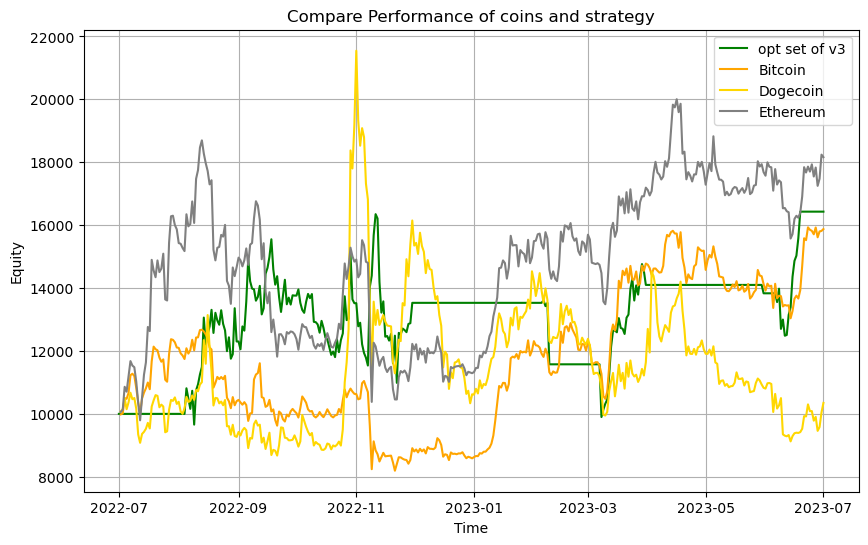

In [87]:
# Leverage six
v3_equity_curve_opt_lev, _ = backtest_opt.backtest_v3(s_bo = s_bo, s_sc = s_sc, s_so = s_so, s_bc = s_bc, l_target=6)

# Plot equity curves
plt.figure(figsize= (10,6))
plt.plot(v3_equity_curve_opt_lev, label = "opt set of v3", linewidth = 1.5, color = "green")
plt.plot(initial_equity * np.cumprod(1+fifr.parent_df.loc["2022-07-01": "2023-07-01"]["bitcoin"].pct_change().dropna()), label = "Bitcoin", color = "orange")
plt.plot(initial_equity * np.cumprod(1+fifr.parent_df.loc["2022-07-01": "2023-07-01"]["dogecoin"].pct_change().dropna()), label = "Dogecoin", color = "gold")
plt.plot(initial_equity * np.cumprod(1+fifr.parent_df.loc["2022-07-01": "2023-07-01"]["ethereum"].pct_change().dropna()), label = "Ethereum", color = "grey")
plt.title("Compare Performance of coins and strategy")
plt.legend()
plt.xlabel("Time")
plt.ylabel("Equity")
plt.grid(True)

# Compare performance
print("--------------Bitcoin-----------------")
print(backtest_opt.compute_performance(fifr.parent_df.loc["2022-07-01": "2023-07-01"]["bitcoin"]))
print("--------------Ethereum----------------")
print(backtest_opt.compute_performance(fifr.parent_df.loc["2022-07-01": "2023-07-01"]["ethereum"]))
print("--------------Dogecoin----------------")
print(backtest_opt.compute_performance(fifr.parent_df.loc["2022-07-01": "2023-07-01"]["dogecoin"]))
print("--------------V3---------------------")
print(backtest_opt.compute_performance(v3_equity_curve_opt_lev))

In [94]:
# Correlation of strategy and buy and hold bitcoin
v3_ret = v3_equity_curve_opt_lev.pct_change().dropna()
print(f"correlation between stat-arb strat and bitcoin buy-and-hold : {v3_ret.corr(fifr.parent_df.pct_change().dropna().loc['2022-07-01': '2023-07-01']['bitcoin'])}")

correlation between stat-arb strat and bitcoin buy-and-hold : 0.09704613602167637


##### Remarks
- With a leverage of six, our optimized stat-arb stat yields returns comparable to other buy-hold strategies, while the correlation is lower than 0.1.

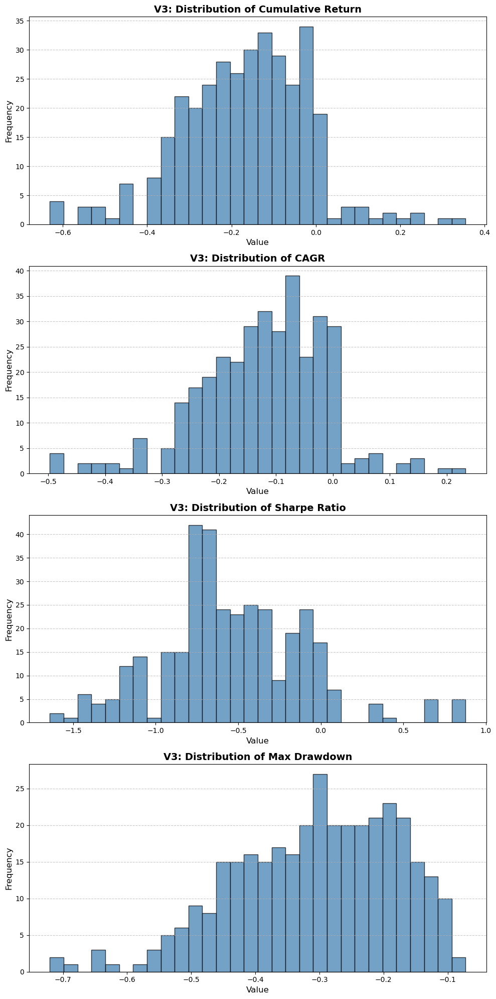

In [96]:
feature_cols = ["Cumulative Return", "CAGR", "Sharpe Ratio", "Max Drawdown"]
num_cols = len(feature_cols)
fig, axes = plt.subplots(nrows=num_cols, ncols=1, figsize=(10, 5 * num_cols))

if num_cols == 1:
    axes = [axes]  # Ensure axes is iterable if only one column exists

for ax, col in zip(axes, feature_cols):
    ax.hist(optv3[col].dropna(), bins=30, edgecolor='black', alpha=0.75, color='steelblue')
    ax.set_title(f"V3: Distribution of {col}", fontsize=14, fontweight='bold')
    ax.set_xlabel("Value", fontsize=12)
    ax.set_ylabel("Frequency", fontsize=12)
    ax.grid(axis='y', linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()

Let's compare this with performance of some of the mainstream coins.

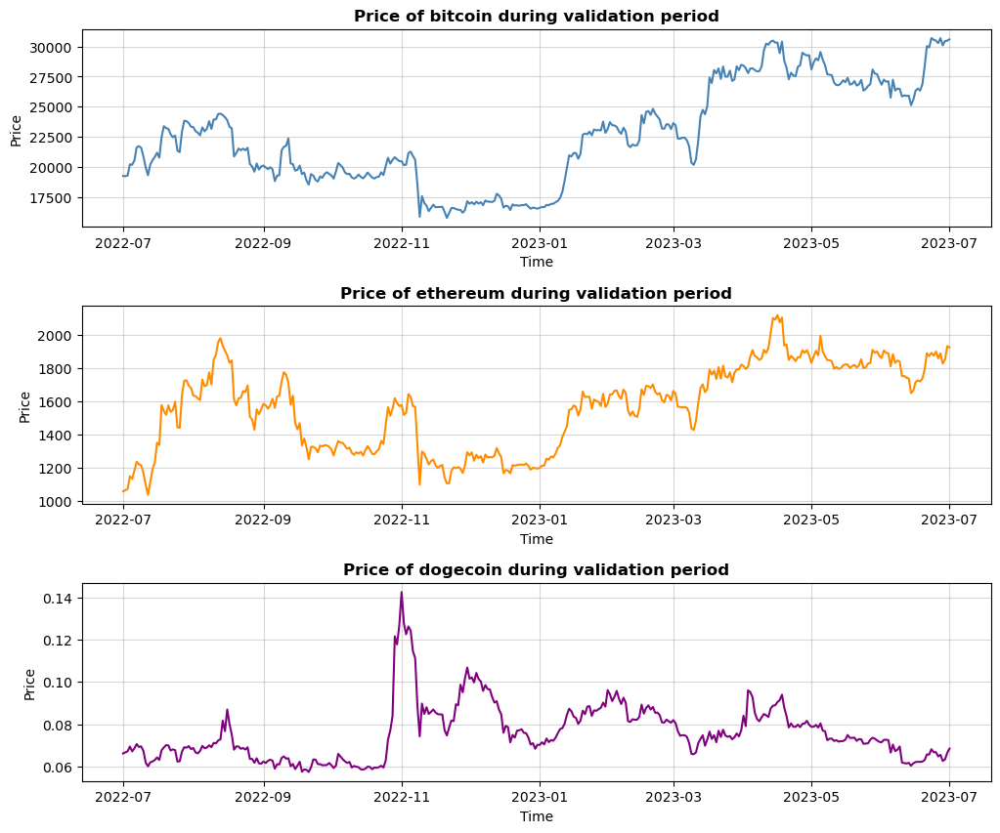

In [53]:
import random
# Define colors dynamically
colors = ["steelblue", "darkorange", "seagreen", "crimson", "purple"]
random.shuffle(colors)  # Shuffle so that different runs get different colors

comparison_coins = ["bitcoin", "ethereum", "dogecoin"]

fig, axes = plt.subplots(nrows = len(comparison_coins), ncols = 1, figsize = (12,10))

for ax, coin, color in zip(axes, comparison_coins, colors):
  ax.plot(fifr.parent_df.loc["2022-07-01" : "2023-07-01"][coin], label = f"{coin}", color = color, linewidth = 1.5)
  ax.set_title(f"Price of {coin} during validation period", fontweight = "bold")
  ax.set_xlabel("Time")
  ax.set_ylabel("Price")
  ax.grid(True, linestyle = "-", alpha = 0.5)


plt.subplots_adjust(hspace=0.4)
  
  

##### Remarks
- We see that over the validation period, both variations of the strategy underperformed compared to simple buy and hold if we look at the distribution properties. With average leverage of 2, we realized -11% ~ -12% return over the year.
- The most optimal strategy produced annual growth rate of 8% at an annualized volatility of 9%. The Sharpe of the strategy was around 0.87, which was similar to the sharpe you could have gained buy buying and holding bitcion throughout the year.
- One feature is that over the validation period, the most optimal strategy returns had low correlation to bitcoin returns, which means investors could benefit from diversification by including this strategy in their portfolio. Of course this statement relies on the presumption that the strategy performance with the most optimal parameetr set is not overfit. 


#### Sensitivity Test
Even if we have optmized our parameter set on the validation data, we do not know for sure if this optimal set is optimal in the general sense, or it is just a result of overfitting.

A simple and intuitive way to verify whether the parameter set is overfit or not is to verify the local area near our optimal set.

Understanding a set of s-thresholds as a 4D vector, we can define the sensitivity function:
$$
\Bigg|\frac{\Delta PnL}{\Delta s*} \Bigg| = \frac{|PnL(s) - PnL(s^*)|}{\begin{Vmatrix}{s - s^*}\end{Vmatrix}_p}
$$
where $s,s^* \in \mathbb{R}^4$ and we use some $l_p$ norm to define the change in vectors. We will use the $l_2$ norm, or the Euclidean norm.




In [47]:
def sensitivity_test(optimal_s_thresholds, start_date, end_date, perturb=0.3, granularity = 10, version = "v3"):
  """
  Two step process:
    1. Compute pnl over granular range of "optimal" parameter vector
    2. Use sensitivity function compute cumulative pnl Sensitivity with respect to change in parameters

  Parameters
  ----------
  optimal_s_thresholds : list
    contains four values -- s_bo , s_sc, s_so, s_bc

  perturn : int
    Amount you wish to perturb your vector by

  start_date, end_date = str
    Sensitivity test period

  granuliarty : number of values to generate around each threshold

  backtest_inst : PCAStratBacktest Instance, mainly to use backtest feature
  """
  import numpy as np
  import itertools
  import pickle

  backtest_inst = PCAstratBacktest(10000, target_leverage = 1, tc_bps = 0, start_date = start_date, end_date = end_date)
  st = optimal_s_thresholds # s threshold
  optimal_equity_curve, _ = backtest_inst.backtest_v3(st[0], st[1],st[2],st[3], l_target = 1)
  optimal_cumpnl = (optimal_equity_curve.iloc[-1] - optimal_equity_curve.iloc[0]) / optimal_equity_curve.iloc[0]

  s_bo_range = list(np.linspace(st[0]- perturb, st[0] + perturb, num =  granularity))
  s_sc_range = list(np.linspace(st[1] - perturb, st[1] + perturb, num = granularity))
  s_so_range = list(np.linspace(st[2] - perturb, st[2] + perturb, num = granularity))
  s_bc_range = list(np.linspace(st[3] - perturb, st[3] + perturb, num = granularity))

  grid_comb = itertools.product(s_bo_range, s_sc_range, s_so_range, s_bc_range)

  valid_comb = [
    (s_bo, s_sc, s_so, s_bc) for (s_bo, s_sc, s_so, s_bc) in grid_comb
    if s_bo < s_sc and s_so > s_bc and s_bo < s_bc and s_so > s_sc and s_bo <-1 and s_so > 1
            and np.abs(s_bo) == np.abs(s_so) and np.abs(s_bc) == np.abs(s_sc) 
  ]
  
  print(len(valid_comb)) #print debug
  print(valid_comb)

  sensitivity_dict = {"s_bo": [], "s_sc": [],"s_so": [],"s_bc": [], "DeltaPnL":[], "l2norm":[], "sensitivity":[]}

  for thresholds in tqdm(valid_comb, desc = "test in progress"):
    s_bo, s_sc, s_so, s_bc = thresholds

    if version == "v3":
      equity_curve, _ = backtest_inst.backtest_v3(s_bo, s_sc, s_so, s_bc, l_target = 1) # set leverage to one for consistent comparison
    elif version == "v4":
      equity_curve, _ = backtest_inst.backtest_v4(s_bo, s_sc, s_so, s_bc, l_target = 1) # set leverage to one for consistent comparison  
    elif version == "v5":
      equity_curve, _ = backtest_inst.backtest_v5(s_bo, s_sc, s_so, s_bc, l_target = 1) # set leverage to one for consistent comparison
    
    cumpnl = (equity_curve.iloc[-1] - equity_curve.iloc[0]) / equity_curve.iloc[0]
    # Delta pnl = (PnL(S) - PnL(S*)) / L2norm(S-S*)
    numerator = np.abs(cumpnl - optimal_cumpnl)
    denominator = sum((np.array(st) - np.array([s_bo, s_sc, s_so, s_bc]))**2)**(1/2) # Euclidean norm
    sensitivity = numerator / denominator

    # Append to results to dict
    sensitivity_dict["s_bo"].append(s_bo)
    sensitivity_dict["s_sc"].append(s_sc)
    sensitivity_dict["s_so"].append(s_so)
    sensitivity_dict["s_bc"].append(s_bc)
    sensitivity_dict["DeltaPnL"].append(numerator)
    sensitivity_dict["l2norm"].append(denominator)
    sensitivity_dict["sensitivity"].append(sensitivity)
  
  sensitivity_df = pd.DataFrame(sensitivity_dict)

  return sensitivity_df

# Insert optimal threshold
if os.path.exists("sensitivity_v3.csv"):
  print("Sensitivity csv files already exist. Loading Data.")
  sensitivity_v3 = pd.read_csv("sensitivity_v3.csv")
  sensitivity_v4 = pd.read_csv("sensitivity_v4.csv")
  sensitivity_v5 = pd.read_csv("sensitivity_v5.csv")                            
else:
  print("Conducting sensitivity analysis and saving csv files")
  sensitivity_v3 = sensitivity_test(list(optv3.iloc[0, 0:4]), start_date = "2022-07-01", end_date = "2023-07-01", version = "v3")

  # Save csv
  sensitivity_v3.to_csv("sensitivity_v3.csv", index = False)

  # sensitivity_v3 = pd.read_csv("sensitivity_v3.csv")

  # Insert optimal threshold
  sensitivity_v5 = sensitivity_test(list(optv5.iloc[0, 0:4]), start_date = "2022-07-01", end_date = "2023-07-01", version = "v5")

  # Save csv
  sensitivity_v5.to_csv("sensitivity_v5.csv", index = False)

  # Insert optimal threshold
  sensitivity_v4 = sensitivity_test(list(optv4.iloc[0, 0:4]), start_date = "2022-07-01", end_date = "2023-07-01", version = "v4")

  # Save csv
  sensitivity_v4.to_csv("sensitivity_v4.csv", index = False)

sensitivity_v3.head()


Sensitivity csv files already exist. Loading Data.


,s_bo,s_sc,s_so,s_bc,DeltaPnL,l2norm,sensitivity
0,-2.8,0.276923,2.8,0.276923,0.233850,0.600000,0.389750
1,-2.8,0.343590,2.8,0.343590,0.214975,0.537484,0.399965
2,-2.8,0.410256,2.8,0.410256,0.096459,0.485341,0.198746
3,-2.8,0.476923,2.8,0.476923,0.016864,0.447214,0.037709
4,-2.8,0.543590,2.8,0.543590,0.018993,0.426875,0.044492


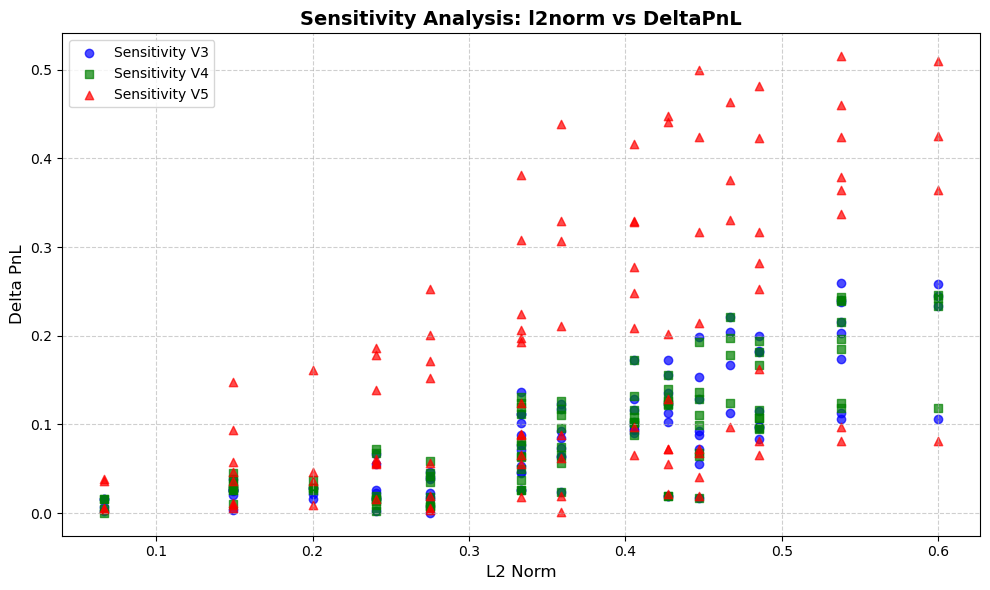

In [138]:
import matplotlib.pyplot as plt

# Assuming you have three DataFrames: sensitivityv3, sensitivityv4, sensitivityv5

# Plotting the scatter plots
plt.figure(figsize=(10, 6))

# Scatter plot for sensitivityv3
plt.scatter(sensitivity_v3['l2norm'], sensitivity_v3['DeltaPnL'], 
            color='blue', alpha=0.7, label='Sensitivity V3', marker='o')

# Scatter plot for sensitivityv4
plt.scatter(sensitivity_v4['l2norm'], sensitivity_v4['DeltaPnL'], 
            color='green', alpha=0.7, label='Sensitivity V4', marker='s')

# Scatter plot for sensitivityv5
plt.scatter(sensitivity_v5['l2norm'], sensitivity_v5['DeltaPnL'], 
            color='red', alpha=0.7, label='Sensitivity V5', marker='^')

# Adding titles and labels
plt.title('Sensitivity Analysis: l2norm vs DeltaPnL', fontsize=14, fontweight='bold')
plt.xlabel('Delta L2 Norm', fontsize=12)
plt.ylabel('Delta PnL', fontsize=12)

# Adding grid and legend
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend()

# Display the plot
plt.tight_layout()
plt.show()



##### Remarks
- We verify through simulation of sample parameter vectors "near" our optimial parameter set $s^*$ that a change in PnL is proportional to the change in distance between samples parameter sets and optimal parameter set $s^*$. Moreover, above analysis shows that the change in PnL from change in parameter set is *smooth*; thus, this gives more confidence that the PnL as a function of our optimal parameter set is not just a single spike but may indeed form some local extremum that has nice local properties. 
- The Sensitivity analysis of backtest version five reveals that the change in PnL in response to change in norm is *more volatile* compared to other backtest versions. In other words, the optimized parameter set for this version of backtest may not be a local maximum with well defined local behaviour. To corroborate this statement, we see that the optimized parameter set for v5 is different from that of v4 and v5 and that the number of trades, or the number of days we change our position, is 40, a much smaller number than the usual 200 ~ 300 we see for other parameters. A smaller number of trades executed translates to less statistical power of the conclusion, so this may indicate that using the optimal paramter set for v5 will not guarantee good results OOS.

### Final Test: Using Test set to evaluate trading performance
Until now, we've looked at the in-sample performance of our statistical arbitrage strategy, showed the discrepancy of in-sample performance and out of sample performance by using our validaiton data set, and tried to look for a local optimum of parameter set $s$ by using a constrained grid search.

We've seen that $s^* = [-2.5, 0.5, 2.5, 0.5]$ was our optimal parameter set on validation data. What is left is to test the performance of this parameter set on our test data set, which should be considered as our "real" live trading data set. However, theoretically, it should make sense that our $s_sc$ value being negative should not provide material negative impact to our overall performance. Since these s-scores represent distance of our signal from the equilibrium mean in terms of standard deviation, closing at $s_sc = -0.5$ should be profitable, assuming the strategy is a valid mean reversion strategy. 

Hence, we choose our final paramter set to be $s = [-2.5, -0.5, 2.5, 0.5]$. Our starting date will be `2023-07-01` and end date will be `2024-08-05`, the final date of our data collection period. Recalling the fact that best performing parameter set had volatility of around 1/5 ~ 1/4 of the simple buy and hold-strategy, we choose a leverage of 3 to target volatility of somewhat lower value than what we would see in just buy-and-hold bitcoin and ethereum during the same period.

Processing dates: 100%|██████████| 402/402 [00:18<00:00, 22.24it/s]


<Axes: >

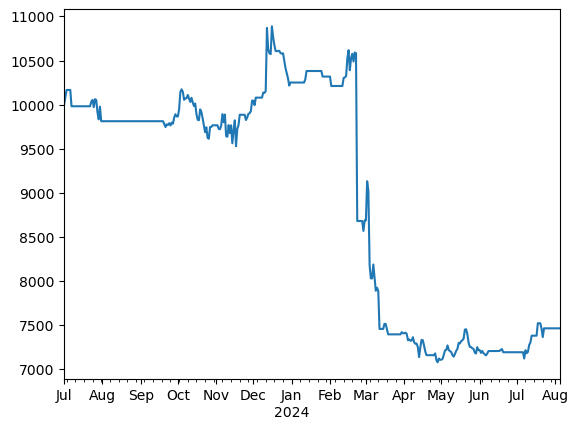

In [53]:
# Use 0 transaction cost first
backtest_final_0bps = PCAstratBacktest(initial_equity=10000, target_leverage=1, start_date="2023-07-01", end_date="2024-08-05", s_thresholds=[-2.5, -0.5, 2.5, 0.5], tc_bps=0, data_dir=fifr.data_dir)
results_final_0bps = backtest_final_0bps.backtest_v3(l_target=1)

results_final_0bps[0].plot()

In [54]:
start_date = (pd.to_datetime("2023-07-01") - timedelta(days = 60)).strftime("%Y-%m-%d")

aggregate_aux_df = results_final_0bps[1][list(results_final_0bps[1].keys())[0]]
for _, df in list(results_final_0bps[1].items())[1:]:
  last_row =  df.iloc[[-1]] # .iloc[[]] returns a df, which is needed for concatenation
  aggregate_aux_df = pd.concat([aggregate_aux_df, last_row], ignore_index= True) # Sets new index

dates = pd.date_range(start_date, "2024-08-05")


aggregate_aux_df.index = dates
aggregate_aux_df

,avalanche,bitcoin,bitcoin-cash,bnb,cardano,dogecoin,ethereum,litecoin,polkadot-new,polygon,...,monero,near-protocol,okb,stellar,uniswap,ethereum-classic,injective,immutable-x,stacks,filecoin
2023-05-02,-0.000216,0.012865,-0.009053,-0.028140,0.000026,-0.008756,0.014529,0.011385,-0.001548,0.003764,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-05-03,0.010472,0.014470,-0.025857,-0.019797,-0.013041,-0.003667,0.024126,0.016091,0.000323,0.020277,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-05-04,0.005101,0.021861,-0.004542,-0.023484,-0.007686,-0.007761,0.017117,-0.000067,-0.005764,0.010206,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-05-05,-0.000316,0.025776,0.002834,-0.037444,-0.025097,-0.003010,0.057340,-0.019358,0.001594,-0.013153,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-05-06,-0.003165,0.026724,0.025482,-0.027759,-0.028376,-0.007722,0.037936,-0.024523,-0.004840,0.003009,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-08-01,-0.155620,0.096109,NaN,0.003186,-0.083702,0.034315,-0.079208,NaN,-0.198236,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-08-02,-0.153796,0.063593,NaN,0.014576,-0.068089,0.052332,-0.100001,NaN,-0.141359,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-08-03,-0.123596,0.059016,NaN,-0.000002,-0.085465,0.053928,-0.094657,NaN,-0.125895,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-08-04,-0.089979,0.051022,NaN,-0.042196,-0.085672,0.069261,-0.101383,NaN,-0.133506,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

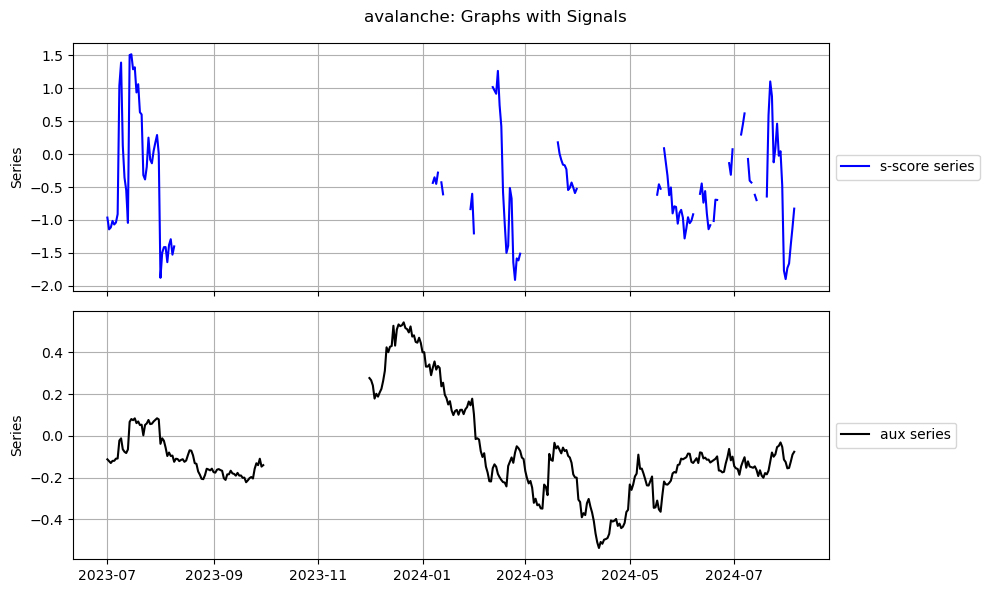

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

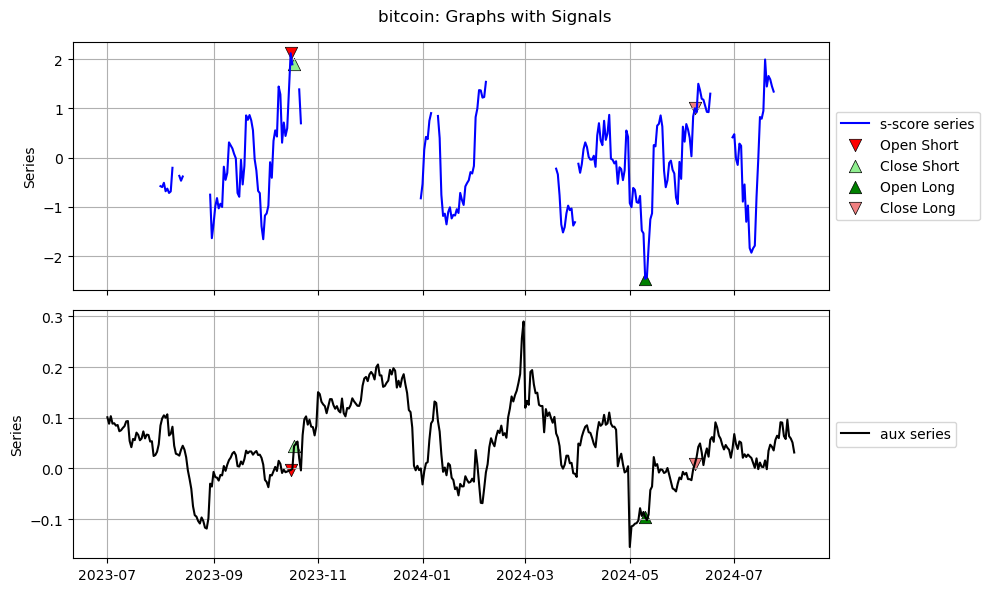

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, -1, -1, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

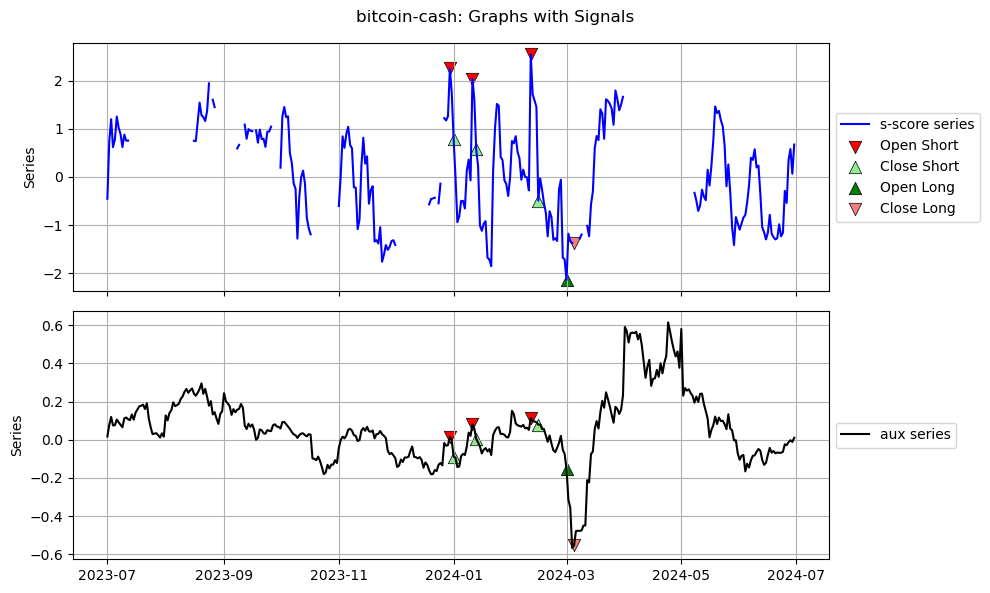

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

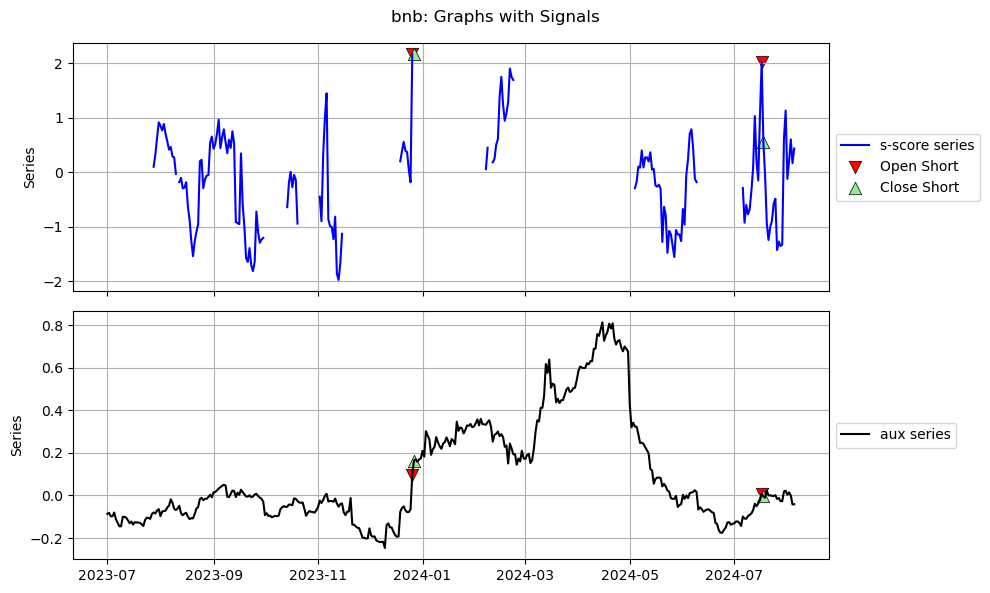

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, -1, -1, -1, -1, -1, -1, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

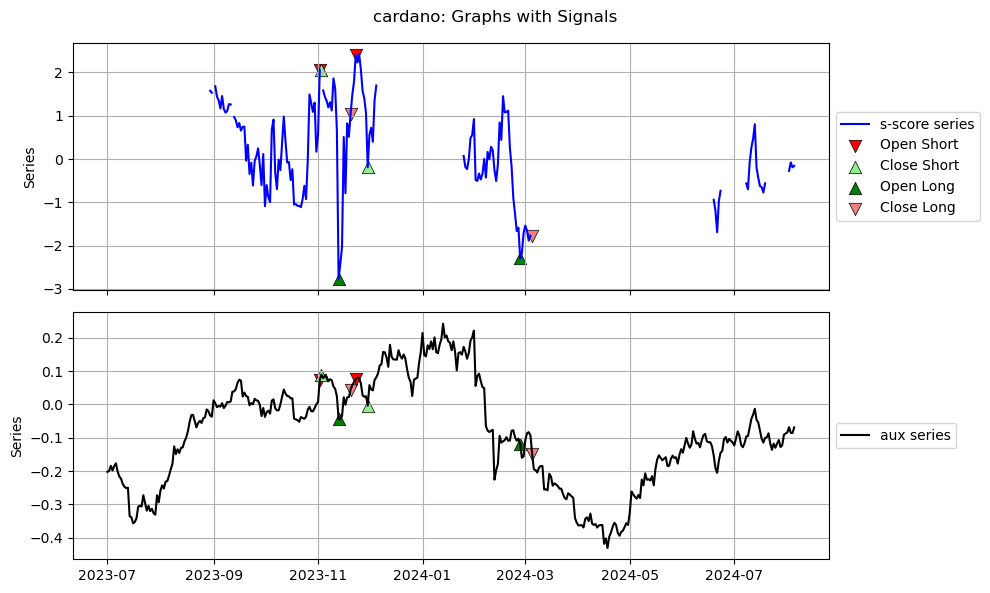

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, -1, -1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, -1, -1, -1, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, -1, -1, 0, 0, 0, 0, 0, -1, -1, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

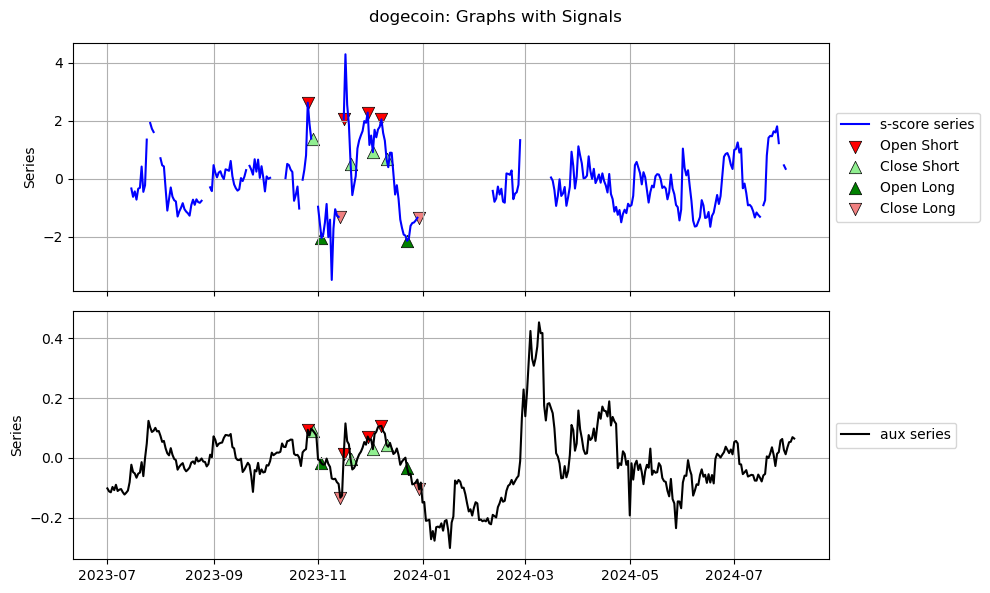

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

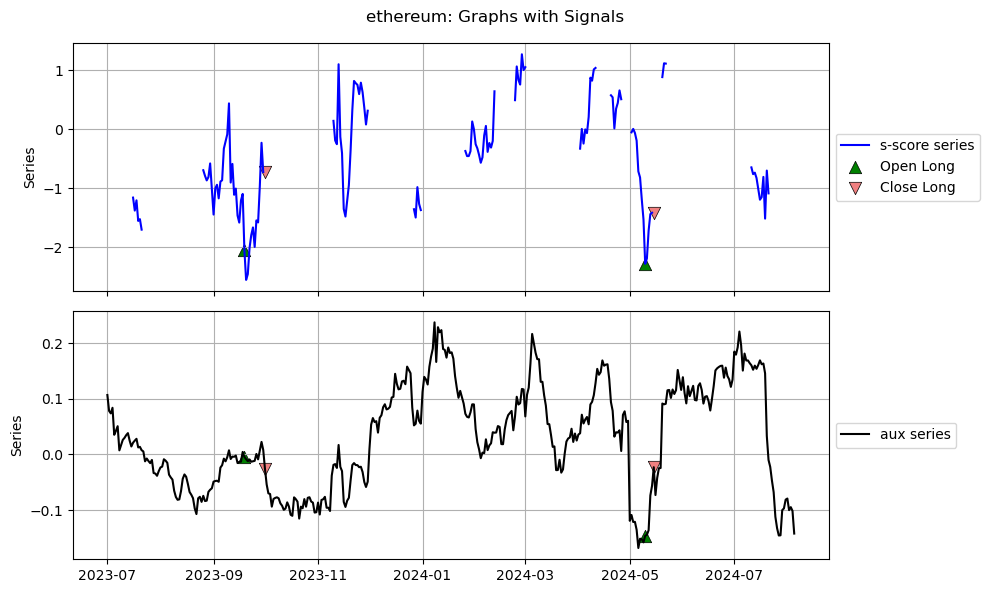

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

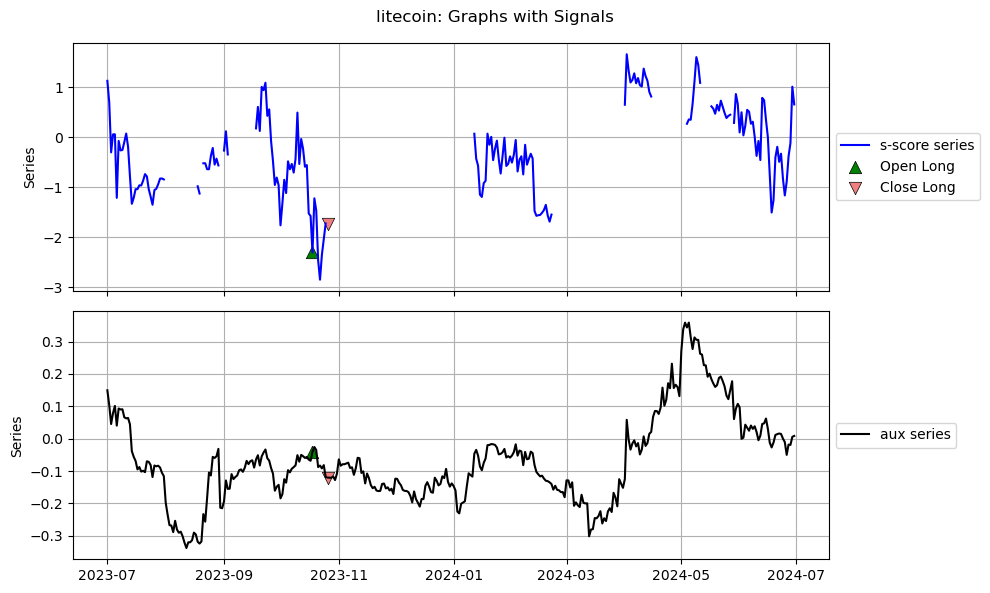

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

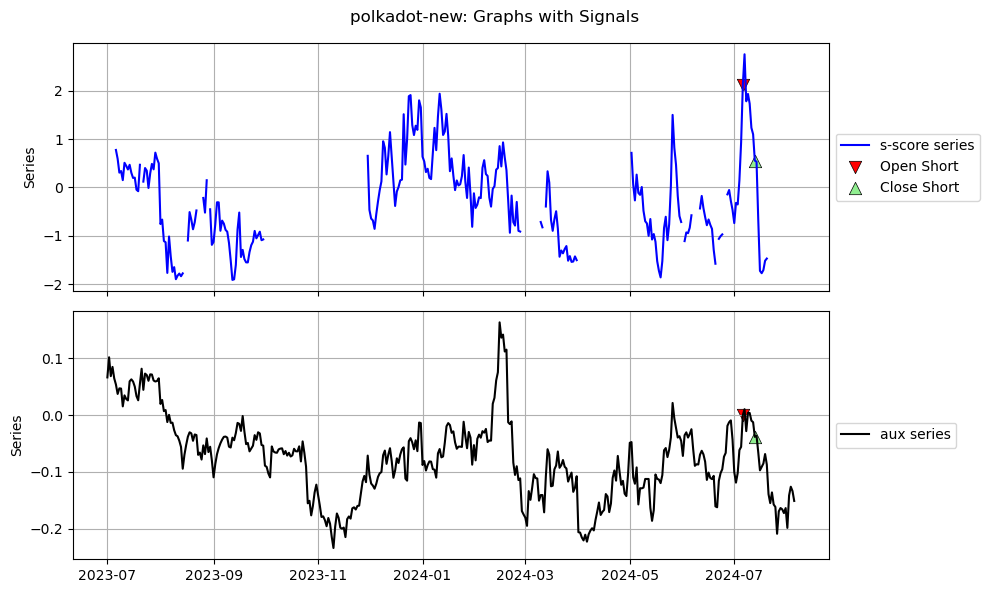

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

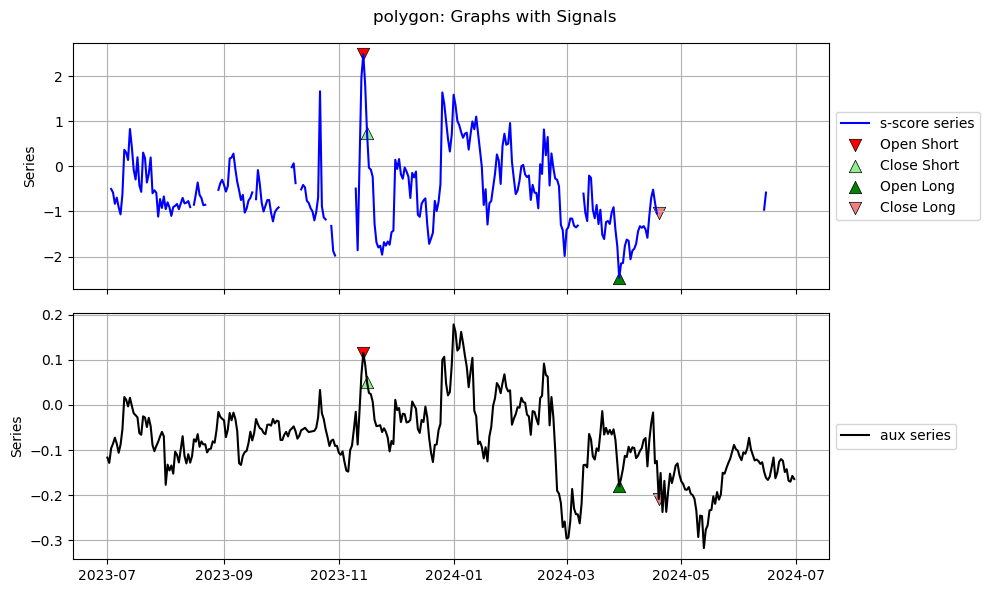

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, -1, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, -1, -1, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

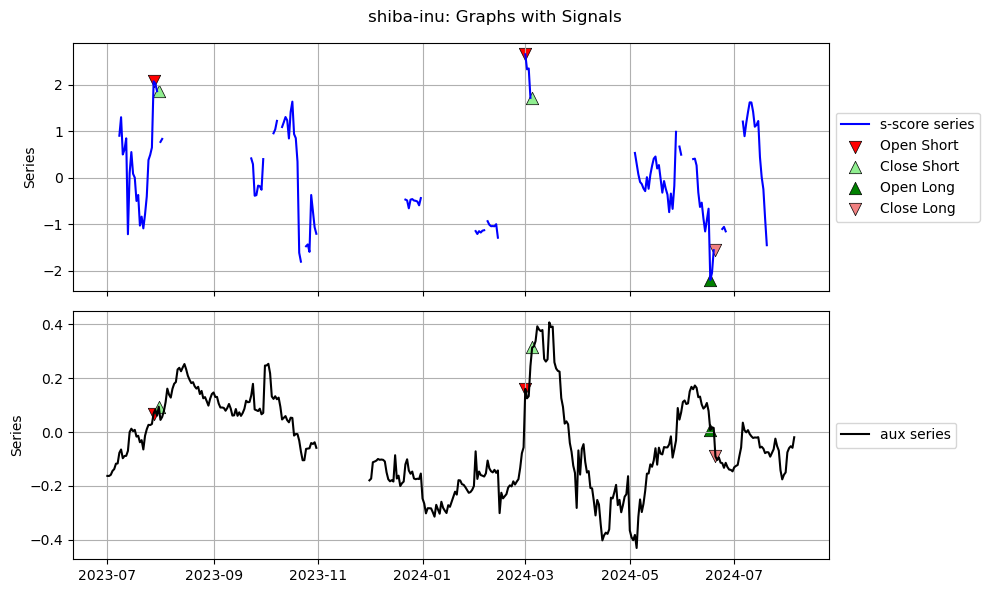

[0, 0, 0, 0, 0, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

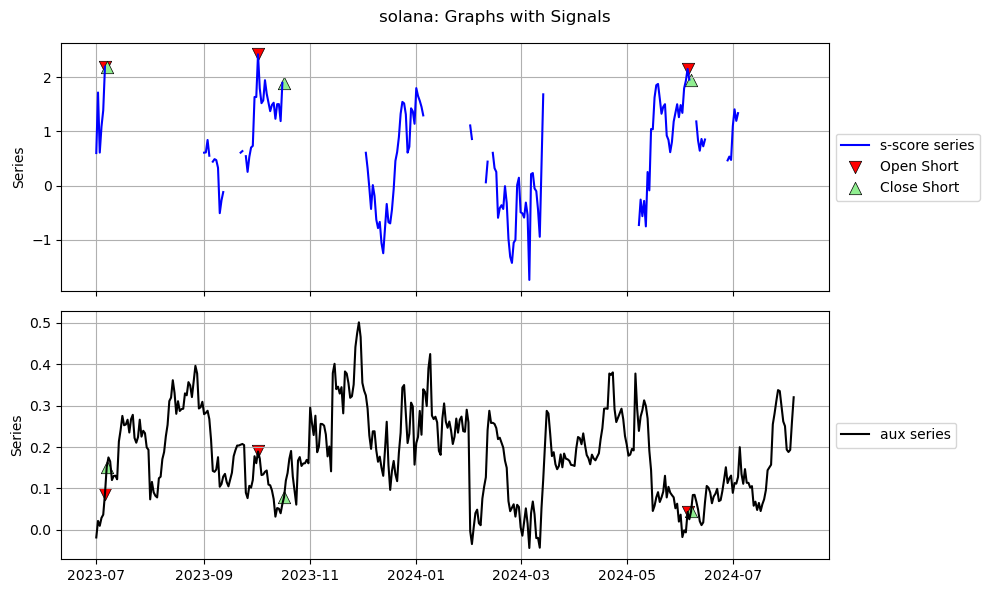

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, -1, -1, -1, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, -1, -1, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

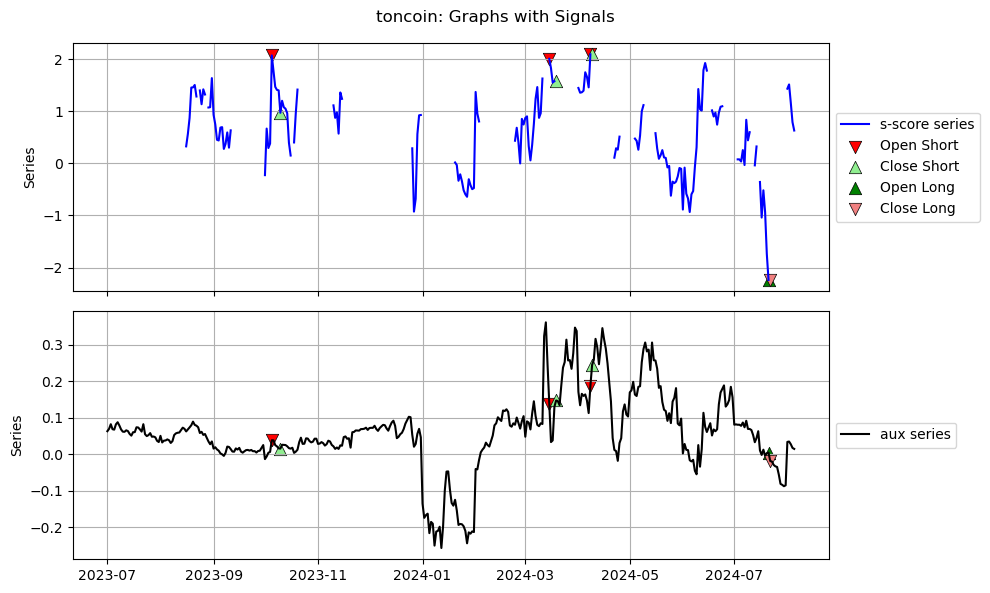

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, -1, -1, -1, -1, -1, -1, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

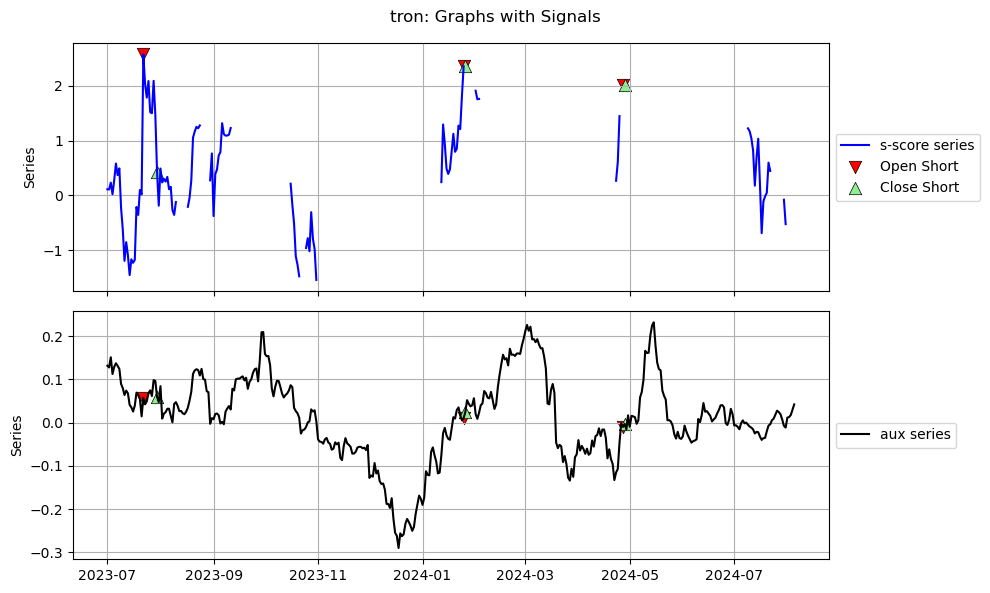

[-1, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

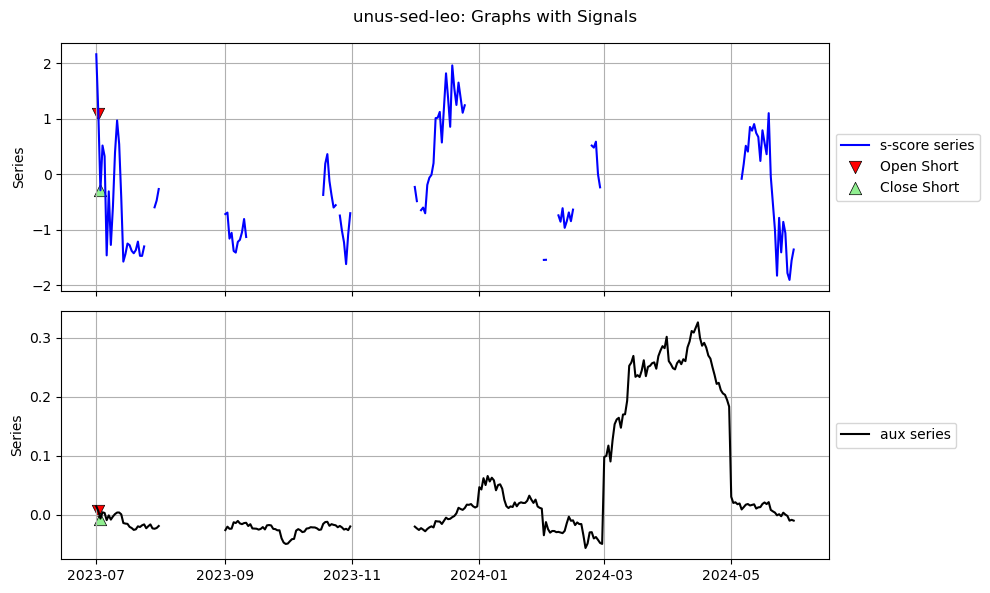

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

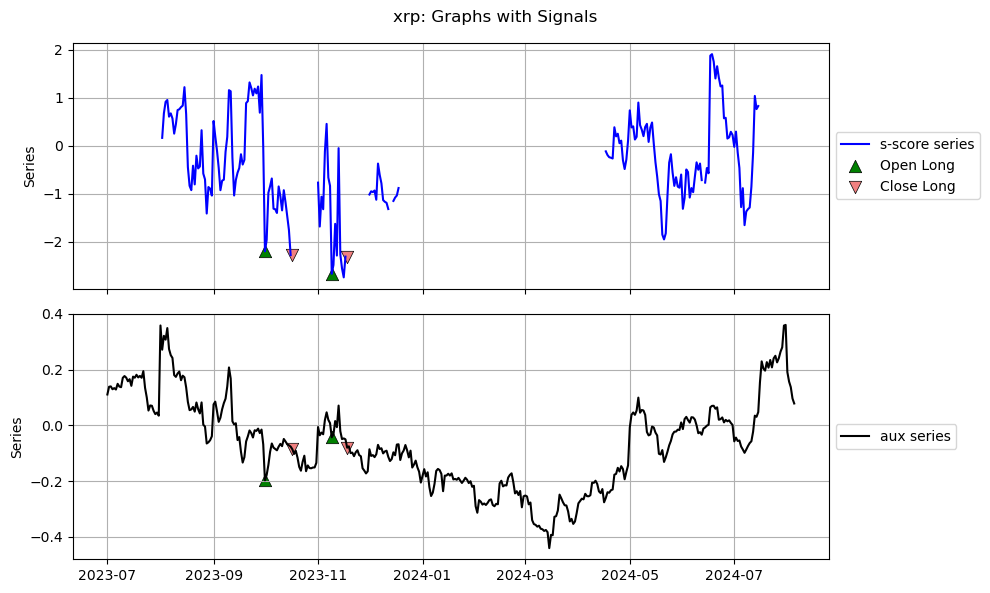

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, -1, -1, -1, -1, -1, 0, 0, 0,

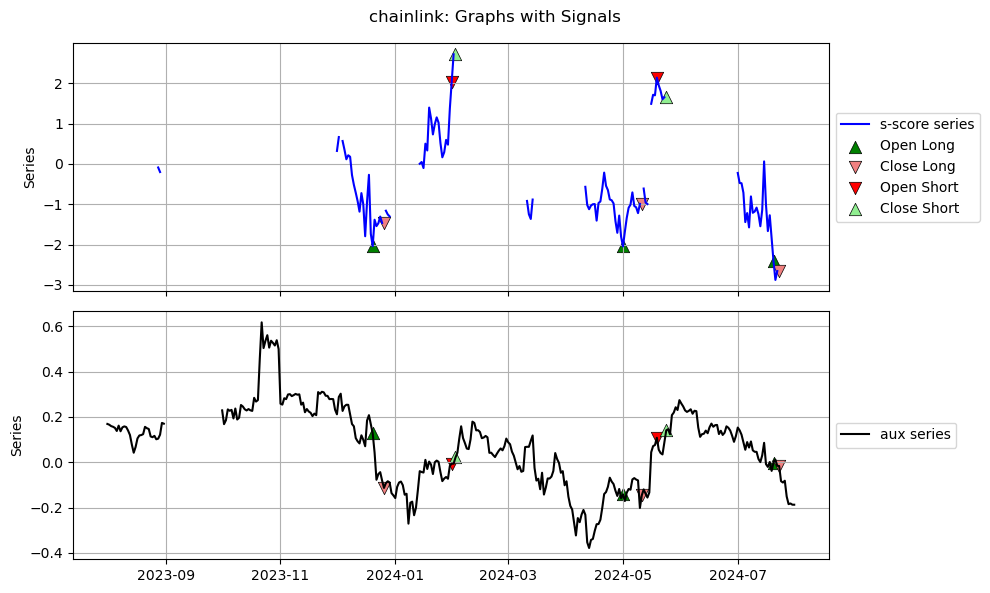

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

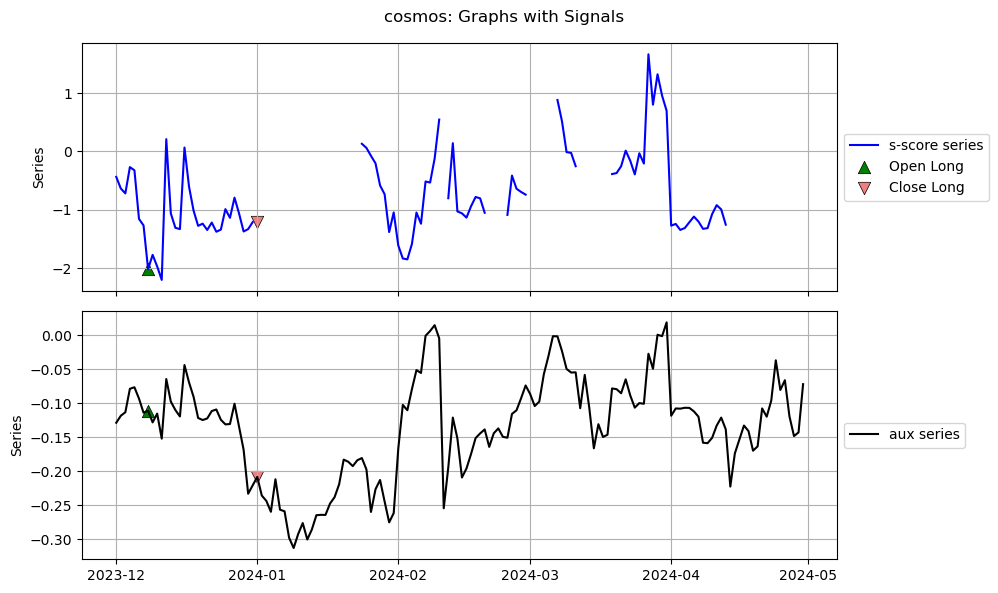

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 

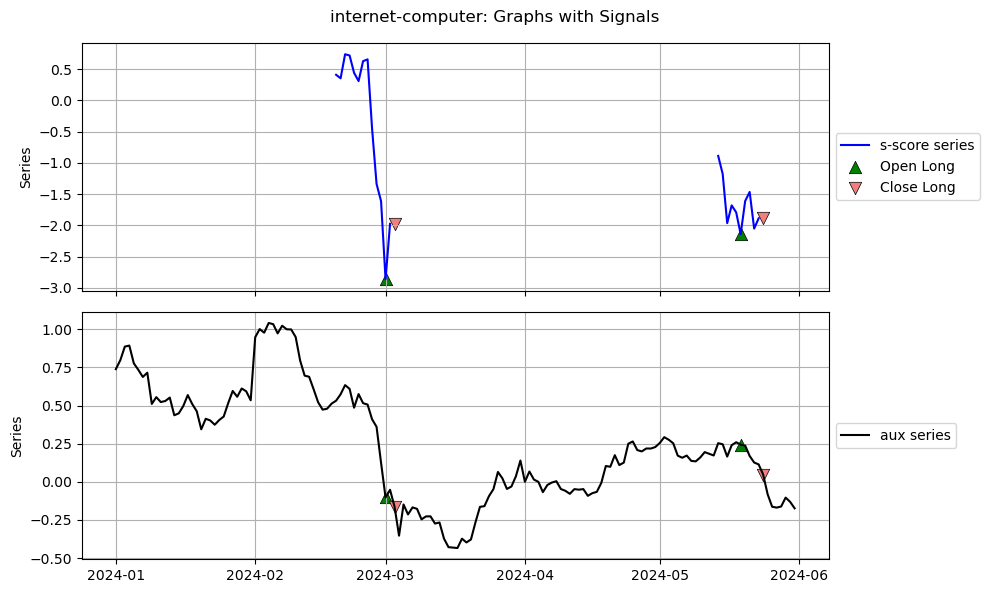

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

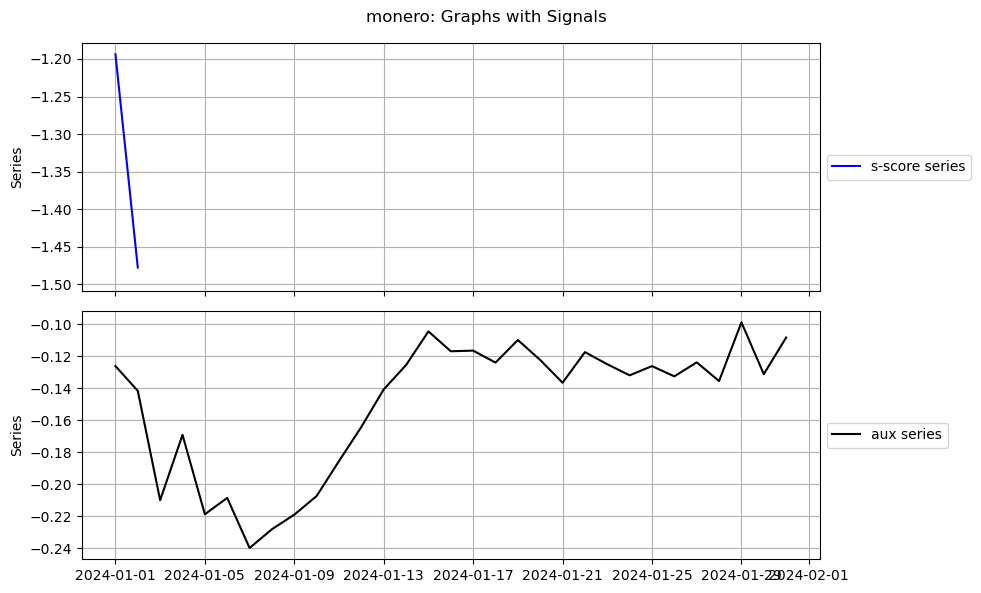

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, -1, -1, -1, -1, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

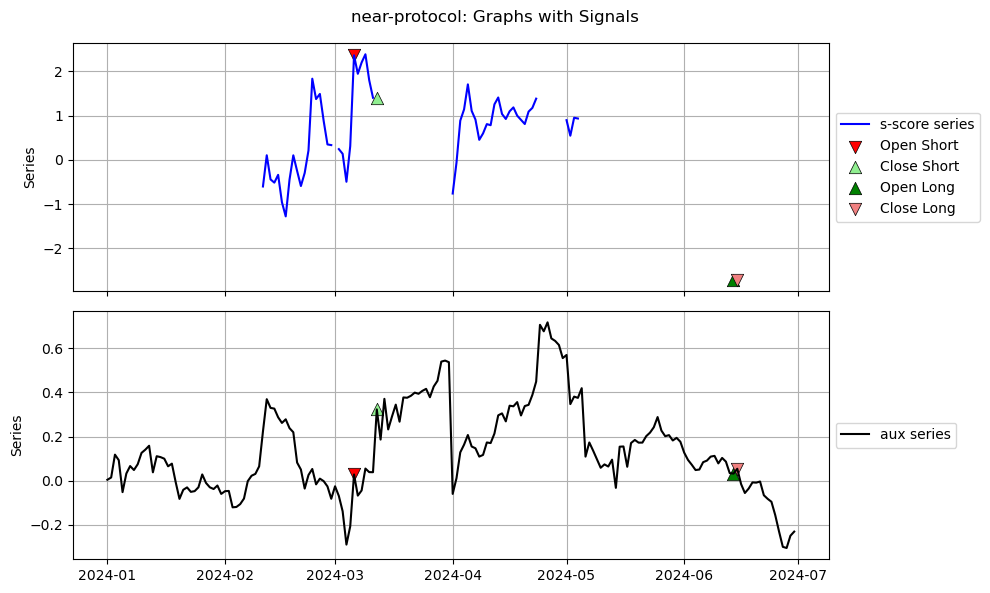

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

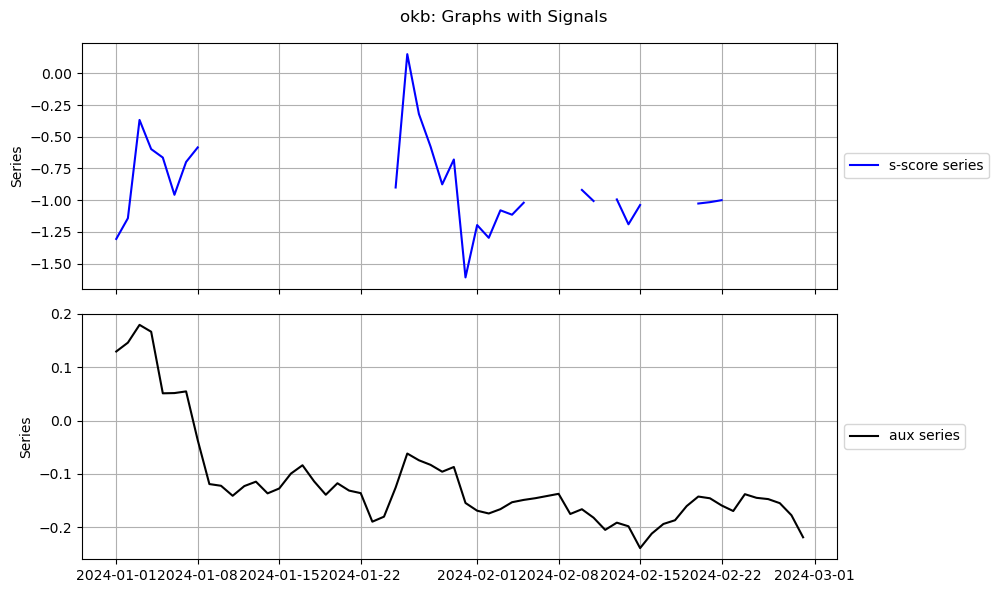

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

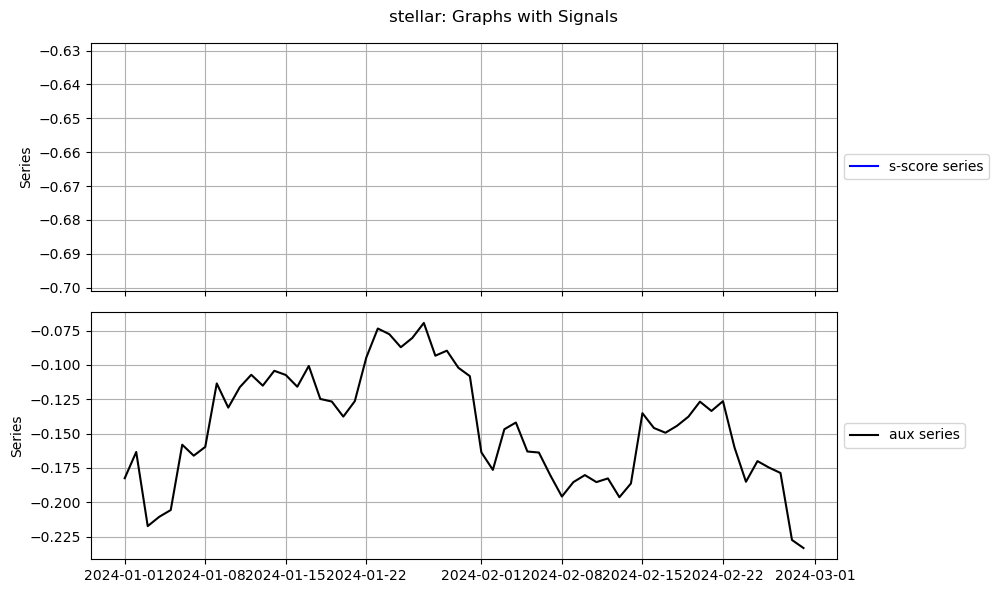

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -1, -1, -1, -1, -1, -1, -1, -1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

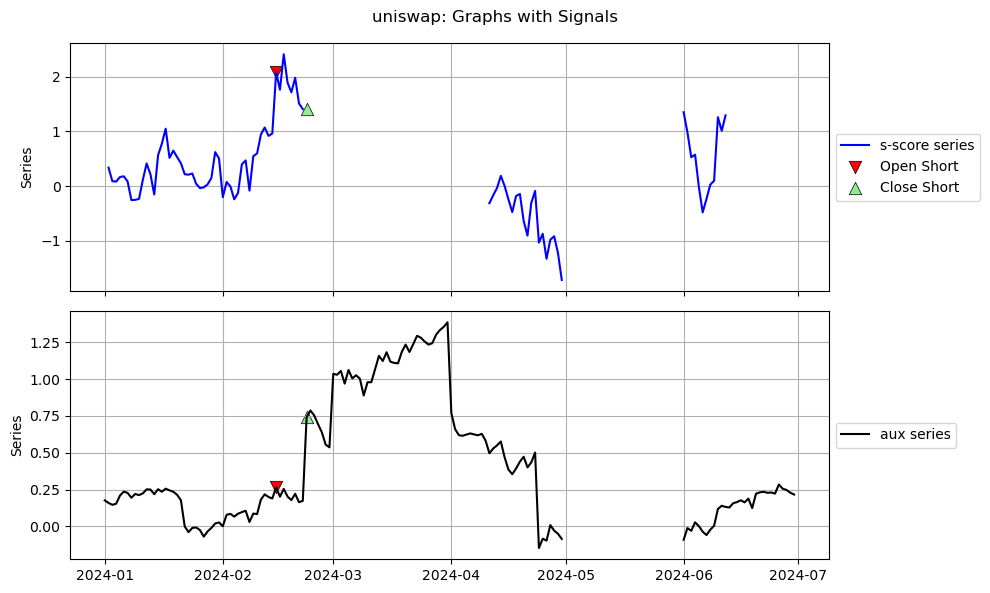

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

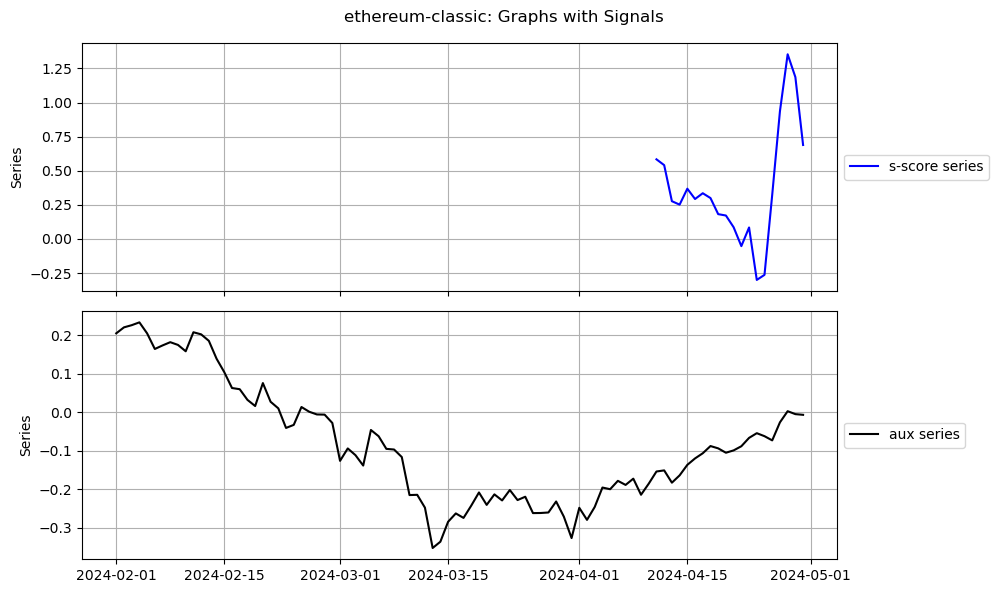

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

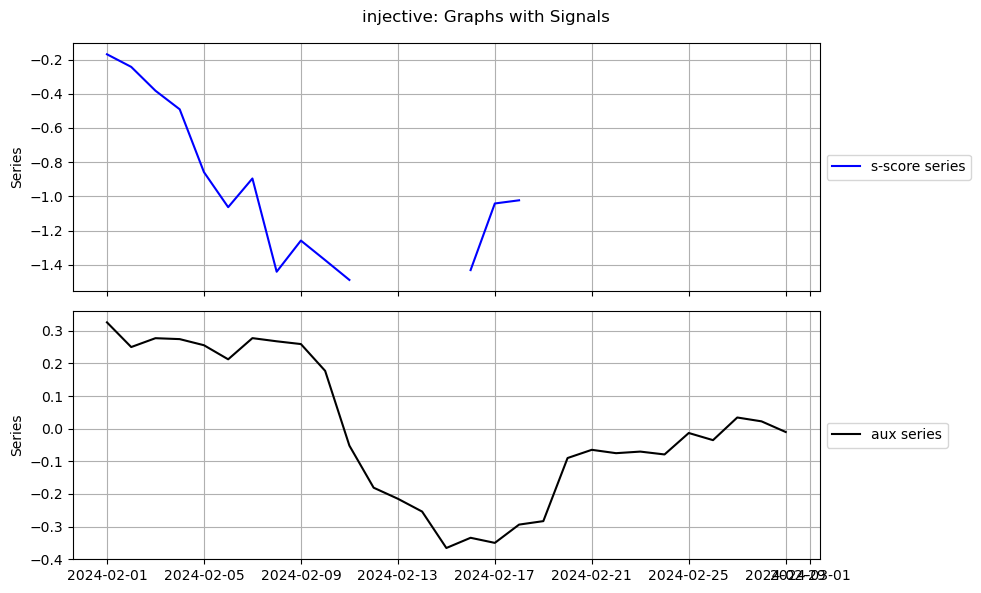

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

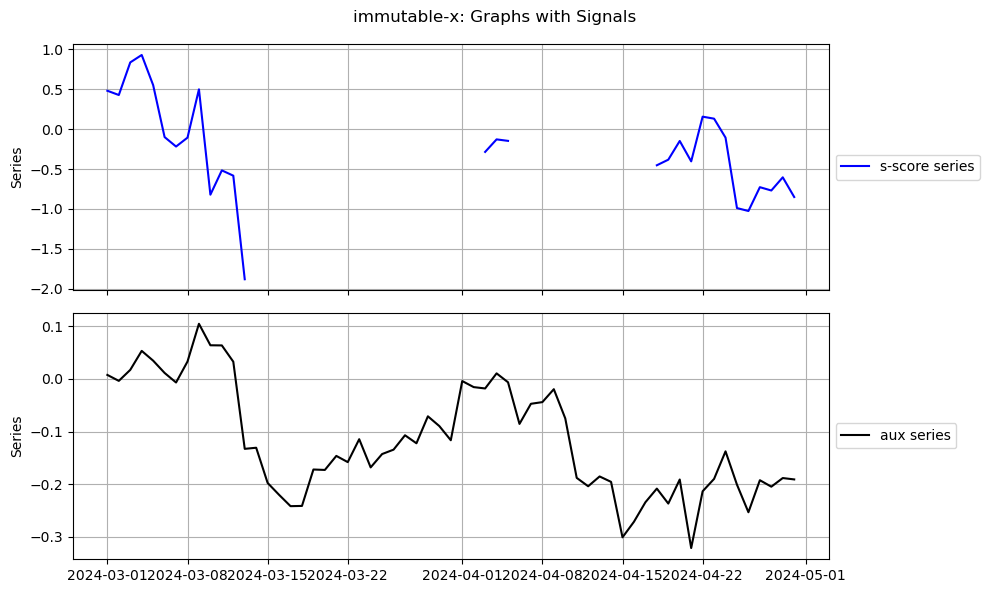

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

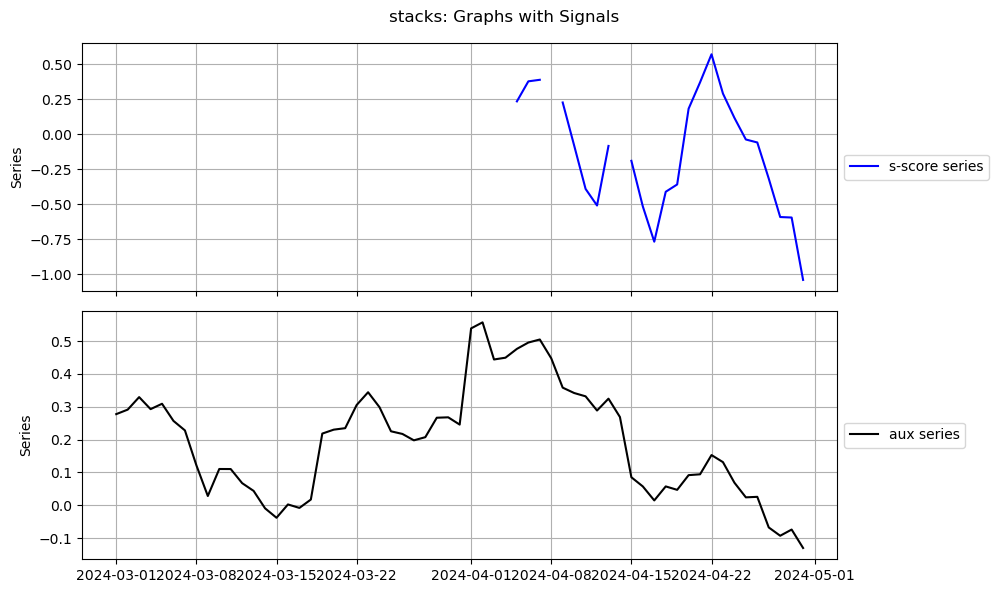

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

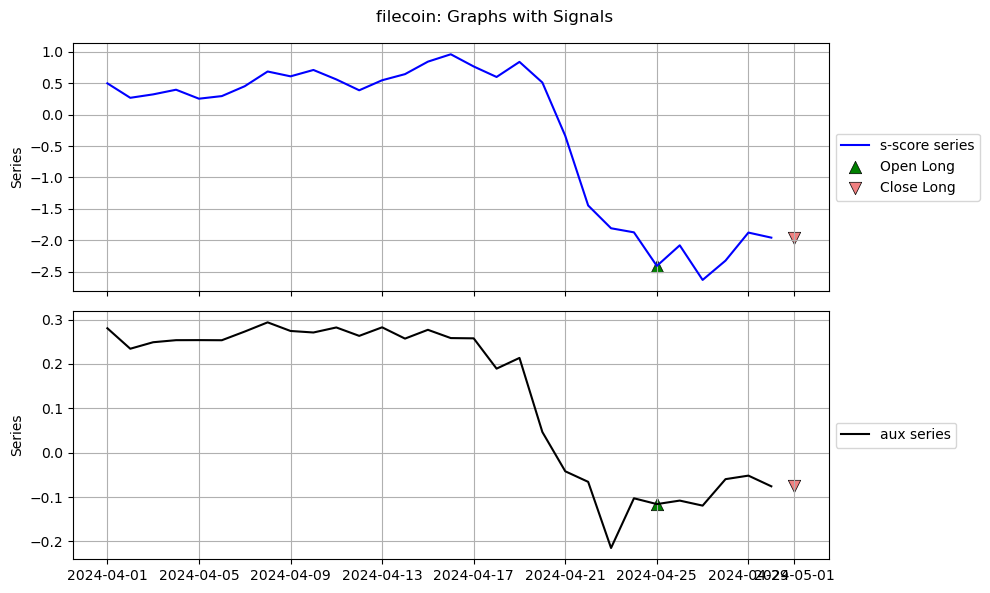

In [99]:
# Plot signal on top and aux on bottom
for coin in aggregate_aux_df.columns:
  plot_coin_signal_and_price2(
    coin = coin,
    signal_dict= backtest_final_0bps.signal_dict, 
    top_df = dynamic_sscore_df,
    bottom_df = aggregate_aux_df,
    labels = ["s-score series", "aux series"]
    )

In [ ]:
dynamic_sscore_df = pd.concat(backtest_final_0bps.dynamic_sscore_dict, axis = 1).T
for coin in dynamic_sscore_df.columns:
  plot_coin_signal_and_price2(
    coin = coin,
    signal_dict= backtest_final_0bps.signal_dict, 
    aux_df = dynamic_sscore_df,
    price_df = fifr.parent_df)

In [ ]:
start_date = (pd.to_datetime("2023-07-01") - timedelta(days = 60)).strftime("%Y-%m-%d")

aggregate_sscores_df = results_final_0bps[1][list(results_final_0bps[1].keys())[0]]
for _, df in list(results_final_0bps[1].items())[1:]:
  last_row =  df.iloc[[-1]] # .iloc[[]] returns a df, which is needed for concatenation
  aggregate_aux_df = pd.concat([aggregate_aux_df, last_row], ignore_index= True) # Sets new index

dates = pd.date_range(start_date, "2024-08-05")


aggregate_aux_df.index = dates
aggregate_aux_df

##### Remarks
- Our strategy performed poorly during the bull market of late 2023 ~ and first half of 2024. 
- The large drawdown from March seemed to be stemming from the fact that our trades on Bitcoin Cash and Shiba Inu coins on March turned out to be very bad. Especially, Long BCH stat-arb portfolio resulted in more than sixty percent loss. albeit BCH itself went up parabolically.
- There are some mean-reverting out of sample auxiliary series like Solana, Near-Protocol, Chainlink, and Cosmos. However, our signals generated from s-scores did not seem to be good entry nor exit points.

## Testing Another Strat : Pairs Trading with BTC, ETH against PC 1
Notice that removing our statistical factor returns from asset returns did not return a mean-reverting auxiliary series for Bitcoin and Ethereum. This suggests that although PC 1 has a similar return profile as Ethereum or Bitcoin, the cumulative return series (synthetic price series) may diverge in absolute levels in the long run. Let's check.

In [116]:
# Initialize classes and set dates
end_date = "2023-01-01"
start_date = (datetime.strptime(end_date,"%Y-%m-%d") - timedelta(days = 365)).strftime("%Y-%m-%d")
PD_coint = PrepareData(data_dir= fifr.data_dir, current_date= end_date, rebal_date= end_date, window_size = 365, parent_df= fifr.parent_df)
PCA_coint = PerformPCA(PD_coint)

In [122]:
eigportret_coint = PCA_coint.eigportret_df
eigport_coint = PCA_coint.Q
eigport_coint.index = PD_coint.tu

eigport_coint

,PC1,PC2,PC3,PC4,PC5
avalanche,0.047458,0.016970,-0.023965,0.035007,-0.027610
bitcoin,0.080548,0.055324,-0.005217,-0.002151,-0.018274
bnb,0.070669,-0.027501,0.012309,-0.009716,-0.017582
cardano,0.054970,-0.020543,-0.012808,-0.011470,-0.007729
chainlink,0.049310,-0.028390,-0.043918,0.036699,-0.046606
cosmos,0.041364,-0.021701,-0.035420,0.034733,-0.031295
dogecoin,0.038862,-0.029451,-0.034760,-0.097917,0.109743
ethereum,0.060722,0.024492,0.006803,0.030616,-0.029251
ethereum-classic,0.039334,-0.024810,0.023209,0.017547,-0.063245
hex,0.026731,0.006723,-0.116942,0.125254,0.140559


Text(0.5, 1.0, 'PC 1 vs buy-and-hold top three components')

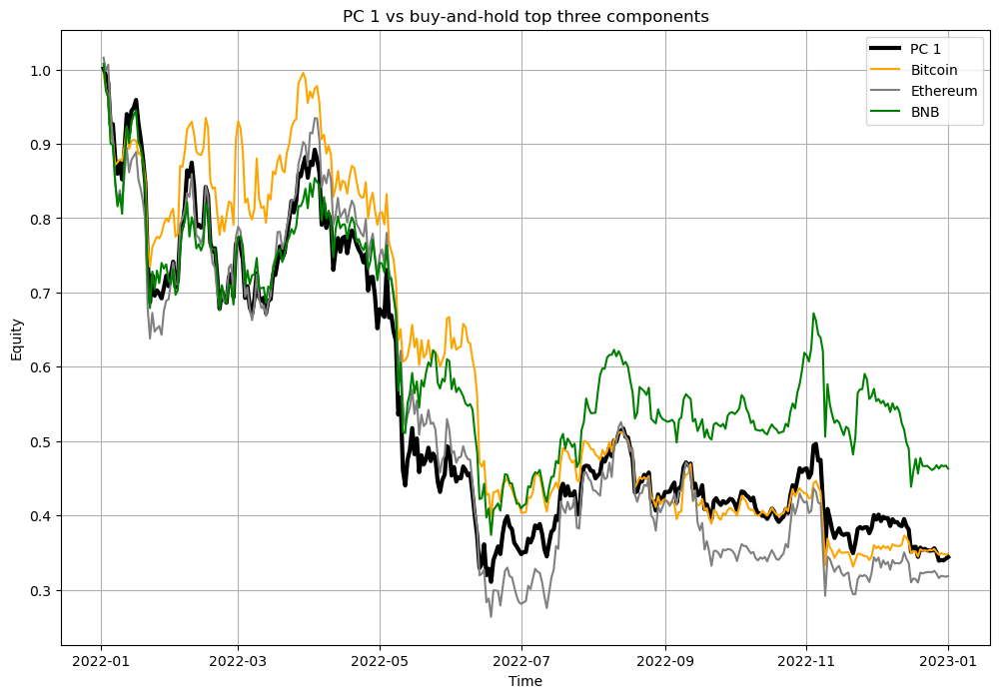

In [129]:
# Compare performance of major coins vs PC 1 
plt.figure(figsize = (12,8))
plt.plot(np.cumprod(1+eigportret_coint["PC1"]), label = "PC 1", color = "black", linewidth = 3)
plt.plot(np.cumprod(1+fifr.parent_df.loc[start_date : end_date]["bitcoin"].pct_change().dropna()), label = "Bitcoin", color = "orange")
plt.plot(np.cumprod(1+fifr.parent_df.loc[start_date : end_date]["ethereum"].pct_change().dropna()), label = "Ethereum", color = "grey")
plt.plot(np.cumprod(1+fifr.parent_df.loc[start_date : end_date]["bnb"].pct_change().dropna()), label = "BNB", color = "green")
plt.legend()
plt.grid(True)
plt.xlabel("Time")
plt.ylabel("Equity")
plt.title("PC 1 vs buy-and-hold top three components")

Text(0.5, 1.0, 'Synthetic Spread Series against PC 1')

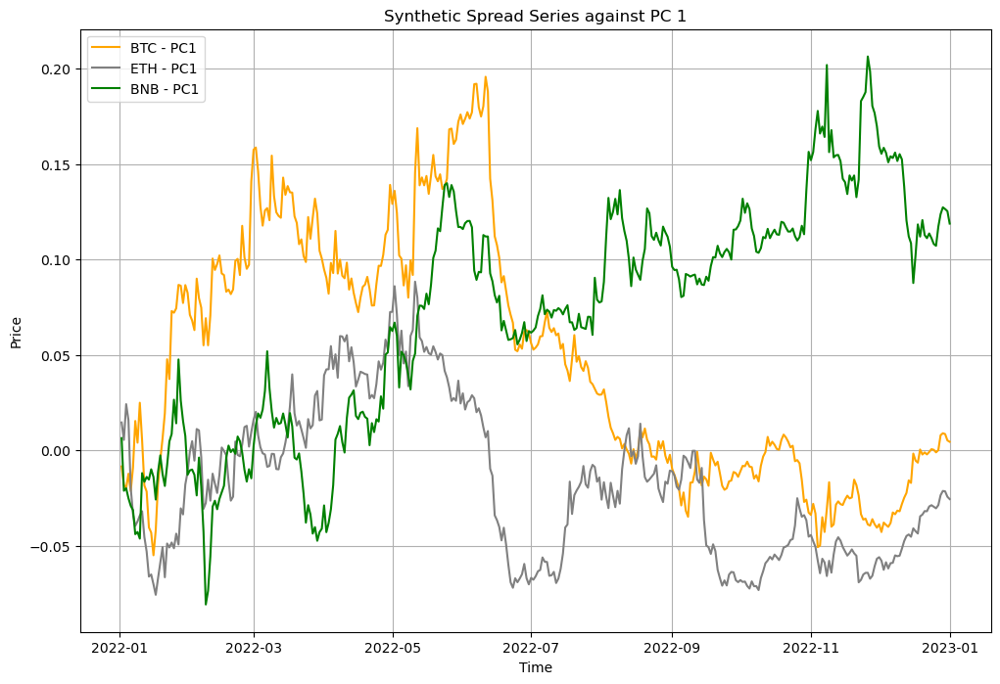

In [130]:
# Plot differences of synthetic prices
plt.figure(figsize = (12,8))
plt.plot(np.cumprod(1+fifr.parent_df.loc[start_date : end_date]["bitcoin"].pct_change().dropna()) - np.cumprod(1+eigportret_coint["PC1"]), label = "BTC - PC1", color = "orange", linewidth = 1.5)
plt.plot(np.cumprod(1+fifr.parent_df.loc[start_date : end_date]["ethereum"].pct_change().dropna()) - np.cumprod(1+eigportret_coint["PC1"]), label = "ETH - PC1", color = "grey", linewidth = 1.5)
plt.plot(np.cumprod(1+fifr.parent_df.loc[start_date : end_date]["bnb"].pct_change().dropna()) - np.cumprod(1+eigportret_coint["PC1"]), label = "BNB - PC1", color = "green", linewidth = 1.5)
plt.legend()
plt.grid(True)
plt.xlabel("Time")
plt.ylabel("Price")
plt.title("Synthetic Spread Series against PC 1")

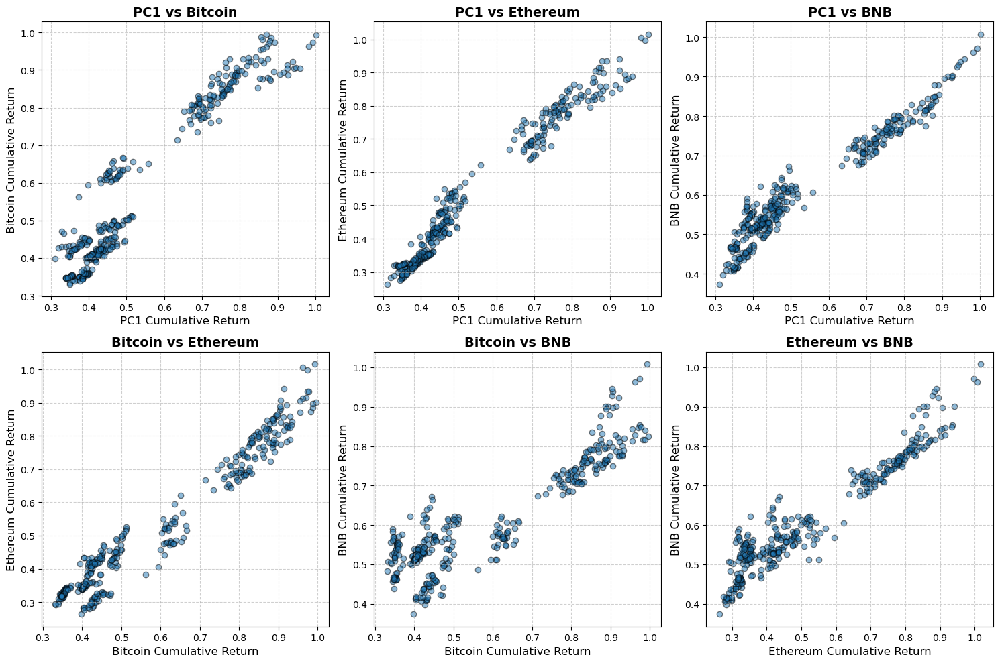

In [131]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Compute cumulative returns for each asset
cum_returns = {
    "PC1": np.cumprod(1 + eigportret_coint["PC1"]),
    "Bitcoin": np.cumprod(1 + fifr.parent_df.loc[start_date:end_date]["bitcoin"].pct_change().dropna()),
    "Ethereum": np.cumprod(1 + fifr.parent_df.loc[start_date:end_date]["ethereum"].pct_change().dropna()),
    "BNB": np.cumprod(1 + fifr.parent_df.loc[start_date:end_date]["bnb"].pct_change().dropna())
}

# Convert to DataFrame
cum_returns_df = pd.DataFrame(cum_returns)

# Create Scatter Plots
asset_pairs = [("PC1", "Bitcoin"), ("PC1", "Ethereum"), ("PC1", "BNB"), ("Bitcoin", "Ethereum"), ("Bitcoin", "BNB"), ("Ethereum", "BNB")]

fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(15, 10))
axes = axes.flatten()

for ax, (x_asset, y_asset) in zip(axes, asset_pairs):
    ax.scatter(cum_returns_df[x_asset], cum_returns_df[y_asset], alpha=0.5, edgecolors='black')
    ax.set_xlabel(f"{x_asset} Cumulative Return", fontsize=12)
    ax.set_ylabel(f"{y_asset} Cumulative Return", fontsize=12)
    ax.set_title(f"{x_asset} vs {y_asset}", fontsize=14, fontweight="bold")
    ax.grid(True, linestyle="--", alpha=0.6)

plt.tight_layout()
plt.show()


##### Remarks
- Above, we've plotted each value of our cumulative return series for one coin against the other (or PC 1). Notice how for some pairs we see a clear linear relationship. 

In [ ]:
# Run regression to check for cointegration

def cointegration_strat(series_dict):
  """
  """
  